In [1]:
import os
import re
import sys

import itertools
import numpy as np
import pandas as pd

from sklearn.preprocessing import StandardScaler, MinMaxScaler
from scipy.stats import spearmanr
from statsmodels.stats import multitest

import pytorch_lightning as pl
import scanpy as sc
from anndata import AnnData

import matplotlib.pyplot as plt
from matplotlib import cm, colors
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import seaborn as sns
import textwrap
import torch
import torch.nn as nn

import gseapy as gp

pl.seed_everything(32)

sys.path.append("/data/danai/scripts/LIVI/")
from src.analysis._utils import calculate_DxC_gene_effect, select_important_genes_for_factor_IQR, calculate_DxC_effect, assign_D_to_celltype
from src.analysis.plotting import make_gp_dotplot, plot_gene_loadings_for_factor, plot_gene_loadings_for_associated_variable

Seed set to 32
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Seed set to 32


In [2]:
adata = sc.read_h5ad("/data/danai/Data/OneK1K/LogNorm_counts_across_celltypes_DCRM_protein-coding_Azimuth_only-immune-cells_HVG-HEX-10K.h5ad")

if "age_scaled" not in adata.obs.columns:
    age_scaled = StandardScaler().fit_transform(adata.obs.age.to_numpy().reshape(-1,1))
    age_scaled = pd.DataFrame(age_scaled, index=adata.obs.index, columns=["age_scaled"])
    adata.obs = adata.obs.merge(age_scaled, left_index=True, right_index=True)

adata

AnnData object with n_obs × n_vars = 1172790 × 14212
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'pool', 'individual', 'percent_mt', 'latent', 'nCount_SCT', 'nFeature_SCT', 'cell_type', 'cell_label', 'sex', 'age', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_MITO', 'log1p_total_counts_MITO', 'pct_counts_MITO', 'total_counts_RIBO', 'log1p_total_counts_RIBO', 'pct_counts_RIBO', 'total_counts_ERCC', 'log1p_total_counts_ERCC', 'pct_counts_ERCC', 'n_genes', 'Norm_factors', 'major_celltype', 'predicted_celltype_l0', 'predicted_celltype_l1', 'predicted_celltype_l2', 'original_celltype', 'new_predicted_celltype_l2', 'new_predicted_celltype_l0', 'new_predicted_celltype_l1', 'age_scaled'
    var: 'GeneSymbol', 'features', 'MITO', 'RIBO', 'ERCC', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'downre

In [3]:
gene_anno = pd.read_csv("/data/danai/Data/OneK1K/OneK1K_HVG-HEX-10K_geneIDs_Biomart.txt", sep="\t", index_col=0)
gene_anno.rename(columns={"Gene stable ID":"feature_id", 
                         "Gene name":"gene_name",
                         "Chromosome/scaffold name":"gene_chromosome", 
                         "Gene start (bp)":"gene_start", 
                         "Gene end (bp)":"gene_end"},
                inplace=True)

adata.var.GeneSymbol = adata.var.GeneSymbol.str.strip()
adata.var = adata.var.merge(gene_anno.filter(["gene_chromosome", "gene_start", "gene_end"]), right_index=True, left_index=True)

In [266]:
adata.var.to_csv("/data/danai/Data/OneK1K/LogNorm_counts_across_celltypes_DCRM_protein-coding_Azimuth_only-immune-cells_HVG-HEX-10K_adata-var.tsv", sep="\t", header=True, index=True)

In [4]:
# COLORS FROM THE ORIGINAL PUBLICATION
cell_label_colors = {
    "CD4 SOX4": "#D6C1DE", # SOX4+ CD4 T cells
    "CD4 NC": "#882E72", # CD4 naive T cells
    "CD4 ET": "#B178A6", # CD4 effectorT  cells
    "CD8 NC": "#5289C7", # CD8 naive T cells
    "CD8 S100B": "#7BAFDE", # S100B+ CD8 cells
    "CD8 ET": "#1965B0", # CD8 effector cells 
    "NK": "#4EB265",
    "NK R": "#90C987", # NK recruiting cells
    "B IN": "#F6C141",
    "B Mem": "#F7EE55",
    "Mono C": "#F1932D", # classical monocytes
    "Mono NC": "#E8601C", # non-classical monocytes
    "DC": "#DC050C",
    "Plasma": "#CAE0AB",
}

In [5]:
adata.uns["cell_label_colors"] = [cell_label_colors[ct] for ct in adata.obs.cell_label.cat.categories]

In [7]:
background_genes = adata.var.GeneSymbol

# databases_bio = ["GO_Biological_Process_2023", "Elsevier_Pathway_Collection",  "GO_Molecular_Function_2023", "KEGG_2021_Human", "Reactome_2022"] 
databases_bio = ["GO_Biological_Process_2023", "GO_Molecular_Function_2023", "KEGG_2021_Human", "Reactome_2022"] 


databases_disease = ["DisGeNET", "Disease_Signatures_from_GEO_up_2014", "Disease_Signatures_from_GEO_down_2014", "RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO",
                     "Human_Phenotype_Ontology", "UK_Biobank_GWAS_v1"]

databases_disease_min = ["DisGeNET", "Disease_Signatures_from_GEO_up_2014", "Disease_Signatures_from_GEO_down_2014", "Human_Phenotype_Ontology", "UK_Biobank_GWAS_v1"]


In [8]:
results_dir = "/data/danai/Data/OneK1K/LIVI2_testing_results/"
model = "2024-12-05_10-20_LIVIcis-cell-state_zdim15_700-gxc_5-persistent_60-0-warm-up_no-adversary_Gseed200_hvg-hex-10K_larger-encoder_best"
model_results_dir = os.path.join(results_dir, model)
os.path.isdir(model_results_dir)

True

In [9]:
sc.settings.figdir = os.path.join(model_results_dir, "Figures")

In [121]:
cell_state = pd.read_csv(os.path.join(model_results_dir,
                                    f"{model}_cell-state_latent.tsv"),
                               sep="\t", index_col=0)

In [10]:
umap_cc = pd.read_csv(
    os.path.join(model_results_dir, f"{model}_cell-state_latent_UMAP.tsv"),
    sep="\t", index_col=0
)

In [11]:
adata.obsm["X_umap"] = umap_cc.loc[adata.obs.index].to_numpy()

In [13]:
assignment_matrix = pd.read_csv(
    os.path.join(model_results_dir, f"{model}_factor_assignment_matrix.tsv"),
    sep="\t", index_col=0
)
assignment_matrix.columns = assignment_matrix.columns.str.replace("U_", "D_")
assignment_matrix.head()

,D_Factor1,D_Factor2,D_Factor3,D_Factor4,D_Factor5,D_Factor6,D_Factor7,D_Factor8,D_Factor9,D_Factor10,...,D_Factor691,D_Factor692,D_Factor693,D_Factor694,D_Factor695,D_Factor696,D_Factor697,D_Factor698,D_Factor699,D_Factor700
Cell-state_Factor1,8.437773e-07,7.903217e-08,0.000149,2.960464e-08,0.105288,9.999727e-01,5.675518e-07,0.958925,0.000287,0.000158,...,5.023212e-06,4.209568e-06,1.000000e+00,4.168299e-03,9.999992e-01,0.209136,0.078419,6.167789e-07,0.018491,0.140772
Cell-state_Factor2,1.292795e-06,6.067657e-08,0.000136,6.915393e-08,0.105908,1.794856e-02,5.106163e-07,0.115423,0.026317,0.000138,...,1.773568e-07,6.894123e-06,7.097198e-02,2.241115e-07,8.517019e-07,0.047724,0.001983,7.762388e-07,0.000035,0.041986
Cell-state_Factor3,9.953613e-07,6.230532e-08,0.000141,1.447328e-06,0.000004,4.638549e-07,9.892867e-01,0.965989,0.000585,0.000156,...,2.023449e-07,2.216382e-06,5.867200e-05,5.172464e-03,6.707507e-07,0.132809,0.001249,1.094831e-06,0.938939,0.154773
Cell-state_Factor4,6.680752e-07,6.124807e-02,0.000136,3.778137e-08,0.011434,4.063994e-07,9.991040e-01,0.019197,0.008096,0.000136,...,2.121831e-07,3.456871e-07,4.101363e-08,3.866343e-07,6.646220e-07,0.102437,0.012960,7.976132e-07,0.000011,0.032869
Cell-state_Factor5,4.728630e-06,2.615931e-08,0.000146,6.789284e-04,0.123782,2.302163e-07,5.004259e-07,1.000000,0.305943,0.000152,...,8.162028e-08,3.348259e-02,3.075602e-08,2.127417e-07,4.462411e-07,0.080859,0.288426,5.094969e-07,0.029717,0.271452


In [14]:
D = pd.read_csv(os.path.join(model_results_dir,
                            f"{model}_U_embedding.tsv"),
                               sep="\t", index_col=0)
D.columns = D.columns.str.replace("U", "D")
D.head()

,D_Factor1,D_Factor2,D_Factor3,D_Factor4,D_Factor5,D_Factor6,D_Factor7,D_Factor8,D_Factor9,D_Factor10,...,D_Factor691,D_Factor692,D_Factor693,D_Factor694,D_Factor695,D_Factor696,D_Factor697,D_Factor698,D_Factor699,D_Factor700
individual,,,,,,,,,,,,,,,,,,,,,
691_692,-1.042473,-3.014132,1.014801,1.139763,-0.087979,-0.651705,0.490216,-0.437837,-0.698968,-0.075018,...,-1.559727,-2.399024,-0.448335,-0.562907,1.627759,0.417358,-0.134628,0.011702,-0.679321,0.457391
693_694,0.204075,-1.975144,-0.909941,-3.882647,-2.031409,-1.043576,-0.600040,0.700274,-1.798226,1.284830,...,-4.333742,-0.440545,3.113877,-1.716786,-1.533546,0.933507,1.020350,0.339764,-1.053410,0.119764
688_689,-0.265995,-0.624907,-0.622831,-2.176815,0.853737,-0.117719,0.055314,0.302469,0.608836,-1.786304,...,-0.670751,-1.207303,8.913930,-0.353388,-0.325745,-1.125641,0.403694,-0.928585,0.525144,-0.484701
683_684,0.416159,-2.862958,-0.515983,1.572177,0.868042,-0.119366,-0.109651,0.556453,1.886532,-1.681124,...,-2.243293,-1.778274,0.387456,0.630929,-0.590417,0.165828,-2.937147,0.222008,-0.201923,0.057328
684_685,-1.244226,-4.169203,-0.287462,-0.519455,3.750650,-1.336222,0.230874,-0.624908,1.064494,0.636243,...,0.699778,-3.021685,-0.273128,-0.655736,-0.635290,0.228497,1.079147,-1.051518,0.797644,0.003049


In [15]:
DxC_decoder = pd.read_csv(os.path.join(model_results_dir,
                                            f"{model}_GxC_decoder.tsv"),
                               sep="\t", index_col=0)
DxC_decoder.columns = DxC_decoder.columns.str.replace("GxC", "DxC")
DxC_decoder.head()

,DxC_Factor1,DxC_Factor2,DxC_Factor3,DxC_Factor4,DxC_Factor5,DxC_Factor6,DxC_Factor7,DxC_Factor8,DxC_Factor9,DxC_Factor10,...,DxC_Factor691,DxC_Factor692,DxC_Factor693,DxC_Factor694,DxC_Factor695,DxC_Factor696,DxC_Factor697,DxC_Factor698,DxC_Factor699,DxC_Factor700
Geneid,,,,,,,,,,,,,,,,,,,,,
ENSG00000257019,0.000003,-0.000156,0.000261,-0.000105,0.000109,-0.000148,0.000145,0.000002,0.000106,-0.000083,...,-0.000125,-0.000088,0.000062,-0.000037,-0.000043,-0.000013,-0.000199,-0.000141,0.000042,0.000049
ENSG00000166987,-0.000101,-0.000302,0.000002,-0.000025,0.000096,-0.000122,0.000290,-0.000218,-0.000033,0.000128,...,-0.000093,-0.000059,-0.000712,0.000007,-0.000217,0.000056,0.000027,0.000117,-0.000141,0.000014
ENSG00000170624,-0.000007,-0.000096,-0.000228,0.000753,-0.000033,-0.000042,-0.000032,0.001457,0.000291,-0.000079,...,-0.000690,0.000181,-0.004836,0.000014,-0.000040,0.000021,0.000080,0.000070,-0.000669,-0.000014
ENSG00000140519,0.000013,-0.000071,0.000062,-0.000007,-0.000070,0.000082,-0.000036,0.000126,-0.000059,-0.000021,...,0.000164,0.000251,-0.000099,0.000035,-0.000080,-0.000019,-0.000139,0.000042,-0.000011,-0.000129
ENSG00000117115,-0.000463,-0.000236,0.000113,-0.000527,0.000036,0.000147,-0.000130,-0.000716,-0.000064,0.000002,...,0.000046,0.000210,0.000123,-0.000185,-0.000235,0.000060,-0.000145,0.000712,-0.000128,-0.000025


In [16]:
GxC = (nn.Softmax(dim=1)(torch.from_numpy(zbase.to_numpy())).numpy() @ assignment_matrix.to_numpy()) * U.loc[adata.obs.individual].to_numpy()
GxC.shape

(1172790, 700)

In [159]:
GxC = pd.DataFrame(GxC, index = zbase.index, columns=GxC_decoder.columns)
GxC.head()

,GxC_Factor1,GxC_Factor2,GxC_Factor3,GxC_Factor4,GxC_Factor5,GxC_Factor6,GxC_Factor7,GxC_Factor8,GxC_Factor9,GxC_Factor10,...,GxC_Factor691,GxC_Factor692,GxC_Factor693,GxC_Factor694,GxC_Factor695,GxC_Factor696,GxC_Factor697,GxC_Factor698,GxC_Factor699,GxC_Factor700
barcode,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAATGTTG-1,-0.144587,-0.191161,0.000147,0.163385,-0.006275,-0.042615,0.079334,-0.365158,-0.062601,-0.000011,...,-0.044601,-0.533151,-0.026179,-0.012801,0.099430,0.037235,-0.012634,0.000174,-0.192166,0.055689
AAACCTGAGAGAACAG-1,0.041220,-0.135928,-0.000135,-0.344820,-0.142875,-0.167666,-0.054903,0.593710,-0.040644,0.000195,...,-1.364555,-0.067879,0.286725,-0.029799,-0.214168,0.075480,0.044950,0.013701,-0.138489,0.007935
AAACCTGAGCATGGCA-1,-0.037570,-0.120274,-0.000092,-0.479857,0.045440,-0.015404,0.005854,0.220406,0.027874,-0.000277,...,-0.013509,-0.358716,0.573572,-0.019077,-0.035576,-0.095622,0.032397,-0.019286,0.075932,-0.028571
AAACCTGAGTATTGGA-1,0.062550,-0.275946,-0.000075,0.200327,0.056118,-0.012085,-0.017304,0.432620,0.089600,-0.000254,...,-0.223194,-0.370395,0.033154,0.017456,-0.055815,0.014500,-0.199218,0.004425,-0.040717,0.004822
AAACCTGAGTGTCCCG-1,-0.193813,-0.059106,-0.000042,-0.060831,0.247543,-0.305918,0.017627,-0.540300,0.047046,0.000095,...,0.066371,-0.244677,-0.049435,-0.014816,-0.136086,0.020380,0.046336,-0.046700,0.077604,0.000222


In [17]:
PRS = pd.read_csv("/data/danai/Data/OneK1K/PRS_standard-scaled.tsv", sep="\t", index_col=0).T
PRS = PRS.loc[D.index]
PRS

,PDW,IBD,Monocyte_count,Lymphocyte_percentage,Celiac,RA,MCV,Psoriasis,Plateletcrit,MPV,...,Height,Platelet_count,RBC,Leukocyte_count,RBDW,UC,Lymphocyte_count,T2D,Endometriosis,Multiple_sclerosis
individual,,,,,,,,,,,,,,,,,,,,,
691_692,0.291028,0.921506,0.807803,0.073441,-0.126709,-1.158741,0.462384,2.725448,0.479527,0.096923,...,-0.144022,0.684278,-0.251568,1.168590,-2.590094,-0.338635,1.010230,1.255989,0.183071,-0.212141
693_694,0.509122,0.014525,0.275580,0.026328,-0.875266,0.459058,0.058884,0.432755,0.449513,1.429291,...,-0.459942,-0.073953,1.521804,0.880476,-0.007997,-0.743467,0.258249,-0.445195,0.306532,-1.930667
688_689,0.747621,1.185607,2.244478,-0.574450,0.986089,-0.277833,0.250202,1.101461,0.630030,1.218372,...,-0.389158,-0.044611,1.307181,1.319138,-0.096182,-2.242711,0.076434,0.921082,-1.115088,-1.663811
683_684,-1.056867,-0.037600,-0.346156,0.895006,0.849274,1.479542,-0.393779,-0.152931,-0.209626,-1.175514,...,-1.586118,0.493378,-0.344106,0.281813,0.221220,-0.326834,0.806733,-0.695708,-1.368122,-1.251894
684_685,0.694509,2.401865,1.023994,-1.099108,-0.315700,-1.441501,-0.605399,-0.516708,1.225127,1.913347,...,-0.554570,-0.548276,0.662240,0.370617,2.396896,0.741925,-0.392671,0.033624,-0.253174,0.867818
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
840_841,1.211065,-0.124476,0.515276,-0.253691,-0.068020,0.974408,-0.142372,1.516462,0.626888,1.322976,...,0.731011,-0.238728,1.173662,0.761485,0.017823,-0.419462,-0.098836,0.856233,-0.628667,0.449426
801_802,2.162178,1.414959,0.780339,0.555844,-0.036434,-0.948971,-0.383261,-0.490349,0.287179,0.466934,...,-0.174954,-0.015106,-0.315019,-0.172859,-1.273162,0.098815,0.178686,-0.114730,-0.508913,-0.306601
797_798,-0.879431,0.858955,0.823324,-0.075157,-0.738498,0.671065,0.695126,0.088861,0.224763,-1.832833,...,1.726136,1.443055,-0.393431,-1.030489,-1.562931,1.745476,-0.040868,0.731864,-0.484769,-1.481438


In [231]:
PRS_effects = pd.read_csv(os.path.join(model_results_dir, "PRS_LMM_results_BH-0.05_Ucontext.tsv"),
                          sep="\t")
PRS_effects.Factor = PRS_effects.Factor.str.replace("U_", "D_")
PRS_effects

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue
0,D_Factor19,Celiac,-0.163174,0.024693,2.334779e-11,2.150454e-08
1,D_Factor19,RA,0.124845,0.023360,7.291072e-08,4.556920e-05
2,D_Factor36,Psoriasis,0.232348,0.038465,1.075110e-09,8.180186e-07
3,D_Factor41,Celiac,0.190772,0.026913,6.878921e-13,7.523819e-10
4,D_Factor41,RA,-0.273531,0.025460,1.545146e-28,5.408012e-25
...,...,...,...,...,...,...
61,D_Factor682,Multiple_sclerosis,-0.102831,0.021557,1.600630e-06,7.570549e-04
62,D_Factor682,T1D,0.113796,0.021492,9.646476e-08,5.821149e-05
63,D_Factor687,Celiac,-0.261583,0.043401,1.171553e-09,8.542575e-07
64,D_Factor687,Multiple_sclerosis,0.169433,0.041612,4.331119e-05,1.486168e-02


In [232]:
PRS_effects.SNP_id = PRS_effects.SNP_id.replace({"Celiac": "CeD", "Multiple_sclerosis":"MS"})

In [235]:
PRS_effects.rename(columns={"SNP_id":"PRS"}).to_csv(
    os.path.join(model_results_dir, "PRS-associations_all_BH-0.05_Paper-suppl.tsv"),
    sep="\t", index=False, header=True
)

In [21]:
PRS_effects = PRS_effects.assign(fPRS = PRS_effects.SNP_id + "__" + PRS_effects.Factor)
PRS_effects

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS
0,D_Factor19,CeD,-0.163174,0.024693,2.334779e-11,1.892400e-08,CeD__D_Factor19
1,D_Factor19,RA,0.124845,0.023360,7.291072e-08,4.010090e-05,RA__D_Factor19
2,D_Factor36,Psoriasis,0.232348,0.038465,1.075110e-09,7.198563e-07,Psoriasis__D_Factor36
3,D_Factor41,CeD,0.190772,0.026913,6.878921e-13,6.620961e-10,CeD__D_Factor41
4,D_Factor41,RA,-0.273531,0.025460,1.545146e-28,4.759051e-25,RA__D_Factor41
...,...,...,...,...,...,...,...
61,D_Factor682,T1D,0.113796,0.021492,9.646476e-08,5.122611e-05,T1D__D_Factor682
62,D_Factor682,MS,-0.102831,0.021557,1.600630e-06,6.662083e-04,MS__D_Factor682
63,D_Factor687,CeD,-0.261583,0.043401,1.171553e-09,7.517466e-07,CeD__D_Factor687
64,D_Factor687,T1D,-0.175096,0.041714,2.480095e-05,8.126269e-03,T1D__D_Factor687


In [233]:
PRS_effects.SNP_id.nunique()

10

In [238]:
PRS_effects.SNP_id.unique()

array(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'Lymphocyte_count', 'UC',
       'RBC', 'RBDW', 'T2D'], dtype=object)

In [239]:
PRS_effects.Factor.nunique()

37

In [25]:
PRS_effects.groupby("SNP_id").apply(lambda x: x.Factor.nunique())

/tmp/ipykernel_1261514/1030827017.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


SNP_id
CeD                 18
Lymphocyte_count     1
MS                  14
Psoriasis           11
RA                   9
RBC                  1
RBDW                 2
T1D                  7
T2D                  1
UC                   2
dtype: int64

In [26]:
PRS_effects.loc[PRS_effects.SNP_id.isin(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'UC'])].Factor.nunique()

32

In [27]:
for f in PRS_effects.loc[PRS_effects.SNP_id.isin(["Lymphocyte_count", "RBC", "RBDW"])].Factor.unique():
    print(f in PRS_effects.loc[PRS_effects.SNP_id.isin(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'UC'])].Factor.unique().tolist())

False
False
False
False


In [28]:
18+14+11+9+7+2

61

In [236]:
PRS_effects.loc[PRS_effects.corrected_pvalue <= 0.05].SNP_id.unique()

array(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'Lymphocyte_count', 'UC',
       'RBC', 'RBDW', 'T2D'], dtype=object)

In [237]:
PRS_effects.loc[PRS_effects.corrected_pvalue <= 0.01].SNP_id.unique()

array(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'Lymphocyte_count', 'UC',
       'RBDW'], dtype=object)

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


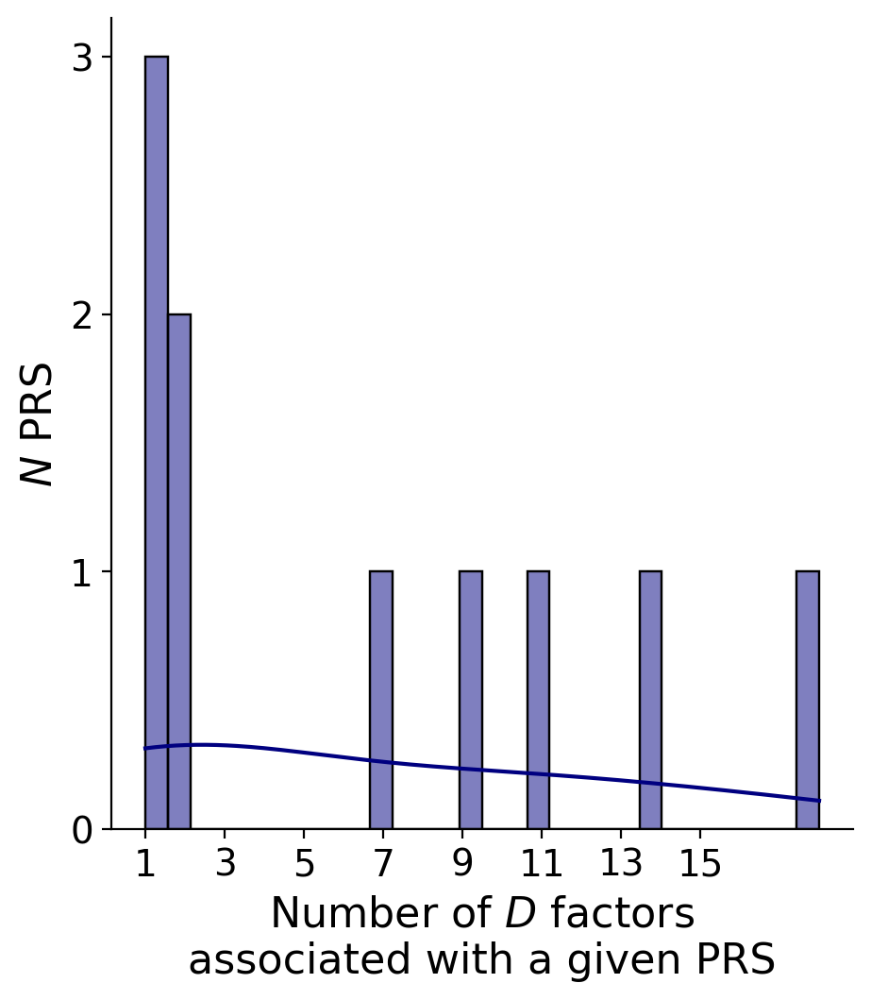

In [100]:
sns.displot(PRS_effects.groupby("SNP_id").apply(lambda x: x.Factor.nunique(), include_groups=False), kde=True, color="navy", bins=30)
# plt.title(textwrap.fill(model, 50) + "\n")
plt.xticks(ticks=np.arange(1,17,2), labels=np.arange(1,17,2), fontdict={"fontsize":14})
plt.xlabel(textwrap.fill("Number of $D$ factors associated with a given PRS", 30), fontsize=16)
plt.ylabel("$N$ PRS", fontsize=16)
plt.yticks(ticks=np.arange(0,4,1), labels=np.arange(0,4,1), fontdict={"fontsize":14})
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_D-factors_associated-with-a-given-PRS.png"),
            transparent=True, bbox_inches="tight", dpi=200)
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_D-factors_associated-with-a-given-PRS.eps"),
            transparent=True, bbox_inches="tight", dpi=200)
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_D-factors_associated-with-a-given-PRS.pdf"),
            transparent=True, bbox_inches="tight", dpi=200)


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


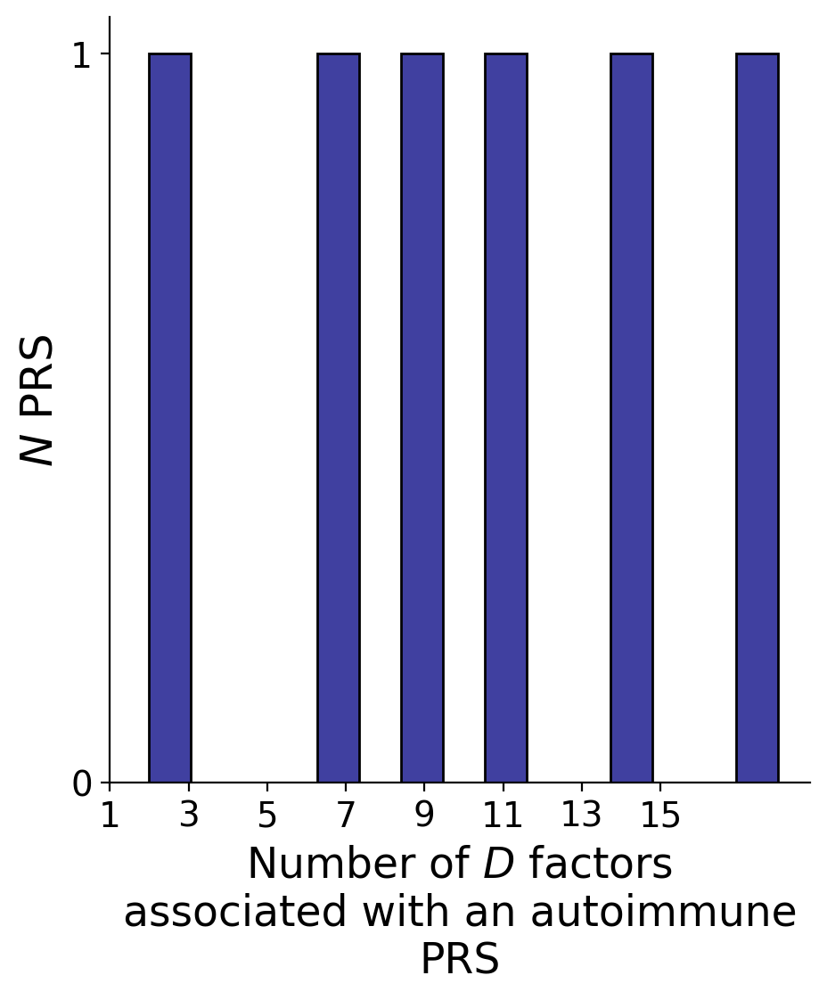

In [263]:
sns.displot(PRS_effects.loc[PRS_effects.SNP_id.isin(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'UC'])
            ].groupby("SNP_id").apply(lambda x: x.Factor.nunique(), include_groups=False),
            kde=False, color="navy", bins=15)
# plt.title(textwrap.fill(model, 50) + "\n")
plt.xticks(ticks=np.arange(1,17,2), labels=np.arange(1,17,2), fontdict={"fontsize":14})
plt.xlabel(textwrap.fill("Number of $D$ factors associated with an autoimmune PRS", 30), fontsize=17)
plt.ylabel("$N$ PRS", fontsize=18)
plt.yticks(ticks=np.arange(0,2,1), labels=np.arange(0,2,1), fontdict={"fontsize":14})
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_D-factors_associated-with-autoimmune-PRS.png"),
            transparent=True, bbox_inches="tight", dpi=200)
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_D-factors_associated-with-autoimmune-PRS.eps"),
            transparent=True, bbox_inches="tight", dpi=200)
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_D-factors_associated-with-autoimmune-PRS.pdf"),
            transparent=True, bbox_inches="tight", dpi=200)

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


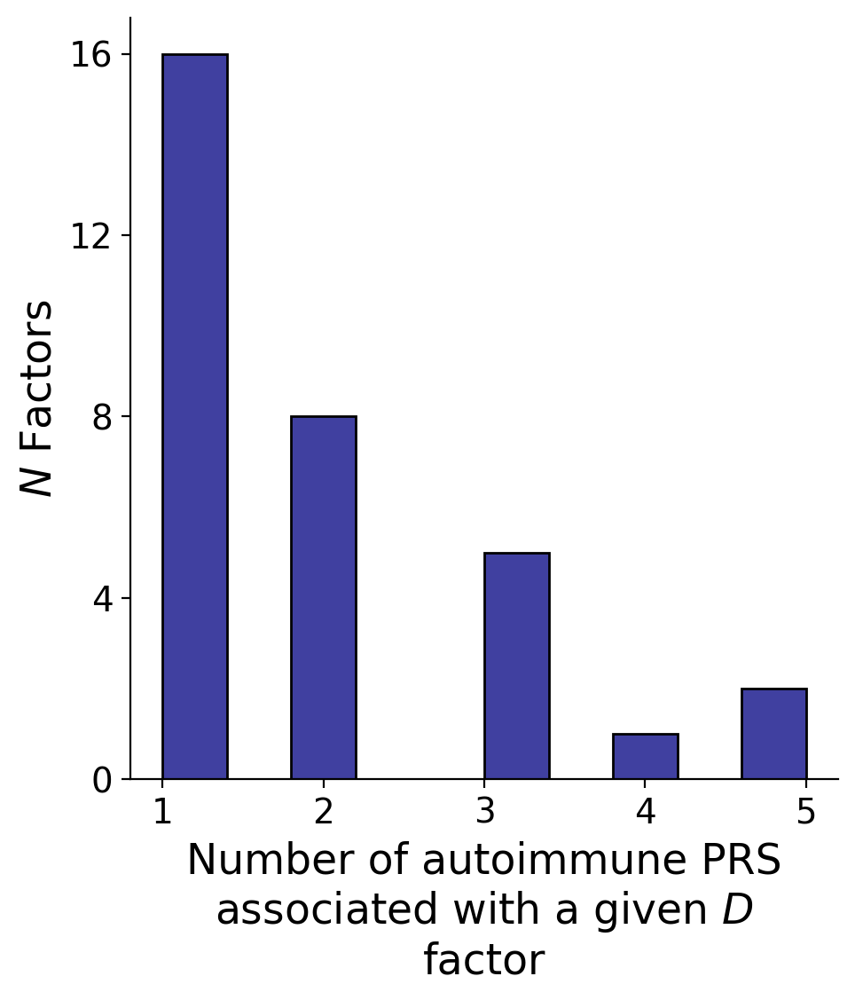

In [259]:
sns.displot(PRS_effects.loc[PRS_effects.SNP_id.isin(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'UC'])
            ].groupby("Factor").apply(lambda x: x.SNP_id.nunique(), include_groups=False), color="navy", kde=False, bins=10)
# plt.xticks(ticks=np.arange(1,226,25), labels=np.arange(1,226,25), fontdict={"fontsize":13})
plt.xlabel(textwrap.fill("Number of autoimmune PRS associated with a given $D$ factor", 30), fontsize=17)
plt.ylabel("$N$ Factors", fontsize=17)
plt.yticks(ticks=np.arange(0,20,4), labels=np.arange(0,20,4), fontdict={"fontsize":14})
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_autoimmune-PRS_associated-with-a-given-D-factor.png"),
            transparent=True, bbox_inches="tight", dpi=200)
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_autoimmune-PRS_associated-with-a-given-D-factor.eps"),
            transparent=True, bbox_inches="tight", dpi=200)
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_N_autoimmune-PRS_associated-with-a-given-D-factor.pdf"),
            transparent=True, bbox_inches="tight", dpi=200)


In [30]:
PRS_effects.loc[
PRS_effects.SNP_id.isin(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'UC'])
].groupby("Factor").apply(lambda x: x.SNP_id.unique())

/tmp/ipykernel_1261514/4165936203.py:3: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


Factor
D_Factor126                      [Psoriasis]
D_Factor144                      [Psoriasis]
D_Factor147                             [MS]
D_Factor19                         [CeD, RA]
D_Factor210                        [CeD, RA]
D_Factor293                [RA, T1D, UC, MS]
D_Factor308                        [CeD, MS]
D_Factor314                      [Psoriasis]
D_Factor325                        [CeD, MS]
D_Factor36                       [Psoriasis]
D_Factor376                      [Psoriasis]
D_Factor377                            [CeD]
D_Factor385                             [MS]
D_Factor388                      [Psoriasis]
D_Factor395                   [CeD, T1D, MS]
D_Factor41                         [CeD, RA]
D_Factor450                        [CeD, MS]
D_Factor454           [CeD, RA, T1D, UC, MS]
D_Factor465                      [Psoriasis]
D_Factor474                      [Psoriasis]
D_Factor484                    [CeD, RA, MS]
D_Factor503                            [CeD]
D_F

## Single-gene testing

In [242]:
prs_single_gene = pd.read_csv("/data/danai/Data/OneK1K/Benchmarks/TensorQTL/All_celltypes_gene-level-testing-results_tensorQTL_PRS_significant_BH_005.tsv", sep="\t")
prs_single_gene 

,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,BY_corrected_pvalue
0,RA,ENSG00000237541,9.695591e-10,0.538064,0.087115,CD4-ET,6.574692e-05,6.574692e-05,1.058272e-03
1,Multiple_sclerosis,ENSG00000206503,2.467539e-15,-0.145157,0.018034,CD4-ET,3.151968e-10,3.151968e-10,5.073453e-09
2,Psoriasis,ENSG00000234745,2.132760e-27,0.255924,0.022870,CD4-ET,7.809746e-22,7.809746e-22,1.257068e-20
3,Psoriasis,ENSG00000204525,4.412189e-07,0.110659,0.021759,CD4-ET,2.163826e-02,2.163826e-02,3.482926e-01
4,T1D,ENSG00000116198,1.042748e-06,-0.356039,0.072433,CD4-ET,4.545638e-02,4.545638e-02,7.316726e-01
...,...,...,...,...,...,...,...,...,...
123,Multiple_sclerosis,ENSG00000237541,1.138665e-06,-0.505952,0.103139,Plasma,4.886209e-02,4.886209e-02,7.864915e-01
124,Psoriasis,ENSG00000234745,9.135416e-09,0.164066,0.028236,Plasma,5.702061e-04,5.702061e-04,9.178121e-03
125,T1D,ENSG00000237541,1.073929e-16,0.861978,0.101536,Plasma,1.474693e-11,1.474693e-11,2.373687e-10
126,Psoriasis,ENSG00000234745,2.628227e-09,0.187778,0.031192,CD4-SOX4,1.739286e-04,1.739286e-04,2.799580e-03


In [243]:
prs_single_gene = prs_single_gene.merge(adata.var.GeneSymbol.reset_index().rename(columns={"Geneid":"gene"}), on="gene", how="left")
prs_single_gene.head()

,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,BY_corrected_pvalue,GeneSymbol
0,RA,ENSG00000237541,9.695591e-10,0.538064,0.087115,CD4-ET,6.574692e-05,6.574692e-05,1.058272e-03,HLA-DQA2
1,Multiple_sclerosis,ENSG00000206503,2.467539e-15,-0.145157,0.018034,CD4-ET,3.151968e-10,3.151968e-10,5.073453e-09,HLA-A
2,Psoriasis,ENSG00000234745,2.132760e-27,0.255924,0.022870,CD4-ET,7.809746e-22,7.809746e-22,1.257068e-20,HLA-B
3,Psoriasis,ENSG00000204525,4.412189e-07,0.110659,0.021759,CD4-ET,2.163826e-02,2.163826e-02,3.482926e-01,HLA-C
4,T1D,ENSG00000116198,1.042748e-06,-0.356039,0.072433,CD4-ET,4.545638e-02,4.545638e-02,7.316726e-01,CEP104


In [244]:
prs_single_gene.loc[prs_single_gene.PRS == "RA"]

,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,BY_corrected_pvalue,GeneSymbol
0,RA,ENSG00000237541,9.695591e-10,0.538064,0.087115,CD4-ET,6.574692e-05,6.574692e-05,1.058272e-03,HLA-DQA2
6,RA,ENSG00000196735,1.166233e-20,0.526064,0.055150,NK,2.372508e-15,2.372508e-15,3.818824e-14,HLA-DQA1
7,RA,ENSG00000237541,5.665507e-48,1.219178,0.079149,NK,3.111895e-41,3.111895e-41,5.008952e-40,HLA-DQA2
16,RA,ENSG00000196735,2.661722e-12,0.264000,0.037251,CD4-NC,2.564921e-07,2.564921e-07,4.128535e-06,HLA-DQA1
17,RA,ENSG00000237541,4.050251e-28,0.852937,0.075109,CD4-NC,1.711295e-22,1.711295e-22,2.754525e-21,HLA-DQA2
26,RA,ENSG00000237541,1.091954e-20,0.845939,0.088613,CD8-S100B,2.306839e-15,2.306839e-15,3.713122e-14,HLA-DQA2
32,RA,ENSG00000196735,8.754150e-33,0.389369,0.031432,CD8-ET,8.013992e-27,8.013992e-27,1.289944e-25,HLA-DQA1
33,RA,ENSG00000237541,5.277646e-41,0.895102,0.063607,CD8-ET,9.662849e-35,9.662849e-35,1.555346e-33,HLA-DQA2
48,RA,ENSG00000237541,1.941371e-12,0.364210,0.051060,B-IN,1.904175e-07,1.904175e-07,3.064988e-06,HLA-DQA2
49,RA,ENSG00000198502,1.390480e-19,-0.161108,0.017410,B-IN,2.386717e-14,2.386717e-14,3.841695e-13,HLA-DRB5


In [245]:
prs_single_gene.loc[(prs_single_gene.GeneSymbol == "HLA-DQA2") & (prs_single_gene.celltype == "NK")]

,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,BY_corrected_pvalue,GeneSymbol
7,RA,ENSG00000237541,5.665507e-48,1.219178,0.079149,NK,3.111895e-41,3.111895e-41,5.008952e-40,HLA-DQA2
11,Multiple_sclerosis,ENSG00000237541,1.180216e-09,-0.523855,0.085262,NK,7.905584e-05,7.905584e-05,1.272494e-03,HLA-DQA2
14,T1D,ENSG00000237541,1.501903e-14,0.674162,0.086318,NK,1.755215e-09,1.755215e-09,2.825219e-08,HLA-DQA2


In [247]:
prs_single_gene.PRS.nunique()

13

In [248]:
prs_single_gene.PRS.unique()

array(['RA', 'Multiple_sclerosis', 'Psoriasis', 'T1D', 'Celiac',
       'Hair_color', 'Platelet_count', 'PDW', 'UC', 'RBDW', 'T2D',
       'Monocyte_percentage', 'IBD'], dtype=object)

In [250]:
prs_single_gene.loc[prs_single_gene.PRS == "Hair_color"]

,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,BY_corrected_pvalue,GeneSymbol
8,Hair_color,ENSG00000117010,2.684146e-07,0.402548,0.077687,NK,0.013526,0.013526,0.217715,ZNF684
50,Hair_color,ENSG00000126106,1.066398e-07,0.514207,0.096004,B-IN,0.005578,0.005578,0.089792,TMEM53


# LIVI results

In [31]:
PRS_colors = dict(
    zip(["CeD", "MS", "Psoriasis", "RA", "T1D", "UC"],
        sns.color_palette("Set2", 6))
)
PRS_colors 

{'CeD': (0.4, 0.7607843137254902, 0.6470588235294118),
 'MS': (0.9882352941176471, 0.5529411764705883, 0.3843137254901961),
 'Psoriasis': (0.5529411764705883, 0.6274509803921569, 0.796078431372549),
 'RA': (0.9058823529411765, 0.5411764705882353, 0.7647058823529411),
 'T1D': (0.6509803921568628, 0.8470588235294118, 0.32941176470588235),
 'UC': (1.0, 0.8509803921568627, 0.1843137254901961)}

In [32]:
PRS_colors_dark = dict(
    zip(["CeD", "MS", "Psoriasis", "RA", "T1D", "UC"],
        ["peru", "royalblue", "slateblue", "darkred", "darkgreen", "mediumseagreen"])
) 

In [33]:
PRS_effects.groupby("SNP_id").apply(lambda x: x.Factor.nunique())

/tmp/ipykernel_1261514/1030827017.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


SNP_id
CeD                 18
Lymphocyte_count     1
MS                  14
Psoriasis           11
RA                   9
RBC                  1
RBDW                 2
T1D                  7
T2D                  1
UC                   2
dtype: int64

In [35]:
PRS_effects.nlargest(3, columns="effect_size", keep="all")

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS
16,D_Factor293,RA,0.429920,0.033767,2.003210e-40,1.028314e-36,RA__D_Factor293
10,D_Factor126,Psoriasis,0.370971,0.041848,1.425287e-19,2.194942e-16,Psoriasis__D_Factor126
7,D_Factor72,CeD,0.337784,0.031566,2.603542e-28,6.682424e-25,CeD__D_Factor72


In [36]:
PRS_effects.nsmallest(5, columns="effect_size", keep="all")

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS
38,D_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__D_Factor454
8,D_Factor72,RA,-0.434800,0.029862,6.977421e-54,5.372614e-50,RA__D_Factor72
53,D_Factor661,Psoriasis,-0.361534,0.039125,3.339088e-21,6.427745e-18,Psoriasis__D_Factor661
20,D_Factor308,CeD,-0.334436,0.042142,7.147283e-16,7.862012e-13,CeD__D_Factor308
4,D_Factor41,RA,-0.273531,0.025460,1.545146e-28,4.759051e-25,RA__D_Factor41


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


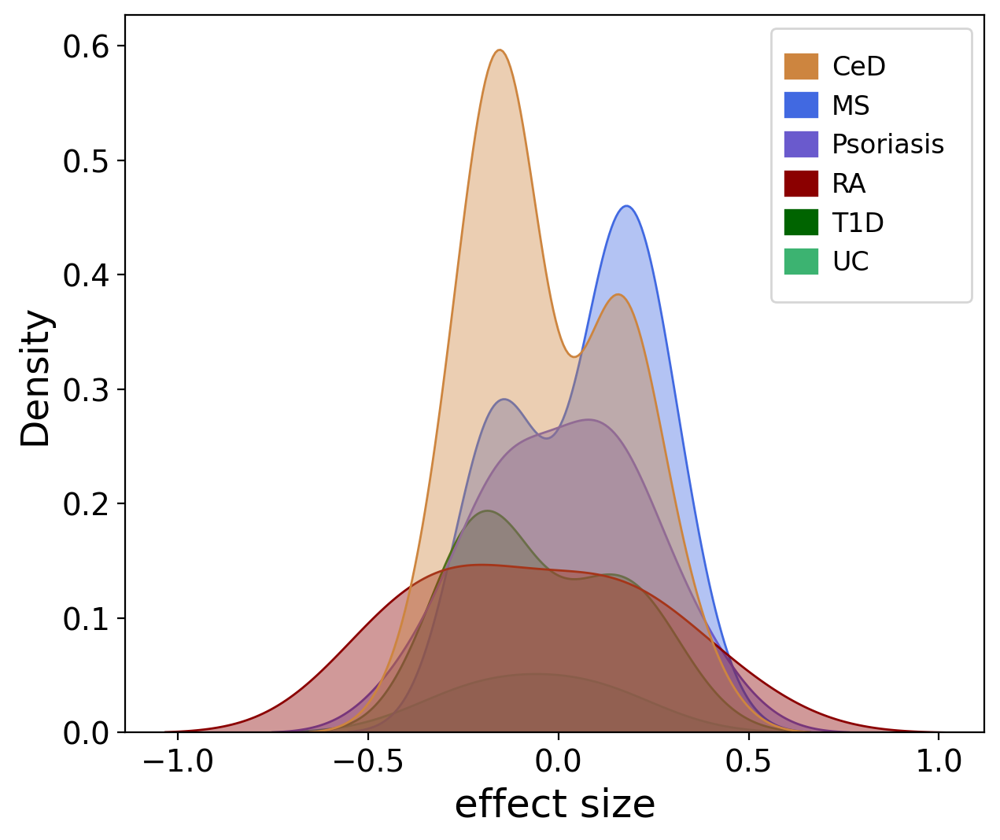

In [1579]:
fig, axs = plt.subplots(constrained_layout=False)

sns.kdeplot(data=PRS_effects.loc[PRS_effects.SNP_id.isin(["MS", "CeD", "T1D", "RA", "Psoriasis", "UC"])].drop(columns=["Celltype"]).drop_duplicates(), 
                 x="effect_size", hue="SNP_id", alpha=0.4, palette=PRS_colors_dark, fill=True, ax=axs)
axs.set_xlabel("effect size", fontsize=18)
axs.set_ylabel("Density", fontsize=17)

legend_handles = []
for D, cD in PRS_colors_dark.items():
    legend_handles.append(Line2D([0], [0], color=cD, lw=12, label=D))
    
axs.legend(handles=legend_handles, fontsize=12, handlelength=0.3, handletextpad=1, borderpad=1)

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associations_effect-size-KDEplot_colored-by-PRS.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associations_effect-size-KDEplot_colored-by-PRS.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associations_effect-size-KDEplot_colored-by-PRS.png"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


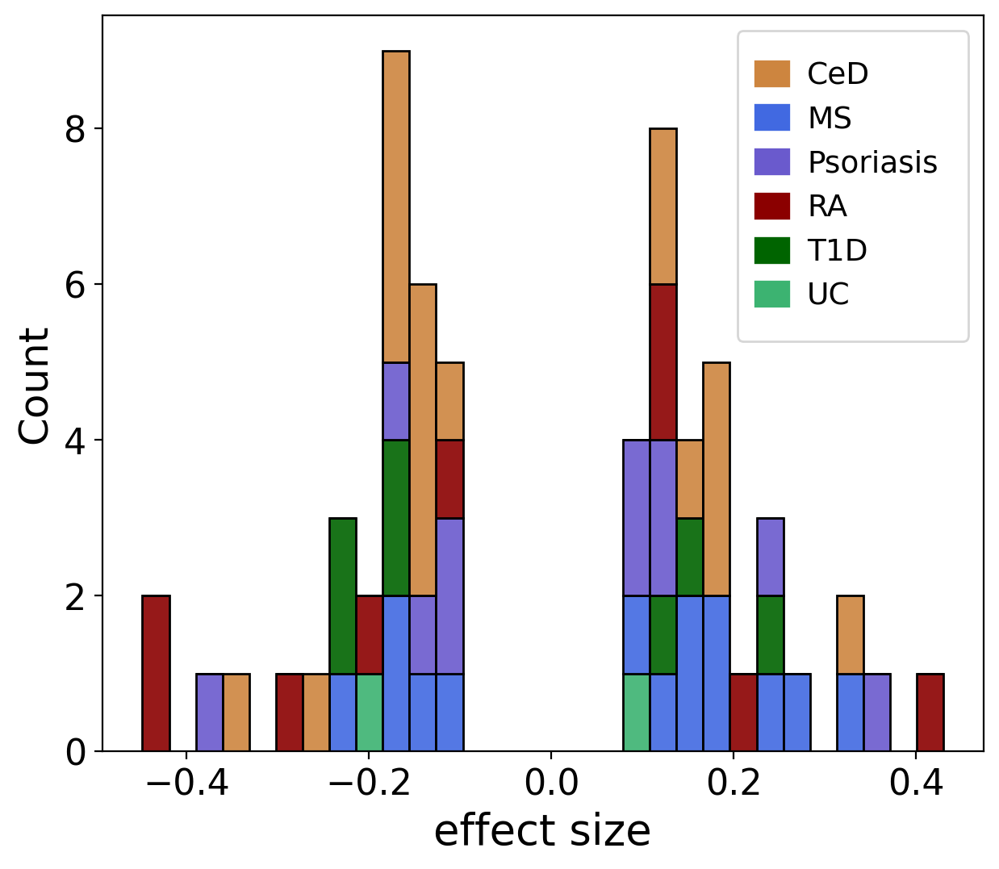

In [1671]:
fig, axs = plt.subplots(constrained_layout=False)

sns.histplot(data=PRS_effects.loc[PRS_effects.SNP_id.isin(["MS", "CeD", "T1D", "RA", "Psoriasis", "UC"])].drop(columns=["Celltype"]).drop_duplicates(), 
                 x="effect_size", hue="SNP_id", bins=30, alpha=0.9, palette=PRS_colors_dark, multiple="stack", ax=axs)

axs.set_xlabel("effect size", fontsize=19)
axs.set_ylabel("Count", fontsize=18)
axs.tick_params(axis="both", which="major", labelsize=16)

legend_handles = []
for D, cD in PRS_colors_dark.items():
    legend_handles.append(Line2D([0], [0], color=cD, lw=12, label=D))
    
axs.legend(handles=legend_handles, fontsize=13.5, handlelength=0.3, handletextpad=1, borderpad=1)

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associations_effect-size-Histplot_colored-by-PRS.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associations_effect-size-Histplot_colored-by-PRS.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associations_effect-size-Histplot_colored-by-PRS.png"), 
            transparent=True, dpi=400, bbox_inches="tight")

### Scatterplots of D factors colored by PRS

In [44]:
tmp = D.filter(PRS_effects.Factor)
tmp = tmp.merge(PRS, right_index=True, left_index=True, how="left")
tmp

,D_Factor19,D_Factor36,D_Factor41,D_Factor69,D_Factor72,D_Factor126,D_Factor144,D_Factor147,D_Factor210,D_Factor223,...,Height,Platelet_count,RBC,Leukocyte_count,RBDW,UC,Lymphocyte_count,T2D,Endometriosis,Multiple_sclerosis
individual,,,,,,,,,,,,,,,,,,,,,
691_692,0.123229,0.705303,1.854355,-0.324754,1.797535,1.440416,-0.234058,0.037699,-4.273785,1.128427,...,-0.144022,0.684278,-0.251568,1.168590,-2.590094,-0.338635,1.010230,1.255989,0.183071,-0.212141
693_694,2.047674,-1.734437,-0.180548,0.041680,-0.769870,2.011178,-0.090131,-0.362218,0.569802,-0.681610,...,-0.459942,-0.073953,1.521804,0.880476,-0.007997,-0.743467,0.258249,-0.445195,0.306532,-1.930667
688_689,0.984981,-0.688939,1.634096,-1.553127,1.994873,-0.403126,-0.512309,-0.243749,2.270372,0.222401,...,-0.389158,-0.044611,1.307181,1.319138,-0.096182,-2.242711,0.076434,0.921082,-1.115088,-1.663811
683_684,0.059177,1.016745,-0.101119,0.254557,-0.135661,0.492243,-0.816543,2.851629,-0.613692,-0.739146,...,-1.586118,0.493378,-0.344106,0.281813,0.221220,-0.326834,0.806733,-0.695708,-1.368122,-1.251894
684_685,-1.115713,-0.700316,0.166186,-0.040473,1.347377,-0.216282,-0.182701,0.844044,-0.421337,1.483429,...,-0.554570,-0.548276,0.662240,0.370617,2.396896,0.741925,-0.392671,0.033624,-0.253174,0.867818
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
840_841,0.335624,1.124358,-0.630552,-0.267876,0.755155,0.280637,-0.372132,0.390900,1.747408,0.998085,...,0.731011,-0.238728,1.173662,0.761485,0.017823,-0.419462,-0.098836,0.856233,-0.628667,0.449426
801_802,0.967749,-0.998454,1.120464,2.751076,0.385059,-1.881693,0.284520,4.646238,-0.536917,-1.456537,...,-0.174954,-0.015106,-0.315019,-0.172859,-1.273162,0.098815,0.178686,-0.114730,-0.508913,-0.306601
797_798,0.331820,-0.958138,-0.084024,-0.972840,0.616998,-1.183620,-0.169536,-1.491386,0.557510,-3.360758,...,1.726136,1.443055,-0.393431,-1.030489,-1.562931,1.745476,-0.040868,0.731864,-0.484769,-1.481438


In [45]:
tmp = tmp.merge(adata.obs.filter(["individual", "sex", "latent"]).drop_duplicates().set_index("individual"), right_index=True, left_index=True)

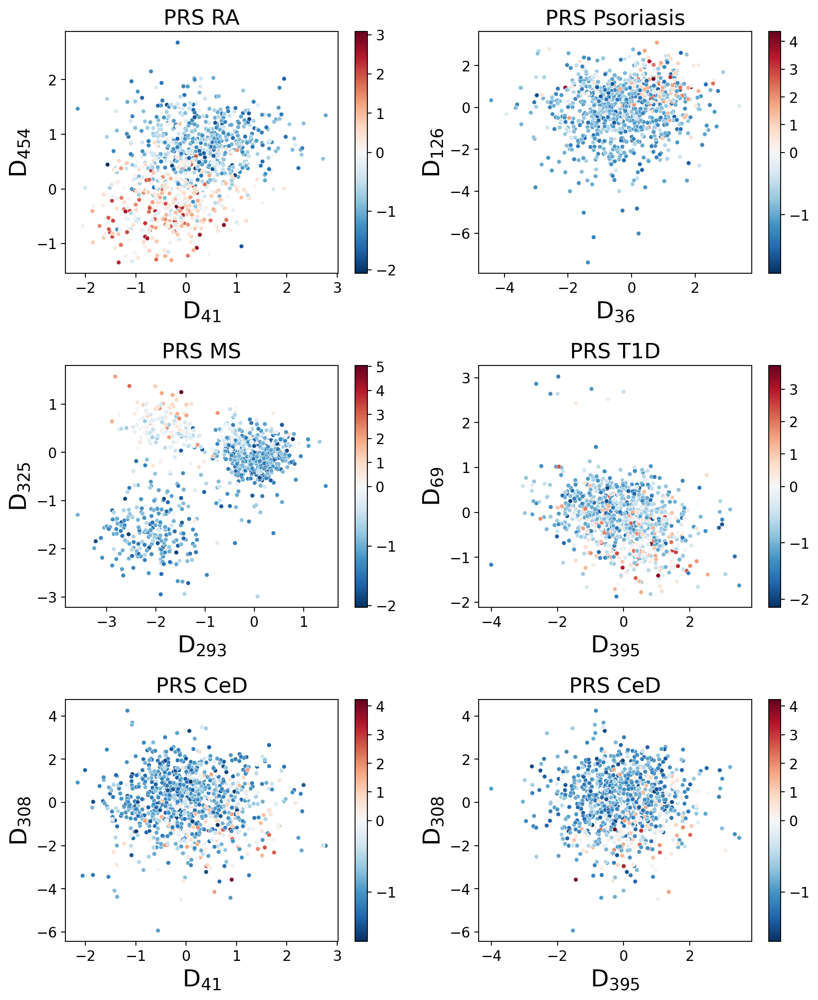

In [56]:
fig, axs = plt.subplots(ncols=2, nrows=3, figsize=(10,12), constrained_layout=False)
axs = axs.flatten()

sns.scatterplot(x="D_Factor41", y="D_Factor454", hue="RA", data=tmp, ax=axs[0], s=14, palette="RdBu_r", legend=False)
sm = cm.ScalarMappable(cmap="RdBu_r", norm=colors.TwoSlopeNorm(vcenter=0.0, vmin=tmp.RA.min(), vmax=tmp.RA.max()))
cb = plt.colorbar(sm, ax=axs[0])
axs[0].set_title(label="PRS RA", fontdict={'fontsize':18}, loc='center')
axs[0].set_xlabel("D$_{41}$")
axs[0].set_ylabel("D$_{454}$")
cb.ax.tick_params(labelsize=12)


sns.scatterplot(x="D_Factor36", y="D_Factor126", hue="Psoriasis", data=tmp, ax=axs[1], s=14, palette="RdBu_r", legend=False)
sm = cm.ScalarMappable(cmap="RdBu_r", norm=colors.TwoSlopeNorm(vcenter=0.0, vmin=tmp.Psoriasis.min(), vmax=tmp.Psoriasis.max()))
cb = plt.colorbar(sm, ax=axs[1])
axs[1].set_title(label="PRS Psoriasis", fontdict={'fontsize':18}, loc='center')
axs[1].set_xlabel("D$_{36}$")
axs[1].set_ylabel("D$_{126}$")
cb.ax.tick_params(labelsize=12) 


sns.scatterplot(x="D_Factor293", y="D_Factor325", hue="Multiple_sclerosis", data=tmp, ax=axs[2], s=14, palette="RdBu_r", legend=False)
sm = cm.ScalarMappable(cmap="RdBu_r", norm=colors.TwoSlopeNorm(vcenter=0.0, vmin=tmp.Multiple_sclerosis.min(), vmax=tmp.Multiple_sclerosis.max()))
cb = plt.colorbar(sm, ax=axs[2])
axs[2].set_title(label="PRS MS", fontdict={'fontsize':18}, loc='center')
axs[2].set_xlabel("D$_{293}$")
axs[2].set_ylabel("D$_{325}$")
cb.ax.tick_params(labelsize=12) 


sns.scatterplot(x="D_Factor395", y="D_Factor69", hue="T1D", data=tmp, ax=axs[3], s=14, palette="RdBu_r", legend=False)
# sns.scatterplot(x="U_Factor293", y="U_Factor69", hue="T1D", data=tmp, ax=axs[3], s=12, palette="vlag", legend=False)
sm = cm.ScalarMappable(cmap="RdBu_r", norm=colors.TwoSlopeNorm(vcenter=0.0, vmin=tmp.T1D.min(), vmax=tmp.T1D.max()))
cb = plt.colorbar(sm, ax=axs[3])
axs[3].set_title(label="PRS T1D", fontdict={'fontsize':18}, loc='center')
axs[3].set_xlabel("D$_{395}$")
axs[3].set_ylabel("D$_{69}$")
cb.ax.tick_params(labelsize=12) 


# sns.scatterplot(x="D_Factor454", y="D_Factor325", hue="Multiple_sclerosis", data=tmp, ax=axs[4], s=14, palette="RdBu_r", legend=False)
# sm = cm.ScalarMappable(cmap="RdBu_r", norm=colors.TwoSlopeNorm(vcenter=0.0, vmin=tmp.Multiple_sclerosis.min(), vmax=tmp.Multiple_sclerosis.max()))
# cb = plt.colorbar(sm, ax=axs[4])
# axs[4].set_title(label="PRS MS", fontdict={'fontsize':18}, loc='center')
# axs[4].set_xlabel("D$_{454}$")
# axs[4].set_ylabel("D$_{325}$")
# cb.ax.tick_params(labelsize=12) 
sns.scatterplot(x="D_Factor41", y="D_Factor308", hue="Celiac", data=tmp, ax=axs[4], s=14, palette="RdBu_r", legend=False)
sm = cm.ScalarMappable(cmap="RdBu_r", norm=colors.TwoSlopeNorm(vcenter=0.0, vmin=tmp.Celiac.min(), vmax=tmp.Celiac.max()))
cb = plt.colorbar(sm, ax=axs[4])
axs[4].set_title(label="PRS CeD", fontdict={'fontsize':18}, loc='center')
axs[4].set_xlabel("D$_{41}$")
axs[4].set_ylabel("D$_{308}$")
cb.ax.tick_params(labelsize=12) 


sns.scatterplot(x="D_Factor395", y="D_Factor308", hue="Celiac", data=tmp, ax=axs[5], s=14, palette="RdBu_r", legend=False)
sm = cm.ScalarMappable(cmap="RdBu_r", norm=colors.TwoSlopeNorm(vcenter=0.0, vmin=tmp.Celiac.min(), vmax=tmp.Celiac.max()))
cb = plt.colorbar(sm, ax=axs[5])
axs[5].set_title(label="PRS CeD", fontdict={'fontsize':18}, loc='center')
axs[5].set_xlabel("D$_{395}$")
axs[5].set_ylabel("D$_{308}$")
cb.ax.tick_params(labelsize=12) 


for ax in axs:
    ax.xaxis.label.set_fontsize(20)
    ax.yaxis.label.set_fontsize(20)
    ax.tick_params(labelsize=12)

# fig.delaxes(axs[-1])

plt.tight_layout()

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_context-effects_PRS2.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_context-effects_PRS2.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

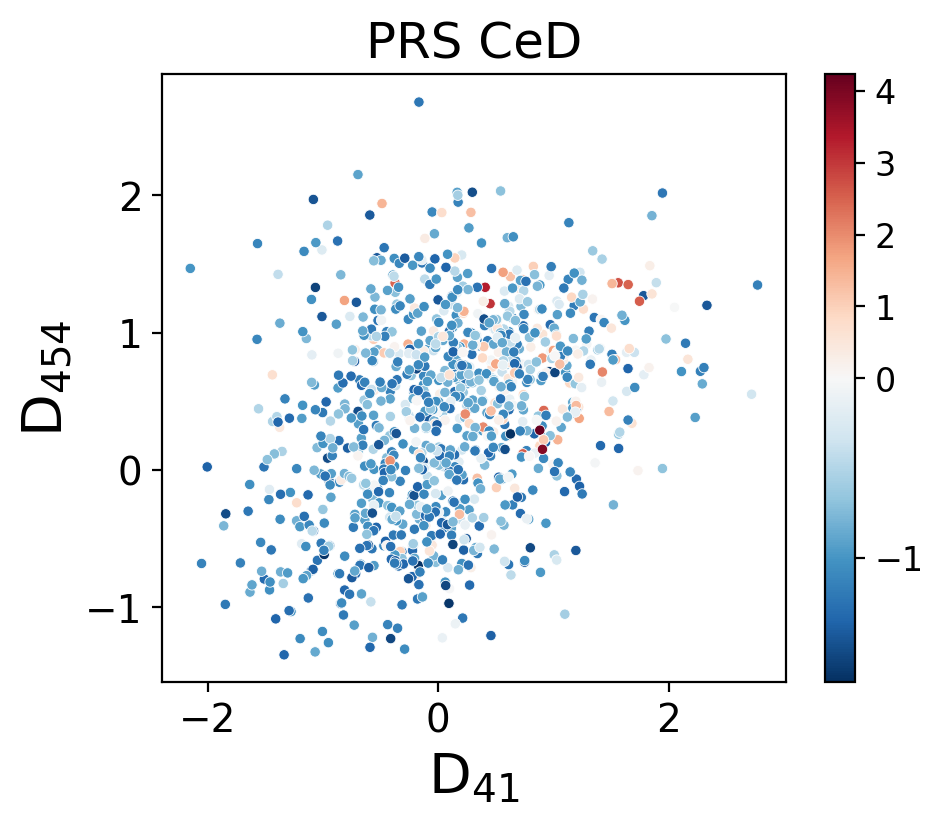

In [188]:
fig, axs = plt.subplots(figsize=(5,4), constrained_layout=False)

sns.scatterplot(x="D_Factor41", y="D_Factor454", hue="Celiac", data=tmp, ax=axs, s=14, palette="RdBu_r", legend=False)
sm = cm.ScalarMappable(cmap="RdBu_r", norm=colors.TwoSlopeNorm(vcenter=0.0, vmin=tmp.Celiac.min(), vmax=tmp.Celiac.max()))
cb = plt.colorbar(sm, ax=axs)
axs.set_title(label="PRS CeD", fontdict={'fontsize':18}, loc="center")
axs.set_xlabel("D$_{41}$", fontsize=20)
axs.set_ylabel("D$_{454}$", fontsize=20)
cb.ax.tick_params(labelsize=12) 

plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_D41_vs_D454_color-PRS-Celiac.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_D41_vs_D454_color-PRS-Celiac.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_D41_vs_D454_color-PRS-Celiac.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


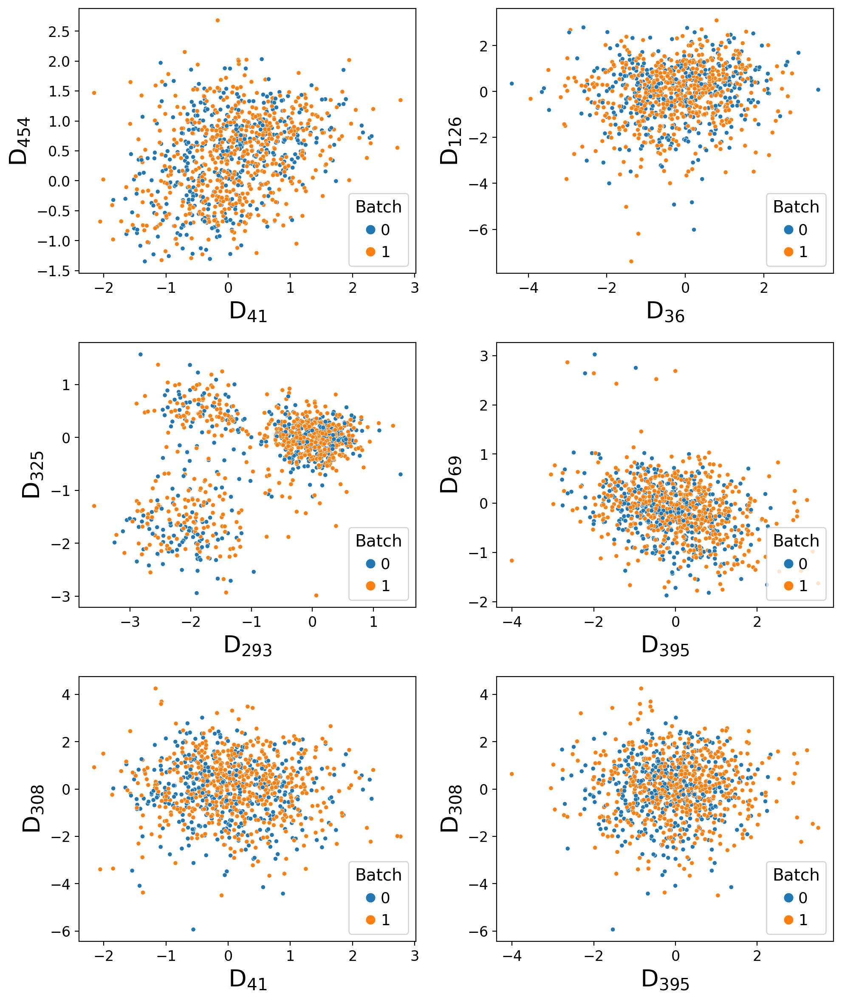

In [57]:
fig, axs = plt.subplots(ncols=2, nrows=3, figsize=(10,12), constrained_layout=False)
axs = axs.flatten()

sns.scatterplot(x="D_Factor41", y="D_Factor454", hue="latent", data=tmp, ax=axs[0], s=14)
axs[0].legend(title="Batch", markerscale=2.2, loc="lower right")
axs[0].set_xlabel("D$_{41}$")
axs[0].set_ylabel("D$_{454}$")


sns.scatterplot(x="D_Factor36", y="D_Factor126", hue="latent", data=tmp, ax=axs[1], s=14)
axs[1].legend(title="Batch", markerscale=2.2, loc="lower right")
axs[1].set_xlabel("D$_{36}$")
axs[1].set_ylabel("D$_{126}$")


sns.scatterplot(x="D_Factor293", y="D_Factor325", hue="latent", data=tmp, ax=axs[2], s=14)
axs[2].legend(title="Batch", markerscale=2.2, loc="lower right")
axs[2].set_xlabel("D$_{293}$")
axs[2].set_ylabel("D$_{325}$")


sns.scatterplot(x="D_Factor395", y="D_Factor69", hue="latent", data=tmp, ax=axs[3], s=14)
axs[3].legend(title="Batch", markerscale=2.2, loc="lower right")
axs[3].set_xlabel("D$_{395}$")
axs[3].set_ylabel("D$_{69}$")


sns.scatterplot(x="D_Factor41", y="D_Factor308", hue="latent", data=tmp, ax=axs[4], s=14)
axs[4].legend(title="Batch", markerscale=2.2, loc="lower right")
axs[4].set_xlabel("D$_{41}$")
axs[4].set_ylabel("D$_{308}$")


sns.scatterplot(x="D_Factor395", y="D_Factor308", hue="latent", data=tmp, ax=axs[5], s=14)
axs[5].legend(title="Batch", markerscale=2.2, loc="lower right")
axs[5].set_xlabel("D$_{395}$")
axs[5].set_ylabel("D$_{308}$")


for ax in axs:
    ax.xaxis.label.set_fontsize(20)
    ax.yaxis.label.set_fontsize(20)
    ax.tick_params(labelsize=12)

# fig.delaxes(axs[-1])

plt.tight_layout()

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associated-factors-colored-by-batch.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associated-factors-colored-by-batch.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


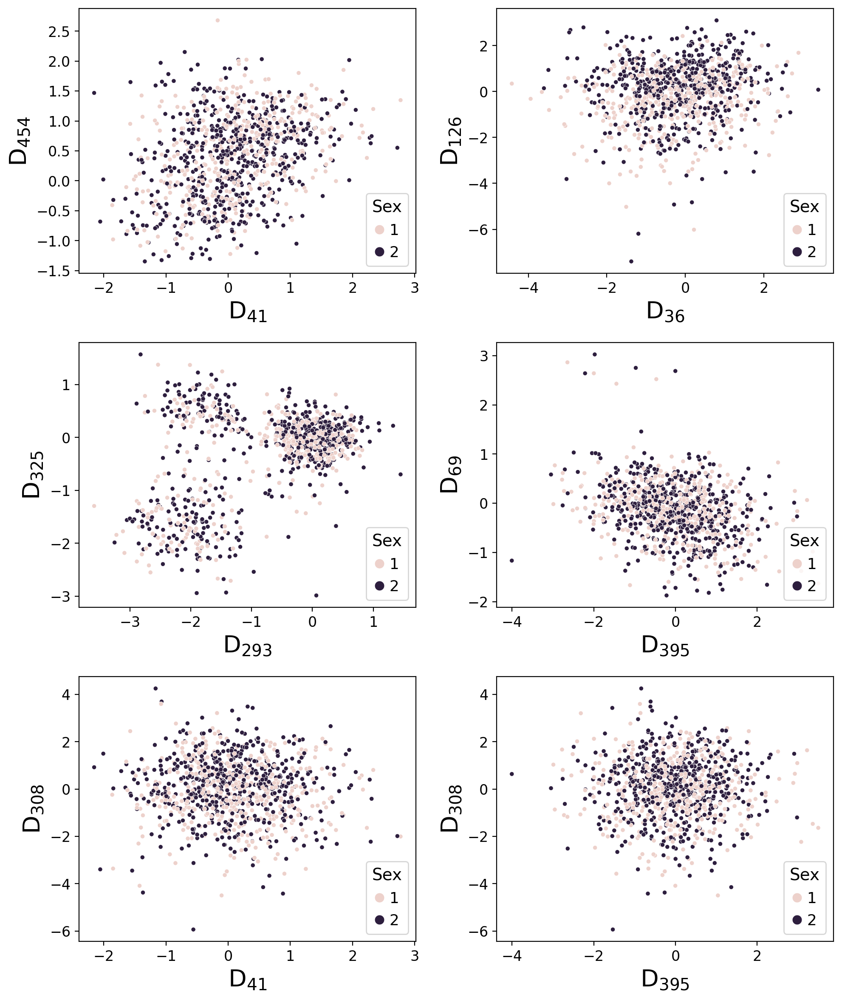

In [58]:
fig, axs = plt.subplots(ncols=2, nrows=3, figsize=(10,12), constrained_layout=False)
axs = axs.flatten()

sns.scatterplot(x="D_Factor41", y="D_Factor454", hue="sex", data=tmp, ax=axs[0], s=14)
axs[0].legend(title="Sex", markerscale=2.2, loc="lower right")
axs[0].set_xlabel("D$_{41}$")
axs[0].set_ylabel("D$_{454}$")


sns.scatterplot(x="D_Factor36", y="D_Factor126", hue="sex", data=tmp, ax=axs[1], s=14)
axs[1].legend(title="Sex", markerscale=2.2, loc="lower right")
axs[1].set_xlabel("D$_{36}$")
axs[1].set_ylabel("D$_{126}$")


sns.scatterplot(x="D_Factor293", y="D_Factor325", hue="sex", data=tmp, ax=axs[2], s=14)
axs[2].legend(title="Sex", markerscale=2.2, loc="lower right")
axs[2].set_xlabel("D$_{293}$")
axs[2].set_ylabel("D$_{325}$")


sns.scatterplot(x="D_Factor395", y="D_Factor69", hue="sex", data=tmp, ax=axs[3], s=14)
axs[3].legend(title="Sex", markerscale=2.2, loc="lower right")
axs[3].set_xlabel("D$_{395}$")
axs[3].set_ylabel("D$_{69}$")


sns.scatterplot(x="D_Factor41", y="D_Factor308", hue="sex", data=tmp, ax=axs[4], s=14)
axs[4].legend(title="Sex", markerscale=2.2, loc="lower right")
axs[4].set_xlabel("D$_{41}$")
axs[4].set_ylabel("D$_{308}$")


sns.scatterplot(x="D_Factor395", y="D_Factor308", hue="sex", data=tmp, ax=axs[5], s=14)
axs[5].legend(title="Sex", markerscale=2.2, loc="lower right")
axs[5].set_xlabel("D$_{395}$")
axs[5].set_ylabel("D$_{308}$")


for ax in axs:
    ax.xaxis.label.set_fontsize(20)
    ax.yaxis.label.set_fontsize(20)
    ax.tick_params(labelsize=12)

# fig.delaxes(axs[-1])

plt.tight_layout()

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associated-factors-colored-by-sex.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_PRS-associated-factors-colored-by-sex.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")


### Scatterplot of PRS vs. factor

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


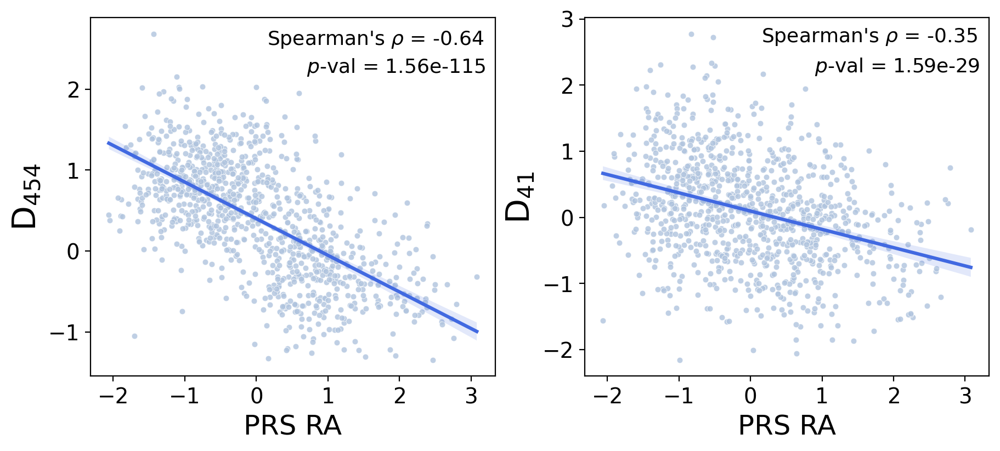

In [111]:
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(9,4), constrained_layout=True)
axs = axs.flatten()

# sns.scatterplot(x="RA", y="U_Factor454", hue="RA", data=tmp, palette="RdBu_r",
#                 ax=axs[0], s=11, legend=False, rasterized=True)
# # axs[0].set_title(label="PRS RA", fontdict={'fontsize':16}, loc='center')
# axs[0].set_xlabel("PRS RA", fontsize=18)
# axs[0].set_ylabel("$U$ Factor 454", fontsize=18)
# b, a = np.polyfit(tmp["RA"], tmp["U_Factor454"], deg=1)
# x = np.linspace(axs[0].get_xlim()[0], axs[0].get_xlim()[1] + 1)
# # Draw diagonal line
# axs[0].plot(x, a + b * x, c="grey", linestyle="--", scaley=True)
sns.scatterplot(x="RA", y="D_Factor454", data=tmp, ax=axs[0], s=15, color="lightsteelblue", alpha=0.8,
                legend=False, rasterized=True)
sns.regplot(x="RA", y="D_Factor454", data=tmp, color="royalblue", ax=axs[0], scatter=False)
axs[0].set_xlabel("PRS RA", fontsize=18)
axs[0].set_ylabel("D$_{454}$", fontsize=21)
corr, pval = spearmanr(tmp["RA"], tmp["D_Factor454"])
axs[0].text(x=0.15, y=2.55, s=fr"Spearman's $\rho$ = {np.round(corr,2)}",
            fontdict={"color":"black", "fontsize":13, "ma":"right"})
axs[0].text(x=0.7, y=2.2, s=f"$p$-val = {pval:.2e}",
            fontdict={"color":"black", "fontsize":13, "ma":"right"})

sns.scatterplot(x="RA", y="D_Factor41", data=tmp, color="lightsteelblue", alpha=0.8, ax=axs[1], s=15, 
                legend=False, rasterized=True)
# axs[0].set_title(label="PRS RA", fontdict={'fontsize':16}, loc='center')
sns.regplot(x="RA", y="D_Factor41", data=tmp, color="royalblue", ax=axs[1], scatter=False)
axs[1].set_xlabel("PRS RA", fontsize=18)
axs[1].set_ylabel("D$_{41}$", fontsize=21)
corr, pval = spearmanr(tmp["RA"], tmp["D_Factor41"])
axs[1].text(x=0.15, y=2.65, s=fr"Spearman's $\rho$ = {np.round(corr,2)}",
            fontdict={"color":"black", "fontsize":13, "ma":"right"})
axs[1].text(x=0.9, y=2.2, s=f"$p$-val = {pval:.2e}",
           fontdict={"color":"black", "fontsize":13, "ma":"right"})


plt.savefig(os.path.join(model_results_dir, "Figures", f"Scatterplot_PRS-RA_vs_D454_and_D41.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"Scatterplot_PRS-RA_vs_D454_and_D41.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"Scatterplot_PRS-RA_vs_D454_and_D41.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


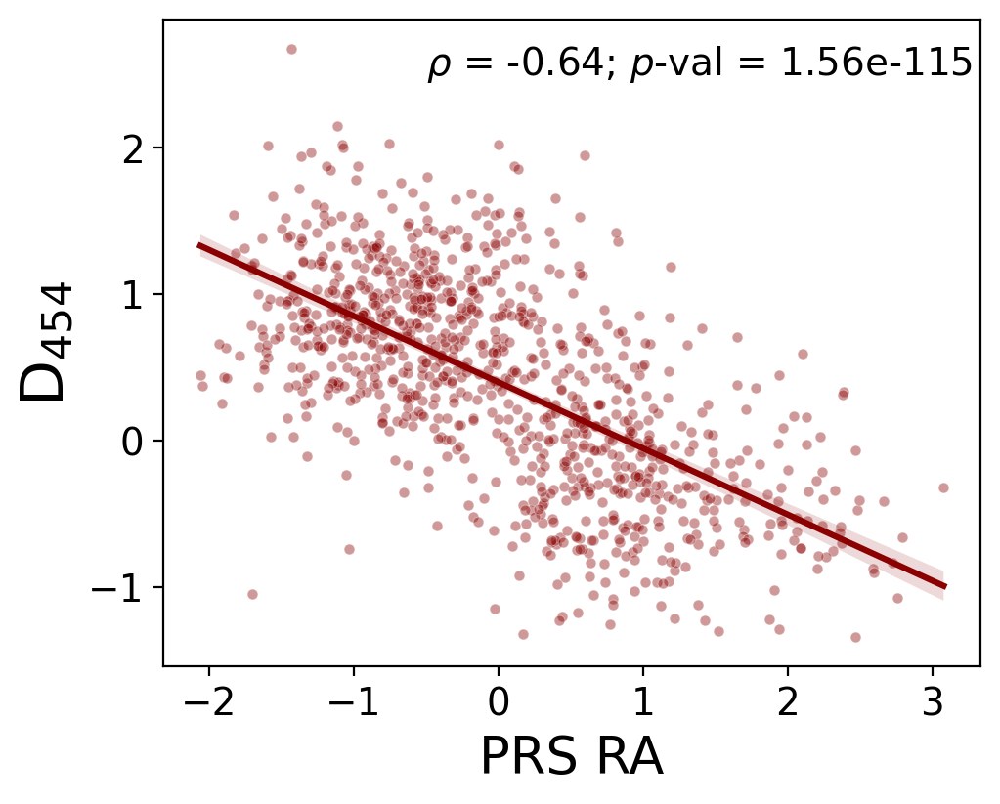

In [109]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(5,4), constrained_layout=True)

sns.scatterplot(x="RA", y="D_Factor454", data=tmp, color=PRS_colors_dark["RA"], alpha=0.4,
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="RA", y="D_Factor454", data=tmp, color=PRS_colors_dark["RA"], ax=axs, scatter=False)
axs.set_xlabel("PRS RA", fontsize=19)
axs.set_ylabel("D$_{454}$", fontsize=22)
corr, pval = spearmanr(tmp["RA"], tmp["D_Factor454"])
axs.text(x=-0.5, y=2.5, s=fr"$\rho$ = {np.round(corr,2)}; $p$-val = {pval:.2e}",
            fontdict={"color":"black", "fontsize":14, "ma":"right"})
# axs.text(x=0.87, y=2.15, s=f"$p$-val = {pval:.2e}",
#            fontdict={"color":"black", "fontsize":14, "ma":"right"})

plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-RA_vs_D454_v2.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-RA_vs_D454_v2.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-RA_vs_D454_v2.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


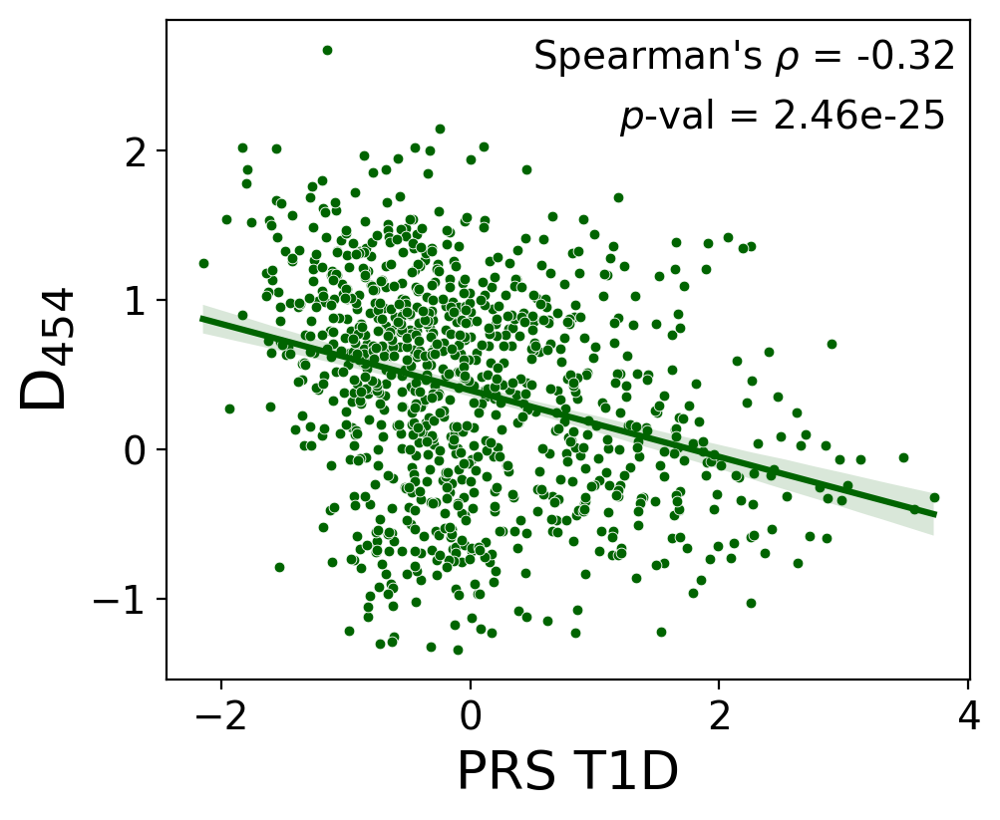

In [142]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(4.9,4), constrained_layout=True)

sns.scatterplot(x="T1D", y="D_Factor454", data=tmp, color=PRS_colors_dark["T1D"],
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="T1D", y="D_Factor454", data=tmp, color=PRS_colors_dark["T1D"], ax=axs, scatter=False)
axs.set_xlabel("PRS T1D", fontsize=19)
axs.set_ylabel("D$_{454}$", fontsize=22)
corr, pval = spearmanr(tmp["T1D"], tmp["D_Factor454"])
axs.text(x=0.5, y=2.55, s=fr"Spearman's $\rho$ = {np.round(corr,2)}",
            fontdict={"color":"black", "fontsize":14, "ma":"right"})
axs.text(x=1.2, y=2.15, s=f"$p$-val = {pval:.2e}",
           fontdict={"color":"black", "fontsize":14, "ma":"right"})

plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-T1D_vs_D454_color.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-T1D_vs_D454_color.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-T1D_vs_D454_color.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


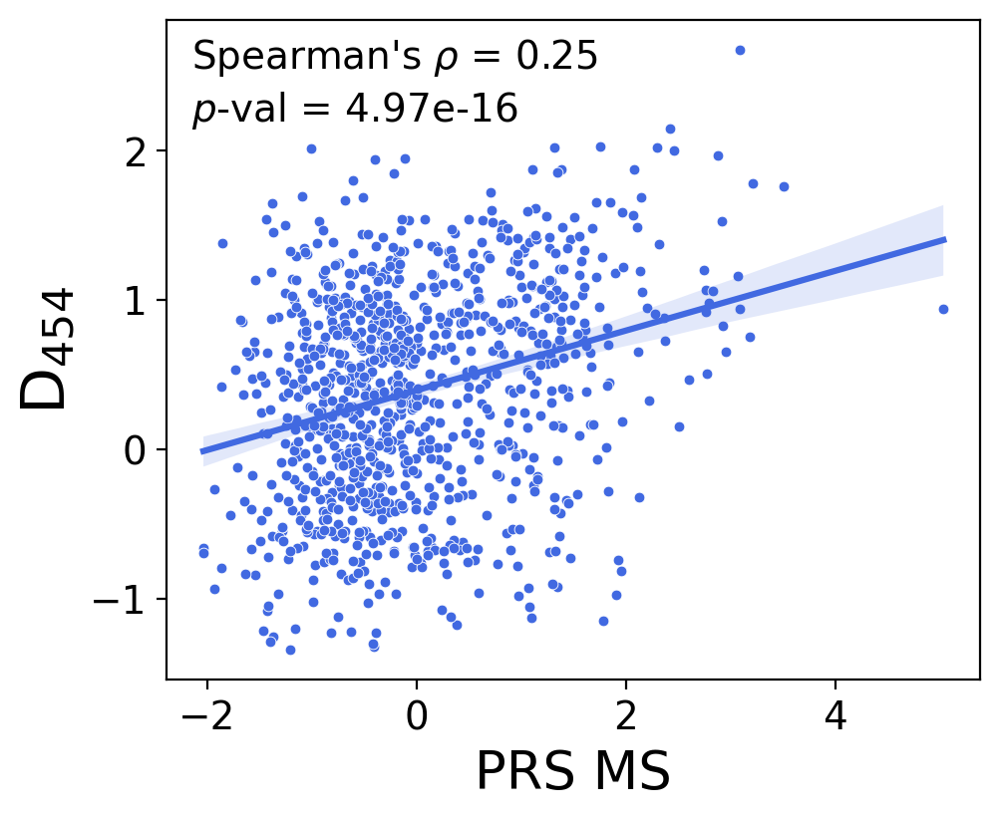

In [143]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(4.9,4), constrained_layout=True)

sns.scatterplot(x="Multiple_sclerosis", y="D_Factor454", data=tmp, color=PRS_colors_dark["MS"],
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="Multiple_sclerosis", y="D_Factor454", data=tmp, color=PRS_colors_dark["MS"], ax=axs, scatter=False)
axs.set_xlabel("PRS MS", fontsize=19)
axs.set_ylabel("D$_{454}$", fontsize=22)
corr, pval = spearmanr(tmp["Multiple_sclerosis"], tmp["D_Factor454"])
axs.text(x=-2.15, y=2.55, s=fr"Spearman's $\rho$ = {np.round(corr,2)}",
            fontdict={"color":"black", "fontsize":14, "ma":"right"})
axs.text(x=-2.15, y=2.2, s=f"$p$-val = {pval:.2e}",
           fontdict={"color":"black", "fontsize":14, "ma":"right"})

plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-MS_vs_D454_color.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-MS_vs_D454_color.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-MS_vs_D454_color.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


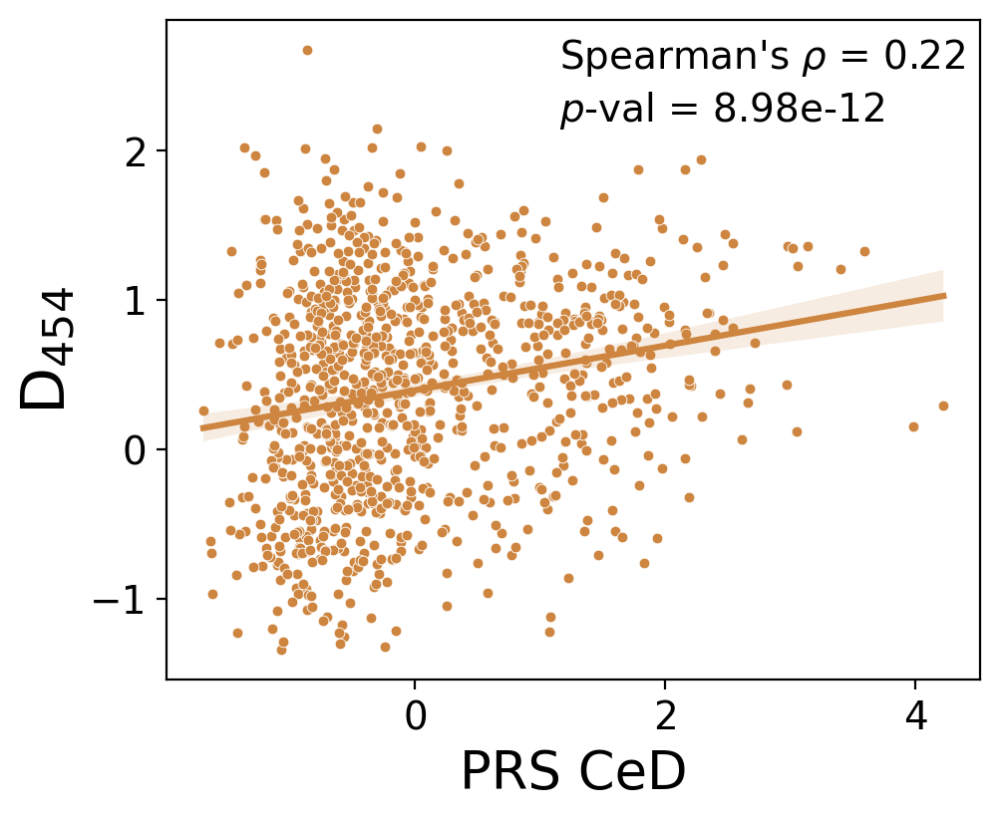

In [191]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(4.9,4), constrained_layout=True)

sns.scatterplot(x="Celiac", y="D_Factor454", data=tmp, color=PRS_colors_dark["CeD"],
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="Celiac", y="D_Factor454", data=tmp, color=PRS_colors_dark["CeD"], ax=axs, scatter=False)
axs.set_xlabel("PRS CeD", fontsize=19)
axs.set_ylabel("D$_{454}$", fontsize=22)
corr, pval = spearmanr(tmp["Celiac"], tmp["D_Factor454"])
axs.text(x=1.15, y=2.55, s=fr"Spearman's $\rho$ = {np.round(corr,2)}",
            fontdict={"color":"black", "fontsize":14, "ma":"right"})
axs.text(x=1.15, y=2.2, s=f"$p$-val = {pval:.2e}",
           fontdict={"color":"black", "fontsize":14, "ma":"right"})

plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-CeD_vs_D454_color.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-CeD_vs_D454_color.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-CeD_vs_D454_color.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


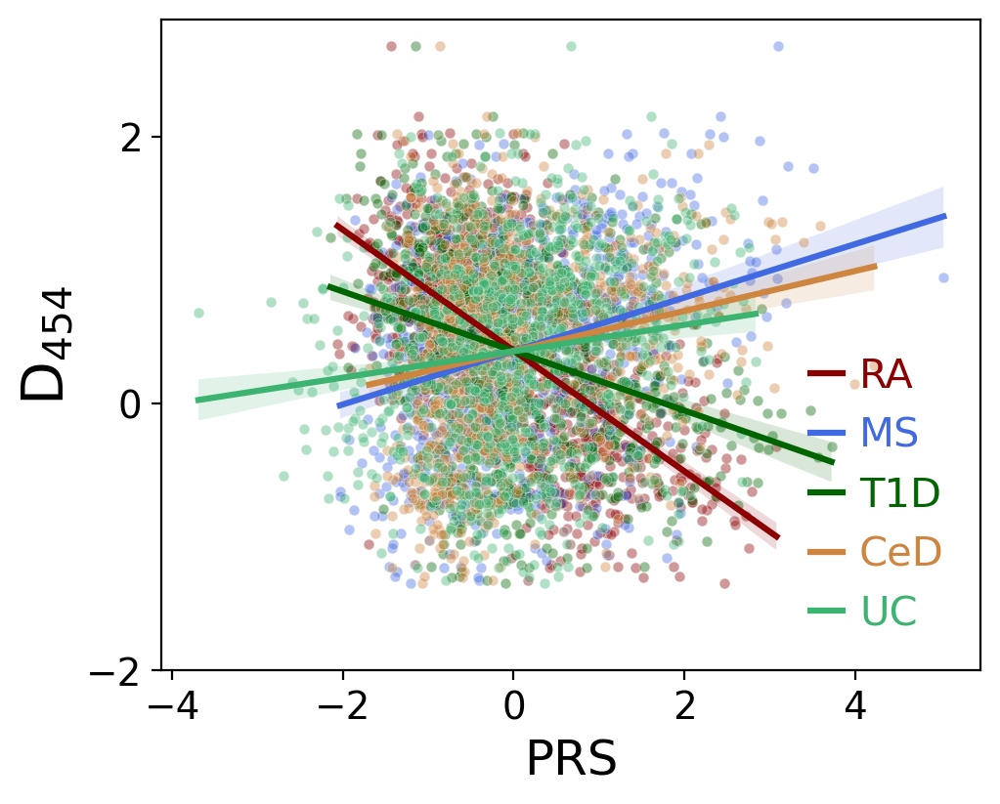

In [113]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(5,4), constrained_layout=True)

sns.scatterplot(x="RA", y="D_Factor454", data=tmp, color=PRS_colors_dark["RA"], alpha=0.4,
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="RA", y="D_Factor454", data=tmp, color=PRS_colors_dark["RA"], ax=axs, scatter=False, label="RA")

sns.scatterplot(x="Multiple_sclerosis", y="D_Factor454", data=tmp, color=PRS_colors_dark["MS"], alpha=0.4,
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="Multiple_sclerosis", y="D_Factor454", data=tmp, color=PRS_colors_dark["MS"], ax=axs, scatter=False, label="MS")

sns.scatterplot(x="T1D", y="D_Factor454", data=tmp, color=PRS_colors_dark["T1D"], alpha=0.4,
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="T1D", y="D_Factor454", data=tmp, color=PRS_colors_dark["T1D"], ax=axs, scatter=False, label="T1D")

sns.scatterplot(x="Celiac", y="D_Factor454", data=tmp, color=PRS_colors_dark["CeD"], alpha=0.4,
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="Celiac", y="D_Factor454", data=tmp, color=PRS_colors_dark["CeD"], ax=axs, scatter=False, label="CeD")

sns.scatterplot(x="UC", y="D_Factor454", data=tmp, color=PRS_colors_dark["UC"], alpha=0.4,
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="UC", y="D_Factor454", data=tmp, color=PRS_colors_dark["UC"], ax=axs, scatter=False, label="UC")

ymin = axs.get_yticks().min()
ymax = axs.get_yticks().max()
xmin = axs.get_xticks().min()
xmax = axs.get_xticks().max()

axs.set_ylabel("D$_{454}$", fontsize=21)
axs.set_yticks(
    np.arange(ymin, ymax, 2) 
    if 0 in np.arange(ymin, ymax, 2) 
    else np.arange(ymin+1, ymax, 2)
)
axs.set_xlabel("PRS", fontsize=18)
#axs.set_xticks(np.arange(xmin+2, xmax, 2))

# corr, pval = spearmanr(tmp["RA"], tmp["U_Factor454"])
# axs.text(x=0.73, y=2.3, s=fr"$\rho$ = {np.round(corr,2)}; $p$-val = {pval:.2e}",
#              fontdict={"color":PRS_colors_dark["RA"], "fontsize":12, "ma":"right"})

# corr, pval = spearmanr(tmp["MS"], tmp["U_Factor454"])
# axs.text(x=0.73, y=2.3, s=fr"$\rho$ = {np.round(corr,2)}; $p$-val = {pval:.2e}",
#              fontdict={"color":PRS_colors_dark["MS"], "fontsize":12, "ma":"right"})

# corr, pval = spearmanr(tmp["T1D"], tmp["U_Factor454"])
# axs.text(x=0.73, y=2.3, s=fr"$\rho$ = {np.round(corr,2)}; $p$-val = {pval:.2e}",
#              fontdict={"color":PRS_colors_dark["T1D"], "fontsize":12, "ma":"right"})

# corr, pval = spearmanr(tmp["Celiac"], tmp["U_Factor454"])
# axs.text(x=0.8, y=2.69, s=fr"$\rho$ = {np.round(corr,2)}; $p$-val = {pval:.2e}",
#              fontdict={"color":PRS_colors_dark["CeD"], "fontsize":12, "ma":"right"})

# corr, pval = spearmanr(tmp["UC"], tmp["U_Factor454"])
# axs.text(x=0.73, y=2.3, s=fr"$\rho$ = {np.round(corr,2)}; $p$-val = {pval:.2e}",
#              fontdict={"color":PRS_colors_dark["UC"], "fontsize":12, "ma":"right"})
# axs.text(x=1.8, y=2, s=f"$p$-val = {pval:.2e}",
#            fontdict={"color":"black", "fontsize":14, "ma":"right"})

axs.legend(frameon=False, handlelength=0.8, markerscale=30, fontsize=15,
           labelcolor=[PRS_colors_dark["RA"], PRS_colors_dark["MS"], PRS_colors_dark["T1D"], PRS_colors_dark["CeD"], PRS_colors_dark["UC"]])

plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-RA-and-MS-and-T1D-and-CeD-and-UC_vs_D454.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-RA-and-MS-and-T1D-and-CeD-and-UC_vs_D454.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-RA-and-MS-and-T1D-and-CeD-and-UC_vs_D454.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


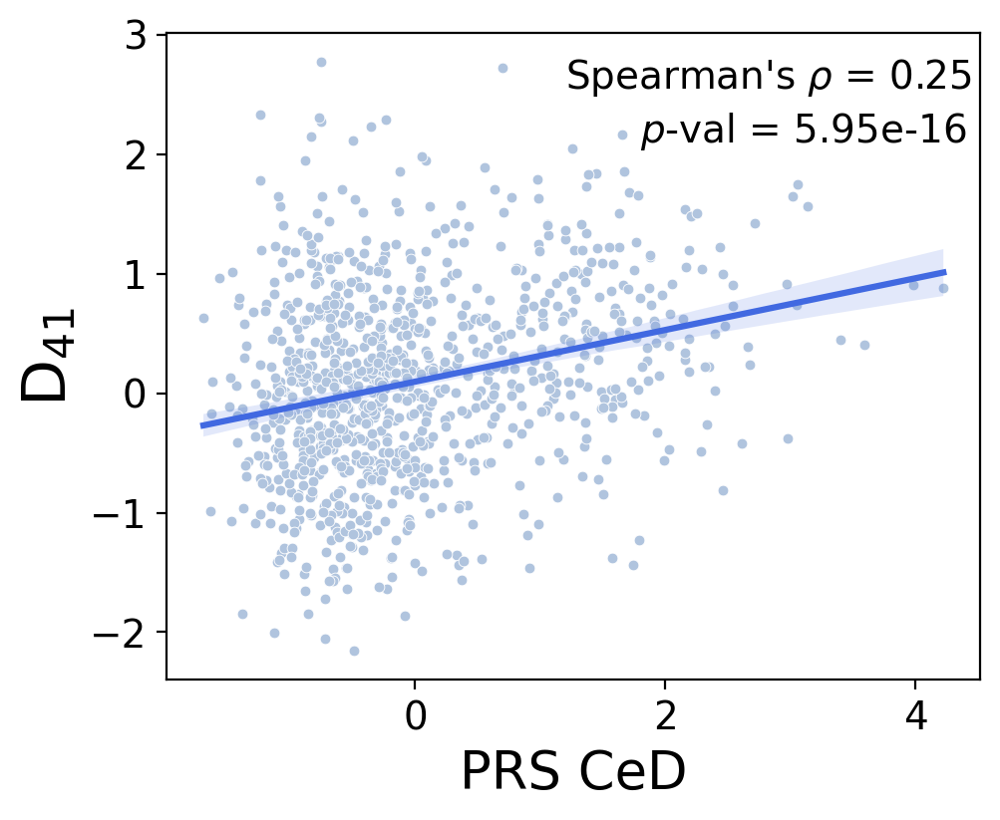

In [117]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(4.9,4), constrained_layout=True)

sns.scatterplot(x="Celiac", y="D_Factor41", data=tmp, color="lightsteelblue",
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="Celiac", y="D_Factor41", data=tmp, color="royalblue", ax=axs, scatter=False)
axs.set_xlabel("PRS CeD", fontsize=19)
axs.set_ylabel("D$_{41}$", fontsize=22)
corr, pval = spearmanr(tmp["Celiac"], tmp["D_Factor41"])
axs.text(x=1.2, y=2.55, s=fr"Spearman's $\rho$ = {np.round(corr,2)}",
            fontdict={"color":"black", "fontsize":14, "ma":"right"})
axs.text(x=1.8, y=2.1, s=f"$p$-val = {pval:.2e}",
           fontdict={"color":"black", "fontsize":14, "ma":"right"})

plt.savefig(os.path.join(model_results_dir, "Figures", f"Scatterplot_PRS-CeD_vs_D41.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"Scatterplot_PRS-CeD_vs_D41.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"Scatterplot_PRS-CeD_vs_D41.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


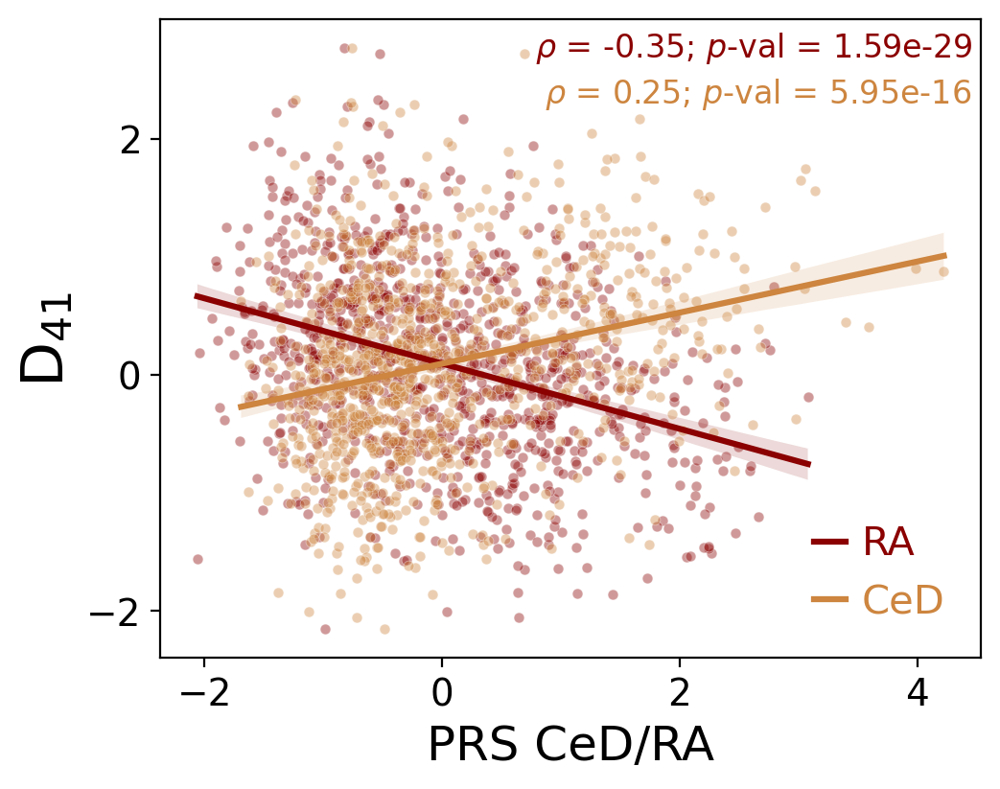

In [120]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(5.1,4), constrained_layout=True)

sns.scatterplot(x="RA", y="D_Factor41", data=tmp, color=PRS_colors_dark["RA"], alpha=0.4,
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="RA", y="D_Factor41", data=tmp, color=PRS_colors_dark["RA"], ax=axs, scatter=False, label="RA")

sns.scatterplot(x="Celiac", y="D_Factor41", data=tmp, color=PRS_colors_dark["CeD"], alpha=0.4,
                ax=axs, s=15, legend=False, rasterized=True)
sns.regplot(x="Celiac", y="D_Factor41", data=tmp, color=PRS_colors_dark["CeD"], ax=axs, scatter=False, label="CeD")


ymin = axs.get_yticks().min()
ymax = axs.get_yticks().max()
xmin = axs.get_xticks().min()
xmax = axs.get_xticks().max()

axs.set_ylabel("D$_{41}$", fontsize=22)
axs.set_yticks(
    np.arange(ymin, ymax, 2) 
    if 0 in np.arange(ymin, ymax, 2) 
    else np.arange(ymin+1, ymax, 2)
)
axs.set_xlabel("PRS CeD/RA", fontsize=18)
axs.set_xticks(np.arange(xmin+2, xmax, 2))
corr, pval = spearmanr(tmp["RA"], tmp["D_Factor41"])
axs.text(x=0.78, y=2.69, s=fr"$\rho$ = {np.round(corr,2)}; $p$-val = {pval:.2e}",
             fontdict={"color":PRS_colors_dark["RA"], "fontsize":12, "ma":"right"})
corr, pval = spearmanr(tmp["Celiac"], tmp["D_Factor41"])
axs.text(x=0.86, y=2.3, s=fr"$\rho$ = {np.round(corr,2)}; $p$-val = {pval:.2e}",
             fontdict={"color":PRS_colors_dark["CeD"], "fontsize":12, "ma":"right"})

axs.legend(frameon=False, handlelength=0.8, markerscale=30, fontsize=15, labelcolor=[PRS_colors_dark["RA"], PRS_colors_dark["CeD"]])

plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-CeD-and-RA_vs_D41.png"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-CeD-and-RA_vs_D41.pdf"), 
            transparent=True, dpi=400, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Scatterplot_PRS-CeD-and-RA_vs_D41.eps"), 
            transparent=True, dpi=400, bbox_inches="tight")

## Plot effect on cells

### RA

In [122]:
RA_EFFECT = calculate_DxC_effect(
    DxC_associations = PRS_effects,
    SNP_id = "RA",
    cell_state_latent = cell_state,
    A = assignment_matrix,
)
RA_EFFECT

,DxC_Factor19,DxC_Factor41,DxC_Factor72,DxC_Factor210,DxC_Factor293,DxC_Factor454,DxC_Factor484,DxC_Factor634,DxC_Factor663
barcode,,,,,,,,,
AAACCTGAGAATGTTG-1,0.008688,-0.009469,-0.016501,0.003045,0.042808,-0.092857,0.026172,-0.004238,-0.007137
AAACCTGAGAGAACAG-1,0.004344,-0.019590,-0.144816,0.002388,0.056571,-0.197980,0.038494,-0.003324,-0.003844
AAACCTGAGCATGGCA-1,0.016133,-0.029437,-0.013218,0.007551,0.060962,-0.069529,0.035760,-0.010511,-0.012272
AAACCTGAGTATTGGA-1,0.005437,-0.031379,-0.048998,0.003840,0.061362,-0.110755,0.033116,-0.005345,-0.003687
AAACCTGAGTGTCCCG-1,0.005089,-0.017873,-0.053903,0.003081,0.097321,-0.095859,0.049210,-0.004289,-0.004222
...,...,...,...,...,...,...,...,...,...
TTTGTCATCCGCTGTT-9,0.042738,-0.096624,-0.016959,0.045416,0.155537,-0.072373,0.027282,-0.063220,-0.018441
TTTGTCATCCGTTGTC-9,0.014256,-0.033545,-0.019150,0.012610,0.074815,-0.054385,0.030152,-0.017554,-0.007746
TTTGTCATCGCCGTGA-9,0.008496,-0.021884,-0.024525,0.007635,0.051723,-0.055166,0.014658,-0.010628,-0.005078


In [123]:
RA_EFFECT_ct = RA_EFFECT.merge(adata.obs.cell_label, right_index=True, left_index=True)
RA_EFFECT_ct = RA_EFFECT_ct.groupby("cell_label", observed=False).apply(lambda x: x.mean(axis=0))
RA_EFFECT_ct

,DxC_Factor19,DxC_Factor41,DxC_Factor72,DxC_Factor210,DxC_Factor293,DxC_Factor454,DxC_Factor484,DxC_Factor634,DxC_Factor663
cell_label,,,,,,,,,
B IN,0.048535,-0.108368,-0.023512,0.047844,0.173803,-0.077959,0.023584,-0.066599,-0.022992
B Mem,0.046808,-0.098371,-0.017493,0.044096,0.174180,-0.069314,0.028790,-0.061382,-0.023342
CD4 ET,0.010591,-0.023436,-0.019800,0.005081,0.050928,-0.079323,0.029804,-0.007073,-0.008241
CD4 NC,0.010358,-0.022950,-0.019348,0.005519,0.052093,-0.074960,0.029453,-0.007682,-0.007837
CD4 SOX4,0.011049,-0.027496,-0.022502,0.005373,0.050742,-0.080045,0.029285,-0.007480,-0.008605
CD8 ET,0.009326,-0.021520,-0.068259,0.004475,0.094805,-0.133930,0.056195,-0.006229,-0.007363
CD8 NC,0.010184,-0.024892,-0.020106,0.004639,0.057384,-0.084875,0.033021,-0.006457,-0.008085
CD8 S100B,0.008991,-0.025601,-0.033001,0.003848,0.061719,-0.104821,0.032382,-0.005356,-0.007277
DC,0.019134,-0.075649,-0.043039,0.012519,0.121864,-0.121262,0.019816,-0.017426,-0.015813


In [124]:
RA_EFFECT_abs_ct = RA_EFFECT.abs().merge(adata.obs.cell_label, right_index=True, left_index=True)
RA_EFFECT_abs_ct = RA_EFFECT_abs_ct.groupby("cell_label", observed=False).apply(lambda x: x.mean(axis=0))
RA_EFFECT_abs_ct

,DxC_Factor19,DxC_Factor41,DxC_Factor72,DxC_Factor210,DxC_Factor293,DxC_Factor454,DxC_Factor484,DxC_Factor634,DxC_Factor663
cell_label,,,,,,,,,
B IN,0.048535,0.108368,0.023512,0.047844,0.173803,0.077959,0.023584,0.066599,0.022992
B Mem,0.046808,0.098371,0.017493,0.044096,0.174180,0.069314,0.028790,0.061382,0.023342
CD4 ET,0.010591,0.023436,0.019800,0.005081,0.050928,0.079323,0.029804,0.007073,0.008241
CD4 NC,0.010358,0.022950,0.019348,0.005519,0.052093,0.074960,0.029453,0.007682,0.007837
CD4 SOX4,0.011049,0.027496,0.022502,0.005373,0.050742,0.080045,0.029285,0.007480,0.008605
CD8 ET,0.009326,0.021520,0.068259,0.004475,0.094805,0.133930,0.056195,0.006229,0.007363
CD8 NC,0.010184,0.024892,0.020106,0.004639,0.057384,0.084875,0.033021,0.006457,0.008085
CD8 S100B,0.008991,0.025601,0.033001,0.003848,0.061719,0.104821,0.032382,0.005356,0.007277
DC,0.019134,0.075649,0.043039,0.012519,0.121864,0.121262,0.019816,0.017426,0.015813


#### DxC454

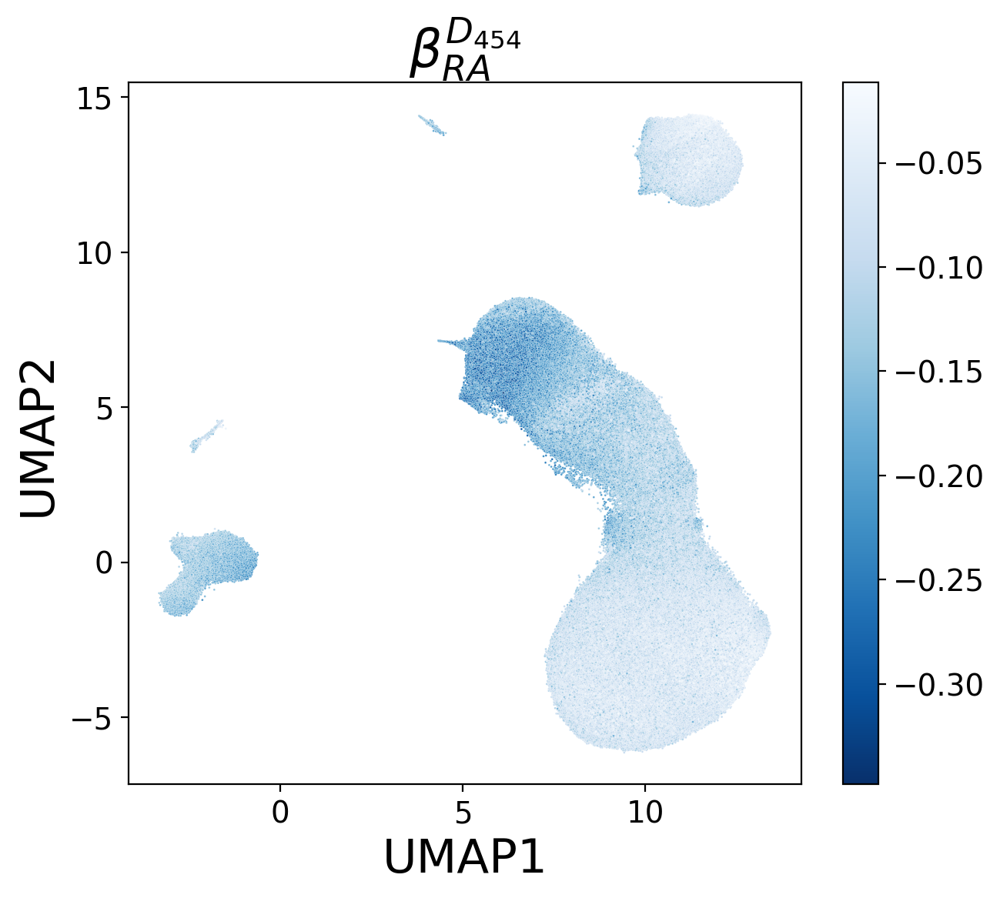

In [138]:
fig, axs = plt.subplots(figsize=(7,6))
sns.scatterplot(
    x="UMAP1",
    y="UMAP2",
    hue="DxC_Factor454",
    data=umap_cc.merge(RA_EFFECT, right_index=True, left_index=True),
    ax=axs,
    s=1,
    palette="Blues_r",
    hue_norm=(RA_EFFECT["DxC_Factor454"].min(), RA_EFFECT["DxC_Factor454"].max()),
    rasterized=True,
    legend=False,
)

sm = cm.ScalarMappable(
    cmap="Blues_r",
    norm=colors.Normalize(
        vmin=RA_EFFECT["DxC_Factor454"].min(),
        vmax=RA_EFFECT["DxC_Factor454"].max(),
    ),
)
cb = plt.colorbar(sm, ax=axs)

axs.set_title(
    label=r"$\beta^{D_{454}}_{RA}$", fontdict={"fontsize": 24}, loc="center"
)
axs.xaxis.label.set_fontsize(22)
axs.yaxis.label.set_fontsize(22)

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_RA-effect-on-cells_D454.png"),
                         dpi=500, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_RA-effect-on-cells_D454.eps"),
                         dpi=500, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_RA-effect-on-cells_D454.pdf"),
                         dpi=500, transparent=True, bbox_inches="tight")

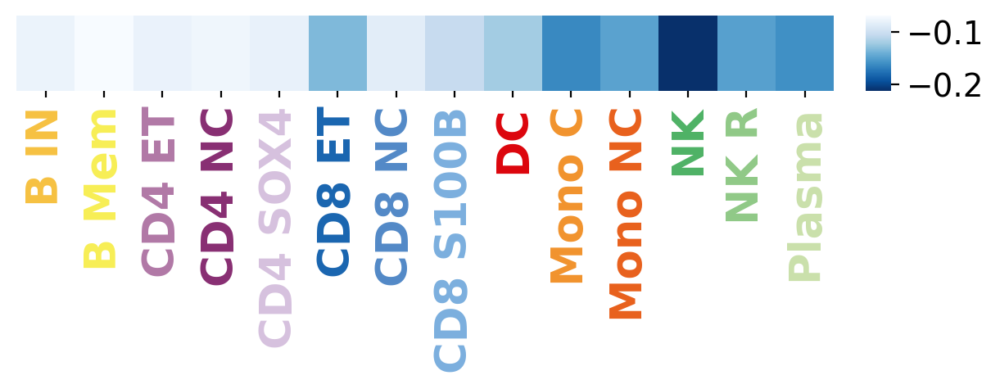

In [131]:
fig, axs = plt.subplots(figsize=(8,0.6))

sns.heatmap(RA_EFFECT_ct["DxC_Factor454"].to_frame().T, cmap="Blues_r", ax=axs, yticklabels=[], 
            cbar_kws={"anchor":(-0.15,0.5), "aspect":3})
axs.set_xlabel("")
axs.xaxis.label.set_fontsize(23)
axs.tick_params(axis="x", length=3)
for j, label in enumerate(axs.get_xticklabels()):
    label.set_color(cell_label_colors[label.get_text()])
    label.set_fontweight("bold")
    label.set_fontsize(19)
plt.savefig(os.path.join(model_results_dir, "Figures", "DxC454_effect_RA_celltype_heatmap.pdf"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "DxC454_effect_RA_celltype_heatmap.png"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "DxC454_effect_RA_celltype_heatmap.eps"), 
            bbox_inches="tight", transparent=True, dpi=600)


In [135]:
effect_on_genes = calculate_DxC_gene_effect(
    DxC_associations = PRS_effects,
    SNP_id = "RA",
    cell_state_latent = cell_state,
    A = assignment_matrix,
    DxC_decoder = DxC_decoder.loc[DxC_decoder["DxC_Factor454"].abs().nlargest(5).index],
    factor_id = "D_Factor454"
)
effect_on_genes = effect_on_genes.merge(adata.obs.cell_label, right_index=True, left_index=True)
effect_on_genes.head()

,ENSG00000237541,ENSG00000196126,ENSG00000204482,ENSG00000197746,ENSG00000019582,cell_label
barcode,,,,,,
AAACCTGAGAATGTTG-1,0.071921,-0.002557,0.001088,0.001069,0.000940,CD4 ET
AAACCTGAGAGAACAG-1,0.153344,-0.005451,0.002320,0.002278,0.002004,NK
AAACCTGAGCATGGCA-1,0.053853,-0.001914,0.000815,0.000800,0.000704,CD4 NC
AAACCTGAGTATTGGA-1,0.085785,-0.003050,0.001298,0.001275,0.001121,CD8 S100B
AAACCTGAGTGTCCCG-1,0.074246,-0.002639,0.001123,0.001103,0.000970,CD8 ET


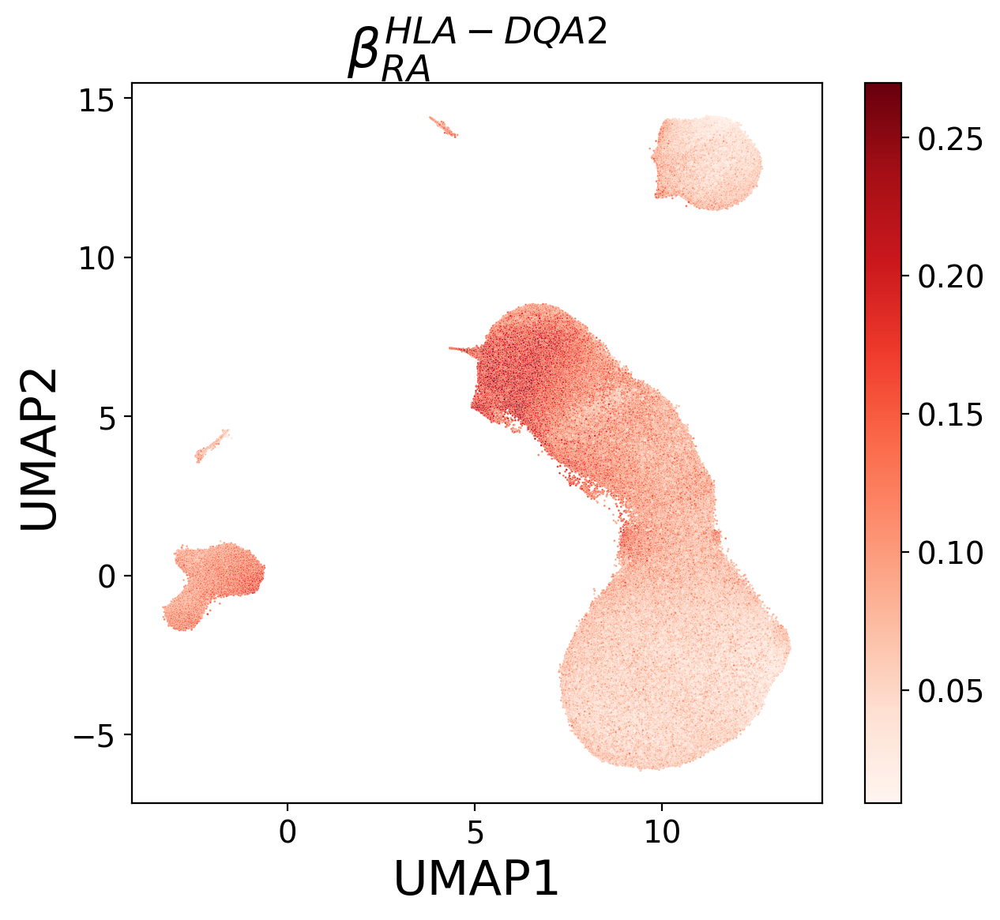

In [60]:
for g in DxC_decoder["DxC_Factor454"].abs().nlargest(1).index:

    hgnc_name = adata.var.loc[g].GeneSymbol
    if effect_on_genes[g].min() < 0 and effect_on_genes[g].max() > 0:
        comap = "RdBu_r" 
    elif effect_on_genes[g].min() < 0 and effect_on_genes[g].max() < 0:
        comap = "Blues_r"
    else:
        comap="Reds"
    
    fig, axs = plt.subplots(figsize=(7,6))
    sns.scatterplot(
        x="UMAP1",
        y="UMAP2",
        hue=g,
        data=umap_cc.merge(effect_on_genes[g], right_index=True, left_index=True),
        ax=axs,
        s=1,
        palette=comap,
        rasterized=True,
        legend=False,
    )

    Norm = (colors.TwoSlopeNorm(vcenter=0.0, vmin=effect_on_genes[g].min(), vmax=effect_on_genes[g].max()) 
            if comap == "RdBu_r"
            else colors.Normalize(vmin=effect_on_genes[g].min(), vmax=effect_on_genes[g].max()))
    sm = cm.ScalarMappable(cmap=comap, norm=Norm)
    cb = plt.colorbar(sm, ax=axs)
    
    # axs.set_title(
    #     label=f"PRS RA effect on ${hgnc_name}$", fontdict={"fontsize": 22}, loc="center"
    # )
    axs.set_title(
        label=rf"$\beta^{{{hgnc_name}}}_{{RA}}$", fontdict={"fontsize": 24}, loc="center"
    )
    axs.set_xlabel("UMAP1", fontsize=22)
    axs.set_ylabel("UMAP2", fontsize=22)
    
    plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_RA-effect-on-{hgnc_name}_D454.png"),
                             dpi=500, transparent=True, bbox_inches="tight")
    plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_RA-effect-on-{hgnc_name}_D454.eps"),
                             dpi=500, transparent=True, bbox_inches="tight")
    plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_RA-effect-on-{hgnc_name}_D454.pdf"),
                             dpi=800, transparent=True, bbox_inches="tight")

In [136]:
effect_on_HLADQA2_ct = effect_on_genes["ENSG00000237541"].to_frame()
effect_on_HLADQA2_ct = effect_on_HLADQA2_ct.merge(adata.obs.cell_label, right_index=True, left_index=True)
effect_on_HLADQA2_ct = effect_on_HLADQA2_ct.groupby("cell_label").apply(lambda x: x.mean())
effect_on_HLADQA2_ct 

/tmp/ipykernel_1261514/983465097.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


,ENSG00000237541
cell_label,
B IN,0.060382
B Mem,0.053686
CD4 ET,0.061439
CD4 NC,0.058059
CD4 SOX4,0.061998
CD8 ET,0.103734
CD8 NC,0.065739
CD8 S100B,0.081188
DC,0.093923


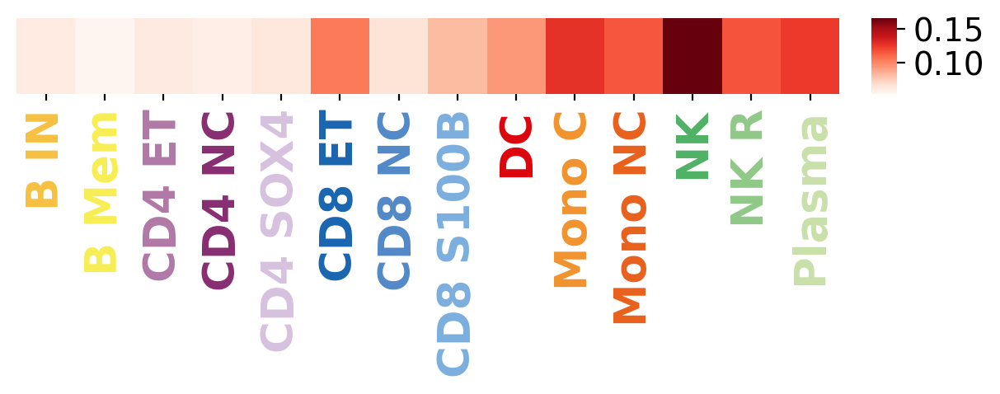

In [137]:
fig, axs = plt.subplots(figsize=(8,0.6))

sns.heatmap(effect_on_HLADQA2_ct.T, cmap="Reds", ax=axs, yticklabels=[], cbar_kws={"anchor":(-0.15,0.5), "aspect":3})
# axs.set_ylabel(fr"$GxC693_{{\beta_{{{rsid}}}}}$")
axs.set_xlabel("")
axs.xaxis.label.set_fontsize(23)
axs.tick_params(axis="x", length=3)
for j, label in enumerate(axs.get_xticklabels()):
    label.set_color(cell_label_colors[label.get_text()])
    label.set_fontweight("bold")
    label.set_fontsize(19)
plt.savefig(os.path.join(model_results_dir, "Figures", "DxC454_RA-effect-on-HLA-DQA2_celltype_heatmap.pdf"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "DxC454_RA-effect-on-HLA-DQA2_celltype_heatmap.png"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "DxC454_RA-effect-on-HLA-DQA2_celltype_heatmap.eps"), 
            bbox_inches="tight", transparent=True, dpi=600)


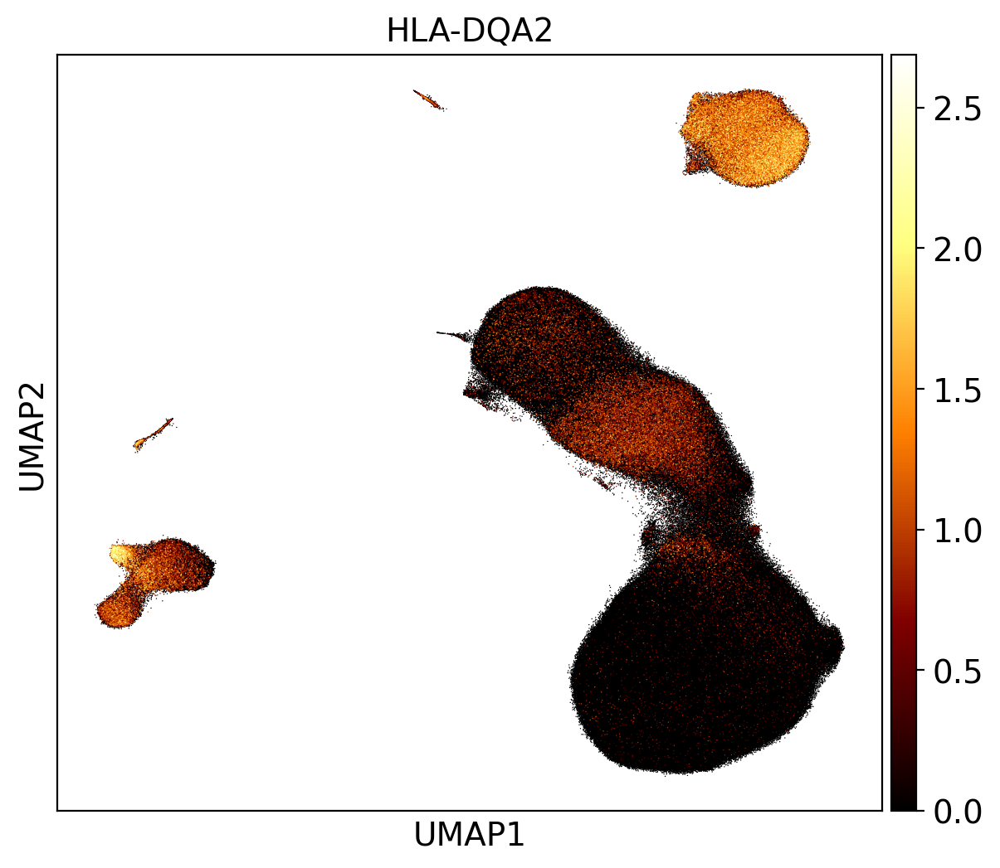

In [1028]:
sc.pl.umap(adata, color=adata.var.loc[adata.var.GeneSymbol == "HLA-DQA2"].index, title="HLA-DQA2", cmap="afmhot", size=1, hspace=0.14, save="_HLA-DQA2-expression.png")

#### DxC41

In [1816]:
PRS_effects.loc[PRS_effects.Factor == "U_Factor41"]

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS,Celltype
3,U_Factor41,CeD,0.190772,0.026913,6.878921e-13,6.620961e-10,CeD__U_Factor41,DC
3,U_Factor41,CeD,0.190772,0.026913,6.878921e-13,6.620961e-10,CeD__U_Factor41,B IN
4,U_Factor41,RA,-0.273531,0.025460,1.545146e-28,4.759051e-25,RA__U_Factor41,DC
4,U_Factor41,RA,-0.273531,0.025460,1.545146e-28,4.759051e-25,RA__U_Factor41,B IN


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:09<00:00,  4.67s/it]


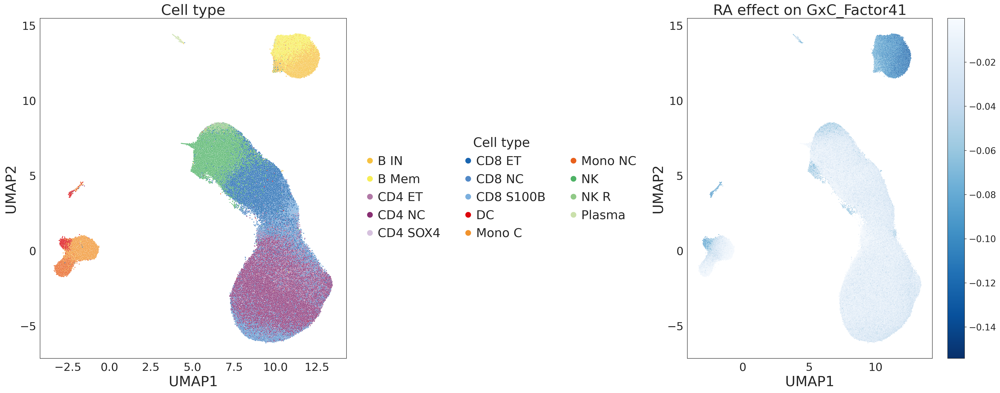

In [207]:
RA_EFFECT_41 = visualize_DxC_effect(SNP="RA",
                                 adata=adata,
                                 celltype_column="cell_label",
                                 return_DxC_effect=True,
                                 cell_state_latent=zbase,
                                 GxC_associations=PRS_effects.loc[PRS_effects.Factor == "D_Factor41"],
                                 assignment_matrix=assignment_matrix,
                                 umap_cell_state=os.path.join(model_results_dir, f"{model}_cell-state_latent_UMAP.tsv"),
                                 savefig=os.path.join(model_results_dir, "Figures", f"{model}_D41.eps"))

In [61]:
RA_EFFECT_41 = RA_EFFECT_41.merge(adata.obs.cell_label, right_index=True, left_index=True)
RA_EFFECT_41

,GxC_Factor41,cell_label
barcode,,
AAACCTGAGAATGTTG-1,-0.009469,CD4 ET
AAACCTGAGAGAACAG-1,-0.019590,NK
AAACCTGAGCATGGCA-1,-0.029437,CD4 NC
AAACCTGAGTATTGGA-1,-0.031379,CD8 S100B
AAACCTGAGTGTCCCG-1,-0.017873,CD8 ET
...,...,...
TTTGTCATCCGCTGTT-9,-0.096624,B IN
TTTGTCATCCGTTGTC-9,-0.033545,CD4 NC
TTTGTCATCGCCGTGA-9,-0.021884,CD4 NC


### CeD

In [139]:
CeD_EFFECT = calculate_DxC_effect(
    DxC_associations = PRS_effects,
    SNP_id = "CeD",
    cell_state_latent = cell_state,
    A = assignment_matrix,
)
CeD_EFFECT

,DxC_Factor19,DxC_Factor41,DxC_Factor69,DxC_Factor72,DxC_Factor210,DxC_Factor308,DxC_Factor325,DxC_Factor377,DxC_Factor395,DxC_Factor450,DxC_Factor454,DxC_Factor484,DxC_Factor503,DxC_Factor598,DxC_Factor661,DxC_Factor663,DxC_Factor682,DxC_Factor687
barcode,,,,,,,,,,,,,,,,,,
AAACCTGAGAATGTTG-1,-0.011355,0.006604,-0.071969,0.012819,-0.003018,-0.012643,-0.011641,-0.004014,0.003186,0.011058,0.027949,-0.017763,-0.004194,-0.058777,0.005187,-0.007828,0.012451,-0.003962
AAACCTGAGAGAACAG-1,-0.005678,0.013663,-0.067772,0.112503,-0.002367,-0.006998,-0.011182,-0.022196,0.002512,0.015857,0.059591,-0.026126,-0.011406,-0.068938,0.007678,-0.004216,0.011187,-0.010743
AAACCTGAGCATGGCA-1,-0.021086,0.020530,-0.031973,0.010269,-0.007484,-0.020199,-0.015446,-0.004662,0.007893,0.017014,0.020928,-0.024271,-0.016029,-0.044901,0.004795,-0.013459,0.015383,-0.005533
AAACCTGAGTATTGGA-1,-0.007106,0.021885,-0.051356,0.038065,-0.003806,-0.011616,-0.013657,-0.008295,0.004018,0.013022,0.033337,-0.022476,-0.006054,-0.054250,0.004712,-0.004044,0.013681,-0.005310
AAACCTGAGTGTCCCG-1,-0.006652,0.012465,-0.044297,0.041876,-0.003054,-0.008590,-0.010371,-0.012437,0.003237,0.009310,0.028853,-0.033399,-0.009232,-0.057263,0.008423,-0.004631,0.010455,-0.011831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCGCTGTT-9,-0.055859,0.067390,-0.041760,0.013175,-0.045014,-0.116557,-0.042327,-0.004698,0.047425,0.022047,0.021784,-0.018517,-0.048085,-0.028560,0.007773,-0.020225,0.051065,-0.004711
TTTGTCATCCGTTGTC-9,-0.018633,0.023396,-0.053740,0.014877,-0.012499,-0.033589,-0.016811,-0.004955,0.013175,0.017361,0.016370,-0.020464,-0.016894,-0.059495,0.005283,-0.008496,0.018993,-0.005066
TTTGTCATCGCCGTGA-9,-0.011105,0.015263,-0.050822,0.019053,-0.007567,-0.020786,-0.013284,-0.009692,0.007991,0.022072,0.016605,-0.009948,-0.009194,-0.068871,0.008960,-0.005569,0.014729,-0.011526


In [140]:
CeD_EFFECT_ct = CeD_EFFECT.merge(adata.obs.cell_label, right_index=True, left_index=True)
CeD_EFFECT_ct = CeD_EFFECT_ct.groupby("cell_label", observed=True).apply(lambda x: x.mean(axis=0))
CeD_EFFECT_ct

,DxC_Factor19,DxC_Factor41,DxC_Factor69,DxC_Factor72,DxC_Factor210,DxC_Factor308,DxC_Factor325,DxC_Factor377,DxC_Factor395,DxC_Factor450,DxC_Factor454,DxC_Factor484,DxC_Factor503,DxC_Factor598,DxC_Factor661,DxC_Factor663,DxC_Factor682,DxC_Factor687
cell_label,,,,,,,,,,,,,,,,,,
B IN,-0.063436,0.075580,-0.025528,0.018266,-0.047421,-0.118655,-0.044797,-0.007431,0.049966,0.025505,0.023465,-0.016007,-0.049146,-0.032244,0.008403,-0.025216,0.052619,-0.008030
B Mem,-0.061179,0.068608,-0.028866,0.013590,-0.043706,-0.109870,-0.044008,-0.007710,0.046056,0.023127,0.020863,-0.019540,-0.044796,-0.035087,0.009512,-0.025599,0.051409,-0.009717
CD4 ET,-0.013842,0.016346,-0.049731,0.015382,-0.005036,-0.014368,-0.016104,-0.006907,0.005318,0.015525,0.023876,-0.020228,-0.008991,-0.055301,0.006419,-0.009038,0.016744,-0.007921
CD4 NC,-0.013538,0.016006,-0.045339,0.015031,-0.005470,-0.015497,-0.015514,-0.007195,0.005776,0.018210,0.022563,-0.019990,-0.010072,-0.057612,0.006792,-0.008595,0.016266,-0.008477
CD4 SOX4,-0.014441,0.019177,-0.040329,0.017481,-0.005326,-0.014851,-0.016841,-0.007798,0.005625,0.019442,0.024093,-0.019876,-0.009976,-0.055203,0.006853,-0.009438,0.017233,-0.008818
CD8 ET,-0.012189,0.015009,-0.047356,0.053028,-0.004435,-0.012824,-0.016147,-0.011693,0.004686,0.011183,0.040312,-0.038140,-0.010120,-0.056877,0.006266,-0.008075,0.016974,-0.007940
CD8 NC,-0.013310,0.017361,-0.039915,0.015620,-0.004598,-0.013158,-0.014702,-0.006773,0.004856,0.016296,0.025547,-0.022412,-0.009624,-0.051990,0.006193,-0.008866,0.014829,-0.007799
CD8 S100B,-0.011752,0.017856,-0.042858,0.025638,-0.003814,-0.011183,-0.012680,-0.007717,0.004029,0.013667,0.031551,-0.021978,-0.007929,-0.050282,0.005735,-0.007981,0.012280,-0.007188
DC,-0.025009,0.052761,-0.029242,0.033435,-0.012408,-0.033407,-0.043774,-0.040268,0.013169,0.018016,0.036499,-0.013449,-0.014684,-0.025931,0.039390,-0.017343,0.044122,-0.057311


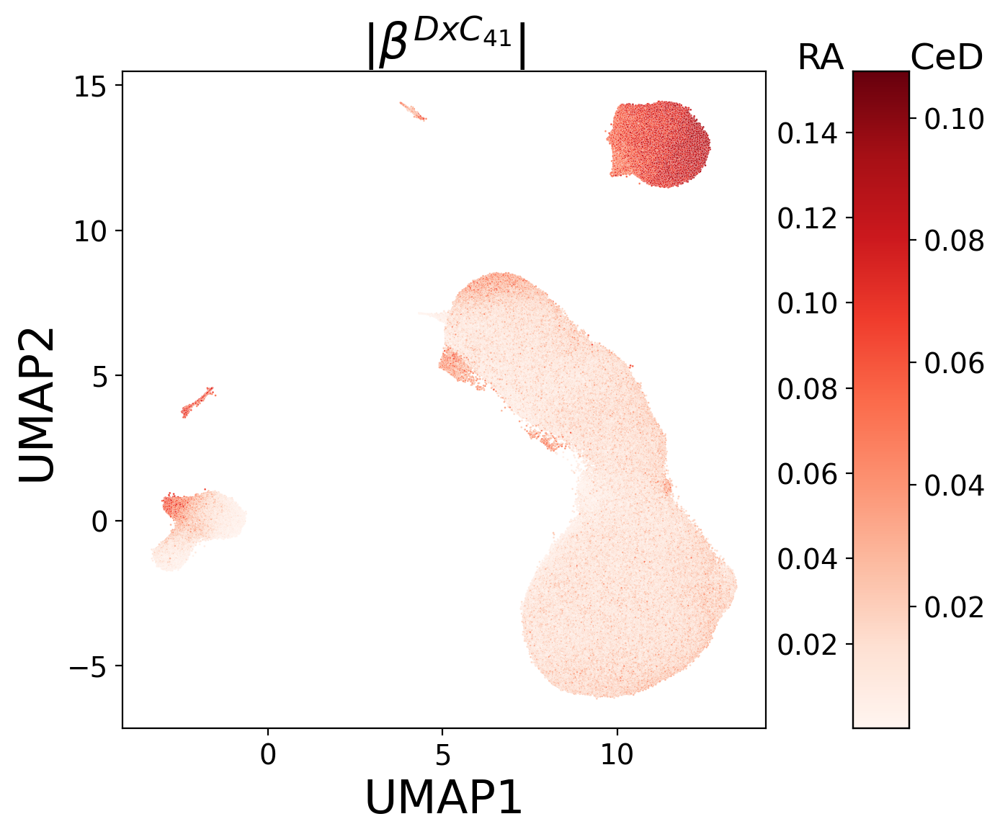

In [141]:
## Plot the effect of both RA and CeD

comap="Reds"
norM = colors.Normalize(vmin=RA_EFFECT["DxC_Factor41"].abs().min(), vmax=RA_EFFECT["DxC_Factor41"].abs().max())

fig, axs = plt.subplots(figsize=(7,6))
sns.scatterplot(
    x="UMAP1",
    y="UMAP2",
    hue="DxC_Factor41",
    data=umap_cc.merge(RA_EFFECT.abs(), right_index=True, left_index=True),
    ax=axs,
    s=1,
    palette=comap,
    rasterized=True,
    legend=False,
    hue_norm=norM
)

sm = cm.ScalarMappable(
    cmap=comap,
    norm=norM
)
cb = plt.colorbar(sm, ax=axs, pad=0.032)
pos = cb.ax.get_position()
cb.ax.set_aspect("auto")
axs2 = cb.ax.twinx()
axs2.set_ylim([CeD_EFFECT["DxC_Factor41"].abs().min(), CeD_EFFECT["DxC_Factor41"].abs().max()])

# Resize the colorbar (otherwise it overlays the plot)
pos.x0 +=0.061
cb.ax.set_position(pos)
axs2.set_position(pos)

axs2.text(x=pos.x0-1.9, y=0.108, s="RA", fontdict={"fontsize": 18})

axs2.text(x=pos.x0+0.1, y=0.108, s="CeD", fontdict={"fontsize": 18})


axs.set_xlabel("UMAP1", fontsize=23)
axs.set_ylabel("UMAP2", fontsize=23)

axs.set_title(
    label=r"$|\beta^{DxC_{41}}|$", fontdict={"fontsize": 24}, loc="center"
)

plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_absolute-RA-and-CeD-effect-on-cells_GxC41_double-colorbar_Reds-cmap.png"),
            dpi=500, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_absolute-RA-and-CeD-effect-on-cells_GxC41_double-colorbar_Reds-cmap.eps"),
            dpi=500, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", f"{model}_absolute-RA-and-CeD-effect-on-cells_GxC41_double-colorbar_Reds-cmap.pdf"),
            dpi=500, transparent=True, bbox_inches="tight")

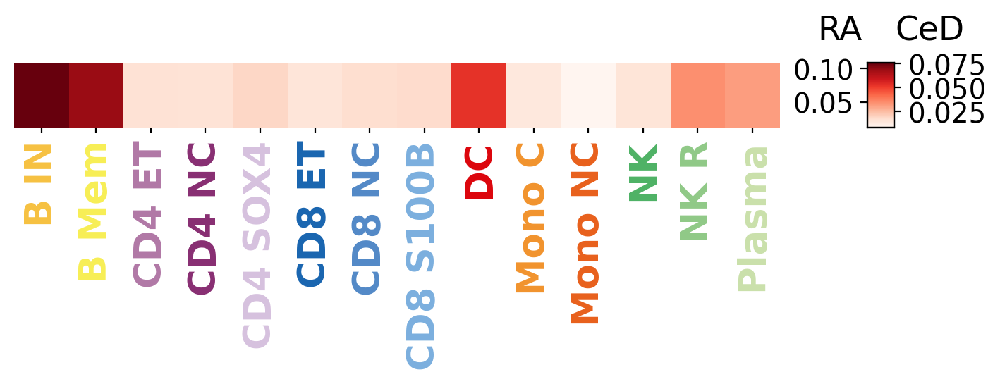

In [52]:
fig, axs = plt.subplots(figsize=(8,0.6))

norM = colors.Normalize(vmin=RA_EFFECT_ct["GxC_Factor41"].abs().min(), vmax=RA_EFFECT_ct["GxC_Factor41"].abs().max())

sns.heatmap(RA_EFFECT_ct["GxC_Factor41"].abs().to_frame().T, cmap="Reds", ax=axs, yticklabels=[],
            cbar_kws={"anchor":(-0.15,0.5)}, cbar=False)

sm = cm.ScalarMappable(
    cmap=comap,
    norm=norM
)
cb = plt.colorbar(sm, ax=axs, pad=0.01, shrink=1, fraction=0.12)
pos = cb.ax.get_position()
cb.ax.set_aspect("auto")
axs2 = cb.ax.twinx()
axs2.set_ylim([CeD_EFFECT_ct["GxC_Factor41"].abs().min(), CeD_EFFECT_ct["GxC_Factor41"].abs().max()])

# Resize the colorbar (otherwise it overlays the plot)
pos.x0 +=0.07
cb.ax.set_position(pos)
axs2.set_position(pos)

axs2.text(x=pos.x0-2.8, y=0.1, s="RA", fontdict={"fontsize": 17})

axs2.text(x=pos.x0+0.1, y=0.1, s="CeD", fontdict={"fontsize": 17})


axs.set_xlabel("")
axs.xaxis.label.set_fontsize(23)
axs.tick_params(axis="x", length=3)
for j, label in enumerate(axs.get_xticklabels()):
    label.set_color(cell_label_colors[label.get_text()])
    label.set_fontweight("bold")
    label.set_fontsize(19)

# # add border for visual clarity
# for spine in axs.spines.values():
#     spine.set_visible(True)
#     spine.set_edgecolor("#ededed")
#     spine.set_linewidth(1)
    
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC41_absolute-effect-RA-and-CeD_celltype_heatmap_Reds-cmap.pdf"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC41_absolute-effect-RA-and-CeD_celltype_heatmap_Reds-cmap.png"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "GxC41_absolute-effect-RA-and-CeD_celltype_heatmap_Reds-cmap.eps"), 
            bbox_inches="tight", transparent=True, dpi=600)


## Assign effects to celltypes

In [155]:
D_celltype = assign_D_to_celltype(
    cell_state_latent=cell_state,
    A=assignment_matrix,
    cell_metadata=adata.obs,
    celltype_column="cell_label",
    top_one=True,
    assignment_threshold=0.9
)
D_celltype

{'D_Factor1': 'Mono NC',
 'D_Factor2': 'CD4 SOX4',
 'D_Factor3': None,
 'D_Factor4': 'CD4 SOX4',
 'D_Factor5': None,
 'D_Factor6': 'Mono NC',
 'D_Factor7': 'DC',
 'D_Factor8': 'Mono NC',
 'D_Factor9': None,
 'D_Factor10': None,
 'D_Factor11': 'CD8 S100B',
 'D_Factor12': 'Plasma',
 'D_Factor13': 'Mono NC',
 'D_Factor14': 'B IN',
 'D_Factor15': 'CD4 SOX4',
 'D_Factor16': 'Plasma',
 'D_Factor17': 'Plasma',
 'D_Factor18': 'Mono NC',
 'D_Factor19': 'Plasma',
 'D_Factor20': 'Mono NC',
 'D_Factor21': None,
 'D_Factor22': 'Mono NC',
 'D_Factor23': 'NK',
 'D_Factor24': 'Mono C',
 'D_Factor25': 'NK',
 'D_Factor26': 'CD4 ET',
 'D_Factor27': 'Mono C',
 'D_Factor28': 'NK',
 'D_Factor29': 'Plasma',
 'D_Factor30': 'Plasma',
 'D_Factor31': 'B IN',
 'D_Factor32': 'CD8 S100B',
 'D_Factor33': None,
 'D_Factor34': None,
 'D_Factor35': 'Mono NC',
 'D_Factor36': 'CD8 ET',
 'D_Factor37': None,
 'D_Factor38': None,
 'D_Factor39': 'CD4 SOX4',
 'D_Factor40': 'Plasma',
 'D_Factor41': 'B IN',
 'D_Factor42': 'CD4 

In [156]:
PRS_effects = PRS_effects.assign(Celltype = PRS_effects.apply(lambda x: D_celltype[x.Factor], axis=1))
PRS_effects = PRS_effects.explode("Celltype")
PRS_effects.head()

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS,Celltype
0,D_Factor19,CeD,-0.163174,0.024693,2.334779e-11,1.892400e-08,CeD__D_Factor19,Plasma
1,D_Factor19,RA,0.124845,0.023360,7.291072e-08,4.010090e-05,RA__D_Factor19,Plasma
2,D_Factor36,Psoriasis,0.232348,0.038465,1.075110e-09,7.198563e-07,Psoriasis__D_Factor36,CD8 ET
3,D_Factor41,CeD,0.190772,0.026913,6.878921e-13,6.620961e-10,CeD__D_Factor41,B IN
4,D_Factor41,RA,-0.273531,0.025460,1.545146e-28,4.759051e-25,RA__D_Factor41,B IN


In [68]:
PRS_effects.groupby("SNP_id").apply(lambda x: x.Celltype.nunique())

/tmp/ipykernel_1005537/3226223089.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


SNP_id
CeD                 5
Lymphocyte_count    1
MS                  7
Psoriasis           7
RA                  5
RBC                 1
RBDW                2
T1D                 5
T2D                 1
UC                  2
dtype: int64

In [69]:
PRS_effects.Celltype.value_counts()

Celltype
Mono C     14
B IN       13
NK         13
Plasma     12
B Mem       4
Mono NC     4
CD8 ET      2
DC          1
Name: count, dtype: int64

In [70]:
PRS_effects.groupby("SNP_id").apply(lambda x: x.Celltype.unique())

/tmp/ipykernel_1005537/2009837215.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


SNP_id
CeD                         [Plasma, B IN, NK, Mono C, None, Mono NC]
Lymphocyte_count                                             [Plasma]
MS                  [NK, CD8 ET, B Mem, B IN, Mono C, None, Mono N...
Psoriasis           [CD8 ET, None, Plasma, B IN, Mono NC, DC, Mono...
RA                                 [Plasma, B IN, NK, B Mem, Mono NC]
RBC                                                          [Plasma]
RBDW                                                     [Plasma, NK]
T1D                                 [NK, B Mem, B IN, Plasma, Mono C]
T2D                                                          [Mono C]
UC                                                        [B Mem, NK]
dtype: object

In [338]:
# Celltypes not associated with any PRS
adata.obs.loc[~adata.obs.cell_label.isin(PRS_effects.Celltype)].cell_label.unique()

['CD4 NC', 'CD8 NC', 'B Mem']
Categories (14, object): ['B IN', 'B Mem', 'CD4 ET', 'CD4 NC', ..., 'Mono NC', 'NK', 'NK R', 'Plasma']

## GSEA

### Find top genes for PRS-associated factors

In [159]:
prs_gene_ct = []
# Focus on autoimmune diseases
for prs in PRS_effects.loc[PRS_effects.SNP_id.isin(["IBD", "CeD", "UC", "T1D", "MS", "Psoriasis", "RA"])].SNP_id.unique():
    prs_topgene = []
    prs_ct = []
    prs_factor = []
    for idx, row in PRS_effects.loc[PRS_effects.SNP_id == prs].iterrows():
        topgenes = select_important_genes_for_factor_IQR(
            genes_factors_loadings=DxC_decoder.to_numpy(),
            factor_idx=int(row.Factor.replace("D_Factor", ""))-1,
            gene_names=adata.var.loc[DxC_decoder.index].GeneSymbol,
            direction="both",
            threshold = 100,
            plot = False,
        )
        prs_topgene.append(topgenes)
        prs_ct.append(row.Celltype)
        prs_factor.append(row.Factor)
    gene_ct = pd.DataFrame({"PRS": [prs]*len(prs_ct),
                            "Factor": prs_factor,
                            "TopGene": prs_topgene,
                            "Cell type": prs_ct})
    prs_gene_ct.append(gene_ct)

prs_gene_ct = pd.concat(prs_gene_ct, axis=0, ignore_index=True)
prs_gene_ct


/data/danai/scripts/LIVI/src/analysis/_utils.py:167: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


,PRS,Factor,TopGene,Cell type
0,CeD,D_Factor19,"[RPL10, HLA-DPA1, HLA-DRA, HLA-DPB1]",Plasma
1,CeD,D_Factor41,"[HLA-DRB1, HLA-DQA1, CD74, RPL14]",B IN
2,CeD,D_Factor69,[HLA-DQB1],NK
3,CeD,D_Factor72,[HLA-DQA1],NK
4,CeD,D_Factor210,"[RPL13, RPL18A, RPS19, HLA-DQA1, RPL35]",B IN
...,...,...,...,...
56,MS,D_Factor663,[HLA-DRB1],Plasma
57,MS,D_Factor682,"[HLA-DQA2, HLA-DQB1]",Mono C
58,MS,D_Factor687,"[HLA-DQA1, HLA-DQB1, RPL10, RPLP1]",Mono C
59,UC,D_Factor293,"[HLA-DQA2, HLA-DRB5]",B Mem


In [162]:
outtable = prs_gene_ct.assign(TopGenes = ["; ".join(TG) for TG in prs_gene_ct.TopGene], Celltype = [", ".join(CT) if isinstance(CT, list) else CT for CT in prs_gene_ct["Cell type"]])
outtable = outtable.drop(columns=["TopGene"]).drop_duplicates()
outtable

,PRS,Factor,Cell type,TopGenes,Celltype
0,CeD,D_Factor19,Plasma,RPL10; HLA-DPA1; HLA-DRA; HLA-DPB1,Plasma
1,CeD,D_Factor41,B IN,HLA-DRB1; HLA-DQA1; CD74; RPL14,B IN
2,CeD,D_Factor69,NK,HLA-DQB1,NK
3,CeD,D_Factor72,NK,HLA-DQA1,NK
4,CeD,D_Factor210,B IN,RPL13; RPL18A; RPS19; HLA-DQA1; RPL35,B IN
...,...,...,...,...,...
56,MS,D_Factor663,Plasma,HLA-DRB1,Plasma
57,MS,D_Factor682,Mono C,HLA-DQA2; HLA-DQB1,Mono C
58,MS,D_Factor687,Mono C,HLA-DQA1; HLA-DQB1; RPL10; RPLP1,Mono C
59,UC,D_Factor293,B Mem,HLA-DQA2; HLA-DRB5,B Mem


In [163]:
outtable = outtable.assign(fPRS = outtable.PRS + "__" + outtable.Factor)
outtable = outtable.merge(PRS_effects.filter(["fPRS", "effect_size", "effect_size_se", "p_value", "corrected_pvalue"]), on="fPRS", how="left")
outtable

,PRS,Factor,Cell type,TopGenes,Celltype,fPRS,effect_size,effect_size_se,p_value,corrected_pvalue
0,CeD,D_Factor19,Plasma,RPL10; HLA-DPA1; HLA-DRA; HLA-DPB1,Plasma,CeD__D_Factor19,-0.163174,0.024693,2.334779e-11,1.892400e-08
1,CeD,D_Factor41,B IN,HLA-DRB1; HLA-DQA1; CD74; RPL14,B IN,CeD__D_Factor41,0.190772,0.026913,6.878921e-13,6.620961e-10
2,CeD,D_Factor69,NK,HLA-DQB1,NK,CeD__D_Factor69,-0.165184,0.020428,1.932220e-16,2.288938e-13
3,CeD,D_Factor72,NK,HLA-DQA1,NK,CeD__D_Factor72,0.337784,0.031566,2.603542e-28,6.682424e-25
4,CeD,D_Factor210,B IN,RPL13; RPL18A; RPS19; HLA-DQA1; RPL35,B IN,CeD__D_Factor210,-0.135848,0.036216,1.667885e-04,3.951604e-02
...,...,...,...,...,...,...,...,...,...,...
56,MS,D_Factor663,Plasma,HLA-DRB1,Plasma,MS__D_Factor663,0.165676,0.032391,2.612908e-07,1.242341e-04
57,MS,D_Factor682,Mono C,HLA-DQA2; HLA-DQB1,Mono C,MS__D_Factor682,-0.102831,0.021557,1.600630e-06,6.662083e-04
58,MS,D_Factor687,Mono C,HLA-DQA1; HLA-DQB1; RPL10; RPLP1,Mono C,MS__D_Factor687,0.169433,0.041612,4.331119e-05,1.307828e-02
59,UC,D_Factor293,B Mem,HLA-DQA2; HLA-DRB5,B Mem,UC__D_Factor293,-0.208053,0.032799,1.456507e-10,1.121510e-07


In [164]:
outtable = outtable[["PRS","Factor","effect_size", "effect_size_se", "p_value", "corrected_pvalue","TopGenes","Celltype"]].drop_duplicates()
outtable

,PRS,Factor,effect_size,effect_size_se,p_value,corrected_pvalue,TopGenes,Celltype
0,CeD,D_Factor19,-0.163174,0.024693,2.334779e-11,1.892400e-08,RPL10; HLA-DPA1; HLA-DRA; HLA-DPB1,Plasma
1,CeD,D_Factor41,0.190772,0.026913,6.878921e-13,6.620961e-10,HLA-DRB1; HLA-DQA1; CD74; RPL14,B IN
2,CeD,D_Factor69,-0.165184,0.020428,1.932220e-16,2.288938e-13,HLA-DQB1,NK
3,CeD,D_Factor72,0.337784,0.031566,2.603542e-28,6.682424e-25,HLA-DQA1,NK
4,CeD,D_Factor210,-0.135848,0.036216,1.667885e-04,3.951604e-02,RPL13; RPL18A; RPS19; HLA-DQA1; RPL35,B IN
...,...,...,...,...,...,...,...,...
56,MS,D_Factor663,0.165676,0.032391,2.612908e-07,1.242341e-04,HLA-DRB1,Plasma
57,MS,D_Factor682,-0.102831,0.021557,1.600630e-06,6.662083e-04,HLA-DQA2; HLA-DQB1,Mono C
58,MS,D_Factor687,0.169433,0.041612,4.331119e-05,1.307828e-02,HLA-DQA1; HLA-DQB1; RPL10; RPLP1,Mono C
59,UC,D_Factor293,-0.208053,0.032799,1.456507e-10,1.121510e-07,HLA-DQA2; HLA-DRB5,B Mem


In [165]:
outtable.to_csv(os.path.join(model_results_dir, "Autoimmune-PRS-associations_Table-for-paper.tsv"), sep="\t", index=False, header=True)

In [166]:
f_uniq_prs = outtable.groupby("Factor").apply(lambda x: x.PRS.unique())
f_uniq_prs

/tmp/ipykernel_1261514/3570269878.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


Factor
D_Factor126                      [Psoriasis]
D_Factor144                      [Psoriasis]
D_Factor147                             [MS]
D_Factor19                         [CeD, RA]
D_Factor210                        [CeD, RA]
D_Factor293                [RA, T1D, MS, UC]
D_Factor308                        [CeD, MS]
D_Factor314                      [Psoriasis]
D_Factor325                        [CeD, MS]
D_Factor36                       [Psoriasis]
D_Factor376                      [Psoriasis]
D_Factor377                            [CeD]
D_Factor385                             [MS]
D_Factor388                      [Psoriasis]
D_Factor395                   [CeD, T1D, MS]
D_Factor41                         [CeD, RA]
D_Factor450                        [CeD, MS]
D_Factor454           [CeD, RA, T1D, MS, UC]
D_Factor465                      [Psoriasis]
D_Factor474                      [Psoriasis]
D_Factor484                    [CeD, RA, MS]
D_Factor503                            [CeD]
D_F

In [167]:
f_uniq_prs = f_uniq_prs.apply(lambda x: ", ".join(x))

In [168]:
outtable = outtable.merge(f_uniq_prs.reset_index().rename(columns={0:"PRS_group"}), on="Factor", how="left")
outtable.head()

,PRS,Factor,effect_size,effect_size_se,p_value,corrected_pvalue,TopGenes,Celltype,PRS_group
0,CeD,D_Factor19,-0.163174,0.024693,2.334779e-11,1.892400e-08,RPL10; HLA-DPA1; HLA-DRA; HLA-DPB1,Plasma,"CeD, RA"
1,CeD,D_Factor41,0.190772,0.026913,6.878921e-13,6.620961e-10,HLA-DRB1; HLA-DQA1; CD74; RPL14,B IN,"CeD, RA"
2,CeD,D_Factor69,-0.165184,0.020428,1.932220e-16,2.288938e-13,HLA-DQB1,NK,"CeD, T1D"
3,CeD,D_Factor72,0.337784,0.031566,2.603542e-28,6.682424e-25,HLA-DQA1,NK,"CeD, RA, MS"
4,CeD,D_Factor210,-0.135848,0.036216,1.667885e-04,3.951604e-02,RPL13; RPL18A; RPS19; HLA-DQA1; RPL35,B IN,"CeD, RA"


In [169]:
outtable = outtable[["PRS_group","Factor","PRS","effect_size", "effect_size_se", "p_value", "corrected_pvalue","TopGenes","Celltype"]]
outtable.head()

,PRS_group,Factor,PRS,effect_size,effect_size_se,p_value,corrected_pvalue,TopGenes,Celltype
0,"CeD, RA",D_Factor19,CeD,-0.163174,0.024693,2.334779e-11,1.892400e-08,RPL10; HLA-DPA1; HLA-DRA; HLA-DPB1,Plasma
1,"CeD, RA",D_Factor41,CeD,0.190772,0.026913,6.878921e-13,6.620961e-10,HLA-DRB1; HLA-DQA1; CD74; RPL14,B IN
2,"CeD, T1D",D_Factor69,CeD,-0.165184,0.020428,1.932220e-16,2.288938e-13,HLA-DQB1,NK
3,"CeD, RA, MS",D_Factor72,CeD,0.337784,0.031566,2.603542e-28,6.682424e-25,HLA-DQA1,NK
4,"CeD, RA",D_Factor210,CeD,-0.135848,0.036216,1.667885e-04,3.951604e-02,RPL13; RPL18A; RPS19; HLA-DQA1; RPL35,B IN


In [170]:
outtable = outtable.assign(PRSs = outtable.PRS_group.str.split(", "))
outtable = outtable.assign(N_PRS = outtable.apply(lambda x: len(x.PRSs), axis=1))
outtable = outtable.sort_values(["N_PRS", "PRS_group", "Factor"])
outtable

,PRS_group,Factor,PRS,effect_size,effect_size_se,p_value,corrected_pvalue,TopGenes,Celltype,PRSs,N_PRS
7,CeD,D_Factor377,CeD,-0.175036,0.044896,9.080756e-05,2.411097e-02,CD52; HLA-DPA1; HLA-DRA; HLA-DPB1; PSMB9; RARR...,Mono C,[CeD],1
12,CeD,D_Factor503,CeD,-0.126258,0.031868,6.952081e-05,1.911822e-02,ZFP36; ACTB; CYBA; SEC61B; HLA-DQA1; SUB1; B2M,B IN,[CeD],1
13,CeD,D_Factor598,CeD,-0.161770,0.025762,2.238751e-10,1.567126e-07,BTN3A2,NK,[CeD],1
46,MS,D_Factor147,MS,0.123743,0.029248,2.135129e-05,7.306885e-03,HLA-A,CD8 ET,[MS],1
50,MS,D_Factor385,MS,0.106222,0.027091,8.270358e-05,2.234448e-02,MT-CO2; HLA-A; IGJ; MT-ND4,Mono C,[MS],1
...,...,...,...,...,...,...,...,...,...,...,...
10,"CeD, RA, T1D, MS, UC",D_Factor454,CeD,0.134923,0.023950,1.347863e-08,7.687810e-06,HLA-DQA2,NK,"[CeD, RA, T1D, MS, UC]",5
23,"CeD, RA, T1D, MS, UC",D_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,HLA-DQA2,NK,"[CeD, RA, T1D, MS, UC]",5
41,"CeD, RA, T1D, MS, UC",D_Factor454,T1D,-0.226596,0.022764,1.607202e-24,3.535845e-21,HLA-DQA2,NK,"[CeD, RA, T1D, MS, UC]",5
53,"CeD, RA, T1D, MS, UC",D_Factor454,MS,0.191361,0.022833,1.375934e-17,1.926307e-14,HLA-DQA2,NK,"[CeD, RA, T1D, MS, UC]",5


In [171]:
outtable.drop(columns=["PRSs", "N_PRS"], inplace=True)

In [172]:
outtable.to_csv(os.path.join(model_results_dir, "Autoimmune-PRS-associations_Table-for-paper_wGroup.tsv"), sep="\t", index=False, header=True)

In [173]:
prs_gene_ct = prs_gene_ct.explode("TopGene")
prs_gene_ct

,PRS,Factor,TopGene,Cell type
0,CeD,D_Factor19,RPL10,Plasma
0,CeD,D_Factor19,HLA-DPA1,Plasma
0,CeD,D_Factor19,HLA-DRA,Plasma
0,CeD,D_Factor19,HLA-DPB1,Plasma
1,CeD,D_Factor41,HLA-DRB1,B IN
...,...,...,...,...
58,MS,D_Factor687,RPL10,Mono C
58,MS,D_Factor687,RPLP1,Mono C
59,UC,D_Factor293,HLA-DQA2,B Mem
59,UC,D_Factor293,HLA-DRB5,B Mem


In [174]:
prs_gene_ct.TopGene.nunique()

55

In [175]:
prs_gene_ct.TopGene.unique()

array(['RPL10', 'HLA-DPA1', 'HLA-DRA', 'HLA-DPB1', 'HLA-DRB1', 'HLA-DQA1',
       'CD74', 'RPL14', 'HLA-DQB1', 'RPL13', 'RPL18A', 'RPS19', 'RPL35',
       'HLA-B', 'HLA-C', 'HLA-A', 'B2M', 'HLA-DRB5', 'CD52', 'PSMB9',
       'RARRES3', 'PSME2', 'WARS', 'VAMP5', 'RPS29', 'CD79A', 'HLA-DQA2',
       'GZMK', 'ZFP36', 'ACTB', 'CYBA', 'SEC61B', 'SUB1', 'BTN3A2',
       'RPLP1', 'DUSP2', 'TCF4', 'JUN', 'YBX3', 'RPLP0', 'BTG1', 'ARPC3',
       'AIF1', 'CD37', 'FTL', 'TMSB4X', 'RPL38', 'CCL3', 'CCL5', 'UBB',
       'KLRC1', 'MT-CO2', 'IGJ', 'MT-ND4', 'MT-CO1'], dtype=object)

In [176]:
prs_gene_ct.loc[
prs_gene_ct.PRS.isin(['CeD', 'RA', 'Psoriasis', 'T1D', 'MS', 'UC'])
].groupby("TopGene").apply(lambda x: x.PRS.unique())

/tmp/ipykernel_1261514/219590940.py:3: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


TopGene
ACTB                                    [CeD]
AIF1                              [Psoriasis]
ARPC3                             [Psoriasis]
B2M                                 [CeD, MS]
BTG1                                     [RA]
BTN3A2                                  [CeD]
CCL3                              [Psoriasis]
CCL5                              [Psoriasis]
CD37                              [Psoriasis]
CD52                                    [CeD]
CD74                                [CeD, RA]
CD79A                      [CeD, RA, T1D, MS]
CYBA                         [CeD, Psoriasis]
DUSP2                                    [RA]
FTL                               [Psoriasis]
GZMK                            [CeD, RA, MS]
HLA-A                               [CeD, MS]
HLA-B                    [CeD, Psoriasis, MS]
HLA-C                    [CeD, Psoriasis, MS]
HLA-DPA1                            [CeD, RA]
HLA-DPB1                   [CeD, RA, T1D, MS]
HLA-DQA1                  

/tmp/ipykernel_1261514/202891192.py:2: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


Text(0.5, 1.0, '$N$ PRS associated with a given gene')

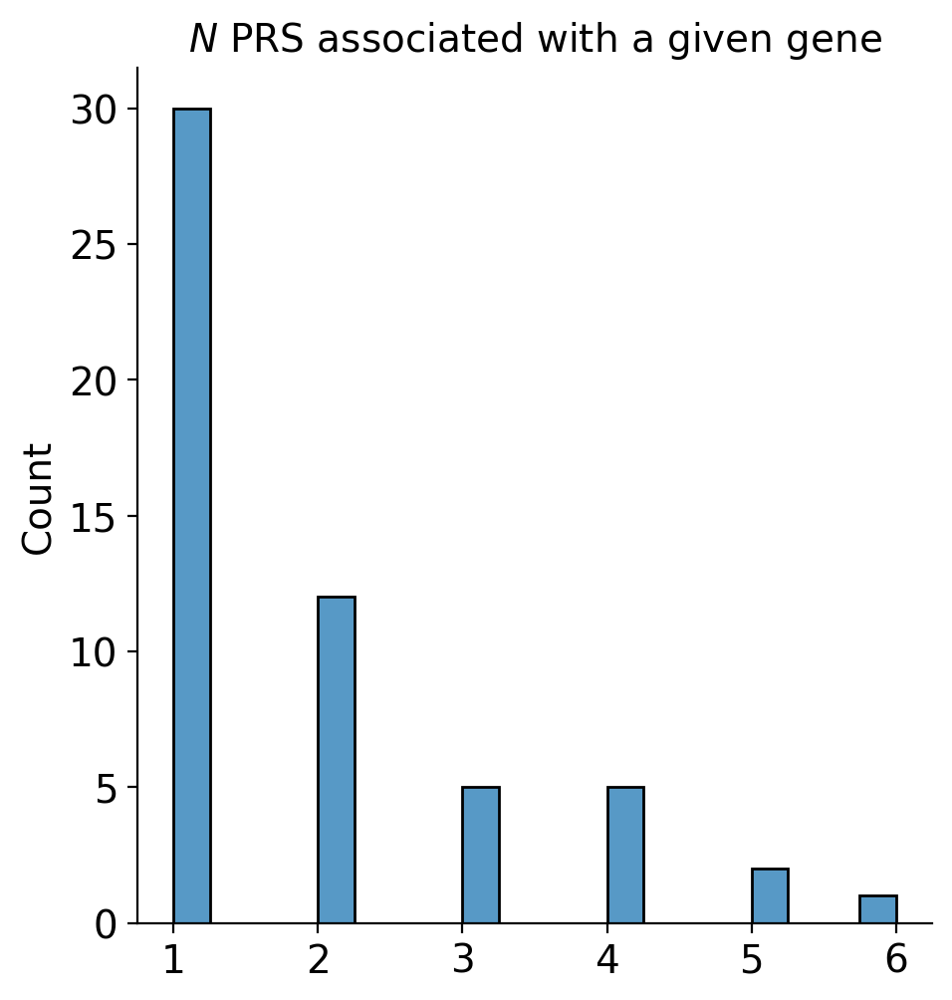

In [177]:
# N PRS associated with a given gene
sns.displot(prs_gene_ct.groupby("TopGene").apply(lambda x: x.PRS.nunique()).values, bins=20)
plt.title("$N$ PRS associated with a given gene")

In [178]:
# Check which genes are associated with more than 2 diseases
prs_gene_ct.groupby("TopGene").apply(lambda x: x.PRS.nunique()).loc[prs_gene_ct.groupby("TopGene").apply(lambda x: x.PRS.nunique()) > 2]

/tmp/ipykernel_1261514/4206438426.py:2: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
/tmp/ipykernel_1261514/4206438426.py:2: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


TopGene
CD79A       4
GZMK        3
HLA-B       3
HLA-C       3
HLA-DPB1    4
HLA-DQA1    4
HLA-DQA2    5
HLA-DQB1    3
HLA-DRB1    5
HLA-DRB5    6
RPL10       4
RPLP1       4
RPS29       3
dtype: int64

### RA-associated factors

In [179]:
prs_gene_ct.loc[prs_gene_ct.PRS == "RA"].groupby("Factor", observed=True).apply(lambda x: x.TopGene.unique())

/tmp/ipykernel_1261514/2498484252.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


Factor
D_Factor19                  [RPL10, HLA-DPA1, HLA-DRA, HLA-DPB1]
D_Factor210              [RPL13, RPL18A, RPS19, HLA-DQA1, RPL35]
D_Factor293                                 [HLA-DQA2, HLA-DRB5]
D_Factor41                     [HLA-DRB1, HLA-DQA1, CD74, RPL14]
D_Factor454                                           [HLA-DQA2]
D_Factor484                           [HLA-DQA1, HLA-DRB5, GZMK]
D_Factor634    [DUSP2, HLA-DQA1, TCF4, JUN, YBX3, RPLP1, CD79...
D_Factor663                                           [HLA-DRB1]
D_Factor72                                            [HLA-DQA1]
dtype: object

In [182]:
adata.var.loc[DxC_decoder["DxC_Factor454"].sort_values().head(10).index].GeneSymbol

Geneid
ENSG00000237541    HLA-DQA2
ENSG00000204482        LST1
ENSG00000197746        PSAP
ENSG00000019582        CD74
ENSG00000172543        CTSW
ENSG00000162434        JAK1
ENSG00000163191     S100A11
ENSG00000197956      S100A6
ENSG00000197747     S100A10
ENSG00000181036       FCRL6
Name: GeneSymbol, dtype: object

In [183]:
prs_gene_ct.loc[prs_gene_ct.Factor == "D_Factor454"].TopGene.unique()

array(['HLA-DQA2'], dtype=object)

In [184]:
PRS_effects.loc[PRS_effects.Factor == "D_Factor454"].SNP_id.unique()

array(['CeD', 'RA', 'T1D', 'UC', 'MS'], dtype=object)

#### DxC41

In [1894]:
adata.var.loc[DxC_decoder["DxC_Factor41"].sort_values(ascending=False).head(10).index].GeneSymbol

Geneid
ENSG00000196735    HLA-DQA1
ENSG00000196126    HLA-DRB1
ENSG00000188846       RPL14
ENSG00000019582        CD74
ENSG00000115268       RPS15
ENSG00000130255       RPL36
ENSG00000164587       RPS14
ENSG00000105369       CD79A
ENSG00000142676       RPL11
ENSG00000122862        SRGN
Name: GeneSymbol, dtype: category
Categories (14194, object): ['A1BG', 'A1CF', 'A2M', 'A2ML1', ..., 'ZZEF1', 'ZZZ3', 'hsa-mir-150', 'hsa-mir-1199']

In [772]:
prs_gene_ct.loc[prs_gene_ct.Factor == "D_Factor41"]

,PRS,Factor,TopGene,celltype,N_diseases,Disease,gene_chromosome,gene_start,gene_end,fPRS
5,Celiac,U_Factor41,RPS15,B IN,2,"Celiac, RA",19,1438358,1440583,Celiac__U_Factor41
6,Celiac,U_Factor41,HLA-DRB1,B IN,5,"Celiac, RA, Psoriasis, T1D, Multiple_sclerosis",6,32546546,32557625,Celiac__U_Factor41
7,Celiac,U_Factor41,HLA-DQA1,B IN,5,"Celiac, RA, Psoriasis, T1D, Multiple_sclerosis",6,32595956,32614839,Celiac__U_Factor41
8,Celiac,U_Factor41,CD74,B IN,2,"Celiac, RA",5,149781200,149792492,Celiac__U_Factor41
9,Celiac,U_Factor41,RPL21,B IN,3,"Celiac, RA, T2D",13,27825446,27830828,Celiac__U_Factor41
10,Celiac,U_Factor41,RPL14,B IN,4,"Celiac, RA, T1D, Multiple_sclerosis",3,40498783,40503861,Celiac__U_Factor41
80,RA,U_Factor41,RPS15,B IN,2,"Celiac, RA",19,1438358,1440583,RA__U_Factor41
81,RA,U_Factor41,HLA-DRB1,B IN,5,"Celiac, RA, Psoriasis, T1D, Multiple_sclerosis",6,32546546,32557625,RA__U_Factor41
82,RA,U_Factor41,HLA-DQA1,B IN,5,"Celiac, RA, Psoriasis, T1D, Multiple_sclerosis",6,32595956,32614839,RA__U_Factor41
83,RA,U_Factor41,CD74,B IN,2,"Celiac, RA",5,149781200,149792492,RA__U_Factor41


In [1731]:
enr_bio_41 = gp.enrichr(gene_list = prs_gene_ct.loc[prs_gene_ct.Factor == "D_Factor41"].TopGene.unique().tolist(), 
                          gene_sets = ["GO_Molecular_Function_2023", "GO_Biological_Process_2023", "Reactome_2022"], # databases_bio,
                          background = background_genes.values,
                          outdir=None)
enr_bio_41_sign = enr_bio_41.results.loc[enr_bio_41.results["Adjusted P-value"] <= 0.05]
enr_bio_41_sign.sort_values("Adjusted P-value", ascending=True).head(10)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Molecular_Function_2023,MHC Class II Protein Complex Binding (GO:0023026),1.291233e-08,1.162110e-07,0,0,2237.526316,40644.851303,CD74;HLA-DRB1;HLA-DQA1
9,GO_Biological_Process_2023,Immunoglobulin Mediated Immune Response (GO:00...,1.484843e-08,2.346052e-06,0,0,2125.500000,38312.927297,CD74;HLA-DRB1;HLA-DQA1
1,GO_Molecular_Function_2023,CD4 Receptor Binding (GO:0042609),8.930794e-07,3.750598e-06,0,0,3546.500000,49397.745538,CD74;HLA-DRB1
2,GO_Molecular_Function_2023,MHC Class II Receptor Activity (GO:0032395),1.250199e-06,3.750598e-06,0,0,2837.000000,38561.093062,HLA-DRB1;HLA-DQA1
167,Reactome_2022,MHC Class II Antigen Presentation R-HSA-2132295,7.679503e-07,3.762957e-05,0,0,529.125000,7449.837031,CD74;HLA-DRB1;HLA-DQA1
10,GO_Biological_Process_2023,Positive Regulation Of Monocyte Differentiatio...,1.250199e-06,8.619269e-05,0,0,2837.000000,38561.093062,CD74;HLA-DRB1
11,GO_Biological_Process_2023,Peptide Antigen Assembly With MHC Class II Pro...,3.273140e-06,8.619269e-05,0,0,1575.666667,19900.293087,HLA-DRB1;HLA-DQA1
12,GO_Biological_Process_2023,MHC Class II Protein Complex Assembly (GO:0002...,3.273140e-06,8.619269e-05,0,0,1575.666667,19900.293087,HLA-DRB1;HLA-DQA1
13,GO_Biological_Process_2023,Positive Regulation By Symbiont Of Entry Into ...,3.273140e-06,8.619269e-05,0,0,1575.666667,19900.293087,CD74;HLA-DRB1
14,GO_Biological_Process_2023,Positive Regulation Of Viral Entry Into Host C...,3.273140e-06,8.619269e-05,0,0,1575.666667,19900.293087,CD74;HLA-DRB1


In [1732]:
enr_bio_41_sign = enr_bio_41_sign.assign(gene_list = enr_bio_41_sign.Genes.str.split(";"))
enr_bio_41_sign = enr_bio_41_sign.assign(n_genes = enr_bio_41_sign.apply(lambda x: len(x.gene_list), axis=1))
enr_bio_41_sign.sort_values("n_genes",ascending=False)

,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes,gene_list,n_genes
0,GO_Molecular_Function_2023,MHC Class II Protein Complex Binding (GO:0023026),1.291233e-08,1.162110e-07,0,0,2237.526316,40644.851303,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
175,Reactome_2022,Adaptive Immune System R-HSA-1280218,3.256303e-04,1.669660e-03,0,0,65.661290,527.243607,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
9,GO_Biological_Process_2023,Immunoglobulin Mediated Immune Response (GO:00...,1.484843e-08,2.346052e-06,0,0,2125.500000,38312.927297,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
167,Reactome_2022,MHC Class II Antigen Presentation R-HSA-2132295,7.679503e-07,3.762957e-05,0,0,529.125000,7449.837031,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
178,Reactome_2022,Immune System R-HSA-168256,4.965479e-03,2.027571e-02,0,0,24.149235,128.117620,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
...,...,...,...,...,...,...,...,...,...,...,...
75,GO_Biological_Process_2023,Positive Regulation Of Alpha-Beta T Cell Activ...,3.939854e-03,9.154366e-03,0,0,363.512821,2012.629341,HLA-DRB1,[HLA-DRB1],1
74,GO_Biological_Process_2023,Regulation Of Inflammatory Response To Antigen...,3.658821e-03,8.758995e-03,0,0,393.833333,2209.646959,HLA-DRB1,[HLA-DRB1],1
73,GO_Biological_Process_2023,Negative Regulation Of Intrinsic Apoptotic Sig...,3.658821e-03,8.758995e-03,0,0,393.833333,2209.646959,CD74,[CD74],1
72,GO_Biological_Process_2023,Negative Regulation Of Inflammatory Response T...,3.658821e-03,8.758995e-03,0,0,393.833333,2209.646959,HLA-DRB1,[HLA-DRB1],1


In [1694]:
enr_bio_41_sign.sort_values("n_genes", ascending=False).head(10)

,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes,gene_list,n_genes
0,GO_Molecular_Function_2023,MHC Class II Protein Complex Binding (GO:0023026),1.291233e-08,1.162110e-07,0,0,2237.526316,40644.851303,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
175,Reactome_2022,Adaptive Immune System R-HSA-1280218,3.256303e-04,1.669660e-03,0,0,65.661290,527.243607,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
9,GO_Biological_Process_2023,Immunoglobulin Mediated Immune Response (GO:00...,1.484843e-08,2.346052e-06,0,0,2125.500000,38312.927297,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
167,Reactome_2022,MHC Class II Antigen Presentation R-HSA-2132295,7.679503e-07,3.762957e-05,0,0,529.125000,7449.837031,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
178,Reactome_2022,Immune System R-HSA-168256,4.965479e-03,2.027571e-02,0,0,24.149235,128.117620,CD74;HLA-DRB1;HLA-DQA1,"[CD74, HLA-DRB1, HLA-DQA1]",3
176,Reactome_2022,TCR Signaling R-HSA-202403,3.407469e-04,1.669660e-03,0,0,132.867925,1060.866754,HLA-DRB1;HLA-DQA1,"[HLA-DRB1, HLA-DQA1]",2
1,GO_Molecular_Function_2023,CD4 Receptor Binding (GO:0042609),8.930794e-07,3.750598e-06,0,0,3546.500000,49397.745538,CD74;HLA-DRB1,"[CD74, HLA-DRB1]",2
33,GO_Biological_Process_2023,Positive Regulation Of I-kappaB kinase/NF-kapp...,6.135349e-04,3.779831e-03,0,0,98.230769,726.541634,CD74;HLA-DRB1,"[CD74, HLA-DRB1]",2
34,GO_Biological_Process_2023,Regulation Of MAPK Cascade (GO:0043408),6.219974e-04,3.779831e-03,0,0,97.541667,720.108629,CD74;HLA-DRB1,"[CD74, HLA-DRB1]",2
35,GO_Biological_Process_2023,Positive Regulation Of Phosphorylation (GO:004...,6.651673e-04,3.892461e-03,0,0,94.234899,689.372763,CD74;HLA-DRB1,"[CD74, HLA-DRB1]",2


In [1727]:
enr_bio_41_sign.loc[enr_bio_41_sign.Gene_set == "GO_Biological_Process_2023"].sort_values("n_genes", ascending=False).head(10).Term.iloc[0]

'Immunoglobulin Mediated Immune Response (GO:0016064)'

/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/gseapy/plot.py:754: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
/tmp/ipykernel_166209/3090617197.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_166209/3090617197.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_166209/3090617197.py:20: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/li

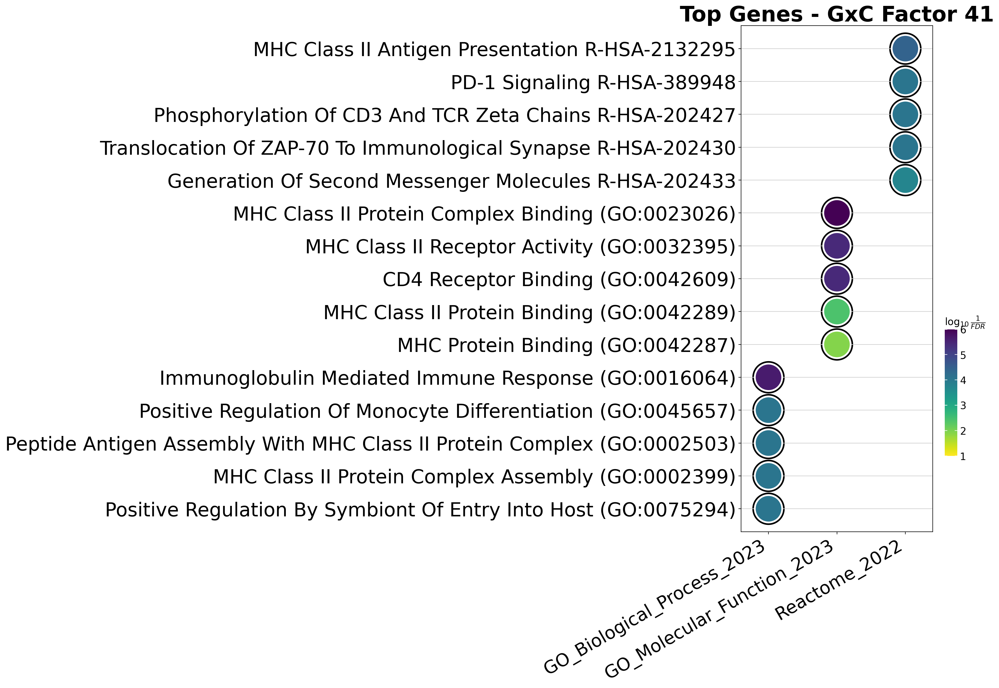

In [1709]:
fig, axs = plt.subplots(figsize=(6,13), constrained_layout=True)
make_gp_dotplot(df=enr_bio_41_sign,
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 5,
                title = "Top Genes - GxC Factor 41",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio_GxC-Factor41_RA-and-Celiac_TopGenes.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio_GxC-Factor41_RA-and-Celiac_TopGenes.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio_GxC-Factor41_RA-and-Celiac_TopGenes.pdf"), 
            transparent=True, bbox_inches="tight", dpi=500)

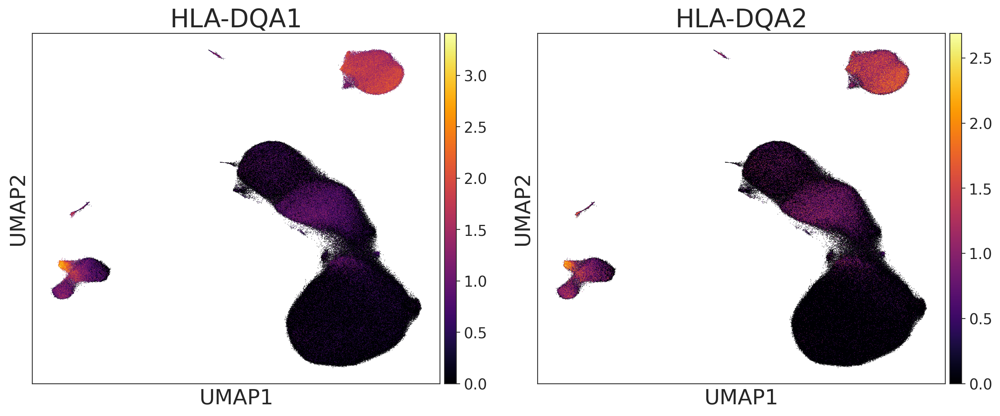

In [1470]:
# HLA-DQA1 vs HLA-DQA2 expression
axs = sc.pl.umap(adata,
                 color=adata.var.loc[adata.var.GeneSymbol.isin(["HLA-DQA1", "HLA-DQA2"])].index, 
                 title=adata.var.loc[adata.var.GeneSymbol.isin(["HLA-DQA1", "HLA-DQA2"])].GeneSymbol, 
                 cmap="inferno",
                 size=1,
                 hspace=0.14,
                 save=None,
                 show=False)

for ax in axs:
    ax.set_xlabel("UMAP1", fontsize=20)
    ax.set_ylabel("UMAP2", fontsize=20)
    ax.set_title(ax.get_title(), fontsize=24)


plt.savefig(os.path.join(model_results_dir, "Figures", "expression-of-HLA-DQA1-and-HLA-DQA2.png"), 
            bbox_inches="tight", transparent=True, dpi=400)


## Boxplot of genes for each factor

/data/danai/scripts/LIVI/src/analysis/plotting.py:2176: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/data/danai/scripts/LIVI/src/analysis/plotting.py:2180: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.


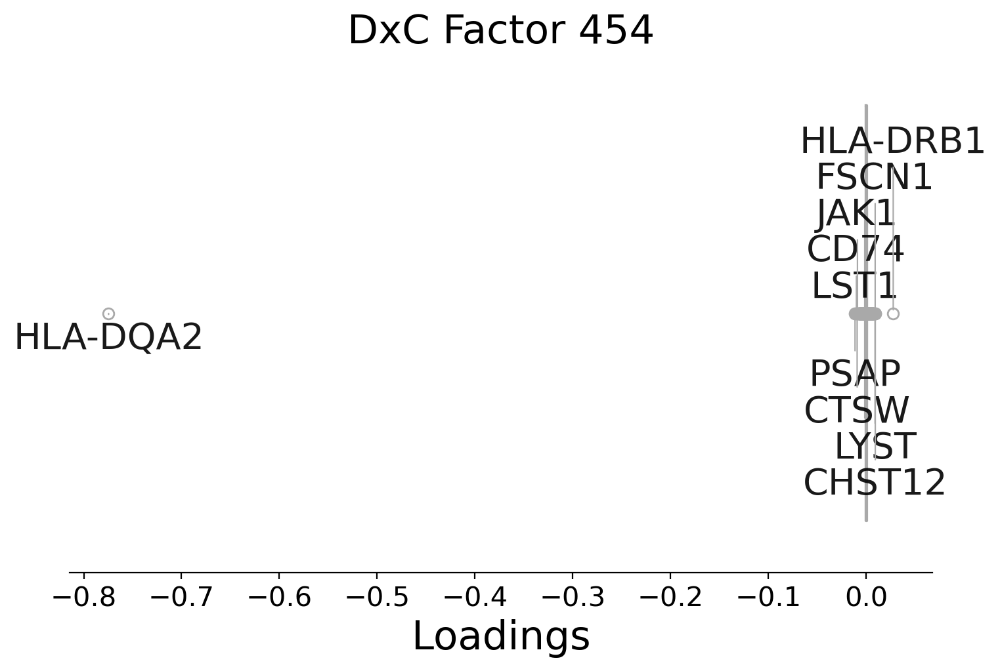

In [147]:
plot_gene_loadings_for_factor(
    DxC_decoder=DxC_decoder,
    factor="DxC_Factor454",
    n_top_genes=10,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    spines_invisible=True,
    annotation_fontsize=20,
    offset = 0.07,
    x_distance=3e-2,
    savefig=os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_DxC454.png"),
)

/data/danai/scripts/LIVI/src/analysis/plotting.py:2176: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/data/danai/scripts/LIVI/src/analysis/plotting.py:2180: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


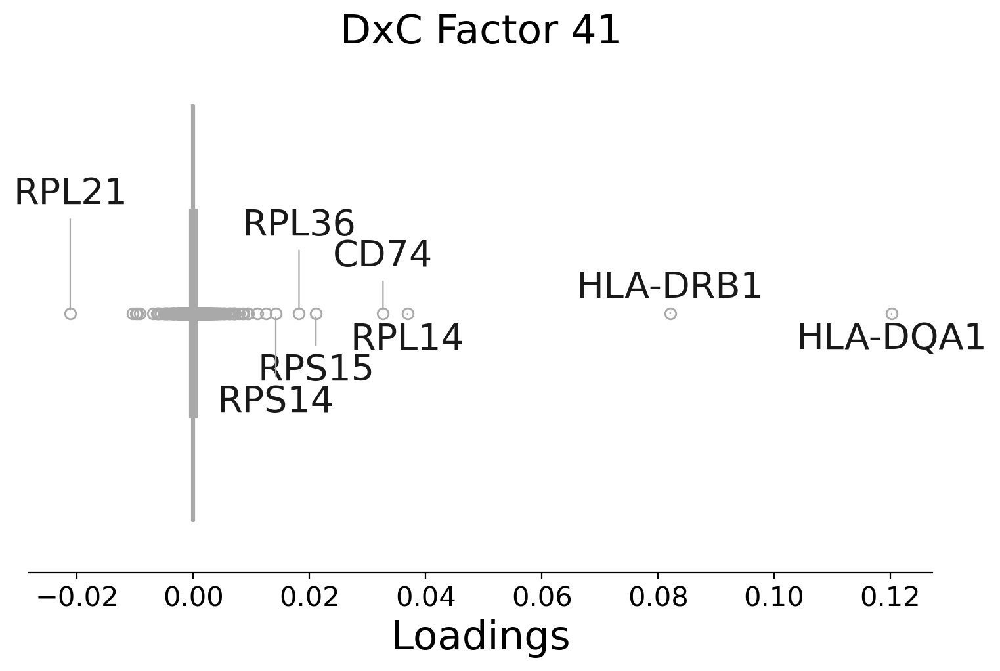

In [151]:
plot_gene_loadings_for_factor(
    DxC_decoder=DxC_decoder,
    factor="DxC_Factor41",
    n_top_genes=8,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    spines_invisible=True,
    annotation_fontsize=20,
    offset = 0.06,
    x_distance=3e-2,
    savefig=os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_DxC41.eps"),
)

## Factor and gene loadings correlations

In [76]:
jaccard_prs = {}
jaccard_ngenes = {}
for disease in ["RA", "MS", "CeD", "T1D", "Psoriasis", "UC"]:
    factors_topgenes = {}
    jaccard_factors = []
    total_ngenes = []
    for f in PRS_effects.loc[PRS_effects.SNP_id == disease].Factor.unique():
        f_gxc = f.replace("D", "DxC") 
        factors_topgenes[f_gxc.replace("DxC_Factor", "DxC")] = prs_gene_ct.loc[prs_gene_ct.Factor == f].TopGene.unique().tolist()
    for f1, f2 in itertools.combinations(factors_topgenes.keys(), 2):
        inter = len(set(factors_topgenes[f1]) & set(factors_topgenes[f2]))
        union = len(set(factors_topgenes[f1]) | set(factors_topgenes[f2]))
        sim = inter / union if union > 0 else 0
        jaccard_factors.append(sim)
        total_ngenes.append(union)
    jaccard_prs[disease] = jaccard_factors
    jaccard_ngenes[disease] = total_ngenes

In [2078]:
jaccard_ngenes = pd.DataFrame.from_dict(jaccard_ngenes, orient="index").fillna(0)
jaccard_ngenes

,0,1,2,3,4,5,6,7,8,9,...,143,144,145,146,147,148,149,150,151,152
RA,8,5.0,9.0,6.0,5.0,5.0,13.0,5.0,4.0,8.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
MS,2,3.0,2.0,2.0,3.0,2.0,2.0,2.0,1.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CeD,8,5.0,5.0,9.0,5.0,5.0,5.0,5.0,5.0,5.0,...,3.0,2.0,2.0,5.0,3.0,3.0,6.0,2.0,5.0,4.0
T1D,3,1.0,2.0,2.0,1.0,4.0,3.0,2.0,3.0,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Psoriasis,2,2.0,2.0,3.0,2.0,2.0,2.0,3.0,2.0,6.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
UC,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [2076]:
jaccard_prs = pd.melt(pd.DataFrame.from_dict(jaccard_prs, orient="index").reset_index(names=["PRS"]), id_vars="PRS", value_name="Jaccard similarity")
jaccard_prs

,PRS,variable,Jaccard similarity
0,RA,0,0.00
1,MS,0,0.00
2,CeD,0,0.00
3,T1D,0,0.00
4,Psoriasis,0,0.00
...,...,...,...
913,MS,152,NaN
914,CeD,152,0.25
915,T1D,152,NaN
916,Psoriasis,152,NaN


In [2079]:
jaccard_ngenes = pd.melt(jaccard_ngenes.reset_index(names=["PRS"]), id_vars="PRS", value_name="N_genes")
jaccard_ngenes

,PRS,variable,N_genes
0,RA,0,8.0
1,MS,0,2.0
2,CeD,0,8.0
3,T1D,0,3.0
4,Psoriasis,0,2.0
...,...,...,...
913,MS,152,0.0
914,CeD,152,4.0
915,T1D,152,0.0
916,Psoriasis,152,0.0


In [2081]:
jaccard_prs = jaccard_prs.merge(jaccard_ngenes.N_genes, right_index=True, left_index=True)
jaccard_prs

,PRS,variable,Jaccard similarity,N_genes
0,RA,0,0.00,8.0
1,MS,0,0.00,2.0
2,CeD,0,0.00,8.0
3,T1D,0,0.00,3.0
4,Psoriasis,0,0.00,2.0
...,...,...,...,...
913,MS,152,NaN,0.0
914,CeD,152,0.25,4.0
915,T1D,152,NaN,0.0
916,Psoriasis,152,NaN,0.0


In [2084]:
mean_similarity = jaccard_prs.groupby("PRS").apply(lambda x: x["Jaccard similarity"].mean()).to_dict()
mean_similarity

/tmp/ipykernel_166209/198900505.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


{'CeD': 0.05236822001527884,
 'MS': 0.09340659340659341,
 'Psoriasis': 0.1515151515151515,
 'RA': 0.08770773979107312,
 'T1D': 0.20238095238095238,
 'UC': 0.5}

In [2089]:
jaccard_prs.PRS = pd.Categorical(jaccard_prs.PRS, categories = ["RA", "MS", "CeD", "T1D", "Psoriasis", "UC"], ordered=True)

In [2143]:
codes_PRS_dict = dict(zip(jaccard_prs.PRS.cat.codes.astype(str).tolist(), jaccard_prs.PRS))
codes_PRS_dict

{'0': 'RA', '1': 'MS', '2': 'CeD', '3': 'T1D', '4': 'Psoriasis', '5': 'UC'}

/tmp/ipykernel_166209/2627653490.py:28: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


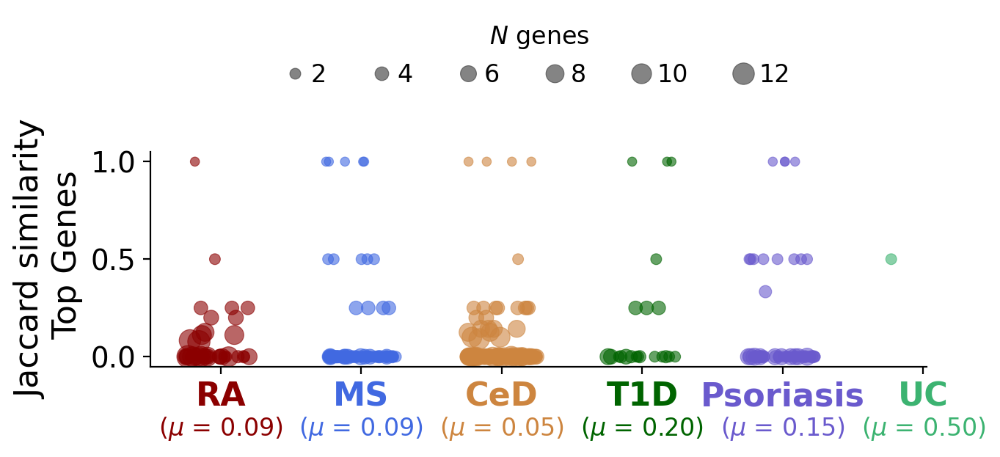

In [2190]:
# make a numerical column and add some jitter
jaccard_prs["PRS_jittered"] = jaccard_prs.PRS.cat.codes + np.random.uniform(-0.25, 0.25, jaccard_prs.shape[0])

fig, axs = plt.subplots(nrows=1, ncols=1,figsize=(6.7,3), constrained_layout=True)

sns.scatterplot(x="PRS_jittered", y="Jaccard similarity", data=jaccard_prs.dropna(axis=0, subset=["Jaccard similarity"]),
                hue="PRS", size="N_genes", sizes=(20,120), size_norm=(1.0, jaccard_prs.N_genes.max()), palette=PRS_colors_dark, ax=axs, 
                alpha=0.6, edgecolor="face")

axs.set_ylabel("Jaccard similarity\n Top Genes", fontsize=16)
# tick_interval = np.abs(axs.get_yticks().max() - axs.get_yticks().min())/4
axs.set_yticks(np.arange(0, 1.5, 0.5), np.arange(0, 1.5, 0.5), fontsize=14)
axs.set_xlabel("")

axs.spines["right"].set_visible(False)
axs.spines["top"].set_visible(False)

for label in axs.get_xticklabels():
    DC = label.get_text()
    if DC in codes_PRS_dict.keys():
        DL = codes_PRS_dict[DC]
        label.set_color(PRS_colors_dark[DL])

new_xlabels = [codes_PRS_dict[label.get_text()] 
               if label.get_text() in codes_PRS_dict.keys()
               else label.get_text() 
               for label in axs.get_xticklabels()]
axs.set_xticklabels(new_xlabels, fontdict={"fontsize":16.5, }) # "fontweight":"bold"

xticks = axs.get_xticks()

for x, label in zip(xticks, new_xlabels):
    if label in mean_similarity.keys():
        axs.annotate(
            text=f"($\mu$ = {mean_similarity[label]:.2f})",
            xy=(x, 0),
            xytext=(x, -0.3), 
            ha="center", 
            va="top",
            color=PRS_colors_dark[label],
            fontsize=12.5,
            annotation_clip=False  # draws outside the axes
        )

legend_handles, legend_labels = (axs.get_legend_handles_labels()[0][8:], axs.get_legend_handles_labels()[1][8:])

legend_labels = [str(int(la)) for la in np.ceil([float(la) for la in legend_labels])]

axs.legend(title="$N$ genes", labels=legend_labels, handles=legend_handles, frameon=False, loc="best", title_fontsize=13, fontsize=13, 
           ncol=len(legend_labels), bbox_to_anchor=(0.15, 1.2))

plt.savefig(os.path.join(model_results_dir, "Figures", "Stripplots_Jaccard-similarity_GxC-loadings-TopGenes_PRS-associated-factors_dark-colors_dot-size-N-genes.png"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Stripplots_Jaccard-similarity_GxC-loadings-TopGenes_PRS-associated-factors_dark-colors_dot-size-N-genes.eps"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Stripplots_Jaccard-similarity_GxC-loadings-TopGenes_PRS-associated-factors_dark-colors_dot-size-N-genes.pdf"), 
            transparent=True, dpi=500, bbox_inches="tight")

In [269]:
PRS_genes = outtable.groupby("PRS").apply(lambda x: x.TopGenes.unique(), include_groups=False)
PRS_genes

PRS
CeD          [CD52; HLA-DPA1; HLA-DRA; HLA-DPB1; PSMB9; RAR...
MS           [HLA-A, MT-CO2; HLA-A; IGJ; MT-ND4, MT-CO1; MT...
Psoriasis    [HLA-B, HLA-B; HLA-C; ARPC3, AIF1, HLA-DRB5, C...
RA           [DUSP2; HLA-DQA1; TCF4; JUN; YBX3; RPLP1; CD79...
T1D          [HLA-DQB1, HLA-DPB1; HLA-DRB1; RPS29; HLA-DQB1...
UC                              [HLA-DQA2; HLA-DRB5, HLA-DQA2]
dtype: object

In [270]:
PRS_genes = PRS_genes.apply(lambda x: "; ".join(x))
PRS_genes = PRS_genes.apply(lambda x: x.split("; "))
PRS_genes = PRS_genes.apply(lambda x: set(x))
PRS_genes

PRS
CeD          {CD79A, PSME2, WARS, HLA-DRB1, HLA-DPB1, HLA-D...
MS           {CD79A, HLA-DRB1, HLA-DPB1, GZMK, HLA-DQB1, B2...
Psoriasis    {AIF1, CYBA, CCL3, CCL5, FTL, TMSB4X, ARPC3, K...
RA           {BTG1, CD79A, HLA-DRB1, HLA-DPB1, HLA-DRA, CD7...
T1D          {RPS29, RPLP1, CD79A, HLA-DQB1, HLA-DRB1, RPL1...
UC                                        {HLA-DQA2, HLA-DRB5}
dtype: object

In [271]:
jaccard_between_prs = pd.DataFrame(index=PRS_genes.index, columns=PRS_genes.index)
for p1, p2 in itertools.combinations(PRS_genes.index, 2):
    inter = len(PRS_genes[p1] & PRS_genes[p2])
    union = len(PRS_genes[p1] | PRS_genes[p2])
    sim = inter / union if union > 0 else 0
    jaccard_between_prs.loc[p1, p2] = sim
    jaccard_between_prs.loc[p2, p1] = sim

jaccard_between_prs

PRS,CeD,MS,Psoriasis,RA,T1D,UC
PRS,,,,,,
CeD,NaN,0.384615,0.133333,0.414634,0.285714,0.057143
MS,0.384615,NaN,0.129032,0.272727,0.526316,0.105263
Psoriasis,0.133333,0.129032,NaN,0.054054,0.083333,0.058824
RA,0.414634,0.272727,0.054054,NaN,0.32,0.086957
T1D,0.285714,0.526316,0.083333,0.32,NaN,0.2
UC,0.057143,0.105263,0.058824,0.086957,0.2,NaN


In [272]:
jaccard_between_prs = jaccard_between_prs.fillna(1)
jaccard_between_prs

/tmp/ipykernel_1261514/935846824.py:1: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`


PRS,CeD,MS,Psoriasis,RA,T1D,UC
PRS,,,,,,
CeD,1.000000,0.384615,0.133333,0.414634,0.285714,0.057143
MS,0.384615,1.000000,0.129032,0.272727,0.526316,0.105263
Psoriasis,0.133333,0.129032,1.000000,0.054054,0.083333,0.058824
RA,0.414634,0.272727,0.054054,1.000000,0.320000,0.086957
T1D,0.285714,0.526316,0.083333,0.320000,1.000000,0.200000
UC,0.057143,0.105263,0.058824,0.086957,0.200000,1.000000


In [273]:
jaccard_between_prs.min()

PRS
CeD          0.057143
MS           0.105263
Psoriasis    0.054054
RA           0.054054
T1D          0.083333
UC           0.057143
dtype: float64

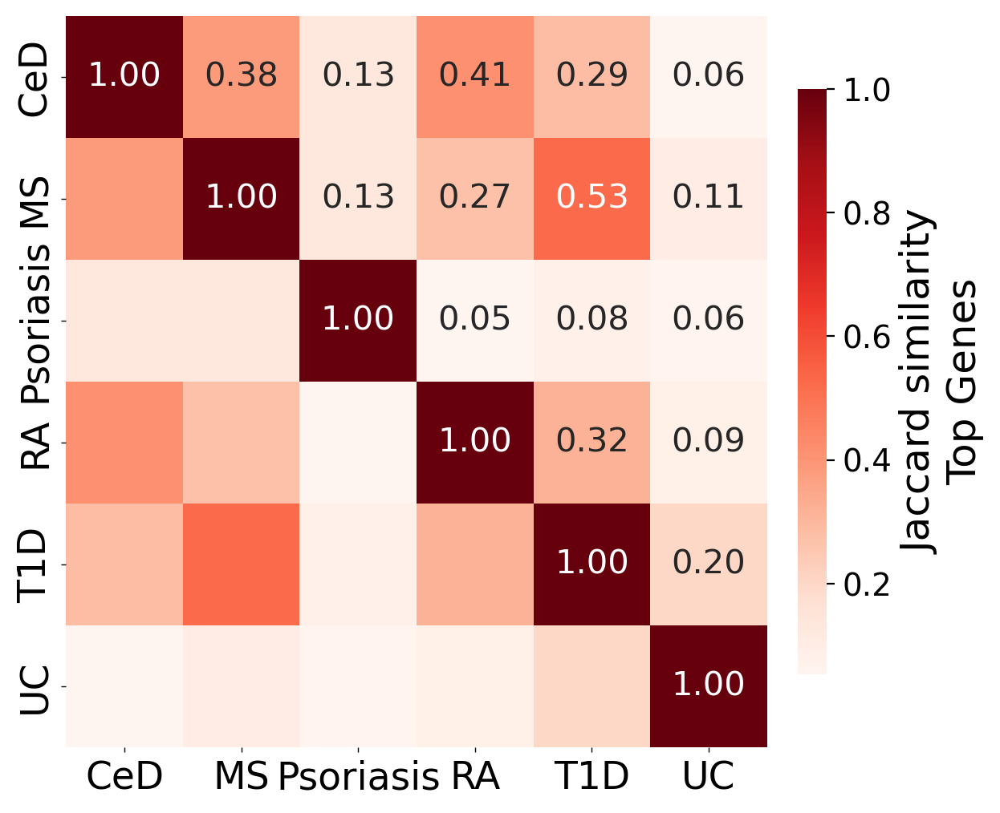

In [279]:
hmap = sns.heatmap(jaccard_between_prs, 
                   cmap="Reds", 
                   vmin=jaccard_between_prs.min().min(),
                   vmax=jaccard_between_prs.max().max(),
                   annot=False,
                   cbar_kws={"label":"Jaccard similarity\nTop Genes", "anchor":(-0.13,0.5), "shrink":0.8},
                   rasterized = True)

hmap.set_xlabel("")
hmap.set_ylabel("")
cbar = hmap.collections[0].colorbar
cbar.ax.tick_params(labelsize=14)
cbar.ax.yaxis.label.set_size(18) 

# Add (only) annotations to the upper triangle
mask = np.tril(np.ones_like(jaccard_between_prs, dtype=bool), k=-1)

hmap = sns.heatmap(jaccard_between_prs, 
                   cmap="Reds", 
                   vmin=jaccard_between_prs.min().min(),
                   vmax=jaccard_between_prs.max().max(),
                   mask=mask,
                   annot=True,
                   fmt=".2f", 
                   annot_kws={"size":15},
                   cbar=False,
                   alpha=0,
                   rasterized = True)
hmap.set_xlabel("")
hmap.set_ylabel("")

plt.tick_params(axis="both", which="both", labelsize=17, length=2, width=0.5)

plt.savefig(os.path.join(model_results_dir, "Figures", "Jaccard-similarity-TopGenes_between-PRS.png"), 
            dpi=400, transparent=True, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Jaccard-similarity-TopGenes_between-PRS.pdf"), 
            dpi=400, transparent=True, bbox_inches="tight")

In [315]:
adata.var.loc[adata.var.GeneSymbol.isin(prs_gene_ct.TopGene.unique())].gene_chromosome.value_counts()

gene_chromosome
6     14
19     5
12     4
17     3
9      2
16     2
15     2
5      2
X      1
2      1
7      1
1      1
MT     1
18     1
3      1
Name: count, dtype: int64

In [316]:
adata.var.loc[(adata.var.GeneSymbol.isin(prs_gene_ct.TopGene.unique())) & (adata.var.gene_chromosome == "X")]

,GeneSymbol,features,MITO,RIBO,ERCC,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,...,downregulated_CD8T,upregulated_B,downregulated_B,upregulated_Mono,downregulated_Mono,upregulated_DC,downregulated_DC,gene_chromosome,gene_start,gene_end
Geneid,,,,,,,,,,,,,,,,,,,,,
ENSG00000147403,RPL10,RPL10,False,False,False,1272337,41.725327,3.754792,0.011945,53095020.0,...,True,True,True,True,True,False,True,X,153618315,153637504


In [317]:
# prs_gene_ct.loc[prs_gene_ct.TopGene.isin(["RPL10", "TMSB4X"])]
prs_gene_ct.loc[prs_gene_ct.TopGene.isin(["RPL10"])]

,PRS,Factor,TopGene,celltype
0,Celiac,U_Factor19,RPL10,B IN
1,Celiac,U_Factor19,RPL10,Plasma
25,Celiac,U_Factor687,RPL10,Mono C
26,RA,U_Factor19,RPL10,B IN
27,RA,U_Factor19,RPL10,Plasma
70,T1D,U_Factor687,RPL10,Mono C
90,Multiple_sclerosis,U_Factor687,RPL10,Mono C


In [318]:
# Where are the genes associated with more than 3 diseases located
adata.var.loc[adata.var.GeneSymbol.isin(prs_gene_ct.groupby("TopGene").apply(
    lambda x: x.PRS.nunique()
).loc[prs_gene_ct.groupby("TopGene").apply(lambda x: x.PRS.nunique()) > 3].index)
].gene_chromosome.value_counts()

/tmp/ipykernel_1081609/3102824818.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
/tmp/ipykernel_1081609/3102824818.py:4: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


gene_chromosome
6     4
X     1
15    1
Name: count, dtype: int64

### Manhattan plot of the genomic locations of the identified autoimmune-involved genes

In [54]:
prs_gene_ct = prs_gene_ct.merge(
    prs_gene_ct.groupby("TopGene", observed=True).apply(lambda x: x.PRS.nunique(), include_groups=False).rename("N_diseases").reset_index(),
    on="TopGene", how="left"
)
prs_gene_ct

,PRS,Factor,TopGene,celltype,N_diseases
0,Celiac,U_Factor19,RPL10,B IN,4
1,Celiac,U_Factor19,HLA-DPA1,B IN,2
2,Celiac,U_Factor19,HLA-DRA,B IN,2
3,Celiac,U_Factor19,HLA-DPB1,B IN,2
4,Celiac,U_Factor19,RPL10,Plasma,4
...,...,...,...,...,...
164,UC,U_Factor293,HLA-DQA2,B IN,5
165,UC,U_Factor293,HLA-DRB5,B IN,6
166,UC,U_Factor454,HLA-DQA2,CD8 S100B,5
167,UC,U_Factor454,HLA-DQA2,NK,5


In [56]:
prs_gene_ct = prs_gene_ct.merge(
    prs_gene_ct.groupby("TopGene", observed=True).apply(lambda x: x.PRS.unique(), include_groups=False).rename("Disease").reset_index(),
    on="TopGene", how="left"
)
prs_gene_ct

,PRS,Factor,TopGene,celltype,N_diseases,Disease
0,CeD,U_Factor19,RPL10,B IN,4,"[CeD, RA, T1D, MS]"
1,CeD,U_Factor19,HLA-DPA1,B IN,2,"[CeD, RA]"
2,CeD,U_Factor19,HLA-DRA,B IN,2,"[CeD, RA]"
3,CeD,U_Factor19,HLA-DPB1,B IN,2,"[CeD, RA]"
4,CeD,U_Factor19,RPL10,Plasma,4,"[CeD, RA, T1D, MS]"
...,...,...,...,...,...,...
164,UC,U_Factor293,HLA-DQA2,B IN,5,"[CeD, RA, T1D, MS, UC]"
165,UC,U_Factor293,HLA-DRB5,B IN,6,"[CeD, RA, Psoriasis, T1D, MS, UC]"
166,UC,U_Factor454,HLA-DQA2,CD8 S100B,5,"[CeD, RA, T1D, MS, UC]"
167,UC,U_Factor454,HLA-DQA2,NK,5,"[CeD, RA, T1D, MS, UC]"


In [57]:
prs_gene_ct["Disease"] = prs_gene_ct.apply(lambda x: ", ".join(x.Disease), axis=1)
prs_gene_ct

,PRS,Factor,TopGene,celltype,N_diseases,Disease
0,CeD,U_Factor19,RPL10,B IN,4,"CeD, RA, T1D, MS"
1,CeD,U_Factor19,HLA-DPA1,B IN,2,"CeD, RA"
2,CeD,U_Factor19,HLA-DRA,B IN,2,"CeD, RA"
3,CeD,U_Factor19,HLA-DPB1,B IN,2,"CeD, RA"
4,CeD,U_Factor19,RPL10,Plasma,4,"CeD, RA, T1D, MS"
...,...,...,...,...,...,...
164,UC,U_Factor293,HLA-DQA2,B IN,5,"CeD, RA, T1D, MS, UC"
165,UC,U_Factor293,HLA-DRB5,B IN,6,"CeD, RA, Psoriasis, T1D, MS, UC"
166,UC,U_Factor454,HLA-DQA2,CD8 S100B,5,"CeD, RA, T1D, MS, UC"
167,UC,U_Factor454,HLA-DQA2,NK,5,"CeD, RA, T1D, MS, UC"


In [58]:
prs_gene_ct = prs_gene_ct.merge(adata.var.filter(like="ene").rename(columns={"GeneSymbol":"TopGene"}), on="TopGene", how="left")
prs_gene_ct

,PRS,Factor,TopGene,celltype,N_diseases,Disease,gene_chromosome,gene_start,gene_end
0,CeD,U_Factor19,RPL10,B IN,4,"CeD, RA, T1D, MS",X,153618315,153637504
1,CeD,U_Factor19,HLA-DPA1,B IN,2,"CeD, RA",6,33032346,33048552
2,CeD,U_Factor19,HLA-DRA,B IN,2,"CeD, RA",6,32407619,32412823
3,CeD,U_Factor19,HLA-DPB1,B IN,2,"CeD, RA",6,33043703,33054978
4,CeD,U_Factor19,RPL10,Plasma,4,"CeD, RA, T1D, MS",X,153618315,153637504
...,...,...,...,...,...,...,...,...,...
164,UC,U_Factor293,HLA-DQA2,B IN,5,"CeD, RA, T1D, MS, UC",6,32709119,32714992
165,UC,U_Factor293,HLA-DRB5,B IN,6,"CeD, RA, Psoriasis, T1D, MS, UC",6,32485120,32498064
166,UC,U_Factor454,HLA-DQA2,CD8 S100B,5,"CeD, RA, T1D, MS, UC",6,32709119,32714992
167,UC,U_Factor454,HLA-DQA2,NK,5,"CeD, RA, T1D, MS, UC",6,32709119,32714992


In [1186]:
prs_gene_ct = prs_gene_ct.assign(fPRS = prs_gene_ct.PRS + "__" + prs_gene_ct.Factor)
prs_gene_ct

,PRS,Factor,TopGene,celltype,fPRS
0,CeD,U_Factor19,RPL10,B IN,CeD__U_Factor19
0,CeD,U_Factor19,HLA-DPA1,B IN,CeD__U_Factor19
0,CeD,U_Factor19,HLA-DRA,B IN,CeD__U_Factor19
0,CeD,U_Factor19,HLA-DPB1,B IN,CeD__U_Factor19
1,CeD,U_Factor19,RPL10,Plasma,CeD__U_Factor19
...,...,...,...,...,...
92,UC,U_Factor293,HLA-DQA2,B IN,UC__U_Factor293
92,UC,U_Factor293,HLA-DRB5,B IN,UC__U_Factor293
93,UC,U_Factor454,HLA-DQA2,CD8 S100B,UC__U_Factor454
94,UC,U_Factor454,HLA-DQA2,NK,UC__U_Factor454


In [98]:
PRS_effects_all = pd.read_csv(os.path.join(model_results_dir, "PRS_LMM_results_Ucontext.tsv"),
                          sep="\t")
PRS_effects_all

,Factor,SNP_id,effect_size,effect_size_se,p_value
0,U_Factor1,PDW,-0.000407,0.019926,0.983696
1,U_Factor1,IBD,-0.015128,0.019835,0.445590
2,U_Factor1,Monocyte_count,-0.009436,0.020134,0.639313
3,U_Factor1,Lymphocyte_percentage,0.048807,0.019880,0.013938
4,U_Factor1,Celiac,-0.005564,0.020520,0.786272
...,...,...,...,...,...
15395,U_Factor700,UC,0.032401,0.037978,0.393481
15396,U_Factor700,Lymphocyte_count,0.063692,0.038393,0.096894
15397,U_Factor700,T2D,0.038222,0.039363,0.331436
15398,U_Factor700,Endometriosis,-0.006174,0.038401,0.872277


In [99]:
PRS_effects_all.SNP_id.unique()

array(['PDW', 'IBD', 'Monocyte_count', 'Lymphocyte_percentage', 'Celiac',
       'RA', 'MCV', 'Psoriasis', 'Plateletcrit', 'MPV', 'T1D',
       'Monocyte_percentage', 'Height', 'Platelet_count', 'RBC',
       'Leukocyte_count', 'RBDW', 'UC', 'Lymphocyte_count', 'T2D',
       'Endometriosis', 'Multiple_sclerosis'], dtype=object)

In [100]:
# Focus on autoimmune diseases
PRS_effects_all = PRS_effects_all.loc[
PRS_effects_all.SNP_id.isin(["IBD", "Celiac", "UC", "T1D", "Multiple_sclerosis", "Psoriasis", "RA"])
]

In [101]:
PRS_effects_all = PRS_effects_all.assign(Celltype = PRS_effects_all.apply(lambda x: U_celltype[x.Factor], axis=1))

In [102]:
PRS_effects_all.SNP_id.replace({"Multiple_sclerosis":"MS", "Celiac":"CeD"}, inplace=True)
PRS_effects_all = PRS_effects_all.assign(fPRS = PRS_effects_all.SNP_id+"__"+PRS_effects_all.Factor)

/tmp/ipykernel_37593/2644263843.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




In [103]:
prs_gene_ct_all = []
for prs in PRS_effects_all.SNP_id.unique():
    prs_topgene = []
    prs_ct = []
    prs_factor = []
    for idx, row in PRS_effects_all.loc[PRS_effects_all.SNP_id == prs].iterrows():
        topgenes = select_important_genes_for_factor_IQR(
            genes_factors_loadings=GxC_decoder.to_numpy(),
            factor_idx=int(row.Factor.replace("U_Factor", ""))-1,
            gene_names=adata.var.loc[GxC_decoder.index].GeneSymbol,
            direction="both",
            threshold = 100,
            plot = False,
        )
        prs_topgene.append(topgenes)
        prs_ct.append(row.Celltype)
        prs_factor.append(row.Factor)
        
    gene_ct = pd.DataFrame({"PRS": [prs]*len(prs_ct),
                            "Factor": prs_factor,
                            "TopGene": prs_topgene,
                            "celltype": prs_ct})
    prs_gene_ct_all.append(gene_ct)

prs_gene_ct_all = pd.concat(prs_gene_ct_all, axis=0, ignore_index=True)
prs_gene_ct_all

/data/danai/scripts/LIVI/src/analysis/_utils.py:167: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


,PRS,Factor,TopGene,celltype
0,IBD,U_Factor1,"[FTL, CCL4, RPS16]","[Mono C, Mono NC, CD8 S100B]"
1,IBD,U_Factor2,"[A1BG, SOX4, ITM2A, CD8B, CD8A, TXNIP, CLEC11A...",[CD4 SOX4]
2,IBD,U_Factor3,[],None
3,IBD,U_Factor4,"[VMP1, CITED2, TSC22D3, ARRDC3, TNFAIP3, CD69,...","[CD4 SOX4, CD8 S100B]"
4,IBD,U_Factor5,[RPS5],None
...,...,...,...,...
4895,MS,U_Factor696,[RPS10],None
4896,MS,U_Factor697,"[MT-CO1, MT-CO3]",None
4897,MS,U_Factor698,[LGALS2],[Mono C]
4898,MS,U_Factor699,[EEF1D],"[Plasma, CD8 S100B]"


In [104]:
prs_gene_ct_all = prs_gene_ct_all.explode("TopGene")

In [105]:
prs_gene_ct_all = prs_gene_ct_all.assign(fPRS = prs_gene_ct_all.PRS + "__" + prs_gene_ct_all.Factor)
prs_gene_ct_all = prs_gene_ct_all.merge(adata.var.filter(like="ene").rename(columns={"GeneSymbol":"TopGene"}), on="TopGene", how="left")
prs_gene_ct_all 

,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end
0,IBD,U_Factor1,FTL,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,19,49468558.0,49470135.0
1,IBD,U_Factor1,CCL4,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,17,34430983.0,34433014.0
2,IBD,U_Factor1,RPS16,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,19,39923847.0,39926588.0
3,IBD,U_Factor2,A1BG,[CD4 SOX4],IBD__U_Factor2,19,58856544.0,58864865.0
4,IBD,U_Factor2,SOX4,[CD4 SOX4],IBD__U_Factor2,6,21593972.0,21598847.0
...,...,...,...,...,...,...,...,...
13974,MS,U_Factor697,MT-CO1,None,MS__U_Factor697,MT,5904.0,7445.0
13975,MS,U_Factor697,MT-CO3,None,MS__U_Factor697,MT,9207.0,9990.0
13976,MS,U_Factor698,LGALS2,[Mono C],MS__U_Factor698,22,37966255.0,37978623.0
13977,MS,U_Factor699,EEF1D,"[Plasma, CD8 S100B]",MS__U_Factor699,8,144661867.0,144681711.0


In [106]:
prs_gene_ct_all = prs_gene_ct_all.merge(prs_gene_ct.filter(["TopGene", "N_diseases"]).drop_duplicates(), on="TopGene", how="left")
# Set the number of diseases to 0 for non-significant associations
prs_gene_ct_all.loc[~prs_gene_ct_all.fPRS.isin(prs_gene_ct.fPRS), "N_diseases"] = 0
prs_gene_ct_all 

,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end,N_diseases
0,IBD,U_Factor1,FTL,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,19,49468558.0,49470135.0,0.0
1,IBD,U_Factor1,CCL4,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,17,34430983.0,34433014.0,0.0
2,IBD,U_Factor1,RPS16,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,19,39923847.0,39926588.0,0.0
3,IBD,U_Factor2,A1BG,[CD4 SOX4],IBD__U_Factor2,19,58856544.0,58864865.0,0.0
4,IBD,U_Factor2,SOX4,[CD4 SOX4],IBD__U_Factor2,6,21593972.0,21598847.0,0.0
...,...,...,...,...,...,...,...,...,...
13974,MS,U_Factor697,MT-CO1,None,MS__U_Factor697,MT,5904.0,7445.0,0.0
13975,MS,U_Factor697,MT-CO3,None,MS__U_Factor697,MT,9207.0,9990.0,0.0
13976,MS,U_Factor698,LGALS2,[Mono C],MS__U_Factor698,22,37966255.0,37978623.0,0.0
13977,MS,U_Factor699,EEF1D,"[Plasma, CD8 S100B]",MS__U_Factor699,8,144661867.0,144681711.0,0.0


In [107]:
prs_gene_ct_all = prs_gene_ct_all.merge(prs_gene_ct.filter(["TopGene", "Disease"]).drop_duplicates(), on="TopGene", how="left")
# Set the diseases to None for non-significant associations
prs_gene_ct_all.loc[~prs_gene_ct_all.fPRS.isin(prs_gene_ct.fPRS), "Disease"] = "None"
prs_gene_ct_all


,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end,N_diseases,Disease
0,IBD,U_Factor1,FTL,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,19,49468558.0,49470135.0,0.0,None
1,IBD,U_Factor1,CCL4,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,17,34430983.0,34433014.0,0.0,None
2,IBD,U_Factor1,RPS16,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,19,39923847.0,39926588.0,0.0,None
3,IBD,U_Factor2,A1BG,[CD4 SOX4],IBD__U_Factor2,19,58856544.0,58864865.0,0.0,None
4,IBD,U_Factor2,SOX4,[CD4 SOX4],IBD__U_Factor2,6,21593972.0,21598847.0,0.0,None
...,...,...,...,...,...,...,...,...,...,...
13974,MS,U_Factor697,MT-CO1,None,MS__U_Factor697,MT,5904.0,7445.0,0.0,None
13975,MS,U_Factor697,MT-CO3,None,MS__U_Factor697,MT,9207.0,9990.0,0.0,None
13976,MS,U_Factor698,LGALS2,[Mono C],MS__U_Factor698,22,37966255.0,37978623.0,0.0,None
13977,MS,U_Factor699,EEF1D,"[Plasma, CD8 S100B]",MS__U_Factor699,8,144661867.0,144681711.0,0.0,None


In [108]:
prs_gene_ct_all.loc[~prs_gene_ct_all.fPRS.isin(prs_gene_ct.fPRS)].Disease.unique()

array(['None'], dtype=object)

In [109]:
prs_gene_ct_all = prs_gene_ct_all.merge(PRS_effects_all.filter(["p_value", "fPRS"]), on="fPRS", how="left")

In [110]:
prs_gene_ct_all

,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end,N_diseases,Disease,p_value
0,IBD,U_Factor1,FTL,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,19,49468558.0,49470135.0,0.0,None,0.445590
1,IBD,U_Factor1,CCL4,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,17,34430983.0,34433014.0,0.0,None,0.445590
2,IBD,U_Factor1,RPS16,"[Mono C, Mono NC, CD8 S100B]",IBD__U_Factor1,19,39923847.0,39926588.0,0.0,None,0.445590
3,IBD,U_Factor2,A1BG,[CD4 SOX4],IBD__U_Factor2,19,58856544.0,58864865.0,0.0,None,0.835741
4,IBD,U_Factor2,SOX4,[CD4 SOX4],IBD__U_Factor2,6,21593972.0,21598847.0,0.0,None,0.835741
...,...,...,...,...,...,...,...,...,...,...,...
13974,MS,U_Factor697,MT-CO1,None,MS__U_Factor697,MT,5904.0,7445.0,0.0,None,0.190201
13975,MS,U_Factor697,MT-CO3,None,MS__U_Factor697,MT,9207.0,9990.0,0.0,None,0.190201
13976,MS,U_Factor698,LGALS2,[Mono C],MS__U_Factor698,22,37966255.0,37978623.0,0.0,None,0.718151
13977,MS,U_Factor699,EEF1D,"[Plasma, CD8 S100B]",MS__U_Factor699,8,144661867.0,144681711.0,0.0,None,0.416121


In [111]:
prs_gene_ct_all = prs_gene_ct_all.assign(
    BH_corrected_pval = multitest.multipletests(
                prs_gene_ct_all["p_value"].values,
                method="fdr_bh",
                is_sorted=False,
                returnsorted=False,
            )[1]
)

cut_off = PRS_effects["corrected_pvalue"].max()
prs_gene_ct_all = prs_gene_ct_all.assign(
    m_log10_BHpval = - np.log10(prs_gene_ct_all.BH_corrected_pval), 
    m_log10_pvalue = - np.log10(prs_gene_ct_all.p_value)
)
prs_gene_ct_all = prs_gene_ct_all.assign(gene_position = (prs_gene_ct_all.gene_end + prs_gene_ct_all.gene_start)/2) # Take the middle of the gene as the gene position
# # Keep only chromosomes 1-22
# prs_gene_ct_all_autosomic = prs_gene_ct_all.loc[prs_gene_ct_all.gene_chromosome.isin([f"{i+1}" for i in range(22)])] 
# prs_gene_ct_all_autosomic.gene_chromosome = prs_gene_ct_all_autosomic.gene_chromosome.astype("Int32")
# prs_gene_ct_all_autosomic.gene_position = np.round(prs_gene_ct_all_autosomic.gene_position).astype("Int64")
# prs_gene_ct_all_autosomic.sort_values(by="gene_chromosome", inplace=True)

# Add X chromosome as chrom 23 and Y as 24
prs_gene_ct_all.gene_chromosome.replace("X", "23", inplace=True)
prs_gene_ct_all.gene_chromosome.replace("Y", "24", inplace=True)

prs_gene_ct_all_autosomic_X = prs_gene_ct_all.loc[prs_gene_ct_all.gene_chromosome.isin([f"{i+1}" for i in range(23)])] 
prs_gene_ct_all_autosomic_X.gene_chromosome = prs_gene_ct_all_autosomic_X.gene_chromosome.astype("Int32")
prs_gene_ct_all_autosomic_X.gene_position = np.round(prs_gene_ct_all_autosomic_X.gene_position).astype("Int64")
prs_gene_ct_all_autosomic_X.sort_values(by="gene_chromosome", inplace=True)

# Add the length of the previous chromosome(s) as offset to the positions of the next (cumsum); 
# No offset needed for chrom 1
prs_gene_ct_all_autosomic_X = prs_gene_ct_all_autosomic_X.merge(
    prs_gene_ct_all_autosomic_X.loc[prs_gene_ct_all_autosomic_X["gene_chromosome"] > 1].groupby("gene_chromosome", observed=True).apply(
        lambda x: x["gene_position"].astype(int).max(), include_groups=False
    ).rename("gene_position_offset").cumsum().reset_index(drop=False),
    on="gene_chromosome",
    how="left"
)
prs_gene_ct_all_autosomic_X.loc[prs_gene_ct_all_autosomic_X["gene_chromosome"] == 1, "gene_position_offset"] = 0

# Add offset to the actual gene position
prs_gene_ct_all_autosomic_X = prs_gene_ct_all_autosomic_X.assign(position2plot = prs_gene_ct_all_autosomic_X.gene_position + prs_gene_ct_all_autosomic_X.gene_position_offset+10e6)

# Calculate the mean plotting position of each chromosome; the x axis label will be placed there
prs_gene_ct_all_autosomic_X = prs_gene_ct_all_autosomic_X.merge(
    prs_gene_ct_all_autosomic_X.groupby("gene_chromosome", observed=True).apply(
        lambda x: x["position2plot"].astype("Int64").mean(), include_groups=False
    ).rename("mean_plot_position").reset_index(drop=False),
    on="gene_chromosome",
    how="left"
)

prs_gene_ct_all_autosomic_X.head()

/tmp/ipykernel_37593/354672671.py:23: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/tmp/ipykernel_37593/354672671.py:24: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or 

,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end,N_diseases,Disease,p_value,BH_corrected_pval,m_log10_BHpval,m_log10_pvalue,gene_position,gene_position_offset,position2plot,mean_plot_position
0,Psoriasis,U_Factor332,JUN,"[CD8 ET, Mono C]",Psoriasis__U_Factor332,1,59246465.0,59249785.0,0.0,None,0.375873,0.953520,0.020670,0.424958,59248125,0.0,69248125.0,1.258453e+08
1,CeD,U_Factor170,S100A11,"[CD8 ET, Mono C]",CeD__U_Factor170,1,152004982.0,152020383.0,0.0,None,0.850777,0.989069,0.004774,0.070184,152012682,0.0,162012682.0,1.258453e+08
2,CeD,U_Factor169,RPS27,None,CeD__U_Factor169,1,153963235.0,153964626.0,0.0,None,0.281487,0.953520,0.020670,0.550541,153963930,0.0,163963930.0,1.258453e+08
3,T1D,U_Factor565,CD52,"[Mono NC, CD8 S100B]",T1D__U_Factor565,1,26644448.0,26647014.0,0.0,None,0.319607,0.953520,0.020670,0.495383,26645731,0.0,36645731.0,1.258453e+08
4,CeD,U_Factor164,RPS27,[CD8 ET],CeD__U_Factor164,1,153963235.0,153964626.0,0.0,None,0.040687,0.660747,0.179965,1.390540,153963930,0.0,163963930.0,1.258453e+08


In [112]:
prs_gene_ct_all_autosomic_X.loc[prs_gene_ct_all_autosomic_X.gene_chromosome == 23].head()

,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end,N_diseases,Disease,p_value,BH_corrected_pval,m_log10_BHpval,m_log10_pvalue,gene_position,gene_position_offset,position2plot,mean_plot_position
12740,UC,U_Factor259,RPL10,[CD8 S100B],UC__U_Factor259,23,153618315.0,153637504.0,0.0,None,0.150370,0.870434,0.060264,0.822840,153627910,2.691690e+09,2855318015.0,2.777401e+09
12741,RA,U_Factor428,RPS4X,[CD8 S100B],RA__U_Factor428,23,71475529.0,71497150.0,0.0,None,0.238318,0.939423,0.027139,0.622843,71486340,2.691690e+09,2773176445.0,2.777401e+09
12742,IBD,U_Factor687,RPL10,[Mono C],IBD__U_Factor687,23,153618315.0,153637504.0,0.0,None,0.029413,0.558651,0.252859,1.531457,153627910,2.691690e+09,2855318015.0,2.777401e+09
12743,MS,U_Factor616,TMSB4X,[CD8 S100B],MS__U_Factor616,23,12993227.0,12995346.0,0.0,None,0.026949,0.533708,0.272696,1.569461,12994286,2.691690e+09,2714684391.0,2.777401e+09
12744,UC,U_Factor305,RPL39,[Mono C],UC__U_Factor305,23,118920467.0,118925606.0,0.0,None,0.965024,0.994929,0.002208,0.015462,118923036,2.691690e+09,2820613141.0,2.777401e+09


In [113]:
prs_gene_ct_all_autosomic_X.loc[prs_gene_ct_all_autosomic_X.gene_chromosome == 23].position2plot.max()

2855318015.0

In [114]:
## Add also chromosome Y
prs_gene_ct_all_Y = prs_gene_ct_all.loc[prs_gene_ct_all.gene_chromosome == "24"] 
prs_gene_ct_all_Y.gene_chromosome = prs_gene_ct_all_Y.gene_chromosome.astype("Int32")
prs_gene_ct_all_Y.gene_position = np.round(prs_gene_ct_all_Y.gene_position).astype("Int64")
offset = prs_gene_ct_all_autosomic_X.loc[prs_gene_ct_all_autosomic_X.gene_chromosome == 23].position2plot.max()+1e8
# Add offset to the actual gene position
prs_gene_ct_all_Y = prs_gene_ct_all_Y.assign(position2plot = prs_gene_ct_all_Y.gene_position + offset)
prs_gene_ct_all_Y = prs_gene_ct_all_Y.assign(mean_plot_position = prs_gene_ct_all_Y.position2plot.mean())
prs_gene_ct_all_Y.head()

/tmp/ipykernel_37593/1977159017.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_37593/1977159017.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end,N_diseases,Disease,p_value,BH_corrected_pval,m_log10_BHpval,m_log10_pvalue,gene_position,position2plot,mean_plot_position
252,IBD,U_Factor111,RPS4Y1,"[CD8 ET, CD4 SOX4, CD8 S100B]",IBD__U_Factor111,24,2709527.0,2800041.0,0.0,None,0.349147,0.953520,0.020670,0.456991,2754784,2958072799.0,2.962682e+09
412,IBD,U_Factor166,RPS4Y1,"[DC, Mono C, Mono NC, NK R, NK, Plasma]",IBD__U_Factor166,24,2709527.0,2800041.0,0.0,None,0.948312,0.994929,0.002208,0.023049,2754784,2958072799.0,2.962682e+09
413,IBD,U_Factor166,EIF1AY,"[DC, Mono C, Mono NC, NK R, NK, Plasma]",IBD__U_Factor166,24,22737611.0,22755040.0,0.0,None,0.948312,0.994929,0.002208,0.023049,22746326,2978064341.0,2.962682e+09
414,IBD,U_Factor166,DDX3Y,"[DC, Mono C, Mono NC, NK R, NK, Plasma]",IBD__U_Factor166,24,15016019.0,15032390.0,0.0,None,0.948312,0.994929,0.002208,0.023049,15024204,2970342219.0,2.962682e+09
1293,IBD,U_Factor446,RPS4Y1,[CD8 S100B],IBD__U_Factor446,24,2709527.0,2800041.0,0.0,None,0.448492,0.962253,0.016711,0.348245,2754784,2958072799.0,2.962682e+09


In [115]:
tmp = prs_gene_ct_all_autosomic_X.groupby("gene_chromosome").apply(
    lambda x: x["mean_plot_position"].drop_duplicates(), include_groups=False
).droplevel(1).rename("mean_plot_position").reset_index()

tmp = tmp.loc[tmp["gene_chromosome"].isin([c for c in tmp["gene_chromosome"].tolist() if c%2 == 0 or c==1 or c==23])]

tmp

,gene_chromosome,mean_plot_position
0,1,1.258453e+08
1,2,3.636256e+08
3,4,7.036111e+08
5,6,1.021542e+09
7,8,1.375472e+09
9,10,1.587710e+09
11,12,1.841105e+09
13,14,2.047995e+09
15,16,2.209138e+09
17,18,2.373920e+09


In [116]:
tmp = pd.concat([tmp, prs_gene_ct_all_Y.filter(["gene_chromosome", "mean_plot_position"]).drop_duplicates()], axis=0, ignore_index=True)
tmp

,gene_chromosome,mean_plot_position
0,1,1.258453e+08
1,2,3.636256e+08
2,4,7.036111e+08
3,6,1.021542e+09
4,8,1.375472e+09
5,10,1.587710e+09
6,12,1.841105e+09
7,14,2.047995e+09
8,16,2.209138e+09
9,18,2.373920e+09


In [117]:
prs_gene_ct_all_autosomic_X = prs_gene_ct_all_autosomic_X.filter([c for c in prs_gene_ct_all_Y.columns])

In [118]:
prs_gene_ct_all = pd.concat([prs_gene_ct_all_autosomic_X, prs_gene_ct_all_Y], axis=0, ignore_index=True)
prs_gene_ct_all

,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end,N_diseases,Disease,p_value,BH_corrected_pval,m_log10_BHpval,m_log10_pvalue,gene_position,position2plot,mean_plot_position
0,Psoriasis,U_Factor332,JUN,"[CD8 ET, Mono C]",Psoriasis__U_Factor332,1,59246465.0,59249785.0,0.0,None,0.375873,0.953520,0.020670,0.424958,59248125,69248125.0,1.258453e+08
1,CeD,U_Factor170,S100A11,"[CD8 ET, Mono C]",CeD__U_Factor170,1,152004982.0,152020383.0,0.0,None,0.850777,0.989069,0.004774,0.070184,152012682,162012682.0,1.258453e+08
2,CeD,U_Factor169,RPS27,None,CeD__U_Factor169,1,153963235.0,153964626.0,0.0,None,0.281487,0.953520,0.020670,0.550541,153963930,163963930.0,1.258453e+08
3,T1D,U_Factor565,CD52,"[Mono NC, CD8 S100B]",T1D__U_Factor565,1,26644448.0,26647014.0,0.0,None,0.319607,0.953520,0.020670,0.495383,26645731,36645731.0,1.258453e+08
4,CeD,U_Factor164,RPS27,[CD8 ET],CeD__U_Factor164,1,153963235.0,153964626.0,0.0,None,0.040687,0.660747,0.179965,1.390540,153963930,163963930.0,1.258453e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13351,MS,U_Factor166,EIF1AY,"[DC, Mono C, Mono NC, NK R, NK, Plasma]",MS__U_Factor166,24,22737611.0,22755040.0,0.0,None,0.300719,0.953520,0.020670,0.521839,22746326,2978064341.0,2.962682e+09
13352,MS,U_Factor166,DDX3Y,"[DC, Mono C, Mono NC, NK R, NK, Plasma]",MS__U_Factor166,24,15016019.0,15032390.0,0.0,None,0.300719,0.953520,0.020670,0.521839,15024204,2970342219.0,2.962682e+09
13353,MS,U_Factor446,RPS4Y1,[CD8 S100B],MS__U_Factor446,24,2709527.0,2800041.0,0.0,None,0.932996,0.994929,0.002208,0.030120,2754784,2958072799.0,2.962682e+09
13354,MS,U_Factor644,RPS4Y1,"[CD8 ET, CD4 ET]",MS__U_Factor644,24,2709527.0,2800041.0,0.0,None,0.429113,0.960673,0.017424,0.367429,2754784,2958072799.0,2.962682e+09


In [120]:
plot_df = prs_gene_ct_all.filter(["TopGene", "gene_chromosome", "N_diseases", "position2plot", "mean_plot_position", "m_log10_pvalue"])
plot_df

,TopGene,gene_chromosome,N_diseases,position2plot,mean_plot_position,m_log10_pvalue
0,JUN,1,0.0,69248125.0,1.258453e+08,0.424958
1,S100A11,1,0.0,162012682.0,1.258453e+08,0.070184
2,RPS27,1,0.0,163963930.0,1.258453e+08,0.550541
3,CD52,1,0.0,36645731.0,1.258453e+08,0.495383
4,RPS27,1,0.0,163963930.0,1.258453e+08,1.390540
...,...,...,...,...,...,...
13351,EIF1AY,24,0.0,2978064341.0,2.962682e+09,0.521839
13352,DDX3Y,24,0.0,2970342219.0,2.962682e+09,0.521839
13353,RPS4Y1,24,0.0,2958072799.0,2.962682e+09,0.030120
13354,RPS4Y1,24,0.0,2958072799.0,2.962682e+09,0.367429


In [121]:
# For each gene select the most significant association
plot_df = plot_df.loc[plot_df.groupby("TopGene").apply(lambda x: x.m_log10_pvalue.idxmax())]
plot_df

/tmp/ipykernel_37593/213668182.py:2: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


,TopGene,gene_chromosome,N_diseases,position2plot,mean_plot_position,m_log10_pvalue
11933,A1BG,19,0.0,2445611489.0,2.421818e+09,2.672688
10432,ABCA6,17,0.0,2320187040.0,2.295693e+09,0.644484
5361,ACTB,7,1.0,1129469272.0,1.181731e+09,4.157885
10440,ACTG1,17,0.0,2332564539.0,2.295693e+09,1.682994
12153,ADA,20,0.0,2492293223.0,2.492725e+09,1.256173
...,...,...,...,...,...,...
7304,ZBTB16,11,0.0,1775121875.0,1.714927e+09,1.350180
11122,ZFP36,19,2.0,2426649537.0,2.421818e+09,4.157885
8756,ZFP36L1,14,0.0,2061661026.0,2.047995e+09,1.267318
1633,ZFP36L2,2,0.0,295519240.0,3.636256e+08,2.699892


In [124]:
prs_gene_ct_all_sign = prs_gene_ct_all.loc[prs_gene_ct_all.Disease != "None"]
prs_gene_ct_all_sign.BH_corrected_pval.max()

0.020823833985190766

In [125]:
prs_gene_ct_all_sign.PRS.unique()

array(['RA', 'CeD', 'MS', 'UC', 'T1D', 'Psoriasis'], dtype=object)

In [89]:
prs_gene_ct_all_sign.loc[prs_gene_ct_all_sign.TopGene.str.startswith("HLA-D")].filter(["TopGene", "N_diseases", "Disease"]).drop_duplicates()

,TopGene,N_diseases,Disease
3826,HLA-DQA2,5.0,"CeD, RA, T1D, MS, UC"
3836,HLA-DRB5,6.0,"CeD, RA, Psoriasis, T1D, MS, UC"
3870,HLA-DRB1,5.0,"CeD, RA, Psoriasis, T1D, MS"
3922,HLA-DQA1,4.0,"CeD, RA, T1D, MS"
3996,HLA-DQB1,3.0,"CeD, T1D, MS"
4694,HLA-DPA1,2.0,"CeD, RA"
4826,HLA-DPB1,2.0,"CeD, RA"
4833,HLA-DRA,2.0,"CeD, RA"


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


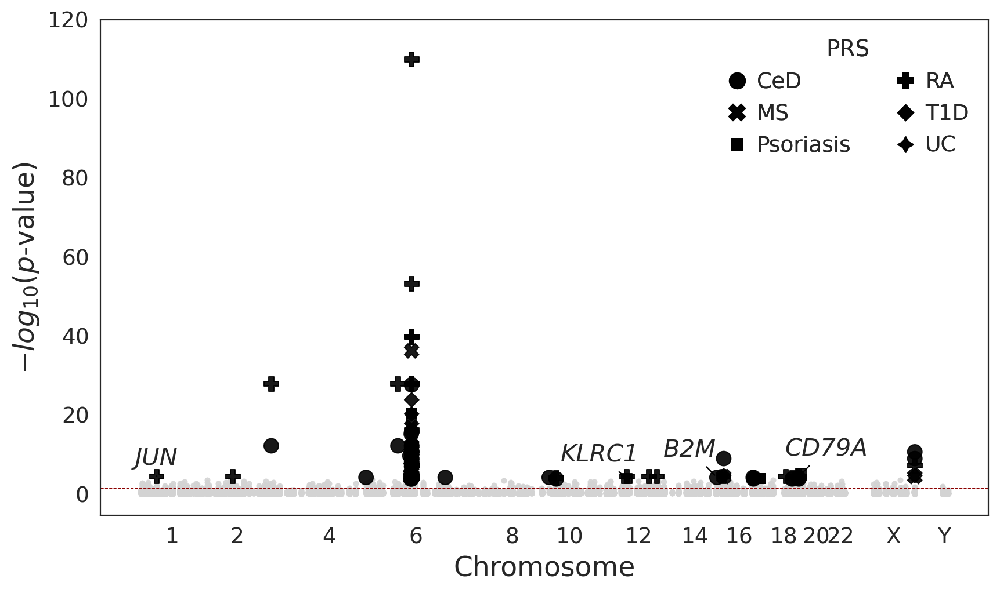

In [128]:
### Manhattan plot of the genomic locations of the identified autoimmune-involved genes

sns.set_style("white")

# disease_colors = sns.color_palette("nipy_spectral", prs_gene_ct_all_autosomic.Disease.nunique()-1)
# disease_colors.insert(0, "lightgrey")

disease_colors = dict(zip(prs_gene_ct_all_sign.PRS.unique(),
                          sns.color_palette("Set2", prs_gene_ct_all_sign.PRS.nunique())))


fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(8.5, 5), constrained_layout=True)

sns.scatterplot(data=prs_gene_ct_all.loc[prs_gene_ct_all.Disease == "None"], x="position2plot", y="m_log10_pvalue",
                color="lightgrey", alpha=0.9, edgecolor="face", s=11, ax=axs, rasterized=True)

sns.scatterplot(data=prs_gene_ct_all_sign, x="position2plot", y="m_log10_pvalue", 
                color="black", alpha=0.9, edgecolor="face", s=80,
                ax=axs, rasterized=True, style="PRS", style_order=sorted(prs_gene_ct_all_sign.PRS.unique()))


axs.set_xticks(tmp["mean_plot_position"])
axs.set_xticklabels([ch for ch in tmp["gene_chromosome"] if ch < 23]+["X", "Y"], fontsize=13.5, rotation=0)
# for xtick, color in zip(axs.get_xticklabels(), chrom_colors):
#     xtick.set_color(color)
axs.set_xlabel("Chromosome", fontsize=17)

y_ticks = np.arange(int(prs_gene_ct_all.m_log10_pvalue.min()), int(prs_gene_ct_all.m_log10_pvalue.max())+20, 20)
axs.set_yticks(y_ticks)
axs.set_yticklabels(y_ticks, fontsize=13.5)
axs.set_ylabel("$-log_{10}$($p$-value)", fontsize=17)
# BH threshold
axs.axhline(y=-np.log10(cut_off), color="darkred", linestyle="dashed", linewidth=0.5)

# axs.set_title("Genomic location of genes implicated in autoimmune diseases", loc="center", fontsize=15)

annotation_fontsize=15
# Annotate visible significant genes
for _, row in plot_df.iterrows():
    if row["gene_chromosome"] == 6: # Skip genes on chrom 6
        continue
    # Annotate only genes mentioned in the text
    if row["TopGene"] in ["KLRC1", "CD79A", "JUN", "PSMB9", "B2M"]:
        if row["TopGene"] == "KLRC1":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1e8, row["m_log10_pvalue"]+6),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
#    if row["m_log10_pvalue"] > 4: #-np.log10(cut_off): 
        elif row["TopGene"] == "RPL35":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 12),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "BTG1":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 10),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "RPLP0":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 16),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "CYBA":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 15),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "RPL13":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 21),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "YBX3":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1e7, row["m_log10_pvalue"] + 5),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "RPL18A":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]+1e7, row["m_log10_pvalue"] + 10),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "ZFP36":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 26),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "RPS19":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]+2e8, row["m_log10_pvalue"] + 16),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "SEC61B":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1e8, row["m_log10_pvalue"] + 6),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "CD79A":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]+1e8, row["m_log10_pvalue"] + 7), # (row["position2plot"]+3e8, row["m_log10_pvalue"] + 26)
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "CD37":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]+2e8, row["m_log10_pvalue"] + 4),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "CD74":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1e8, row["m_log10_pvalue"]+5),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "B2M":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1e8, row["m_log10_pvalue"]+7),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        else:
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 3),
                ha="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )

legend_shape_handles, legend_shape_labels = (axs.get_legend_handles_labels()[0],
                                             axs.get_legend_handles_labels()[1])

# # Sort labels alphabetically and reorder handles accordingly
# sorted_indices = sorted(range(len(legend_shape_labels)), key=lambda k: legend_shape_labels[k])
# legend_shape_handles = [legend_shape_handles[i] for i in sorted_indices]
# legend_shape_labels = sorted(legend_shape_labels)

legend_shape = axs.legend(title="PRS", labels=legend_shape_labels, handles = legend_shape_handles, frameon=False, 
                        loc="upper right", handlelength=1, bbox_transform=axs.transAxes, ncol=2,
                        markerscale=1.1, title_fontsize=14, fontsize=13.5)
axs.add_artist(legend_shape)

plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_shape-by-PRS_annotated-genes.png"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_shape-by-PRS_annotated-genes.eps"), 
            transparent=True, dpi=500, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


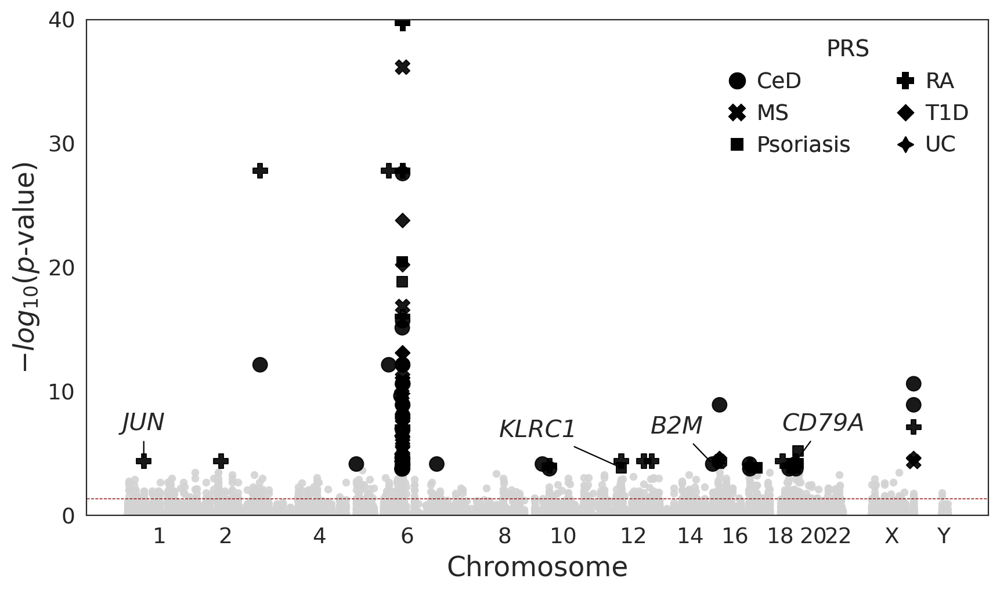

In [146]:
### Manhattan plot of the genomic locations of the identified autoimmune-involved genes

sns.set_style("white")

# disease_colors = sns.color_palette("nipy_spectral", prs_gene_ct_all_autosomic.Disease.nunique()-1)
# disease_colors.insert(0, "lightgrey")

disease_colors = dict(zip(prs_gene_ct_all_sign.PRS.unique(),
                          sns.color_palette("Set2", prs_gene_ct_all_sign.PRS.nunique())))


fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(8.5, 5), constrained_layout=True)

sns.scatterplot(data=prs_gene_ct_all.loc[prs_gene_ct_all.Disease == "None"], x="position2plot", y="m_log10_pvalue",
                color="lightgrey", alpha=0.9, edgecolor="face", s=20, ax=axs, rasterized=True)

sns.scatterplot(data=prs_gene_ct_all_sign, x="position2plot", y="m_log10_pvalue", 
                color="black", alpha=0.9, edgecolor="face", s=80,
                ax=axs, rasterized=True, style="PRS", style_order=sorted(prs_gene_ct_all_sign.PRS.unique()))


axs.set_xticks(tmp["mean_plot_position"])
axs.set_xticklabels([ch for ch in tmp["gene_chromosome"] if ch < 23]+["X", "Y"], fontsize=13.5, rotation=0)
# for xtick, color in zip(axs.get_xticklabels(), chrom_colors):
#     xtick.set_color(color)
axs.set_xlabel("Chromosome", fontsize=17)

y_ticks = np.arange(int(prs_gene_ct_all.m_log10_pvalue.min()), int(prs_gene_ct_all.m_log10_pvalue.max())+10, 10)
axs.set_yticks(y_ticks)
axs.set_yticklabels(y_ticks, fontsize=13.5)
axs.set_ylabel("$-log_{10}$($p$-value)", fontsize=17)
axs.set_ylim(int(prs_gene_ct_all.m_log10_pvalue.min()), 40)

# BH threshold
axs.axhline(y=-np.log10(cut_off), color="darkred", linestyle="dashed", linewidth=0.5)

# axs.set_title("Genomic location of genes implicated in autoimmune diseases", loc="center", fontsize=15)

annotation_fontsize=15
# Annotate visible significant genes
for _, row in plot_df.iterrows():
    if row["gene_chromosome"] == 6: # Skip genes on chrom 6
        continue
    # Annotate only genes mentioned in the text
    if row["TopGene"] in ["KLRC1", "CD79A", "JUN", "PSMB9", "B2M"]:
        if row["TopGene"] == "KLRC1":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-3e8, row["m_log10_pvalue"]+3),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
#    if row["m_log10_pvalue"] > 4: #-np.log10(cut_off): 
        elif row["TopGene"] == "RPL35":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 12),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "BTG1":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 10),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "RPLP0":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 16),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "CYBA":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 15),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "RPL13":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 21),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "YBX3":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1e7, row["m_log10_pvalue"] + 5),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "RPL18A":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]+1e7, row["m_log10_pvalue"] + 10),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "ZFP36":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 26),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "RPS19":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]+2e8, row["m_log10_pvalue"] + 16),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "SEC61B":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1e8, row["m_log10_pvalue"] + 6),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "CD79A":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]+1e8, row["m_log10_pvalue"] + 3), # (row["position2plot"]+3e8, row["m_log10_pvalue"] + 26)
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "CD37":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]+2e8, row["m_log10_pvalue"] + 4),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "CD74":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1e8, row["m_log10_pvalue"]+5),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        elif row["TopGene"] == "B2M":
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"]-1.3e8, row["m_log10_pvalue"]+3),
                ha="center",
                va="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )
        else:
            axs.annotate(
                text=row["TopGene"],
                xy=(row["position2plot"], row["m_log10_pvalue"]),
                xytext=(row["position2plot"], row["m_log10_pvalue"] + 2.5),
                ha="center",
                fontsize=annotation_fontsize,
                fontstyle="italic",
                arrowprops=dict(arrowstyle="-", color="black", lw=0.8),
            )

legend_shape_handles, legend_shape_labels = (axs.get_legend_handles_labels()[0],
                                             axs.get_legend_handles_labels()[1])

# # Sort labels alphabetically and reorder handles accordingly
# sorted_indices = sorted(range(len(legend_shape_labels)), key=lambda k: legend_shape_labels[k])
# legend_shape_handles = [legend_shape_handles[i] for i in sorted_indices]
# legend_shape_labels = sorted(legend_shape_labels)

legend_shape = axs.legend(title="PRS", labels=legend_shape_labels, handles = legend_shape_handles, frameon=False, 
                        loc="upper right", handlelength=1, bbox_transform=axs.transAxes, ncol=2,
                        markerscale=1.1, title_fontsize=14, fontsize=13.5)
axs.add_artist(legend_shape)

plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_shape-by-PRS_annotated-genes_zoom-in.png"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_shape-by-PRS_annotated-genes_zoom-in.eps"), 
            transparent=True, dpi=500, bbox_inches="tight")

In [1312]:
plot_df.loc[(plot_df.gene_chromosome == 9) & (plot_df.m_log10_pvalue > 4)].sort_values("position2plot")

,TopGene,gene_chromosome,N_diseases,position2plot,mean_plot_position,m_log10_pvalue
5969,SEC61B,9,1.0,1511826645.0,1.518742e+09,4.157885
6066,RPL35,9,2.0,1537460233.0,1.518742e+09,4.014567


In [1301]:
plot_df.loc[(plot_df.gene_chromosome == 12) & (plot_df.m_log10_pvalue > 3)].sort_values("position2plot")

,TopGene,gene_chromosome,N_diseases,position2plot,mean_plot_position,m_log10_pvalue
7948,KLRC1,12,1.0,1797096125.0,1.841105e+09,3.857243
8003,YBX3,12,1.0,1797358848.0,1.841105e+09,4.390901
7729,KRT1,12,0.0,1839566407.0,1.841105e+09,3.164740
8014,BTG1,12,1.0,1879033031.0,1.841105e+09,4.390901
8010,RPLP0,12,1.0,1907131815.0,1.841105e+09,4.390901


#### HLA locus on chrom6

In [147]:
prs_gene_ct_all_chr6 = prs_gene_ct_all.loc[prs_gene_ct_all.gene_chromosome == 6]
prs_gene_ct_all_sign_chr6 = prs_gene_ct_all_sign.loc[prs_gene_ct_all_sign.gene_chromosome == 6]
prs_gene_ct_all_sign_chr6.head()

,PRS,Factor,TopGene,celltype,fPRS,gene_chromosome,gene_start,gene_end,N_diseases,Disease,p_value,BH_corrected_pval,m_log10_BHpval,m_log10_pvalue,gene_position,position2plot,mean_plot_position
3795,MS,U_Factor293,HLA-DQA2,"[CD8 ET, B IN]",MS__U_Factor293,6,32709119.0,32714992.0,5.0,"CeD, RA, T1D, MS, UC",1.545514e-11,7.715976e-09,8.112609,10.810927,32712056,1006096380.0,1.021542e+09
3798,MS,U_Factor293,HLA-DRB5,"[CD8 ET, B IN]",MS__U_Factor293,6,32485120.0,32498064.0,6.0,"CeD, RA, Psoriasis, T1D, MS, UC",1.545514e-11,7.715976e-09,8.112609,10.810927,32491592,1005875916.0,1.021542e+09
3803,MS,U_Factor308,HLA-C,[B IN],MS__U_Factor308,6,31236526.0,31239907.0,3.0,"CeD, Psoriasis, MS",5.170602e-05,8.229363e-03,2.084634,4.286459,31238216,1004622540.0,1.021542e+09
3826,UC,U_Factor454,HLA-DQA2,"[CD8 S100B, NK, Plasma]",UC__U_Factor454,6,32709119.0,32714992.0,5.0,"CeD, RA, T1D, MS, UC",5.119169e-05,8.229363e-03,2.084634,4.290801,32712056,1006096380.0,1.021542e+09
3836,T1D,U_Factor293,HLA-DRB5,"[CD8 ET, B IN]",T1D__U_Factor293,6,32485120.0,32498064.0,6.0,"CeD, RA, Psoriasis, T1D, MS, UC",7.657922e-14,5.097623e-11,10.292632,13.115889,32491592,1005875916.0,1.021542e+09


In [148]:
HLA_genes = pd.read_csv("/data/danai/Data/HLA_genes_chrom-locations.txt", sep="\t", index_col=0)
HLA_genes.rename(columns={"Chromosome/scaffold name":"gene_chromosome", 
                          "Gene start (bp)":"gene_start", 
                          "Gene end (bp)":"gene_end",
                          "Gene name": "gene_name"},
                 inplace=True)
HLA_genes.sort_values(by="gene_start", inplace=True)
HLA_genes

,Gene description,gene_chromosome,gene_start,gene_end,gene_name
Gene stable ID,,,,,
ENSG00000206503,"major histocompatibility complex, class I, A [...",6,29909037,29913661,HLA-A
ENSG00000204525,"major histocompatibility complex, class I, C [...",6,31236526,31239907,HLA-C
ENSG00000234745,"major histocompatibility complex, class I, B [...",6,31321649,31324965,HLA-B
ENSG00000204287,"major histocompatibility complex, class II, DR...",6,32407619,32412823,HLA-DRA
ENSG00000198502,"major histocompatibility complex, class II, DR...",6,32485120,32498064,HLA-DRB5
ENSG00000196126,"major histocompatibility complex, class II, DR...",6,32546546,32557625,HLA-DRB1
ENSG00000196735,"major histocompatibility complex, class II, DQ...",6,32595956,32614839,HLA-DQA1
ENSG00000179344,"major histocompatibility complex, class II, DQ...",6,32627244,32636160,HLA-DQB1
ENSG00000237541,"major histocompatibility complex, class II, DQ...",6,32709119,32714992,HLA-DQA2


In [149]:
prs_gene_ct_all_sign_chr6 = prs_gene_ct_all_sign_chr6.loc[prs_gene_ct_all_sign_chr6.TopGene.isin(HLA_genes.gene_name)]

In [150]:
prs_gene_ct_all_sign_chr6.PRS.replace({"Multiple_sclerosis":"MS", "Celiac":"CeD"}, inplace=True)

/tmp/ipykernel_37593/762515447.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




In [151]:
gene_colors = {prs_gene_ct_all_sign_chr6.TopGene.unique()[0]:"darkblue"}

gene_colors.update(
    dict(zip(prs_gene_ct_all_sign_chr6.TopGene.unique()[1:9],
         sns.color_palette("Dark2", 8))
))

gene_colors.update(dict(
    zip(prs_gene_ct_all_sign_chr6.TopGene.unique()[9:],
        sns.color_palette("Set1", 2))
))
# gene_colors.update(dict(
#     zip(sorted(prs_gene_ct_all_sign_chr6.TopGene.unique())[10:],
#         ["darkblue"])
# ))

gene_colors

{'HLA-DQA2': 'darkblue',
 'HLA-DRB5': (0.10588235294117647, 0.6196078431372549, 0.4666666666666667),
 'HLA-C': (0.8509803921568627, 0.37254901960784315, 0.00784313725490196),
 'HLA-B': (0.4588235294117647, 0.4392156862745098, 0.7019607843137254),
 'HLA-DRB1': (0.9058823529411765, 0.1607843137254902, 0.5411764705882353),
 'HLA-DQB1': (0.4, 0.6509803921568628, 0.11764705882352941),
 'HLA-DQA1': (0.9019607843137255, 0.6705882352941176, 0.00784313725490196),
 'HLA-A': (0.6509803921568628, 0.4627450980392157, 0.11372549019607843),
 'HLA-DPA1': (0.4, 0.4, 0.4),
 'HLA-DRA': (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 'HLA-DPB1': (0.21568627450980393, 0.49411764705882355, 0.7215686274509804)}

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


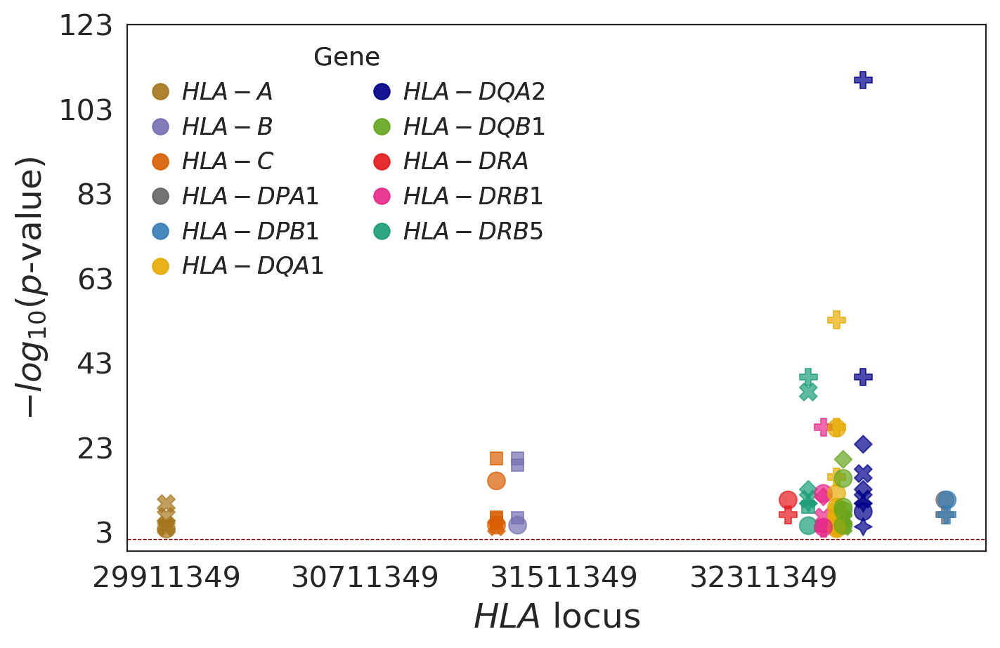

In [159]:
sns.set_style("white")

fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(7, 4.5), constrained_layout=True)

sns.scatterplot(data=prs_gene_ct_all_sign_chr6, x="gene_position", y="m_log10_pvalue", 
                hue="TopGene", palette=gene_colors, alpha=0.7, edgecolor="face", s=80,
                ax=axs, rasterized=True, style="PRS", style_order=sorted(prs_gene_ct_all_sign_chr6.PRS.unique()))


x_ticks = np.arange(int(prs_gene_ct_all_sign_chr6.gene_position.min()), int(prs_gene_ct_all_sign_chr6.gene_position.max()), 8e5, dtype=int)
axs.set_xticks(x_ticks)
axs.set_xticklabels(x_ticks, fontsize=15)
axs.set_xlabel("$HLA$ locus", fontsize=17.5)

y_ticks = np.arange(int(prs_gene_ct_all_sign_chr6.m_log10_pvalue.min()), int(prs_gene_ct_all_sign_chr6.m_log10_pvalue.max())+20, 20)
axs.set_yticks(y_ticks)
axs.set_yticklabels(y_ticks, fontsize=15)
axs.set_ylabel("$-log_{10}$($p$-value)", fontsize=17.5)
# BH threshold
axs.axhline(y=-np.log10(cut_off), color="darkred", linestyle="dashed", linewidth=0.5)


legend_hue_handles, legend_hue_labels = (axs.get_legend_handles_labels()[0][1:prs_gene_ct_all_sign_chr6.TopGene.nunique()+1],
                                         axs.get_legend_handles_labels()[1][1:prs_gene_ct_all_sign_chr6.TopGene.nunique()+1])

# Sort labels alphabetically and reorder handles accordingly
sorted_indices = sorted(range(len(legend_hue_labels)), key=lambda k: legend_hue_labels[k])
legend_hue_handles = [legend_hue_handles[i] for i in sorted_indices]
legend_hue_labels = sorted(legend_hue_labels)

legend_hue = axs.legend(title="Gene", labels=[f"${la}$" for la in legend_hue_labels], handles = legend_hue_handles, frameon=False, 
                        loc="upper left", handlelength=1, bbox_transform=axs.transAxes, ncol=2,
                        markerscale=0.9, title_fontsize=13, fontsize=12)
axs.add_artist(legend_hue)

legend_shape_handles, legend_shape_labels = (axs.get_legend_handles_labels()[0][prs_gene_ct_all_sign_chr6.TopGene.nunique()+2:],
                                         axs.get_legend_handles_labels()[1][prs_gene_ct_all_sign_chr6.TopGene.nunique()+2:])


plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_colored-by-PRS_HLA-locus_wo-PRS-legend.png"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_colored-by-PRS_HLA-locus_wo-PRS-legend.eps"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_colored-by-PRS_HLA-locus_wo-PRS-legend.pdf"), 
            transparent=True, dpi=500, bbox_inches="tight")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


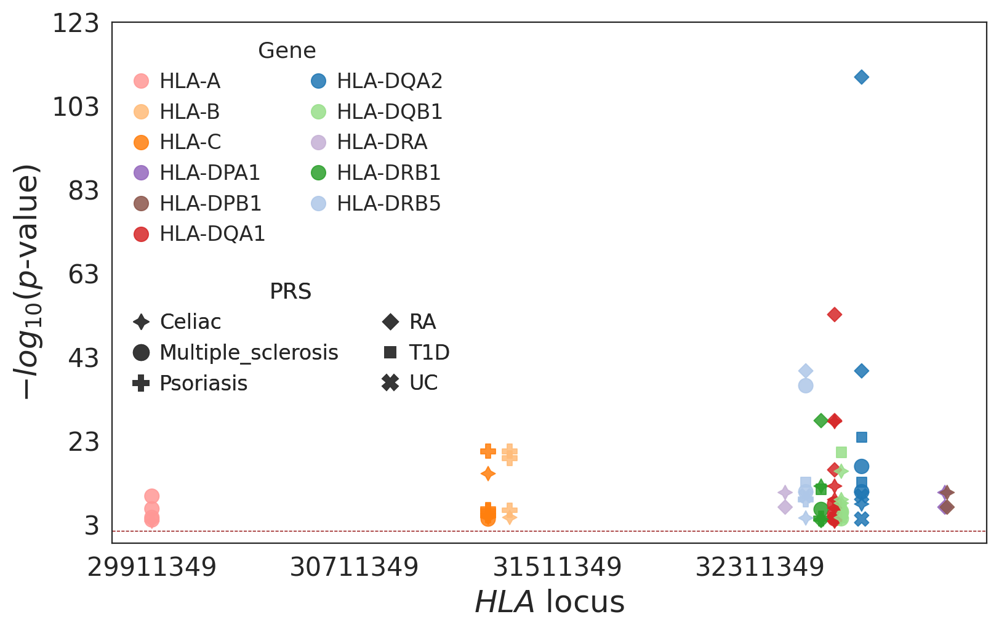

In [1154]:
sns.set_style("white")

gene_colors = dict(zip(prs_gene_ct_all_sign_chr6.TopGene.unique(),
                          sns.color_palette("tab20", prs_gene_ct_all_sign_chr6.TopGene.nunique())))


fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), constrained_layout=True)

sns.scatterplot(data=prs_gene_ct_all_sign_chr6, x="gene_position", y="m_log10_pvalue", 
                hue="TopGene", palette=gene_colors, alpha=0.85, edgecolor="face", s=70,
                ax=axs, rasterized=True, style="PRS")


x_ticks = np.arange(int(prs_gene_ct_all_sign_chr6.gene_position.min()), int(prs_gene_ct_all_sign_chr6.gene_position.max()), 8e5, dtype=int)
axs.set_xticks(x_ticks)
axs.set_xticklabels(x_ticks, fontsize=15)
axs.set_xlabel("$HLA$ locus", fontsize=18)

y_ticks = np.arange(int(prs_gene_ct_all_sign_chr6.m_log10_pvalue.min()), int(prs_gene_ct_all_sign_chr6.m_log10_pvalue.max())+20, 20)
axs.set_yticks(y_ticks)
axs.set_yticklabels(y_ticks, fontsize=15)
axs.set_ylabel("$-log_{10}$($p$-value)", fontsize=18)
# BH threshold
axs.axhline(y=-np.log10(cut_off), color="darkred", linestyle="dashed", linewidth=0.5)


legend_hue_handles, legend_hue_labels = (axs.get_legend_handles_labels()[0][1:prs_gene_ct_all_sign_chr6.TopGene.nunique()+1],
                                         axs.get_legend_handles_labels()[1][1:prs_gene_ct_all_sign_chr6.TopGene.nunique()+1])

# Sort labels alphabetically and reorder handles accordingly
sorted_indices = sorted(range(len(legend_hue_labels)), key=lambda k: legend_hue_labels[k])
legend_hue_handles = [legend_hue_handles[i] for i in sorted_indices]
legend_hue_labels = sorted(legend_hue_labels)

legend_hue = axs.legend(title="Gene", labels=legend_hue_labels, handles = legend_hue_handles, frameon=False, 
                        loc="upper left", handlelength=1, bbox_transform=axs.transAxes, ncol=2,
                        markerscale=1, title_fontsize=13, fontsize=12)
axs.add_artist(legend_hue)

legend_shape_handles, legend_shape_labels = (axs.get_legend_handles_labels()[0][prs_gene_ct_all_sign_chr6.TopGene.nunique()+2:],
                                         axs.get_legend_handles_labels()[1][prs_gene_ct_all_sign_chr6.TopGene.nunique()+2:])

# Sort labels alphabetically and reorder handles accordingly
sorted_indices = sorted(range(len(legend_shape_labels)), key=lambda k: legend_shape_labels[k])
legend_shape_handles = [legend_shape_handles[i] for i in sorted_indices]
legend_shape_labels = sorted(legend_shape_labels)

legend_shape = axs.legend(title="PRS", labels=legend_shape_labels, handles = legend_shape_handles, frameon=False, 
                        loc="lower left", handlelength=1, bbox_transform=axs.transAxes, ncol=2,
                        markerscale=1.1, title_fontsize=13, fontsize=12, bbox_to_anchor=(0, 0.25))
axs.add_artist(legend_shape)


plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_colored-by-PRS_chrom6.png"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "Manhattan-plot_TopGenes_PRS_colored-by-PRS_chrom6.eps"), 
            transparent=True, dpi=500, bbox_inches="tight")

## Count assignments of celltypes for each PRS

In [952]:
prs_ct_count = prs_gene_ct.filter(["PRS", "celltype", "Factor"]).drop_duplicates().groupby("PRS").apply(lambda x: x.celltype.value_counts(), include_groups=False).reset_index()
prs_ct_count.head()

,PRS,celltype,count
0,CeD,B IN,7
1,CeD,Mono C,5
2,CeD,Plasma,3
3,CeD,NK,3
4,CeD,CD4 ET,2


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


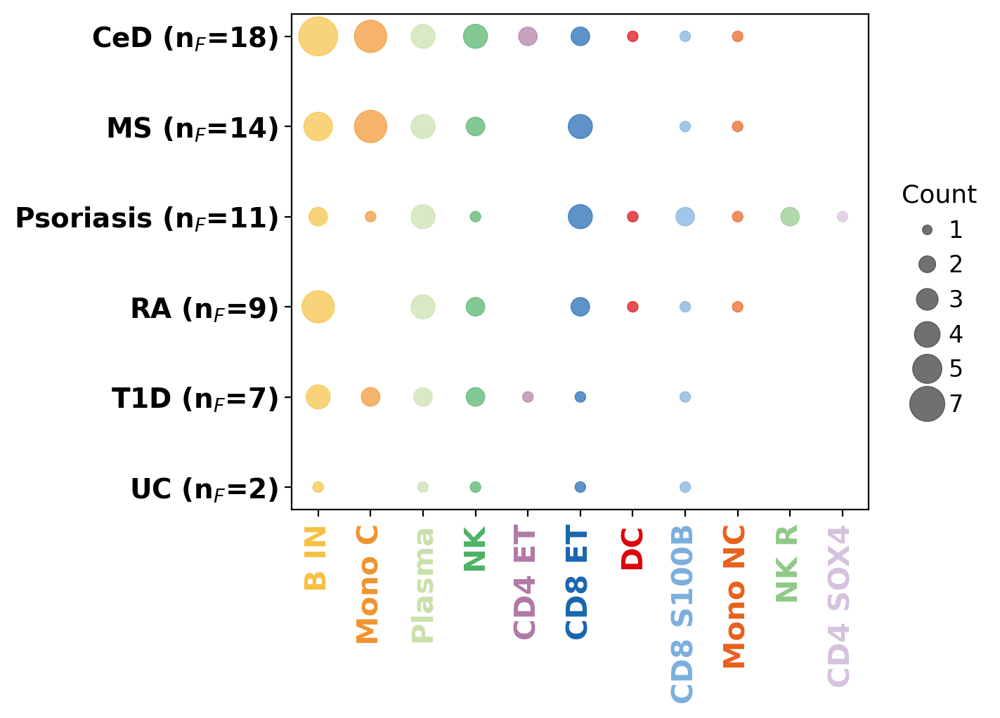

In [956]:
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(7, 5), constrained_layout=True)

sns.scatterplot(
    data=prs_ct_count,
    x="celltype",
    y="PRS",
    size="count",
    sizes=(30, 400),        # Adjust min and max dot sizes
    hue="celltype",
    palette=cell_label_colors,
    alpha=0.7,
    edgecolor="face",# "gray",
    ax=axs,
)

legend_size_handles, legend_size_labels = (axs.get_legend_handles_labels()[0][prs_ct_count.celltype.nunique()+2:],
                                           axs.get_legend_handles_labels()[1][prs_ct_count.celltype.nunique()+2:])


axs.legend(title="Count", labels=legend_size_labels, handles =legend_size_handles, frameon=False, 
            loc="upper left", handlelength=1, bbox_transform=axs.transAxes, ncol=1,
            markerscale=0.9, title_fontsize=13, fontsize=12, bbox_to_anchor=(1.02, 0.7))

ylabels = [fr"{la.get_text()} (n$_{{F}}$={n_factors_for_prs[la.get_text()]})" for la in axs.get_yticklabels()]
axs.set_yticks(axs.get_yticks(), ylabels)

axs.set_xticks(axs.get_xticks(), axs.get_xticklabels(), rotation=90, fontsize=15)
axs.set_xlabel("")
axs.set_ylabel("")

for label in axs.get_xticklabels():
    label.set_color(cell_label_colors[label.get_text()])
    label.set_fontweight("bold")

for label in axs.get_yticklabels():
    label.set_fontweight("bold")


axs.set_xticks(axs.get_xticks(), axs.get_xticklabels(), rotation=90, fontsize=15)
axs.set_xlabel("")
axs.set_ylabel("")

plt.savefig(os.path.join(model_results_dir, "Figures", "DotPlot_celltype-assignment-PRS.png"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "DotPlot_celltype-assignment-PRS.eps"), 
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "DotPlot_celltype-assignment-PRS.pdf"), 
            transparent=True, dpi=500, bbox_inches="tight")

In [ ]:
# 5 celltypes implicated in every disease: Plasma, B IN, NK, CD8 ET, CD8 S100B

In [458]:
PRS_effects.SNP_id.replace({"Celiac":"CeD", "Multiple_sclerosis":"MS"}, inplace=True)

/tmp/ipykernel_37593/935203803.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




#### Clustermaps

In [459]:
EFFECTS_CT = []
for prs in ["CeD", "MS", "Psoriasis", "RA", "T1D", "UC"]:
    EFFECT = calculate_GxC_effect(
        GxC_associations = PRS_effects,
        SNP_id = prs,
        cell_state_latent = zbase,
        A = assignment_matrix,
    )
    EFFECT = EFFECT.abs()
    EFFECT_ct = EFFECT.merge(adata.obs.cell_label, right_index=True, left_index=True)
    EFFECT_ct = EFFECT_ct.groupby("cell_label", observed=True).apply(lambda x: x.mean()).T
    EFFECT_ct = EFFECT_ct.assign(PRS = [prs]*EFFECT_ct.shape[0])
    EFFECTS_CT.append(EFFECT_ct)

EFFECTS_CT = pd.concat(EFFECTS_CT, axis=0)
EFFECTS_CT

cell_label,B IN,B Mem,CD4 ET,CD4 NC,CD4 SOX4,CD8 ET,CD8 NC,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma,PRS
GxC_Factor19,0.063436,0.061179,0.013842,0.013538,0.014441,0.012189,0.013310,0.011752,0.025009,0.009292,0.010579,0.013632,0.011748,0.068207,CeD
GxC_Factor41,0.075580,0.068608,0.016346,0.016006,0.019177,0.015009,0.017361,0.017856,0.052761,0.013954,0.008597,0.015240,0.034265,0.031374,CeD
GxC_Factor69,0.025528,0.028866,0.049731,0.045339,0.040329,0.047356,0.039915,0.042858,0.029242,0.028588,0.025046,0.071238,0.051111,0.040631,CeD
GxC_Factor72,0.018266,0.013590,0.015382,0.015031,0.017481,0.053028,0.015620,0.025638,0.033435,0.049445,0.046753,0.121239,0.075206,0.014063,CeD
GxC_Factor210,0.047421,0.043706,0.005036,0.005470,0.005326,0.004435,0.004598,0.003814,0.012408,0.004123,0.003539,0.004580,0.006228,0.018904,CeD
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GxC_Factor663,0.041145,0.041770,0.014748,0.014025,0.015399,0.013176,0.014467,0.013023,0.028298,0.021293,0.023182,0.015073,0.010752,0.074580,T1D
GxC_Factor682,0.046351,0.045285,0.014750,0.014329,0.015180,0.014952,0.013063,0.010818,0.038866,0.055290,0.048475,0.012459,0.012094,0.023104,T1D
GxC_Factor687,0.005375,0.006504,0.005302,0.005674,0.005902,0.005315,0.005220,0.004812,0.038362,0.074056,0.066836,0.006356,0.005119,0.009782,T1D
GxC_Factor293,0.084109,0.084292,0.024646,0.025210,0.024556,0.045879,0.027770,0.029868,0.058974,0.058789,0.054693,0.027665,0.025610,0.068662,UC


In [510]:
EFFECTS_CT.index = EFFECTS_CT.index.str.replace("_Factor", "")

In [511]:
factor_PRS = EFFECTS_CT.filter(["PRS"])
factor_PRS.reset_index(names="Factor", inplace=True)
factor_PRS

,Factor,PRS
0,GxC19,CeD
1,GxC41,CeD
2,GxC69,CeD
3,GxC72,CeD
4,GxC210,CeD
...,...,...
56,GxC663,T1D
57,GxC682,T1D
58,GxC687,T1D
59,GxC293,UC


In [525]:
factor_PRS.head(60).tail(10)

,Factor,PRS
50,GxC634,RA
51,GxC663,RA
52,GxC69,T1D
53,GxC293,T1D
54,GxC395,T1D
55,GxC454,T1D
56,GxC663,T1D
57,GxC682,T1D
58,GxC687,T1D
59,GxC293,UC


In [542]:
EFFECTS_CT = EFFECTS_CT.assign(prs_colors = EFFECTS_CT.apply(lambda x: PRS_colors[x["PRS"]], axis=1))
EFFECTS_CT.head()

cell_label,B IN,B Mem,CD4 ET,CD4 NC,CD4 SOX4,CD8 ET,CD8 NC,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma,PRS,prs_colors
GxC19,0.063436,0.061179,0.013842,0.013538,0.014441,0.012189,0.013310,0.011752,0.025009,0.009292,0.010579,0.013632,0.011748,0.068207,CeD,"(0.4, 0.7607843137254902, 0.6470588235294118)"
GxC41,0.075580,0.068608,0.016346,0.016006,0.019177,0.015009,0.017361,0.017856,0.052761,0.013954,0.008597,0.015240,0.034265,0.031374,CeD,"(0.4, 0.7607843137254902, 0.6470588235294118)"
GxC69,0.025528,0.028866,0.049731,0.045339,0.040329,0.047356,0.039915,0.042858,0.029242,0.028588,0.025046,0.071238,0.051111,0.040631,CeD,"(0.4, 0.7607843137254902, 0.6470588235294118)"
GxC72,0.018266,0.013590,0.015382,0.015031,0.017481,0.053028,0.015620,0.025638,0.033435,0.049445,0.046753,0.121239,0.075206,0.014063,CeD,"(0.4, 0.7607843137254902, 0.6470588235294118)"
GxC210,0.047421,0.043706,0.005036,0.005470,0.005326,0.004435,0.004598,0.003814,0.012408,0.004123,0.003539,0.004580,0.006228,0.018904,CeD,"(0.4, 0.7607843137254902, 0.6470588235294118)"


In [778]:
prs_row_colors = EFFECTS_CT.prs_colors.copy()
prs_row_colors.name = None

In [1184]:
PRS_effects = PRS_effects.assign(fPRS = PRS_effects.SNP_id + "__"+PRS_effects.Factor)

In [1187]:
prs_gene_ct = prs_gene_ct.merge(PRS_effects.filter(["fPRS", "effect_size"]), on="fPRS", how="left")
prs_gene_ct.head()

,PRS,Factor,TopGene,celltype,fPRS,effect_size
0,CeD,U_Factor19,RPL10,B IN,CeD__U_Factor19,-0.163174
1,CeD,U_Factor19,RPL10,B IN,CeD__U_Factor19,-0.163174
2,CeD,U_Factor19,HLA-DPA1,B IN,CeD__U_Factor19,-0.163174
3,CeD,U_Factor19,HLA-DPA1,B IN,CeD__U_Factor19,-0.163174
4,CeD,U_Factor19,HLA-DRA,B IN,CeD__U_Factor19,-0.163174


In [1195]:
factor_ct_matrix = pd.get_dummies(prs_gene_ct.drop(columns="TopGene").drop_duplicates()[["Factor", "celltype"]].set_index("Factor"), prefix="", prefix_sep="").astype(int)
factor_ct_matrix

,B IN,CD4 ET,CD4 SOX4,CD8 ET,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma
Factor,,,,,,,,,,,
U_Factor19,1,0,0,0,0,0,0,0,0,0,0
U_Factor19,0,0,0,0,0,0,0,0,0,0,1
U_Factor41,0,0,0,0,0,1,0,0,0,0,0
U_Factor41,1,0,0,0,0,0,0,0,0,0,0
U_Factor69,0,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
U_Factor293,0,0,0,1,0,0,0,0,0,0,0
U_Factor293,1,0,0,0,0,0,0,0,0,0,0
U_Factor454,0,0,0,0,1,0,0,0,0,0,0


In [1196]:
## If a factor is not assigned to any celltype, calculate the effect on all cells
mask = factor_ct_matrix.eq(0).all(axis=1)
factor_ct_matrix.loc[mask] = 1

In [1197]:
factor_ct_effect = factor_ct_matrix.to_numpy()*prs_gene_ct.drop(columns="TopGene").drop_duplicates().effect_size.to_numpy().reshape(-1,1)
factor_ct_effect = pd.DataFrame(factor_ct_effect, index=factor_ct_matrix.index, columns=factor_ct_matrix.columns)
factor_ct_effect

,B IN,CD4 ET,CD4 SOX4,CD8 ET,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma
Factor,,,,,,,,,,,
U_Factor19,-0.163174,-0.000000,-0.0,-0.000000,-0.00000,-0.000000,-0.0,-0.0,-0.00000,-0.0,-0.000000
U_Factor19,-0.000000,-0.000000,-0.0,-0.000000,-0.00000,-0.000000,-0.0,-0.0,-0.00000,-0.0,-0.163174
U_Factor41,0.000000,0.000000,0.0,0.000000,0.00000,0.190772,0.0,0.0,0.00000,0.0,0.000000
U_Factor41,0.190772,0.000000,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.00000,0.0,0.000000
U_Factor69,-0.000000,-0.165184,-0.0,-0.000000,-0.00000,-0.000000,-0.0,-0.0,-0.00000,-0.0,-0.000000
...,...,...,...,...,...,...,...,...,...,...,...
U_Factor293,-0.000000,-0.000000,-0.0,-0.208053,-0.00000,-0.000000,-0.0,-0.0,-0.00000,-0.0,-0.000000
U_Factor293,-0.208053,-0.000000,-0.0,-0.000000,-0.00000,-0.000000,-0.0,-0.0,-0.00000,-0.0,-0.000000
U_Factor454,0.000000,0.000000,0.0,0.000000,0.08876,0.000000,0.0,0.0,0.00000,0.0,0.000000


In [1198]:
# Plot absolute effect size
factor_ct_effect = factor_ct_effect.abs()
factor_ct_effect = factor_ct_effect.replace(0.0,1e-8)

In [1199]:
factor_ct_effect.index = factor_ct_effect.index.str.replace("U_Factor", "GxC")

In [1200]:
factor_ct_effect = factor_ct_effect.drop_duplicates()
factor_ct_effect

,B IN,CD4 ET,CD4 SOX4,CD8 ET,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma
Factor,,,,,,,,,,,
GxC19,1.631743e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
GxC19,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.631743e-01
GxC41,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.907722e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
GxC41,1.907722e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
GxC69,1.000000e-08,1.651844e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
...,...,...,...,...,...,...,...,...,...,...,...
GxC293,1.000000e-08,1.000000e-08,1.000000e-08,2.080531e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
GxC293,2.080531e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
GxC454,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,8.876032e-02,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08


In [1201]:
# If a preannotated celltype is not in the df, add it as 0 (for visualization pursposes)
for ct in adata.obs.cell_label.unique():
    if ct not in factor_ct_effect.columns:
        factor_ct_effect = pd.concat(
            [factor_ct_effect, pd.Series([1e-8]*factor_ct_effect.shape[0], index=factor_ct_effect.index, name=ct)],
            axis=1
        )

factor_ct_effect.head()

,B IN,CD4 ET,CD4 SOX4,CD8 ET,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma,CD4 NC,CD8 NC,B Mem
Factor,,,,,,,,,,,,,,
GxC19,1.631743e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
GxC19,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.631743e-01,1.000000e-08,1.000000e-08,1.000000e-08
GxC41,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.907722e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
GxC41,1.907722e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
GxC69,1.000000e-08,1.651844e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08


In [1202]:
prs_row_colors = prs_gene_ct.filter(["Factor", "PRS", "celltype"])
prs_row_colors.Factor = prs_gene_ct.Factor.str.replace("U_Factor", "GxC")
prs_row_colors = prs_row_colors.assign(prs_colors = prs_row_colors.apply(lambda x: PRS_colors_dark[x["PRS"]], axis=1))
prs_row_colors

,Factor,PRS,celltype,prs_colors
0,GxC19,CeD,B IN,"(0.12156862745098039, 0.4666666666666667, 0.70..."
1,GxC19,CeD,B IN,"(0.12156862745098039, 0.4666666666666667, 0.70..."
2,GxC19,CeD,B IN,"(0.12156862745098039, 0.4666666666666667, 0.70..."
3,GxC19,CeD,B IN,"(0.12156862745098039, 0.4666666666666667, 0.70..."
4,GxC19,CeD,B IN,"(0.12156862745098039, 0.4666666666666667, 0.70..."
...,...,...,...,...
284,GxC454,UC,NK,"(0.5490196078431373, 0.33725490196078434, 0.29..."
285,GxC454,UC,NK,"(0.5490196078431373, 0.33725490196078434, 0.29..."
286,GxC454,UC,Plasma,"(0.5490196078431373, 0.33725490196078434, 0.29..."
287,GxC454,UC,Plasma,"(0.5490196078431373, 0.33725490196078434, 0.29..."


In [1203]:
prs_row_colors = prs_row_colors.drop_duplicates()
prs_row_colors

,Factor,PRS,celltype,prs_colors
0,GxC19,CeD,B IN,"(0.12156862745098039, 0.4666666666666667, 0.70..."
8,GxC19,CeD,Plasma,"(0.12156862745098039, 0.4666666666666667, 0.70..."
16,GxC41,CeD,DC,"(0.12156862745098039, 0.4666666666666667, 0.70..."
24,GxC41,CeD,B IN,"(0.12156862745098039, 0.4666666666666667, 0.70..."
32,GxC69,CeD,CD4 ET,"(0.12156862745098039, 0.4666666666666667, 0.70..."
...,...,...,...,...
272,GxC293,UC,CD8 ET,"(0.5490196078431373, 0.33725490196078434, 0.29..."
276,GxC293,UC,B IN,"(0.5490196078431373, 0.33725490196078434, 0.29..."
280,GxC454,UC,CD8 S100B,"(0.5490196078431373, 0.33725490196078434, 0.29..."
283,GxC454,UC,NK,"(0.5490196078431373, 0.33725490196078434, 0.29..."


In [1304]:
test = prs_gene_ct.copy()
test.PRS = pd.Categorical(test.PRS, categories=["RA", "MS", "CeD", "T1D", "Psoriasis", "UC"], ordered=True)

In [1305]:
## For each disease and celltpe consider only the factor with the largest effect size, to be able to visualize easier
largest_effect_size = test.groupby(["PRS", "celltype"], observed=True).apply(lambda x: x.effect_size.abs().nlargest(1))
largest_effect_size

/tmp/ipykernel_166209/1511305077.py:2: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


PRS        celltype      
RA         B IN       124    0.429920
           CD8 ET     120    0.429920
           CD8 S100B  128    0.448254
           DC         98     0.273531
           Mono NC    139    0.202352
           NK         131    0.448254
           Plasma     134    0.448254
MS         B IN       233    0.226843
           CD8 ET     229    0.226843
           CD8 S100B  249    0.191361
           Mono C     238    0.327459
           Mono NC    260    0.140800
           NK         252    0.191361
           Plasma     255    0.191361
CeD        B IN       42     0.334436
           CD4 ET     32     0.165184
           CD8 ET     67     0.161770
           CD8 S100B  47     0.134923
           DC         16     0.190772
           Mono C     78     0.261583
           Mono NC    58     0.137337
           NK         36     0.337784
           Plasma     8      0.163174
T1D        B IN       204    0.250065
           CD4 ET     196    0.178301
           CD8 ET     20

In [1306]:
largest_effect_size = largest_effect_size.reset_index()
largest_effect_size.head()

,PRS,celltype,level_2,effect_size
0,RA,B IN,124,0.429920
1,RA,CD8 ET,120,0.429920
2,RA,CD8 S100B,128,0.448254
3,RA,DC,98,0.273531
4,RA,Mono NC,139,0.202352


In [1307]:
disease_ct_matrix = pd.get_dummies(largest_effect_size[["PRS", "celltype"]].set_index("PRS"), prefix="", prefix_sep="").astype(int)
disease_ct_matrix

,B IN,CD4 ET,CD4 SOX4,CD8 ET,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma
PRS,,,,,,,,,,,
RA,1,0,0,0,0,0,0,0,0,0,0
RA,0,0,0,1,0,0,0,0,0,0,0
RA,0,0,0,0,1,0,0,0,0,0,0
RA,0,0,0,0,0,1,0,0,0,0,0
RA,0,0,0,0,0,0,0,1,0,0,0
RA,0,0,0,0,0,0,0,0,1,0,0
RA,0,0,0,0,0,0,0,0,0,0,1
MS,1,0,0,0,0,0,0,0,0,0,0
MS,0,0,0,1,0,0,0,0,0,0,0


In [1308]:
disease_ct_matrix.shape

(45, 11)

In [1309]:
disease_ct_effect = disease_ct_matrix.to_numpy()*largest_effect_size.effect_size.to_numpy().reshape(-1,1)
disease_ct_effect = pd.DataFrame(disease_ct_effect, index=disease_ct_matrix.index, columns=disease_ct_matrix.columns)
disease_ct_effect

,B IN,CD4 ET,CD4 SOX4,CD8 ET,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma
PRS,,,,,,,,,,,
RA,0.429920,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.429920,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.448254,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.273531,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.202352,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.448254,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.448254
MS,0.226843,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
MS,0.000000,0.000000,0.000000,0.226843,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [1310]:
# Replace zeros with pseudocount for numerical stability when doing the clustermap
disease_ct_effect = disease_ct_effect.replace(0.0,1e-8)

In [1311]:
# If a preannotated celltype is not in the df, add it as 0 (for visualization pursposes)
for ct in adata.obs.cell_label.unique():
    if ct not in disease_ct_effect.columns:
        disease_ct_effect  = pd.concat(
            [disease_ct_effect, pd.Series([1e-8]*disease_ct_effect.shape[0], index=disease_ct_effect.index, name=ct)],
            axis=1
        )

disease_ct_effect.head()

,B IN,CD4 ET,CD4 SOX4,CD8 ET,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma,CD4 NC,CD8 NC,B Mem
PRS,,,,,,,,,,,,,,
RA,4.299200e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
RA,1.000000e-08,1.000000e-08,1.000000e-08,4.299200e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
RA,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,4.482541e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
RA,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,2.735313e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
RA,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,2.023515e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08


In [1341]:
prs_row_colors = prs_gene_ct.loc[largest_effect_size["level_2"]].filter(["Factor", "PRS", "celltype"])
prs_row_colors.Factor = prs_row_colors.Factor.str.replace("U_Factor", "GxC")
prs_row_colors = prs_row_colors.assign(prs_colors = prs_row_colors.apply(lambda x: PRS_colors_dark[x["PRS"]], axis=1))
prs_row_colors

,Factor,PRS,celltype,prs_colors
124,GxC293,RA,B IN,darkred
120,GxC293,RA,CD8 ET,darkred
128,GxC454,RA,CD8 S100B,darkred
98,GxC41,RA,DC,darkred
139,GxC484,RA,Mono NC,darkred
131,GxC454,RA,NK,darkred
134,GxC454,RA,Plasma,darkred
233,GxC293,MS,B IN,royalblue
229,GxC293,MS,CD8 ET,royalblue
249,GxC454,MS,CD8 S100B,royalblue


In [2048]:
factors_topgenes = prs_gene_ct.groupby("Factor").apply(lambda x: x.TopGene.unique().tolist())
factors_topgenes

/tmp/ipykernel_166209/3184077741.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


Factor
U_Factor126                                              [HLA-B]
U_Factor144                                              [HLA-B]
U_Factor147                                              [HLA-A]
U_Factor19                  [RPL10, HLA-DPA1, HLA-DRA, HLA-DPB1]
U_Factor210              [RPL13, RPL18A, RPS19, HLA-DQA1, RPL35]
U_Factor293                                 [HLA-DQA2, HLA-DRB5]
U_Factor308                                              [HLA-C]
U_Factor314                                               [AIF1]
U_Factor325                                           [HLA-DRB5]
U_Factor36                                            [HLA-DRB5]
U_Factor376                                        [CD37, HLA-C]
U_Factor377                                              [PSMB9]
U_Factor385                                      [HLA-A, MT-ND4]
U_Factor388                                              [HLA-C]
U_Factor395                                           [HLA-DQB1]
U_Factor41        

In [2049]:
factors_topgenes.index = factors_topgenes.index.str.replace("U_Factor", "GxC")

In [2050]:
factors_topgenes = factors_topgenes.rename("gene_list").to_frame().assign(gene_str = factors_topgenes.apply(lambda x: ";".join(x)))
factors_topgenes.head()

,gene_list,gene_str
Factor,,
GxC126,[HLA-B],HLA-B
GxC144,[HLA-B],HLA-B
GxC147,[HLA-A],HLA-A
GxC19,"[RPL10, HLA-DPA1, HLA-DRA, HLA-DPB1]",RPL10;HLA-DPA1;HLA-DRA;HLA-DPB1
GxC210,"[RPL13, RPL18A, RPS19, HLA-DQA1, RPL35]",RPL13;RPL18A;RPS19;HLA-DQA1;RPL35


In [2051]:
factors_topgenes.shape

(32, 2)

In [1346]:
prs_row_colors.shape

(45, 4)

In [1347]:
prs_row_colors = prs_row_colors.merge(factors_topgenes.reset_index(), on="Factor", how="left")
prs_row_colors.shape

(45, 6)

In [1482]:
prs_row_colors.head()

,Factor,PRS,celltype,prs_colors,gene_list,gene_str
0,GxC293,RA,B IN,darkred,"[HLA-DQA2, HLA-DRB5]",HLA-DQA2;HLA-DRB5
1,GxC293,RA,CD8 ET,darkred,"[HLA-DQA2, HLA-DRB5]",HLA-DQA2;HLA-DRB5
2,GxC454,RA,CD8 S100B,darkred,[HLA-DQA2],HLA-DQA2
3,GxC41,RA,DC,darkred,"[HLA-DRB1, HLA-DQA1, CD74, RPL14]",HLA-DRB1;HLA-DQA1;CD74;RPL14
4,GxC484,RA,Mono NC,darkred,[HLA-DQA1],HLA-DQA1


In [1505]:
gene_effects = []

for _, row in prs_row_colors.iterrows():
    effect_on_genes = calculate_GxC_gene_effect(
        GxC_associations = PRS_effects.drop(columns="Celltype").drop_duplicates(),
        SNP_id = row["PRS"],
        cell_state_latent = zbase,
        A = assignment_matrix,
        GxC_decoder = GxC_decoder.loc[GxC_decoder[row["Factor"].replace("GxC", "GxC_Factor")].abs().nlargest(len(row["gene_list"])).index],
        factor_id = row["Factor"].replace("GxC", "U_Factor")
    )
    effect_on_genes = effect_on_genes.merge(adata.obs.cell_label, right_index=True, left_index=True)
    effect_on_genes_ct = effect_on_genes.groupby("cell_label", observed=True).apply(
        lambda x: x.mean(), include_groups=False)
    effect_on_genes_ct.rename(columns=adata.var.GeneSymbol.to_dict(), inplace=True)

    gene_effects.append(effect_on_genes_ct.loc[row["celltype"]])
    

In [1506]:
gene_effects[:5]

[HLA-DQA2    0.153014
 HLA-DRB5    0.058113
 Name: B IN, dtype: float64,
 HLA-DQA2    0.083465
 HLA-DRB5    0.031699
 Name: CD8 ET, dtype: float64,
 HLA-DQA2    0.081188
 Name: CD8 S100B, dtype: float64,
 HLA-DQA1   -0.009094
 HLA-DRB1   -0.006212
 RPL14      -0.002790
 CD74       -0.002471
 Name: DC, dtype: float64,
 HLA-DQA1    0.015534
 Name: Mono NC, dtype: float64]

In [1518]:
prs_row_colors.iloc[37]["effect_on_genes"]

array([ 0.00390267,  0.00215848, -0.00197265,  0.00195998, -0.00176602])

In [1511]:
prs_row_colors = prs_row_colors.assign(effect_on_genes = [ef.values for ef in gene_effects])
prs_row_colors

,Factor,PRS,celltype,prs_colors,gene_list,gene_str,effect_on_genes
0,GxC293,RA,B IN,darkred,"[HLA-DQA2, HLA-DRB5]",HLA-DQA2;HLA-DRB5,"[0.15301423075093037, 0.05811251844457916]"
1,GxC293,RA,CD8 ET,darkred,"[HLA-DQA2, HLA-DRB5]",HLA-DQA2;HLA-DRB5,"[0.08346501169139574, 0.03169876427564735]"
2,GxC454,RA,CD8 S100B,darkred,[HLA-DQA2],HLA-DQA2,[0.08118843109186279]
3,GxC41,RA,DC,darkred,"[HLA-DRB1, HLA-DQA1, CD74, RPL14]",HLA-DRB1;HLA-DQA1;CD74;RPL14,"[-0.00909364189771992, -0.0062116056581871726,..."
4,GxC484,RA,Mono NC,darkred,[HLA-DQA1],HLA-DQA1,[0.015534280437245473]
5,GxC454,RA,NK,darkred,[HLA-DQA2],HLA-DQA2,[0.1647096987823157]
6,GxC454,RA,Plasma,darkred,[HLA-DQA2],HLA-DQA2,[0.12373081747990694]
7,GxC293,MS,B IN,royalblue,"[HLA-DQA2, HLA-DRB5]",HLA-DQA2;HLA-DRB5,"[-0.08073646135851531, -0.030662501630216808]"
8,GxC293,MS,CD8 ET,royalblue,"[HLA-DQA2, HLA-DRB5]",HLA-DQA2;HLA-DRB5,"[-0.044039496575840074, -0.016725542745232056]"
9,GxC454,MS,CD8 S100B,royalblue,[HLA-DQA2],HLA-DQA2,[-0.03465952105402113]


In [1330]:
# # If a factor has more than one ernichments keep the one that corresponds to the most genes
# GOBio_gsea = GOBio_gsea.assign(Gene_list = GOBio_gsea.Genes.str.split(";"))

# GOBio_gsea = GOBio_gsea.assign(Gene_list_length = GOBio_gsea.apply(lambda x: len(x.Gene_list), axis=1))

# idx = GOBio_gsea.groupby("Factor", observed=True).apply(
#     lambda x: x.Gene_list_length ==  max(x.Gene_list_length), include_groups=False
# )
# idx

In [1331]:
# idx = idx[idx].index.get_level_values(1)

In [1332]:
# GOBio_gsea = GOBio_gsea.loc[idx]
# GOBio_gsea.shape

In [1333]:
# GOBio_gsea_gathered = GOBio_gsea.groupby("Factor", observed=True).apply(
#     lambda x: ";".join(x.Term), include_groups=False).rename("Terms").to_frame()

# GOBio_gsea_gathered 

In [1348]:
disease_ct_effect.shape

(45, 14)

In [1349]:
disease_ct_effect.index = prs_row_colors.gene_str
disease_ct_effect

,B IN,CD4 ET,CD4 SOX4,CD8 ET,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma,CD4 NC,CD8 NC,B Mem
gene_str,,,,,,,,,,,,,,
HLA-DQA2;HLA-DRB5,4.299200e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
HLA-DQA2;HLA-DRB5,1.000000e-08,1.000000e-08,1.000000e-08,4.299200e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
HLA-DQA2,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,4.482541e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
HLA-DRB1;HLA-DQA1;CD74;RPL14,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,2.735313e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
HLA-DQA1,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,2.023515e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
HLA-DQA2,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,4.482541e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
HLA-DQA2,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,4.482541e-01,1.000000e-08,1.000000e-08,1.000000e-08
HLA-DQA2;HLA-DRB5,2.268431e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
HLA-DQA2;HLA-DRB5,1.000000e-08,1.000000e-08,1.000000e-08,2.268431e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08


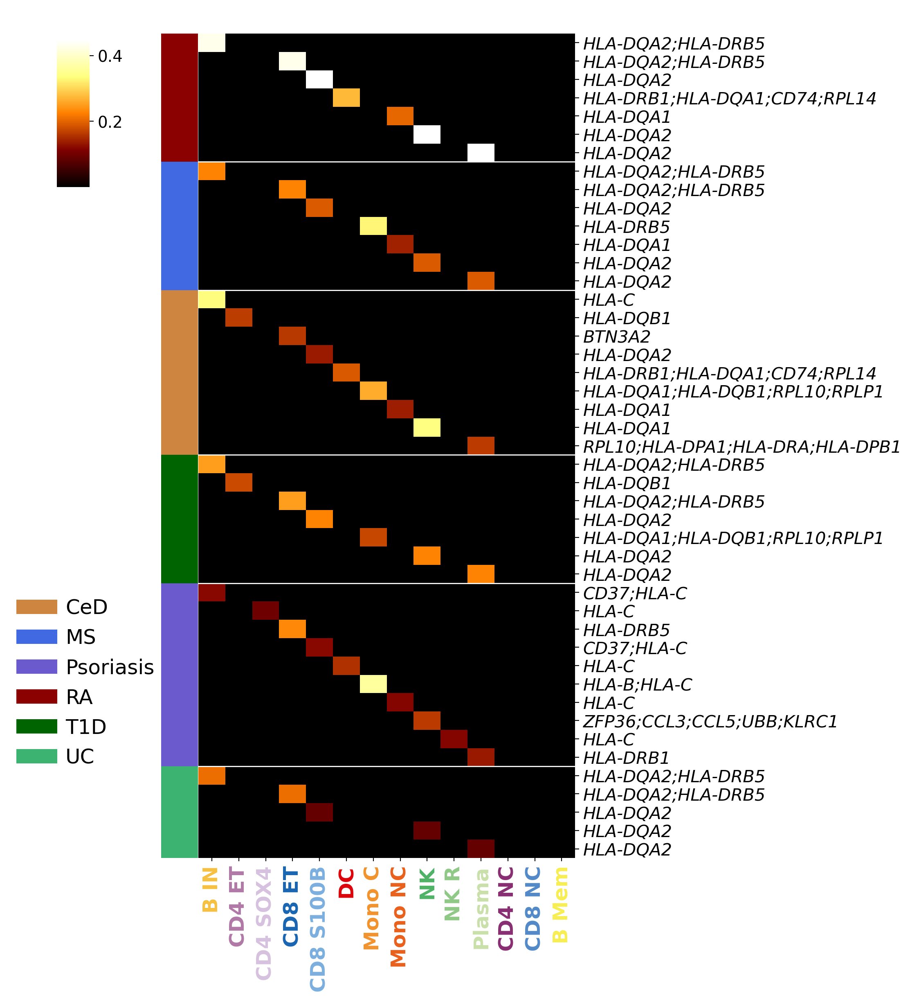

In [1350]:
# fig, axs = plt.subplots(figsize=(10,25))

clm = sns.clustermap(
    disease_ct_effect, 
    figsize=(10,12),
    metric="cosine",
    col_cluster=False,
    row_cluster=False,
    dendrogram_ratio=(0.1, 0.03),
    colors_ratio=0.08,
    row_colors=prs_row_colors.prs_colors.tolist(),
    cmap="afmhot", 
    cbar_pos=(-0.05, 0.8, 0.04, 0.15),
    yticklabels=True,
    rasterized=True
)

clm.ax_heatmap.set_xlabel("")
clm.ax_heatmap.tick_params(axis="x", length=3)
for label in clm.ax_heatmap.get_xticklabels():
    label.set_color(cell_label_colors[label.get_text()])
    label.set_fontweight("bold")
    label.set_fontsize(18)

clm.ax_heatmap.set_ylabel("")
for label in clm.ax_heatmap.get_yticklabels():
    label.set_fontsize(15)
    label.set_fontstyle("italic")

## Add some space between the different diseases for clarity
# Find boundaries of each disease
row_colors = np.array(prs_row_colors.prs_colors.tolist())
boundaries = np.where(row_colors[1:] != row_colors[:-1])[0]
for b in boundaries:
    clm.ax_heatmap.axhline(b + 1, color="white", linewidth=1)

legend_elements = [
    Patch(facecolor=pcolor, label=pname)
    for pname, pcolor in PRS_colors_dark.items()
]

clm.ax_heatmap.set_xlabel("")
clm.ax_heatmap.legend(
    handles=legend_elements,
    title="",
    bbox_to_anchor=(-0.3, 0.1),
    loc="lower center",
    frameon=False,
    borderaxespad=0.,
    handlelength=2,
    fontsize=18,
    ncols=1
)


plt.savefig(os.path.join(model_results_dir, "Figures", "Clustermap_PRS_Celltype_TopGenes_dark-colors.pdf"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "Clustermap_PRS_Celltype_TopGenes_dark-colors.png"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "Clustermap_PRS_Celltype_TopGenes_dark-colors.eps"), 
            bbox_inches="tight", transparent=True, dpi=600)


#### Compare with single-gene testing

In [987]:
prs_single_gene.PRS = prs_single_gene.PRS.replace({"Celiac":"CeD", "Multiple_sclerosis":"MS"})

In [1390]:
test = prs_single_gene.loc[prs_single_gene.PRS.isin(["RA", "T1D", "MS", "Psoriasis", "CeD", "UC"])]
test.PRS = pd.Categorical(test.PRS, categories=["RA", "MS", "CeD", "T1D", "Psoriasis", "UC"], ordered=True)
test

/tmp/ipykernel_166209/2139152026.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,GeneSymbol
0,RA,ENSG00000237541,9.695533e-10,0.538064,0.087115,CD4-ET,8.555179e-05,8.998489e-05,HLA-DQA2
1,Psoriasis,ENSG00000234745,2.132736e-27,0.255924,0.022870,CD4-ET,5.645674e-22,5.938220e-22,HLA-B
2,Psoriasis,ENSG00000204525,4.412200e-07,0.110659,0.021759,CD4-ET,2.919939e-02,3.071244e-02,HLA-C
3,MS,ENSG00000206503,2.467520e-15,-0.145157,0.018034,CD4-ET,3.265948e-10,3.435182e-10,HLA-A
5,CeD,ENSG00000213722,1.940422e-08,0.177370,0.031307,NK,5.958800e-04,6.003063e-04,DDAH2
...,...,...,...,...,...,...,...,...,...
125,CeD,ENSG00000204525,6.757866e-07,-0.155808,0.031098,Plasma,4.704015e-02,4.704015e-02,HLA-C
126,RA,ENSG00000237541,4.624954e-37,1.301009,0.096895,Plasma,1.287735e-31,1.287735e-31,HLA-DQA2
127,Psoriasis,ENSG00000234745,9.135416e-09,0.164065,0.028236,Plasma,8.478641e-04,8.478641e-04,HLA-B
128,T1D,ENSG00000237541,1.073929e-16,0.861978,0.101536,Plasma,1.495080e-11,1.495080e-11,HLA-DQA2


In [2036]:
test.GeneSymbol.unique()

array(['HLA-DQA2', 'HLA-B', 'HLA-C', 'HLA-A', 'DDAH2', 'HLA-DQA1', 'MICB',
       'HLA-DQB1', 'HLA-DRB1', 'EMC10', 'GIPR', 'TTC22', 'KLC2',
       'HLA-DRB5', 'KREMEN1', 'MEMO1', 'MASP2'], dtype=object)

In [1526]:
test.loc[test.PRS == "UC"].filter(["PRS", "effect_size", "celltype", "GeneSymbol"])

,PRS,effect_size,celltype,GeneSymbol
41,UC,-0.156409,CD8-ET,HLA-DQA1
42,UC,-0.347671,CD8-ET,HLA-DQA2
61,UC,-0.315082,B-IN,MEMO1


In [1391]:
largest_es_sg = test.groupby(["PRS", "celltype"], observed=True).apply(lambda x: x.effect_size.abs().nlargest(1)).reset_index()
largest_es_sg

/tmp/ipykernel_166209/4085171533.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


,PRS,celltype,level_2,effect_size
0,RA,B-IN,51,0.364210
1,RA,B-Mem,75,0.364274
2,RA,CD4-ET,0,0.538064
3,RA,CD4-NC,16,0.852936
4,RA,CD8-ET,35,0.895102
5,RA,CD8-NC,67,1.020135
6,RA,CD8-S100B,24,0.845940
7,RA,DC,118,0.648549
8,RA,Mono-C,106,1.107074
9,RA,Mono-NC,95,1.213319


In [1392]:
disease_ct_matrix_sg = pd.get_dummies(largest_es_sg[["PRS", "celltype"]].set_index("PRS"), prefix="", prefix_sep="").astype(int)
disease_ct_matrix_sg

,B-IN,B-Mem,CD4-ET,CD4-NC,CD4-SOX4,CD8-ET,CD8-NC,CD8-S100B,DC,Mono-C,Mono-NC,NK,NK-R,Plasma
PRS,,,,,,,,,,,,,,
RA,1,0,0,0,0,0,0,0,0,0,0,0,0,0
RA,0,1,0,0,0,0,0,0,0,0,0,0,0,0
RA,0,0,1,0,0,0,0,0,0,0,0,0,0,0
RA,0,0,0,1,0,0,0,0,0,0,0,0,0,0
RA,0,0,0,0,0,1,0,0,0,0,0,0,0,0
RA,0,0,0,0,0,0,1,0,0,0,0,0,0,0
RA,0,0,0,0,0,0,0,1,0,0,0,0,0,0
RA,0,0,0,0,0,0,0,0,1,0,0,0,0,0
RA,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [1393]:
disease_ct_effect_sg = disease_ct_matrix_sg.to_numpy()*largest_es_sg.effect_size.to_numpy().reshape(-1,1)
disease_ct_effect_sg = pd.DataFrame(disease_ct_effect_sg, index=disease_ct_matrix_sg.index, columns=disease_ct_matrix_sg.columns)
disease_ct_effect_sg

,B-IN,B-Mem,CD4-ET,CD4-NC,CD4-SOX4,CD8-ET,CD8-NC,CD8-S100B,DC,Mono-C,Mono-NC,NK,NK-R,Plasma
PRS,,,,,,,,,,,,,,
RA,0.364210,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.364274,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.538064,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.852936,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.895102,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.020135,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.845940,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.648549,0.000000,0.000000,0.000000,0.000000,0.000000
RA,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.107074,0.000000,0.000000,0.000000,0.000000


In [1394]:
# Replace zeros with pseudocount for numerical stability when doing the clustermap
disease_ct_effect_sg = disease_ct_effect_sg.replace(0.0,1e-8)

In [1395]:
# If a preannotated celltype is not in the df, add it as 0 (for visualization pursposes)

disease_ct_effect_sg.columns = disease_ct_effect_sg.columns.str.replace("-", " ")

for ct in adata.obs.cell_label.unique():
    if ct not in disease_ct_effect_sg.columns:
        disease_ct_effect_sg  = pd.concat(
            [disease_ct_effect_sg, pd.Series([1e-8]*disease_ct_effect_sg.shape[0], index=disease_ct_effect_sg.index, name=ct)],
            axis=1
        )

disease_ct_effect_sg.head()

,B IN,B Mem,CD4 ET,CD4 NC,CD4 SOX4,CD8 ET,CD8 NC,CD8 S100B,DC,Mono C,Mono NC,NK,NK R,Plasma
PRS,,,,,,,,,,,,,,
RA,3.642104e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
RA,1.000000e-08,3.642738e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
RA,1.000000e-08,1.000000e-08,5.380642e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
RA,1.000000e-08,1.000000e-08,1.000000e-08,8.529365e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08
RA,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,8.951020e-01,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08,1.000000e-08


In [1396]:
disease_ct_gene = test.loc[largest_es_sg.level_2].filter(["PRS", "celltype", "GeneSymbol"])
disease_ct_gene= disease_ct_gene.assign(prs_colors = disease_ct_gene.apply(lambda x: PRS_colors_dark[x["PRS"]], axis=1))
disease_ct_gene

,PRS,celltype,GeneSymbol,prs_colors
51,RA,B-IN,HLA-DQA2,darkred
75,RA,B-Mem,HLA-DQA2,darkred
0,RA,CD4-ET,HLA-DQA2,darkred
16,RA,CD4-NC,HLA-DQA2,darkred
35,RA,CD8-ET,HLA-DQA2,darkred
67,RA,CD8-NC,HLA-DQA2,darkred
24,RA,CD8-S100B,HLA-DQA2,darkred
118,RA,DC,HLA-DQA2,darkred
106,RA,Mono-C,HLA-DQA2,darkred
95,RA,Mono-NC,HLA-DQA2,darkred


In [1397]:
disease_ct_effect_sg.shape[0] == disease_ct_gene.shape[0]

True

In [1398]:
disease_ct_effect_sg.index = disease_ct_gene.GeneSymbol

In [1403]:
disease_ct_gene.PRS.cat.categories

Index(['RA', 'MS', 'CeD', 'T1D', 'Psoriasis', 'UC'], dtype='object')

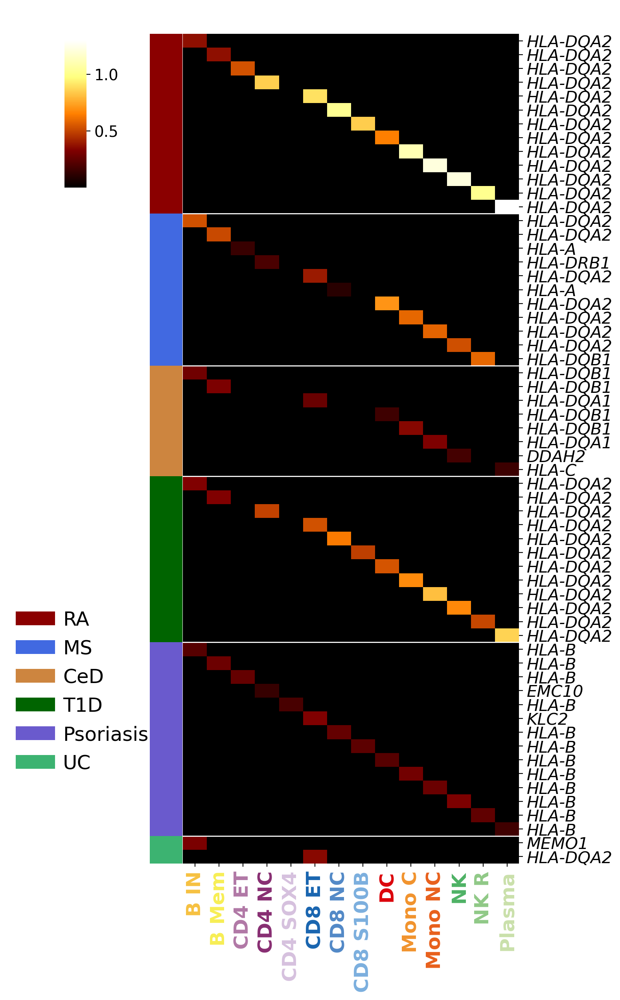

In [1404]:
# fig, axs = plt.subplots(figsize=(10,25))

clm = sns.clustermap(
    disease_ct_effect_sg, 
    figsize=(7,12.5),
    metric="cosine",
    col_cluster=False,
    row_cluster=False,
    dendrogram_ratio=(0.1, 0.03),
    colors_ratio=0.08,
    row_colors=disease_ct_gene.prs_colors.tolist(),
    cmap="afmhot", 
    cbar_pos=(-0.05, 0.8, 0.04, 0.15),
    yticklabels=True,
    rasterized=True
)

clm.ax_heatmap.set_xlabel("")
clm.ax_heatmap.tick_params(axis="x", length=3)
for label in clm.ax_heatmap.get_xticklabels():
    label.set_color(cell_label_colors[label.get_text()])
    label.set_fontweight("bold")
    label.set_fontsize(18)

clm.ax_heatmap.set_ylabel("")
for label in clm.ax_heatmap.get_yticklabels():
    label.set_fontsize(15)
    label.set_fontstyle("italic")

## Add some space between the different diseases for clarity
# Find boundaries of each disease
row_colors = np.array(disease_ct_gene.prs_colors.tolist())
boundaries = np.where(row_colors[1:] != row_colors[:-1])[0]
for b in boundaries:
    clm.ax_heatmap.axhline(b + 1, color="white", linewidth=1)

legend_elements = [
    Patch(facecolor=PRS_colors_dark[pname], label=pname)
    for pname in disease_ct_gene.PRS.cat.categories
]

clm.ax_heatmap.set_xlabel("")
clm.ax_heatmap.legend(
    handles=legend_elements,
    title="",
    bbox_to_anchor=(-0.3, 0.1),
    loc="lower center",
    frameon=False,
    borderaxespad=0.,
    handlelength=2,
    fontsize=18,
    ncols=1
)


plt.savefig(os.path.join(model_results_dir, "Figures", "Clustermap_PRS_Celltype_top-gene_single-gene-testing_dark-colors.pdf"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "Clustermap_PRS_Celltype_top-gene_single-gene-testing_dark-colors.png"), 
            bbox_inches="tight", transparent=True, dpi=600)
plt.savefig(os.path.join(model_results_dir, "Figures", "Clustermap_PRS_Celltype_top-gene_single-gene-testing_dark-colors.eps"), 
            bbox_inches="tight", transparent=True, dpi=600)


In [1029]:
PRS_effects.sort_values("p_value")

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS,Celltype
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,Plasma
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,NK
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,CD8 S100B
8,U_Factor72,RA,-0.434800,0.029862,6.977421e-54,5.372614e-50,RA__U_Factor72,NK
16,U_Factor293,RA,0.429920,0.033767,2.003210e-40,1.028314e-36,RA__U_Factor293,B IN
...,...,...,...,...,...,...,...,...
29,U_Factor393,RBC,-0.078316,0.020822,1.601209e-04,3.898254e-02,RBC__U_Factor393,Plasma
29,U_Factor393,RBC,-0.078316,0.020822,1.601209e-04,3.898254e-02,RBC__U_Factor393,B IN
50,U_Factor601,RBDW,-0.119322,0.031749,1.620053e-04,3.898254e-02,RBDW__U_Factor601,NK
13,U_Factor210,CeD,-0.135848,0.036216,1.667885e-04,3.951604e-02,CeD__U_Factor210,B IN


In [1122]:
PRS_effects.sort_values("effect_size")

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS,Celltype
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,NK
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,CD8 S100B
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,Plasma
8,U_Factor72,RA,-0.434800,0.029862,6.977421e-54,5.372614e-50,RA__U_Factor72,NK
53,U_Factor661,Psoriasis,-0.361534,0.039125,3.339088e-21,6.427745e-18,Psoriasis__U_Factor661,Mono C
...,...,...,...,...,...,...,...,...
24,U_Factor325,MS,0.327459,0.026876,6.953098e-37,2.676943e-33,MS__U_Factor325,Mono C
7,U_Factor72,CeD,0.337784,0.031566,2.603542e-28,6.682424e-25,CeD__U_Factor72,NK
10,U_Factor126,Psoriasis,0.370971,0.041848,1.425287e-19,2.194942e-16,Psoriasis__U_Factor126,None
16,U_Factor293,RA,0.429920,0.033767,2.003210e-40,1.028314e-36,RA__U_Factor293,B IN


In [1123]:
PRS_effects.loc[PRS_effects.SNP_id == "RA"].sort_values("effect_size")

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS,Celltype
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,CD8 S100B
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,NK
38,U_Factor454,RA,-0.448254,0.022657,1.232558e-110,1.898139e-106,RA__U_Factor454,Plasma
8,U_Factor72,RA,-0.434800,0.029862,6.977421e-54,5.372614e-50,RA__U_Factor72,NK
4,U_Factor41,RA,-0.273531,0.025460,1.545146e-28,4.759051e-25,RA__U_Factor41,DC
4,U_Factor41,RA,-0.273531,0.025460,1.545146e-28,4.759051e-25,RA__U_Factor41,B IN
51,U_Factor634,RA,-0.190177,0.046542,4.065360e-05,1.252131e-02,RA__U_Factor634,B IN
55,U_Factor663,RA,-0.123530,0.032142,1.144008e-04,2.936288e-02,RA__U_Factor663,Plasma
1,U_Factor19,RA,0.124845,0.023360,7.291072e-08,4.010090e-05,RA__U_Factor19,B IN
1,U_Factor19,RA,0.124845,0.023360,7.291072e-08,4.010090e-05,RA__U_Factor19,Plasma


In [1012]:
prs_single_gene.sort_values("effect_size", ascending=False)

,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,GeneSymbol
126,RA,ENSG00000237541,4.624954e-37,1.301009,0.096895,Plasma,1.287735e-31,1.287735e-31,HLA-DQA2
7,RA,ENSG00000237541,5.665687e-48,1.219178,0.079149,NK,1.565877e-42,1.577509e-42,HLA-DQA2
95,RA,ENSG00000237541,4.078839e-43,1.213319,0.083542,Mono-NC,1.131670e-37,1.135679e-37,HLA-DQA2
106,RA,ENSG00000237541,1.225816e-39,1.107074,0.080155,Mono-C,3.413063e-34,3.413063e-34,HLA-DQA2
67,RA,ENSG00000237541,2.631037e-31,1.020135,0.084534,CD8-NC,7.227400e-26,7.325648e-26,HLA-DQA2
...,...,...,...,...,...,...,...,...,...
14,MS,ENSG00000237541,1.180216e-09,-0.523855,0.085262,NK,4.077337e-05,4.107625e-05,HLA-DQA2
65,MS,ENSG00000237541,2.981060e-31,-0.531650,0.044099,B-IN,8.099114e-26,8.300225e-26,HLA-DQA2
100,MS,ENSG00000237541,1.182314e-10,-0.583582,0.089534,Mono-NC,8.200797e-06,8.229849e-06,HLA-DQA2
114,MS,ENSG00000237541,7.581429e-12,-0.586747,0.084613,Mono-C,3.015589e-07,3.015589e-07,HLA-DQA2


In [1011]:
prs_single_gene.loc[(prs_single_gene.PRS == "RA") & (prs_single_gene.GeneSymbol == "HLA-DQA2")].sort_values("effect_size", ascending=False)

,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,GeneSymbol
126,RA,ENSG00000237541,4.624954e-37,1.301009,0.096895,Plasma,1.287735e-31,1.287735e-31,HLA-DQA2
7,RA,ENSG00000237541,5.665687e-48,1.219178,0.079149,NK,1.565877e-42,1.577509e-42,HLA-DQA2
95,RA,ENSG00000237541,4.078839e-43,1.213319,0.083542,Mono-NC,1.131670e-37,1.135679e-37,HLA-DQA2
106,RA,ENSG00000237541,1.225816e-39,1.107074,0.080155,Mono-C,3.413063e-34,3.413063e-34,HLA-DQA2
67,RA,ENSG00000237541,2.631037e-31,1.020135,0.084534,CD8-NC,7.227400e-26,7.325648e-26,HLA-DQA2
86,RA,ENSG00000237541,1.016273e-31,1.011418,0.083152,NK-R,2.829628e-26,2.829628e-26,HLA-DQA2
35,RA,ENSG00000237541,5.277721e-41,0.895102,0.063607,CD8-ET,1.447043e-35,1.469486e-35,HLA-DQA2
16,RA,ENSG00000237541,4.050296e-28,0.852936,0.075109,CD4-NC,1.099231e-22,1.127732e-22,HLA-DQA2
24,RA,ENSG00000237541,1.091934e-20,0.845940,0.088613,CD8-S100B,1.508566e-15,1.520147e-15,HLA-DQA2
118,RA,ENSG00000237541,1.285836e-20,0.648549,0.068048,DC,1.163216e-15,1.193393e-15,HLA-DQA2


In [1026]:
prs_single_gene.loc[(prs_single_gene.GeneSymbol == "HLA-DQA2") & (prs_single_gene.celltype == "NK")]

,PRS,gene,p_value,effect_size,effect_size_se,celltype,Storey_q,BH_corrected_pvalue,GeneSymbol
7,RA,ENSG00000237541,5.665687e-48,1.219178,0.079149,NK,1.565877e-42,1.577509e-42,HLA-DQA2
10,T1D,ENSG00000237541,1.501903e-14,0.674162,0.086318,NK,8.301888e-10,8.363557e-10,HLA-DQA2
14,MS,ENSG00000237541,1.180216e-09,-0.523855,0.085262,NK,4.077337e-05,4.107625e-05,HLA-DQA2


In [160]:
enr_bio_topgenes = gp.enrichr(gene_list = prs_gene_ct.TopGene.unique().tolist(), 
                              gene_sets = databases_bio,
                              background = background_genes.values,
                              outdir=None)
enr_bio_topgenes_sign = enr_bio_topgenes.results.loc[enr_bio_topgenes.results["Adjusted P-value"] <= 0.05]
enr_bio_topgenes_sign.sort_values("Adjusted P-value", ascending=True).head(20)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
703,KEGG_2021_Human,Antigen processing and presentation,2.040846e-23,2.224522e-21,0,0,137.945493,7207.113032,CD74;HLA-DRB5;HLA-B;HLA-C;HLA-A;HLA-DPB1;HLA-D...
704,KEGG_2021_Human,Graft-versus-host disease,6.790471e-23,3.700807e-21,0,0,243.603448,12434.479020,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;KL...
707,KEGG_2021_Human,Autoimmune thyroid disease,4.978012e-21,1.085207e-19,0,0,235.516667,11010.229001,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
706,KEGG_2021_Human,Viral myocarditis,4.884731e-21,1.085207e-19,0,0,157.867661,7383.182037,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
705,KEGG_2021_Human,Allograft rejection,3.325069e-21,1.085207e-19,0,0,246.749206,11634.915105,HLA-DRB5;HLA-B;HLA-DPB1;HLA-C;HLA-DRA;HLA-A;HL...
708,KEGG_2021_Human,Type I diabetes mellitus,7.344643e-21,1.334277e-19,0,0,225.260870,10443.165035,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
709,KEGG_2021_Human,Phagosome,9.936812e-20,1.547304e-18,0,0,70.044872,3064.845281,HLA-DRB5;HLA-B;HLA-C;CYBA;HLA-A;ACTB;HLA-DPB1;...
710,KEGG_2021_Human,Rheumatoid arthritis,1.161519e-16,1.582569e-15,0,0,80.718229,2961.683663,HLA-DRB5;JUN;CCL5;HLA-DPB1;CCL3;HLA-DRA;HLA-DQ...
711,KEGG_2021_Human,Human T-cell leukemia virus 1 infection,1.567217e-16,1.898074e-15,0,0,39.583080,1440.509835,HLA-DRB5;JUN;HLA-B;HLA-C;HLA-A;ZFP36;HLA-DPB1;...
712,KEGG_2021_Human,Asthma,1.113018e-15,1.213190e-14,0,0,228.492929,7867.400190,HLA-DRB5;HLA-DPB1;HLA-DRA;HLA-DQA2;HLA-DQA1;HL...


/tmp/ipykernel_1081609/615619358.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_1081609/615619358.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.


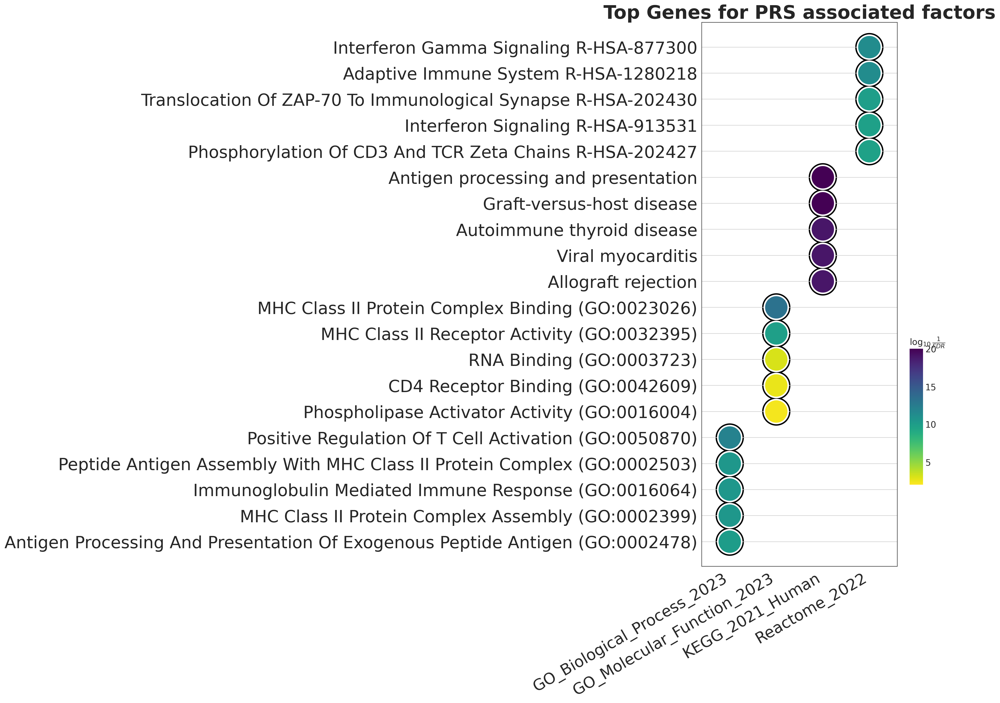

In [693]:
fig, axs = plt.subplots(figsize=(7,16), constrained_layout=True)
make_gp_dotplot(df=enr_bio_topgenes_sign,
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 5,
                title = "Top Genes for PRS associated factors",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio_top-genes-autoimmune-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio_top-genes-autoimmune-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/gseapy/plot.py:754: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
/tmp/ipykernel_37593/21410246.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_37593/21410246.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_37593/21410246.py:20: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3

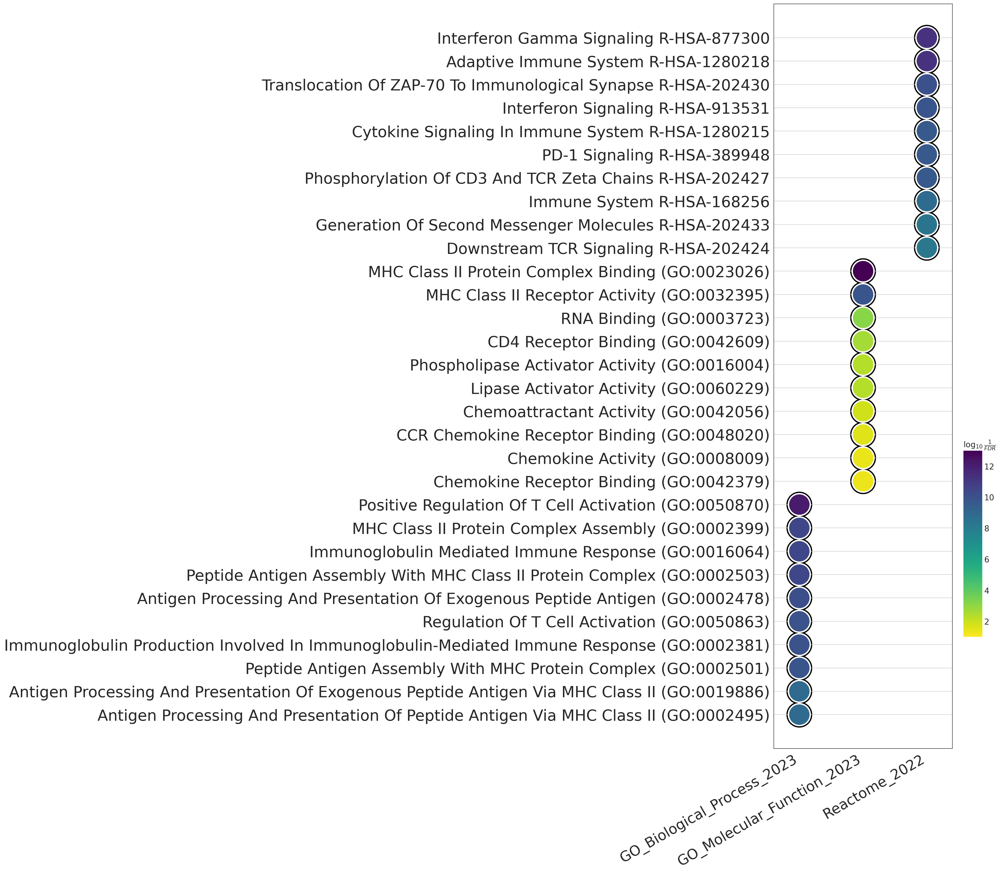

In [163]:
fig, axs = plt.subplots(figsize=(7,24), constrained_layout=True)
make_gp_dotplot(df=enr_bio_topgenes_sign.loc[enr_bio_topgenes_sign.Gene_set != "KEGG_2021_Human"],
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 10,
                title = "",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-autoimmune-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-autoimmune-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-autoimmune-PRS.pdf"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [373]:
enr_bio_topgenes_sign = enr_bio_topgenes_sign.assign(mlog10pval = -np.log10(enr_bio_topgenes_sign["Adjusted P-value"]))
plot_df = enr_bio_topgenes_sign.filter(["Gene_set", "Term", "mlog10pval"])
plot_df = plot_df.sort_values(by="mlog10pval", ascending=False)
plot_df

,Gene_set,Term,mlog10pval
703,KEGG_2021_Human,Antigen processing and presentation,20.652763
704,KEGG_2021_Human,Graft-versus-host disease,20.431704
707,KEGG_2021_Human,Autoimmune thyroid disease,18.964488
706,KEGG_2021_Human,Viral myocarditis,18.964488
705,KEGG_2021_Human,Allograft rejection,18.964488
...,...,...,...
926,Reactome_2022,MAP Kinase Activation R-HSA-450294,1.316530
924,Reactome_2022,Oxidative Stress Induced Senescence R-HSA-2559580,1.316530
925,Reactome_2022,Regulation Of RAS By GAPs R-HSA-5658442,1.316530
133,GO_Biological_Process_2023,Neutrophil Chemotaxis (GO:0030593),1.306147


In [374]:
idx = plot_df.groupby("Gene_set", observed=True).apply(lambda x: x.mlog10pval.nlargest(10, keep="all"), include_groups=False).index.get_level_values(1)
plot_df = plot_df.loc[idx]
plot_df = plot_df.loc[plot_df.Gene_set != "KEGG_2021_Human"]
plot_df

,Gene_set,Term,mlog10pval
0,GO_Biological_Process_2023,Positive Regulation Of T Cell Activation (GO:0...,12.113084
1,GO_Biological_Process_2023,MHC Class II Protein Complex Assembly (GO:0002...,10.441328
3,GO_Biological_Process_2023,Immunoglobulin Mediated Immune Response (GO:00...,10.441328
2,GO_Biological_Process_2023,Peptide Antigen Assembly With MHC Class II Pro...,10.441328
4,GO_Biological_Process_2023,Antigen Processing And Presentation Of Exogeno...,10.112313
5,GO_Biological_Process_2023,Regulation Of T Cell Activation (GO:0050863),9.995398
6,GO_Biological_Process_2023,Immunoglobulin Production Involved In Immunogl...,9.981147
7,GO_Biological_Process_2023,Peptide Antigen Assembly With MHC Protein Comp...,9.818204
9,GO_Biological_Process_2023,Antigen Processing And Presentation Of Peptide...,8.885498
8,GO_Biological_Process_2023,Antigen Processing And Presentation Of Exogeno...,8.885498


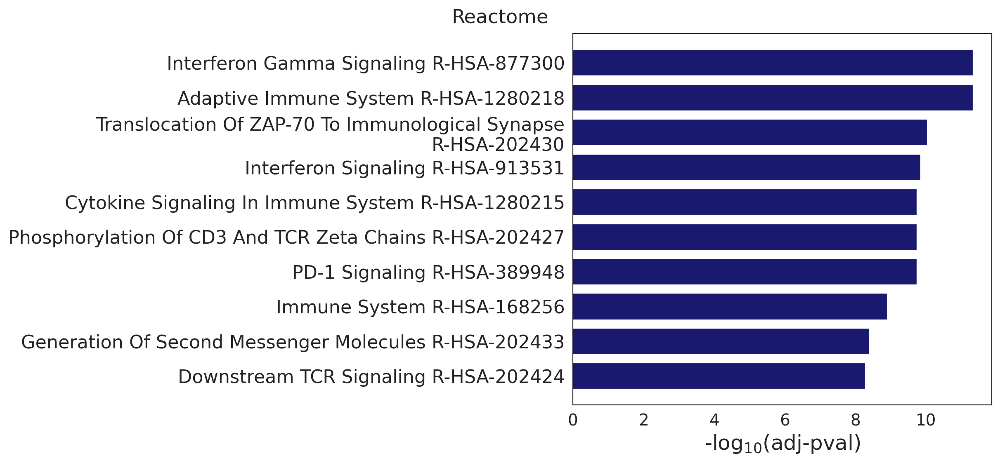

In [281]:
plot_df_reactome = plot_df.loc[plot_df.Gene_set == "Reactome_2022"].sort_values("mlog10pval", ascending=True)
plot_df_reactome.Term = [textwrap.fill(term, width=55) for term in plot_df_reactome.Term]


fig, axs = plt.subplots(figsize=(12, 5.5), constrained_layout=True)
axs.barh(y="Term", width="mlog10pval", data=plot_df_reactome,
         color="midnightblue", edgecolor="midnightblue", height=0.7)
axs.set_xlabel("-log$_{10}$(adj-pval)", fontsize=18)
axs.tick_params(axis="y", labelsize=16)
# axs.spines["right"].set_visible(False)
# axs.spines["top"].set_visible(False)
fig.suptitle("Reactome")
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_Reactome.pdf"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_Reactome.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_Reactome.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [269]:
[textwrap.fill(term, width=55) for term in plot_df_GO_bio.Term]

['Antigen Processing And Presentation Of Peptide Antigen\nVia MHC Class II (GO:0002495)',
 'Antigen Processing And Presentation Of Exogenous\nPeptide Antigen Via MHC Class II (GO:0019886)',
 'Peptide Antigen Assembly With MHC Protein Complex\n(GO:0002501)',
 'Immunoglobulin Production Involved In Immunoglobulin-\nMediated Immune Response (GO:0002381)',
 'Regulation Of T Cell Activation (GO:0050863)',
 'Antigen Processing And Presentation Of Exogenous\nPeptide Antigen (GO:0002478)',
 'MHC Class II Protein Complex Assembly (GO:0002399)',
 'Immunoglobulin Mediated Immune Response (GO:0016064)',
 'Peptide Antigen Assembly With MHC Class II Protein\nComplex (GO:0002503)',
 'Positive Regulation Of T Cell Activation (GO:0050870)']

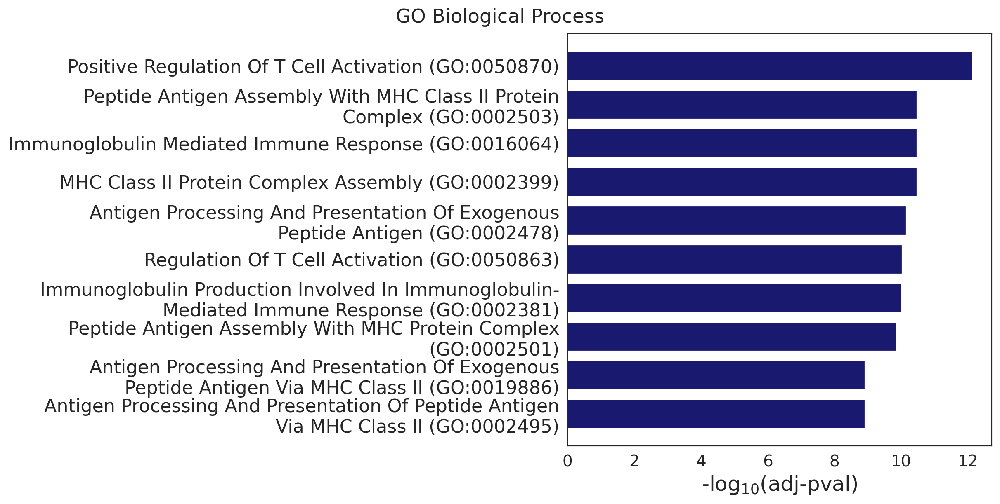

In [271]:
plot_df_GO_bio = plot_df.loc[plot_df.Gene_set == "GO_Biological_Process_2023"].sort_values("mlog10pval", ascending=True)
plot_df_GO_bio.Term = [textwrap.fill(term, width=55) for term in plot_df_GO_bio.Term]

fig, axs = plt.subplots(figsize=(12, 6), constrained_layout=True)
axs.barh(y="Term", width="mlog10pval", data=plot_df_GO_bio, 
         color="midnightblue", edgecolor="midnightblue", height=0.7)
axs.set_xlabel("-log$_{10}$(adj-pval)", fontsize=18)
axs.tick_params(axis="y", labelsize=16)
# axs.spines["right"].set_visible(False)
# axs.spines["top"].set_visible(False)
fig.suptitle("GO Biological Process")
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_GO-Bio-Process.pdf"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_GO-Bio-Process.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_GO-Bio-Process.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

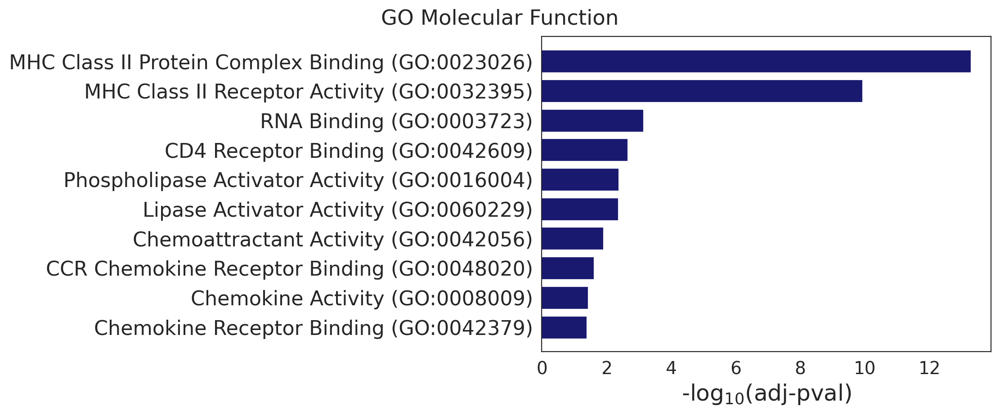

In [272]:
fig, axs = plt.subplots(figsize=(11, 4.5), constrained_layout=True)
axs.barh(y="Term", width="mlog10pval", data=plot_df.loc[plot_df.Gene_set == "GO_Molecular_Function_2023"].sort_values("mlog10pval", ascending=True), 
         color="midnightblue", edgecolor="midnightblue", height=0.7)
axs.set_xlabel("-log$_{10}$(adj-pval)", fontsize=18)
axs.tick_params(axis="y", labelsize=16)
# axs.spines["right"].set_visible(False)
# axs.spines["top"].set_visible(False)
fig.suptitle("GO Molecular Function")
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_GO-Mol-Function.pdf"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_GO-Mol-Function.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS_GO-Mol-Function.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [319]:
term_idx = plot_df.sort_values("mlog10pval", ascending=True).groupby("Gene_set").groups
term_idx 

{'GO_Biological_Process_2023': [8, 9, 7, 6, 5, 4, 1, 3, 2, 0], 'GO_Molecular_Function_2023': [634, 633, 632, 631, 630, 629, 628, 627, 626, 625], 'Reactome_2022': [821, 820, 819, 816, 818, 817, 815, 814, 813, 812]}

In [ ]:
# sorted_idx = list(itertools.chain.from_iterable([v.tolist() for v in term_idx.values()]))
# sorted_idx 

In [328]:
sorted_idx = list(itertools.chain.from_iterable([term_idx["GO_Molecular_Function_2023"], term_idx["GO_Biological_Process_2023"], term_idx["Reactome_2022"]]))
sorted_idx

[634,
 633,
 632,
 631,
 630,
 629,
 628,
 627,
 626,
 625,
 8,
 9,
 7,
 6,
 5,
 4,
 1,
 3,
 2,
 0,
 821,
 820,
 819,
 816,
 818,
 817,
 815,
 814,
 813,
 812]

In [351]:
gs_colors = dict(zip(plot_df.Gene_set.unique(), ["cornflowerblue", "mediumseagreen", "orange"]))
gs_colors

{'GO_Biological_Process_2023': 'cornflowerblue',
 'GO_Molecular_Function_2023': 'mediumseagreen',
 'Reactome_2022': 'orange'}

In [375]:
plot_df.Term = [textwrap.fill(term, width=65) for term in plot_df.Term]

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


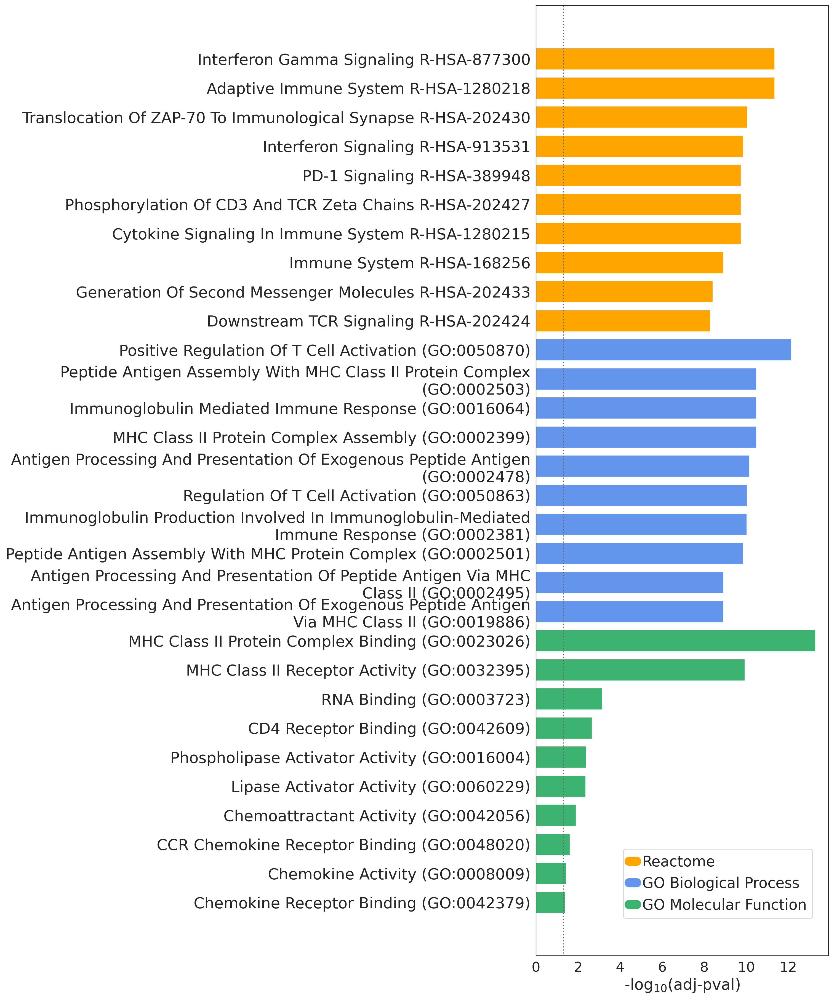

In [391]:
fig, axs = plt.subplots(figsize=(15,18), constrained_layout=True)


for idx in sorted_idx:
    axs.barh(y=plot_df.loc[idx]["Term"], width=plot_df.loc[idx]["mlog10pval"], height=0.7, label=plot_df.loc[idx]["Gene_set"], 
             color=gs_colors[plot_df.loc[idx]["Gene_set"]], edgecolor=gs_colors[plot_df.loc[idx]["Gene_set"]])
axs.set_xlabel("-log$_{10}$(adj-pval)", fontsize=20)
axs.tick_params(axis="y", labelsize=20)
axs.tick_params(axis="x", labelsize=18)

legend_handles = [
    Line2D([0], [0], color="orange", lw=12, label="Reactome"),
    Line2D([0], [0], color="cornflowerblue", lw=12, label="GO Biological Process"),
    Line2D([0], [0], color="mediumseagreen", lw=12, label="GO Molecular Function"),
]
axs.legend(handles=legend_handles, fontsize=19, bbox_to_anchor=(0.97, 0.12))
axs.axvline(x=-np.log10(0.05), ymin=axs.get_ylim()[0], ymax=axs.get_ylim()[1], linestyle=":", color="dimgrey")

plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS.pdf"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "Barplot_GSEA_bio-top-10_top-genes-autoimmune-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [698]:
enr_bio_topgenes_RA = gp.enrichr(gene_list = prs_gene_ct.loc[prs_gene_ct.PRS == "RA"].TopGene.unique().tolist(), 
                              gene_sets = databases_bio,
                              background = background_genes.values,
                              outdir=None)
enr_bio_topgenes_RA_sign = enr_bio_topgenes_RA.results.loc[enr_bio_topgenes_RA.results["Adjusted P-value"] <= 0.05]
enr_bio_topgenes_RA_sign.sort_values("Adjusted P-value", ascending=True).head(20)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
283,GO_Molecular_Function_2023,MHC Class II Protein Complex Binding (GO:0023026),1.246628e-15,6.233138e-14,0,0,440.440000,15115.167184,CD74;HLA-DRB5;HLA-DRA;HLA-DQA2;HLA-DRB1;HLA-DQ...
333,KEGG_2021_Human,Asthma,1.790389e-15,1.324888e-13,0,0,412.883333,14020.008225,HLA-DRB5;HLA-DPB1;HLA-DRA;HLA-DQA2;HLA-DRB1;HL...
0,GO_Biological_Process_2023,Immunoglobulin Mediated Immune Response (GO:00...,1.790389e-15,2.850707e-13,0,0,412.883333,14020.008225,CD74;HLA-DRB5;HLA-DRA;HLA-DQA2;HLA-DRB1;HLA-DQ...
2,GO_Biological_Process_2023,MHC Class II Protein Complex Assembly (GO:0002...,3.021951e-15,2.850707e-13,0,0,1062.525000,35523.264090,HLA-DRB5;HLA-DRA;HLA-DQA2;HLA-DQA1;HLA-DRB1;HL...
1,GO_Biological_Process_2023,Peptide Antigen Assembly With MHC Class II Pro...,3.021951e-15,2.850707e-13,0,0,1062.525000,35523.264090,HLA-DRB5;HLA-DRA;HLA-DQA2;HLA-DQA1;HLA-DRB1;HL...
334,KEGG_2021_Human,Inflammatory bowel disease,9.156237e-15,3.387808e-13,0,0,171.732523,5551.140644,HLA-DRB5;JUN;HLA-DPB1;HLA-DRA;HLA-DQA2;HLA-DRB...
337,KEGG_2021_Human,Leishmaniasis,3.302397e-14,4.796782e-13,0,0,144.040816,4471.249147,HLA-DRB5;JUN;HLA-DPB1;HLA-DRA;HLA-DQA2;HLA-DRB...
335,KEGG_2021_Human,Allograft rejection,2.437882e-14,4.796782e-13,0,0,264.077333,8277.520274,HLA-DRB5;HLA-DPB1;HLA-DRA;HLA-DQA2;HLA-DRB1;HL...
336,KEGG_2021_Human,Autoimmune thyroid disease,3.091391e-14,4.796782e-13,0,0,253.902564,7898.291832,HLA-DRB5;HLA-DPB1;HLA-DRA;HLA-DQA2;HLA-DRB1;HL...
338,KEGG_2021_Human,Type I diabetes mellitus,3.889283e-14,4.796782e-13,0,0,244.481481,7549.090990,HLA-DRB5;HLA-DPB1;HLA-DRA;HLA-DQA2;HLA-DRB1;HL...


/tmp/ipykernel_1081609/1800740265.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_1081609/1800740265.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.


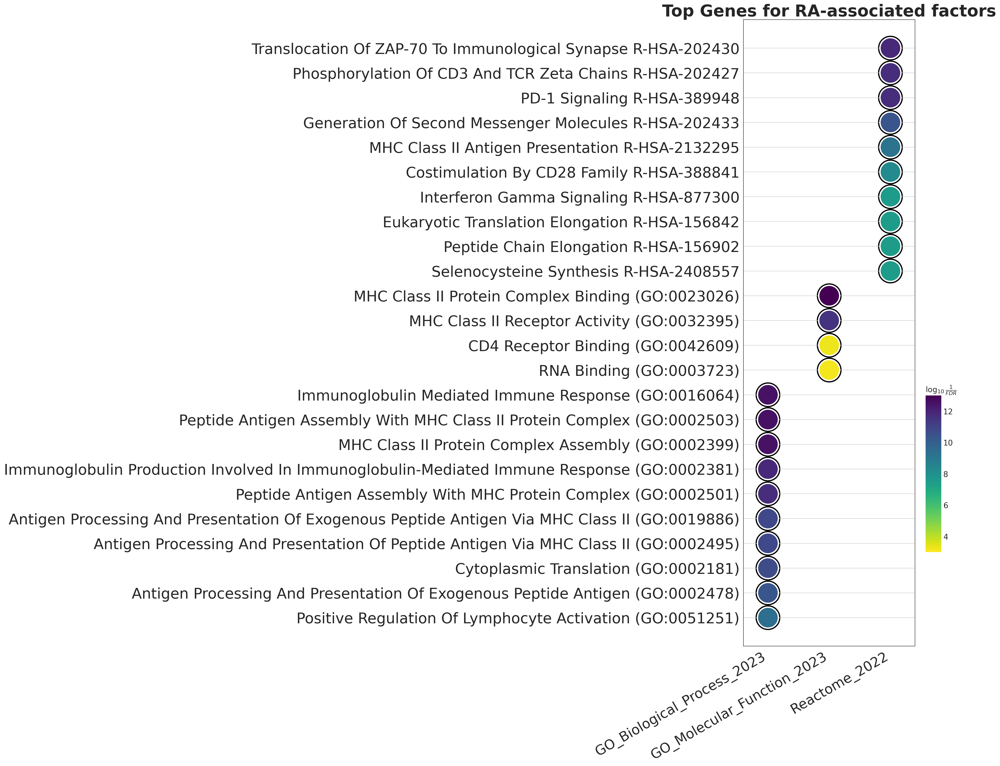

In [701]:
fig, axs = plt.subplots(figsize=(7,21), constrained_layout=True)
make_gp_dotplot(df=enr_bio_topgenes_RA_sign.loc[enr_bio_topgenes_RA_sign.Gene_set != "KEGG_2021_Human"],
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 10,
                title = "Top Genes for RA-associated factors",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-RA-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-RA-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [703]:
prs_gene_ct.loc[prs_gene_ct.PRS == "UC"].TopGene.unique().tolist()

['HLA-DQA2', 'HLA-DRB5']

In [702]:
enr_bio_topgenes_UC = gp.enrichr(gene_list = prs_gene_ct.loc[prs_gene_ct.PRS == "UC"].TopGene.unique().tolist(), 
                              gene_sets = databases_bio,
                              background = background_genes.values,
                              outdir=None)
enr_bio_topgenes_UC_sign = enr_bio_topgenes_UC.results.loc[enr_bio_topgenes_UC.results["Adjusted P-value"] <= 0.05]
enr_bio_topgenes_UC_sign.sort_values("Adjusted P-value", ascending=True).head(20)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,Peptide Antigen Assembly With MHC Class II Pro...,5.459723e-07,0.000003,0,0,inf,inf,HLA-DRB5;HLA-DQA2
1,GO_Biological_Process_2023,MHC Class II Protein Complex Assembly (GO:0002...,5.459723e-07,0.000003,0,0,inf,inf,HLA-DRB5;HLA-DQA2
2,GO_Biological_Process_2023,Immunoglobulin Production Involved In Immunogl...,9.033421e-07,0.000003,0,0,inf,inf,HLA-DRB5;HLA-DQA2
3,GO_Biological_Process_2023,Peptide Antigen Assembly With MHC Protein Comp...,1.042320e-06,0.000003,0,0,inf,inf,HLA-DRB5;HLA-DQA2
4,GO_Biological_Process_2023,Antigen Processing And Presentation Of Peptide...,2.084658e-06,0.000004,0,0,inf,inf,HLA-DRB5;HLA-DQA2
5,GO_Biological_Process_2023,Antigen Processing And Presentation Of Exogeno...,2.084658e-06,0.000004,0,0,inf,inf,HLA-DRB5;HLA-DQA2
6,GO_Biological_Process_2023,Immunoglobulin Mediated Immune Response (GO:00...,2.511523e-06,0.000004,0,0,inf,inf,HLA-DRB5;HLA-DQA2
12,GO_Molecular_Function_2023,MHC Class II Protein Complex Binding (GO:0023026),2.293127e-06,0.000005,0,0,inf,inf,HLA-DRB5;HLA-DQA2
7,GO_Biological_Process_2023,Antigen Processing And Presentation Of Exogeno...,3.226274e-06,0.000005,0,0,inf,inf,HLA-DRB5;HLA-DQA2
40,Reactome_2022,Phosphorylation Of CD3 And TCR Zeta Chains R-H...,1.191225e-06,0.000005,0,0,inf,inf,HLA-DRB5;HLA-DQA2


/tmp/ipykernel_1081609/3769316119.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_1081609/3769316119.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.


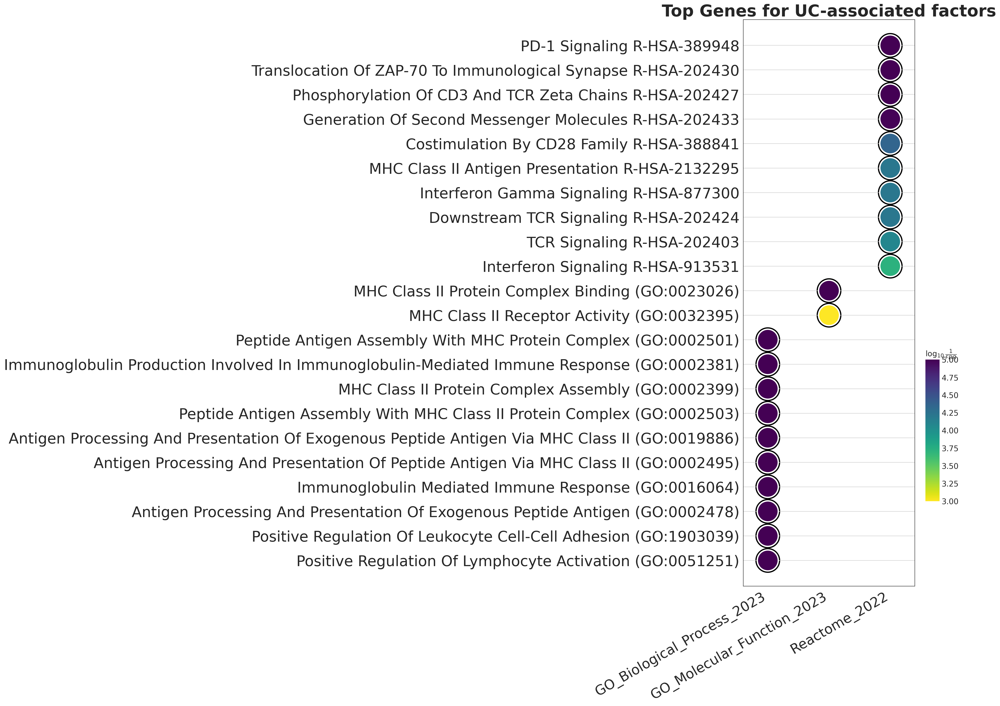

In [705]:
fig, axs = plt.subplots(figsize=(7,19), constrained_layout=True)
make_gp_dotplot(df=enr_bio_topgenes_UC_sign.loc[enr_bio_topgenes_UC_sign.Gene_set != "KEGG_2021_Human"],
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 10,
                title = "Top Genes for UC-associated factors",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-UC-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-UC-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [706]:
enr_bio_topgenes_Celiac = gp.enrichr(gene_list = prs_gene_ct.loc[prs_gene_ct.PRS == "Celiac"].TopGene.unique().tolist(), 
                              gene_sets = databases_bio,
                              background = background_genes.values,
                              outdir=None)
enr_bio_topgenes_Celiac_sign = enr_bio_topgenes_Celiac.results.loc[enr_bio_topgenes_Celiac.results["Adjusted P-value"] <= 0.05]
enr_bio_topgenes_Celiac_sign.sort_values("Adjusted P-value", ascending=True).head(20)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
403,KEGG_2021_Human,Antigen processing and presentation,3.190066e-24,2.201145e-22,0,0,242.683862,13129.682497,CD74;HLA-DRB5;HLA-B;HLA-C;HLA-A;HLA-DPB1;HLA-D...
405,KEGG_2021_Human,Allograft rejection,1.398139e-23,3.215720e-22,0,0,463.113095,24371.009380,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
404,KEGG_2021_Human,Viral myocarditis,1.111693e-23,3.215720e-22,0,0,305.513514,16147.480944,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
406,KEGG_2021_Human,Autoimmune thyroid disease,2.095080e-23,3.614012e-22,0,0,442.031250,23082.812440,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
407,KEGG_2021_Human,Type I diabetes mellitus,3.093927e-23,4.269620e-22,0,0,422.782609,21912.829318,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
408,KEGG_2021_Human,Phagosome,6.225169e-23,6.391405e-22,0,0,145.622781,7445.817535,HLA-DRB5;HLA-B;HLA-C;CYBA;HLA-A;ACTB;HLA-DPB1;...
409,KEGG_2021_Human,Graft-versus-host disease,6.484034e-23,6.391405e-22,0,0,388.905000,19869.200922,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
410,KEGG_2021_Human,Human T-cell leukemia virus 1 infection,8.047214e-18,6.940722e-17,0,0,70.566382,2777.577878,HLA-DRB5;HLA-B;HLA-C;HLA-A;ZFP36;HLA-DPB1;HLA-...
411,KEGG_2021_Human,Cell adhesion molecules,1.008144e-17,7.729106e-17,0,0,112.566134,4405.369663,HLA-DRB5;HLA-DPB1;HLA-B;HLA-DRA;HLA-C;HLA-A;HL...
412,KEGG_2021_Human,Asthma,2.620088e-17,1.807861e-16,0,0,397.249123,15167.264935,HLA-DRB5;HLA-DPB1;HLA-DRA;HLA-DQA2;HLA-DRB1;HL...


/tmp/ipykernel_1081609/2674912698.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_1081609/2674912698.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.


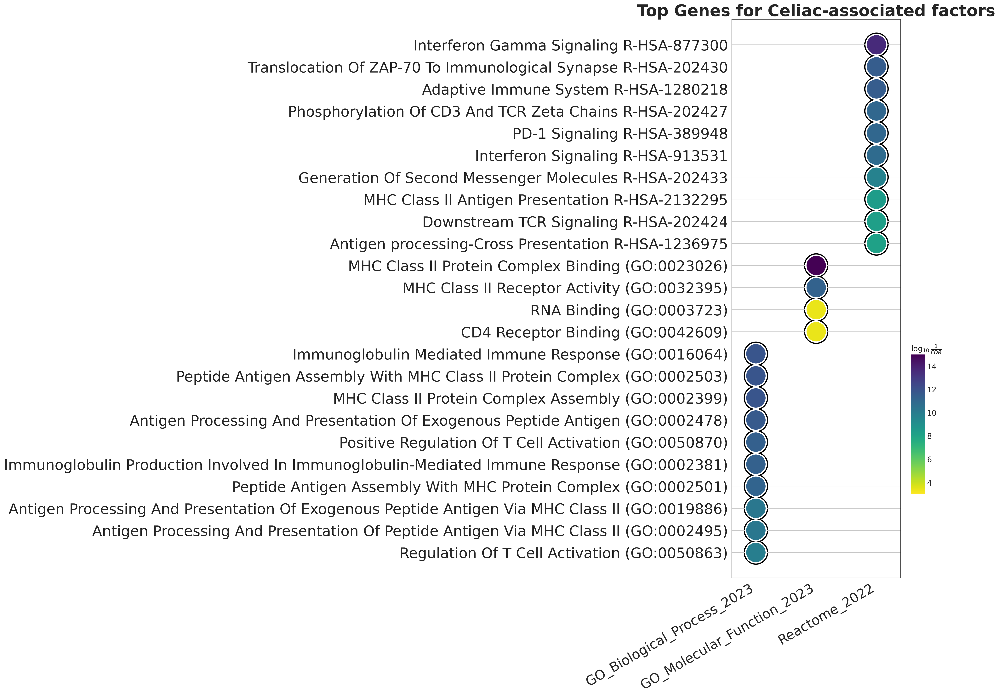

In [708]:
fig, axs = plt.subplots(figsize=(7,19), constrained_layout=True)
make_gp_dotplot(df=enr_bio_topgenes_Celiac_sign.loc[enr_bio_topgenes_Celiac_sign.Gene_set != "KEGG_2021_Human"],
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 10,
                title = "Top Genes for Celiac-associated factors",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-Celiac-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-Celiac-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [709]:
enr_bio_topgenes_MS = gp.enrichr(gene_list = prs_gene_ct.loc[prs_gene_ct.PRS == "Multiple_sclerosis"].TopGene.unique().tolist(), 
                              gene_sets = databases_bio,
                              background = background_genes.values,
                              outdir=None)
enr_bio_topgenes_MS_sign = enr_bio_topgenes_MS.results.loc[enr_bio_topgenes_MS.results["Adjusted P-value"] <= 0.05]
enr_bio_topgenes_MS_sign.sort_values("Adjusted P-value", ascending=True).head(20)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
139,KEGG_2021_Human,Allograft rejection,1.747018e-17,3.163423e-16,0,0,1321.506667,50991.704156,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...
140,KEGG_2021_Human,Autoimmune thyroid disease,2.216977e-17,3.163423e-16,0,0,1270.589744,48724.323688,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...
141,KEGG_2021_Human,Type I diabetes mellitus,2.791255e-17,3.163423e-16,0,0,1223.444444,46634.588687,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...
142,KEGG_2021_Human,Graft-versus-host disease,4.329722e-17,3.680264e-16,0,0,1138.908046,42912.282226,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...
143,KEGG_2021_Human,Viral myocarditis,4.445070e-16,3.022647e-15,0,0,785.666667,27772.975633,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...
144,KEGG_2021_Human,Antigen processing and presentation,4.485469e-15,2.541766e-14,0,0,549.266667,18146.635548,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...
145,KEGG_2021_Human,Cell adhesion molecules,6.589520e-14,3.200624e-13,0,0,365.400000,11090.149705,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...
146,KEGG_2021_Human,Phagosome,2.693963e-13,1.144934e-12,0,0,295.828829,8562.053305,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...
147,KEGG_2021_Human,Asthma,1.757467e-12,6.639320e-12,0,0,787.000000,21301.845107,HLA-DRB5;HLA-DQA2;HLA-DQA1;HLA-DRB1;HLA-DQB1
148,KEGG_2021_Human,Epstein-Barr virus infection,5.037384e-12,1.712711e-11,0,0,191.210526,4974.176296,HLA-DRB5;HLA-C;HLA-A;HLA-DQA2;HLA-DQA1;HLA-DRB...


/tmp/ipykernel_1081609/3251470959.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_1081609/3251470959.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.


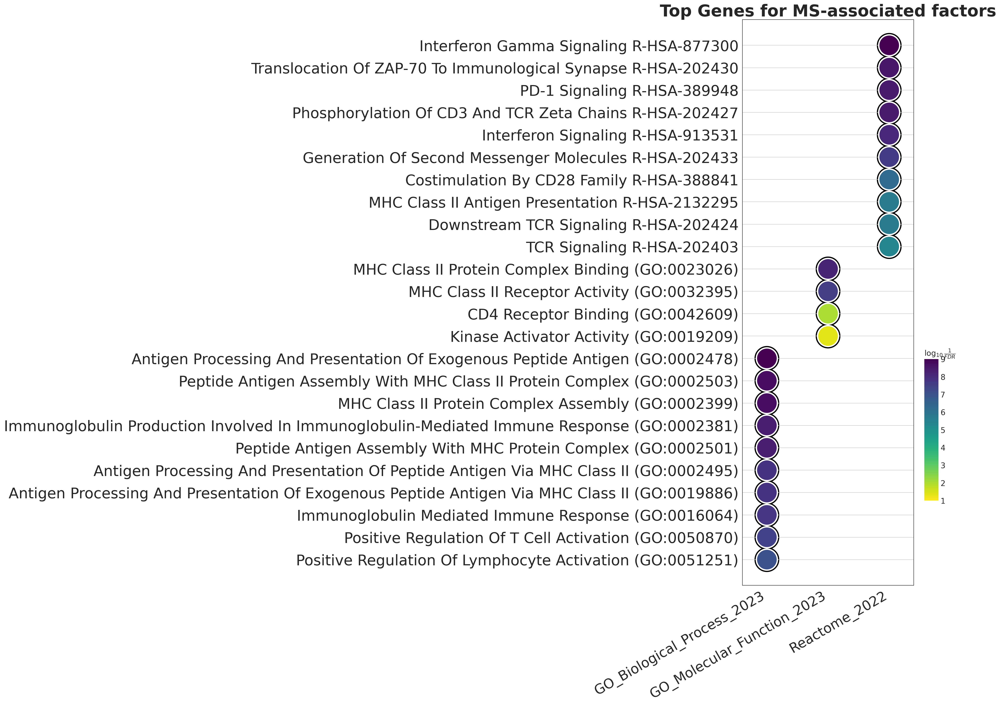

In [710]:
fig, axs = plt.subplots(figsize=(7,19), constrained_layout=True)
make_gp_dotplot(df=enr_bio_topgenes_MS_sign.loc[enr_bio_topgenes_MS_sign.Gene_set != "KEGG_2021_Human"],
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 10,
                title = "Top Genes for MS-associated factors",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-MS-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-MS-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [711]:
enr_bio_topgenes_psoriasis = gp.enrichr(gene_list = prs_gene_ct.loc[prs_gene_ct.PRS == "Psoriasis"].TopGene.unique().tolist(), 
                              gene_sets = databases_bio,
                              background = background_genes.values,
                              outdir=None)
enr_bio_topgenes_psoriasis_sign = enr_bio_topgenes_psoriasis.results.loc[enr_bio_topgenes_psoriasis.results["Adjusted P-value"] <= 0.05]
enr_bio_topgenes_psoriasis_sign.sort_values("Adjusted P-value", ascending=True).head(20)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
421,KEGG_2021_Human,Graft-versus-host disease,3.589788e-11,1.723098e-09,0,0,380.430108,9149.474559,HLA-DRB5;HLA-B;HLA-C;KLRC1;HLA-DRB1
422,KEGG_2021_Human,Antigen processing and presentation,9.096658e-10,2.183198e-08,0,0,189.798387,3951.212157,HLA-DRB5;HLA-B;HLA-C;KLRC1;HLA-DRB1
425,KEGG_2021_Human,Type I diabetes mellitus,8.944697e-09,8.586909e-08,0,0,269.580952,4995.929466,HLA-DRB5;HLA-B;HLA-C;HLA-DRB1
424,KEGG_2021_Human,Autoimmune thyroid disease,7.895482e-09,8.586909e-08,0,0,278.896552,5203.366025,HLA-DRB5;HLA-B;HLA-C;HLA-DRB1
423,KEGG_2021_Human,Allograft rejection,6.941181e-09,8.586909e-08,0,0,288.877551,5426.794149,HLA-DRB5;HLA-B;HLA-C;HLA-DRB1
426,KEGG_2021_Human,Viral myocarditis,4.062467e-08,3.249973e-07,0,0,179.530159,3055.404099,HLA-DRB5;HLA-B;HLA-C;HLA-DRB1
428,KEGG_2021_Human,Rheumatoid arthritis,2.306688e-07,1.384013e-06,0,0,113.577465,1735.722973,HLA-DRB5;CCL5;CCL3;HLA-DRB1
427,KEGG_2021_Human,Human T-cell leukemia virus 1 infection,2.113294e-07,1.384013e-06,0,0,60.724826,933.331347,HLA-DRB5;ZFP36;HLA-B;HLA-C;HLA-DRB1
0,GO_Biological_Process_2023,Regulation Of T Cell Mediated Cytotoxicity (GO...,3.958399e-09,1.535859e-06,0,0,337.119048,6522.385864,HLA-B;HLA-C;KLRC1;HLA-DRB1
429,KEGG_2021_Human,Cell adhesion molecules,6.518637e-07,3.476606e-06,0,0,86.574501,1233.117873,HLA-DRB5;HLA-B;HLA-C;HLA-DRB1


/tmp/ipykernel_1081609/1031388700.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_1081609/1031388700.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.


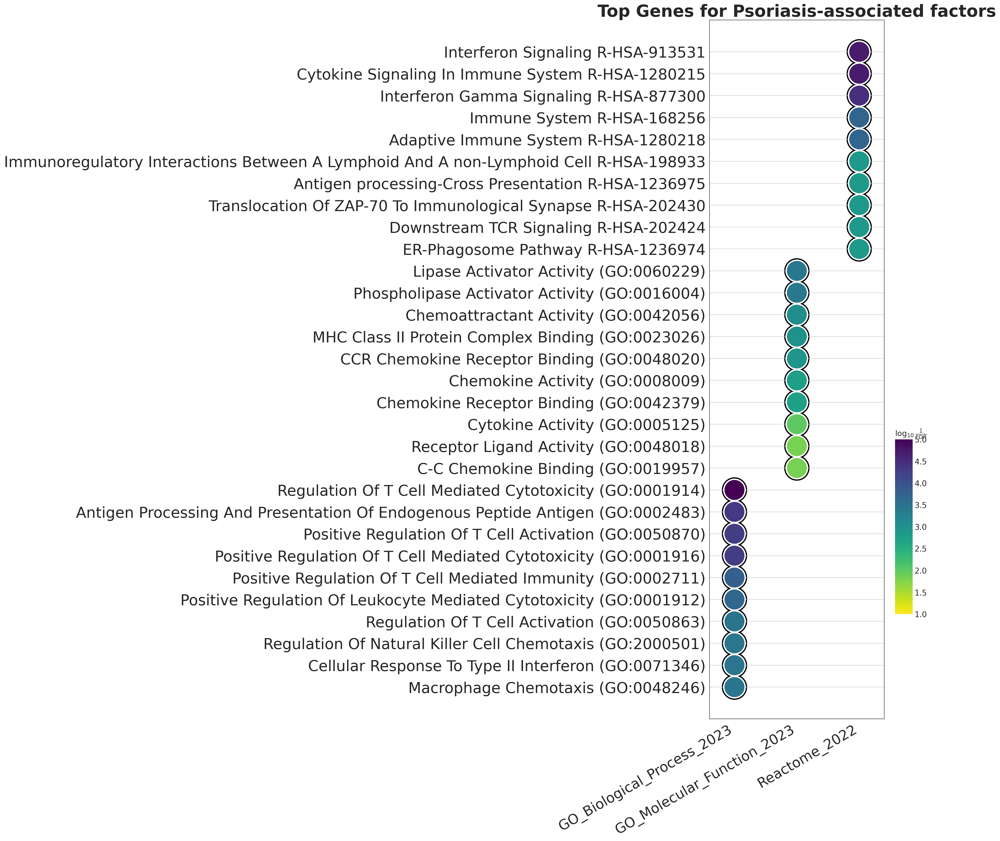

In [717]:
fig, axs = plt.subplots(figsize=(7,23), constrained_layout=True)
make_gp_dotplot(df=enr_bio_topgenes_psoriasis_sign.loc[enr_bio_topgenes_psoriasis_sign.Gene_set != "KEGG_2021_Human"],
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 10,
                title = "Top Genes for Psoriasis-associated factors",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-psoriasis-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-psoriasis-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [714]:
enr_bio_topgenes_T1D = gp.enrichr(gene_list = prs_gene_ct.loc[prs_gene_ct.PRS == "T1D"].TopGene.unique().tolist(), 
                              gene_sets = databases_bio,
                              background = background_genes.values,
                              outdir=None)
enr_bio_topgenes_T1D_sign = enr_bio_topgenes_T1D.results.loc[enr_bio_topgenes_T1D.results["Adjusted P-value"] <= 0.05]
enr_bio_topgenes_T1D_sign.sort_values("Adjusted P-value", ascending=True).head(20)


,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
116,KEGG_2021_Human,Asthma,1.469113e-13,3.819693e-12,0,0,1967.916667,58149.866510,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
117,KEGG_2021_Human,Allograft rejection,8.783187e-13,7.886854e-12,0,0,1311.111111,36397.449904,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
118,KEGG_2021_Human,Autoimmune thyroid disease,1.035044e-12,7.886854e-12,0,0,1264.196429,34887.494268,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
119,KEGG_2021_Human,Type I diabetes mellitus,1.213362e-12,7.886854e-12,0,0,1220.517241,33488.095523,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
120,KEGG_2021_Human,Graft-versus-host disease,1.643536e-12,8.546388e-12,0,0,1141.612903,30976.719700,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
121,KEGG_2021_Human,Intestinal immune network for IgA production,2.509214e-12,1.087326e-11,0,0,1040.661765,27797.169930,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
122,KEGG_2021_Human,Systemic lupus erythematosus,3.706035e-12,1.376527e-11,0,0,956.081081,25165.066043,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
123,KEGG_2021_Human,Viral myocarditis,8.300886e-12,2.697788e-11,0,0,803.579545,20503.057985,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
124,KEGG_2021_Human,Inflammatory bowel disease,1.513297e-11,4.319815e-11,0,0,706.850000,17610.563710,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1
125,KEGG_2021_Human,Staphylococcus aureus infection,1.661467e-11,4.319815e-11,0,0,692.941176,17199.309300,HLA-DRB5;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DQB1


/tmp/ipykernel_1081609/59199515.py:16: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/tmp/ipykernel_1081609/59199515.py:18: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.


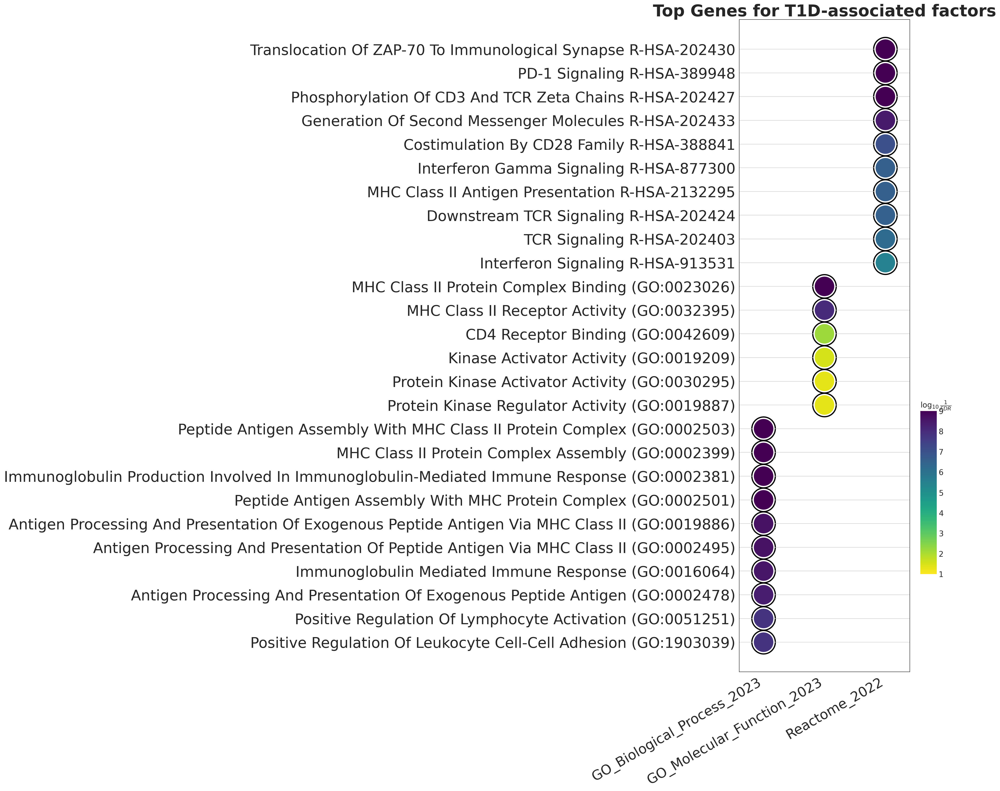

In [716]:
fig, axs = plt.subplots(figsize=(7,22), constrained_layout=True)
make_gp_dotplot(df=enr_bio_topgenes_T1D_sign.loc[enr_bio_topgenes_T1D_sign.Gene_set != "KEGG_2021_Human"],
                x="Gene_set",
                y="Term",
                column="Adjusted P-value",
                size=6,
                top_term = 10,
                title = "Top Genes for T1D-associated factors",
                show_ring=True,
                marker="o",
                xticklabels_rot=30,
                ax = axs,
                fig = fig,
                rasterize=True)
axs.set_xlabel("")
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-T1D-PRS.png"), 
            transparent=True, bbox_inches="tight", dpi=500)
plt.savefig(os.path.join(model_results_dir, "Figures", "GSEA_bio-top-10_top-genes-T1D-PRS.eps"), 
            transparent=True, bbox_inches="tight", dpi=500)

In [718]:
enr_bio_topgenes_T1D_sign.loc[enr_bio_topgenes_T1D_sign.Gene_set != "KEGG_2021_Human"].Term

0      Peptide Antigen Assembly With MHC Class II Pro...
1      MHC Class II Protein Complex Assembly (GO:0002...
2      Immunoglobulin Production Involved In Immunogl...
3      Peptide Antigen Assembly With MHC Protein Comp...
4      Antigen Processing And Presentation Of Exogeno...
                             ...                        
150                           TCR Signaling R-HSA-202403
151                    Interferon Signaling R-HSA-913531
152    Cytokine Signaling In Immune System R-HSA-1280215
153                 Adaptive Immune System R-HSA-1280218
154                           Immune System R-HSA-168256
Name: Term, Length: 99, dtype: object

In [725]:
# Common pathways

common_pathways = set(enr_bio_topgenes_T1D_sign.loc[enr_bio_topgenes_T1D_sign.Gene_set != "KEGG_2021_Human"].Term.tolist())
common_pathways &= set(enr_bio_topgenes_MS_sign.loc[enr_bio_topgenes_MS_sign.Gene_set != "KEGG_2021_Human"].Term)
common_pathways &= set(enr_bio_topgenes_Celiac_sign.loc[enr_bio_topgenes_Celiac_sign.Gene_set != "KEGG_2021_Human"].Term)
common_pathways &= set(enr_bio_topgenes_UC_sign.loc[enr_bio_topgenes_UC_sign.Gene_set != "KEGG_2021_Human"].Term)
common_pathways &= set(enr_bio_topgenes_RA_sign.loc[enr_bio_topgenes_RA_sign.Gene_set != "KEGG_2021_Human"].Term)
common_pathways &= set(enr_bio_topgenes_psoriasis_sign.loc[enr_bio_topgenes_psoriasis_sign.Gene_set != "KEGG_2021_Human"].Term)

common_pathways = list(common_pathways)
len(common_pathways)

27

In [728]:
sorted(common_pathways)

['Adaptive Immune System R-HSA-1280218',
 'Antigen Processing And Presentation Of Exogenous Peptide Antigen (GO:0002478)',
 'Antigen Processing And Presentation Of Exogenous Peptide Antigen Via MHC Class II (GO:0019886)',
 'Antigen Processing And Presentation Of Peptide Antigen Via MHC Class II (GO:0002495)',
 'Costimulation By CD28 Family R-HSA-388841',
 'Cytokine Signaling In Immune System R-HSA-1280215',
 'Downstream TCR Signaling R-HSA-202424',
 'Generation Of Second Messenger Molecules R-HSA-202433',
 'Immune System R-HSA-168256',
 'Immunoglobulin Mediated Immune Response (GO:0016064)',
 'Immunoglobulin Production Involved In Immunoglobulin-Mediated Immune Response (GO:0002381)',
 'Interferon Gamma Signaling R-HSA-877300',
 'Interferon Signaling R-HSA-913531',
 'MHC Class II Antigen Presentation R-HSA-2132295',
 'MHC Class II Protein Complex Assembly (GO:0002399)',
 'MHC Class II Protein Complex Binding (GO:0023026)',
 'MHC Class II Receptor Activity (GO:0032395)',
 'PD-1 Signalin

In [742]:
enr_bio_topgenes_Celiac_sign.loc[enr_bio_topgenes_Celiac_sign.Term.isin(common_pathways)].filter(["Term", "Genes"]).sort_values("Term").filter(["Term", "Genes"]).set_index("Term").to_dict()

{'Genes': {'Adaptive Immune System R-HSA-1280218': 'CD74;HLA-DRB5;HLA-B;HLA-C;CYBA;HLA-A;BTN3A2;PSMB9;HLA-DRA;SEC61B;HLA-DQA2;B2M;HLA-DRB1;HLA-DQA1;HLA-DPA1',
  'Antigen Processing And Presentation Of Exogenous Peptide Antigen (GO:0002478)': 'HLA-DRB5;HLA-DRA;HLA-A;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DPA1',
  'Antigen Processing And Presentation Of Exogenous Peptide Antigen Via MHC Class II (GO:0019886)': 'HLA-DRB5;HLA-DRA;HLA-DQA2;HLA-DQA1;HLA-DRB1;HLA-DPA1',
  'Antigen Processing And Presentation Of Peptide Antigen Via MHC Class II (GO:0002495)': 'HLA-DRB5;HLA-DRA;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DPA1',
  'Costimulation By CD28 Family R-HSA-388841': 'HLA-DRB5;HLA-DRA;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DPA1',
  'Cytokine Signaling In Immune System R-HSA-1280215': 'HLA-DRB5;HLA-B;HLA-DRA;HLA-C;HLA-A;HLA-DQA2;B2M;HLA-DRB1;HLA-DQA1;HLA-DPA1;PSMB9',
  'Downstream TCR Signaling R-HSA-202424': 'HLA-DRB5;HLA-DRA;HLA-DQA2;HLA-DRB1;HLA-DQA1;HLA-DPA1;PSMB9',
  'Generation Of Second Messenger Molecules R-H

## UpSet plot

In [192]:
from upsetplot import UpSet, from_contents

In [195]:
PRS_cts = prs_gene_ct.groupby("PRS", observed=True).apply(lambda x: [ct for ct in x["Cell type"].unique().tolist() if ct is not None], include_groups=False).to_dict()
PRS_cts

{'CeD': ['Plasma', 'B IN', 'NK', 'Mono C', 'Mono NC'],
 'MS': ['NK', 'CD8 ET', 'B Mem', 'B IN', 'Mono C', 'Mono NC', 'Plasma'],
 'Psoriasis': ['CD8 ET', 'Plasma', 'B IN', 'Mono NC', 'DC', 'Mono C', 'NK'],
 'RA': ['Plasma', 'B IN', 'NK', 'B Mem', 'Mono NC'],
 'T1D': ['NK', 'B Mem', 'B IN', 'Plasma', 'Mono C'],
 'UC': ['B Mem', 'NK']}

/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/upsetplot/data.py:385: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/upsetplot/plotting.py:795: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/data/danai/miniforge3/envs/LIVI

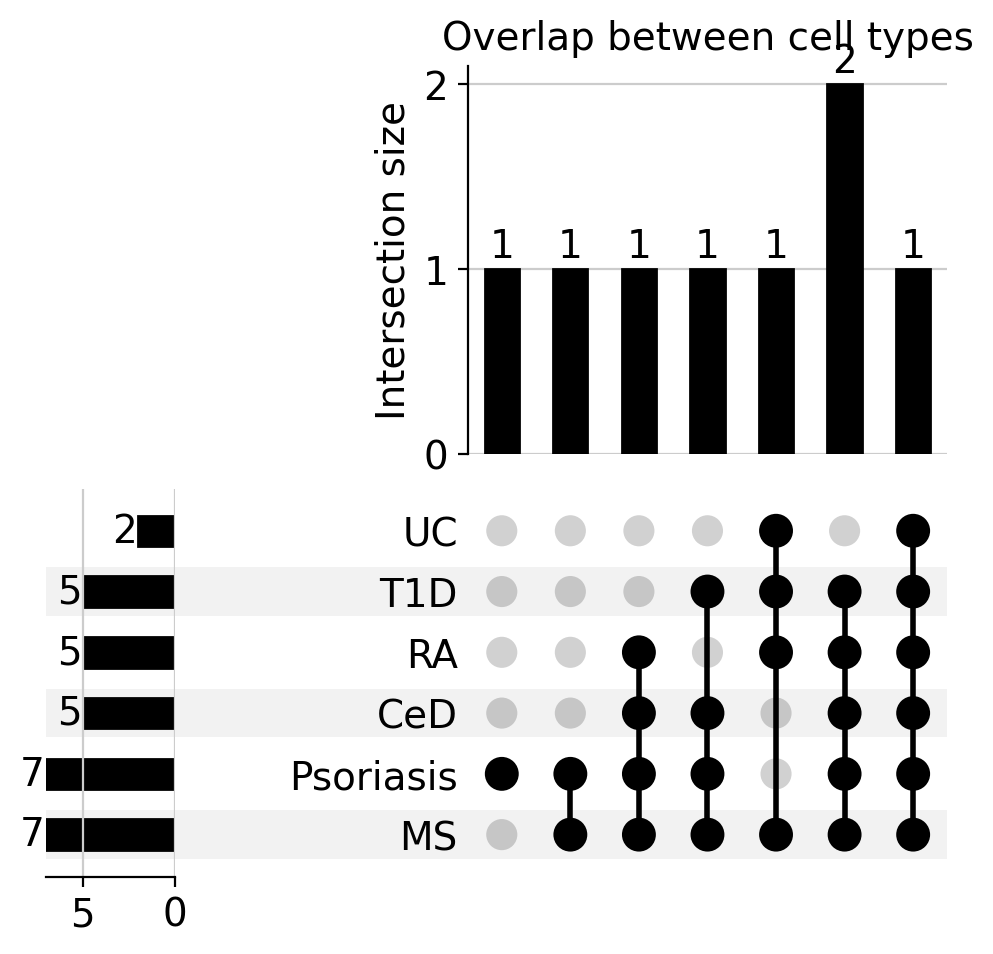

In [196]:
PRS_cts = from_contents(PRS_cts)

UpSet(PRS_cts, subset_size="count", show_counts=True).plot()
plt.title("Overlap between cell types")
plt.savefig(os.path.join(model_results_dir, "Figures", "UpSet_plot_Celltype-overlap-for-PRS.png"),
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "UpSet_plot_Celltype-overlap-for-PRS.eps"),
            transparent=True, dpi=500, bbox_inches="tight")

In [197]:
# prs_gene_ct.PRS.replace({"Multiple_sclerosis": "MS", "Celiac":"CLD"}, inplace=True)
PRS_genes = prs_gene_ct.groupby("PRS", observed=True).apply(lambda x: [g for g in x.TopGene.unique().tolist() if g is not None], include_groups=False).to_dict()
PRS_genes = from_contents(PRS_genes)

/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/upsetplot/data.py:385: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`


/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/upsetplot/plotting.py:795: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/upsetplot/plotting.py:796: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a cop

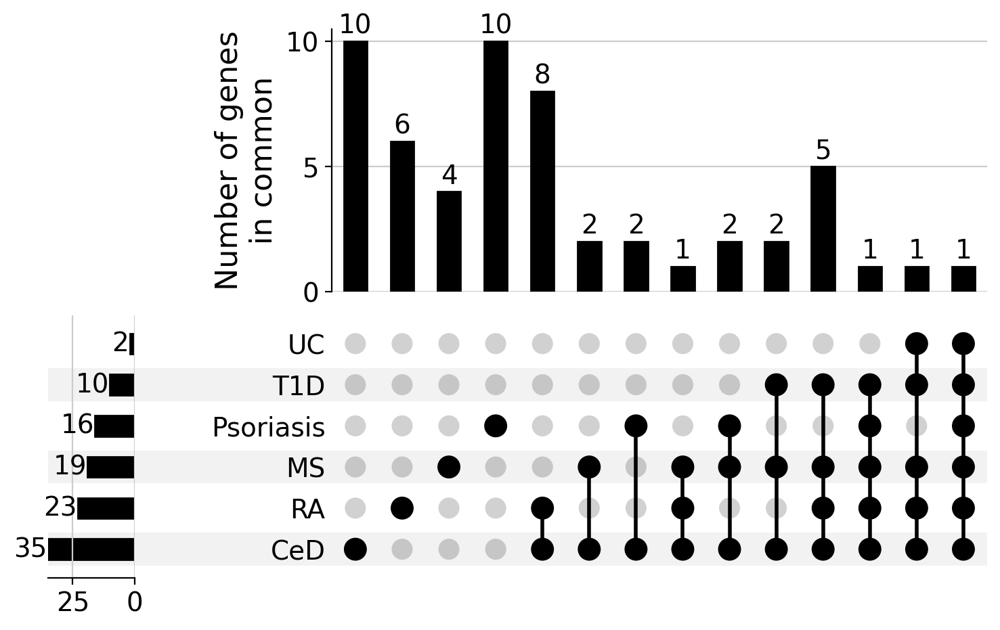

In [198]:
upset_plot = UpSet(PRS_genes, subset_size="count", show_counts=True).plot()
upset_plot["intersections"].set_ylabel(textwrap.fill("Number of genes in common", width=15), fontsize=16)
# plt.title("Overlap between genes\n", fontsize=16)
plt.savefig(os.path.join(model_results_dir, "Figures", "UpSet_plot_Gene-overlap-for-PRS.png"),
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "UpSet_plot_Gene-overlap-for-PRS.pdf"),
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "UpSet_plot_Gene-overlap-for-PRS.eps"),
            transparent=True, dpi=500, bbox_inches="tight")

In [295]:
upset_plot

{'matrix': <Axes: >,
 'shading': <Axes: >,
 'totals': <Axes: >,
 'intersections': <Axes: ylabel='Number of\nassociated\nfactors in\ncommon'>}

/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/upsetplot/data.py:385: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
/data/danai/miniforge3/envs/LIVIenv_py311/lib/python3.11/site-packages/upsetplot/plotting.py:795: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/data/danai/miniforge3/envs/LIVI

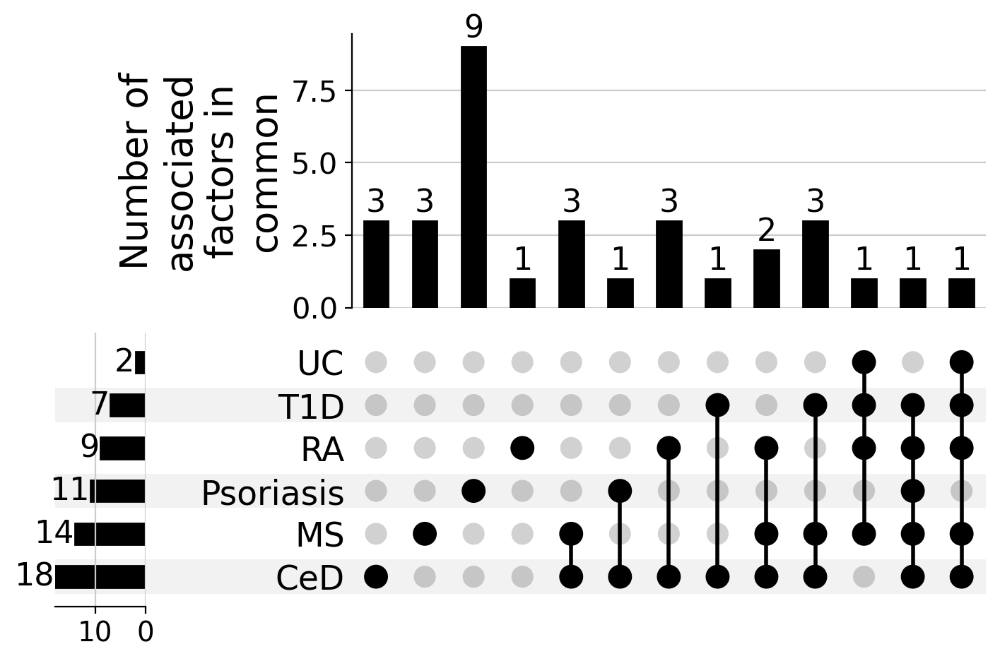

In [302]:
PRS_factors = prs_gene_ct.groupby("PRS", observed=True).apply(lambda x: x.Factor.unique().tolist(), include_groups=False).to_dict()

PRS_factors = from_contents(PRS_factors)

upset_plot = UpSet(PRS_factors, subset_size="count", show_counts=True).plot()
upset_plot["intersections"].set_ylabel(textwrap.fill("Number of associated factors in common\n", width=15), fontsize=19)
upset_plot["intersections"].tick_params(labelsize=15)
upset_plot["matrix"].tick_params(labelsize=17)
for txt in upset_plot["intersections"].texts:
    txt.set_fontsize(16)
for txt in upset_plot["totals"].texts:
    txt.set_fontsize(16)

# plt.title("Overlap between associated factors\n", fontsize=16)
plt.savefig(os.path.join(model_results_dir, "Figures", "UpSet_plot_U-overlap-for-PRS.png"),
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "UpSet_plot_U-overlap-for-PRS.eps"),
            transparent=True, dpi=500, bbox_inches="tight")
plt.savefig(os.path.join(model_results_dir, "Figures", "UpSet_plot_U-overlap-for-PRS.pdf"),
            transparent=True, dpi=500, bbox_inches="tight")

### Count number of times (as in number of factors) each gene was associated to a disease 

In [1427]:
disease_gene_counts = prs_gene_ct.filter(["PRS", "Factor", "TopGene"]).drop_duplicates().groupby("PRS").apply(
    lambda x: x.TopGene.value_counts(), include_groups=False).rename("counts_for_prs").to_frame().reset_index()
disease_gene_counts

,PRS,TopGene,counts_for_prs
0,CeD,HLA-DQA1,6
1,CeD,HLA-DQB1,4
2,CeD,RPL10,2
3,CeD,HLA-DRB1,2
4,CeD,HLA-C,2
...,...,...,...
74,T1D,HLA-DQA1,1
75,T1D,RPL10,1
76,T1D,RPLP1,1
77,UC,HLA-DQA2,2


In [1428]:
disease_gene_counts = disease_gene_counts.merge(prs_gene_ct.filter(["TopGene", "N_diseases", "gene_chromosome"]).drop_duplicates(),
                                                on="TopGene", how="left")
disease_gene_counts.head()

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome
0,CeD,HLA-DQA1,6,4,6
1,CeD,HLA-DQB1,4,3,6
2,CeD,RPL10,2,4,X
3,CeD,HLA-DRB1,2,5,6
4,CeD,HLA-C,2,3,6


In [1429]:
gene_counts_overall = disease_gene_counts.groupby(by="TopGene").apply(lambda x: x.counts_for_prs.values.sum(), include_groups=False).rename("overall_counts").reset_index()
gene_counts_overall.head()

,TopGene,overall_counts
0,ACTB,1
1,AIF1,1
2,B2M,1
3,BTG1,1
4,BTN3A2,1


In [1430]:
disease_gene_counts = disease_gene_counts.merge(gene_counts_overall, on="TopGene", how="left")
disease_gene_counts

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts
0,CeD,HLA-DQA1,6,4,6,15
1,CeD,HLA-DQB1,4,3,6,11
2,CeD,RPL10,2,4,X,5
3,CeD,HLA-DRB1,2,5,6,7
4,CeD,HLA-C,2,3,6,8
...,...,...,...,...,...,...
74,T1D,HLA-DQA1,1,4,6,15
75,T1D,RPL10,1,4,X,5
76,T1D,RPLP1,1,4,15,4
77,UC,HLA-DQA2,2,5,6,9


In [1431]:
disease_gene_counts = disease_gene_counts.merge(
    prs_gene_ct.groupby("PRS").apply(lambda x: x.Factor.nunique(), include_groups=False).rename("N_factors_for_prs").to_frame().reset_index(),
    on="PRS", how="left"
)
disease_gene_counts.head()

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
0,CeD,HLA-DQA1,6,4,6,15,18
1,CeD,HLA-DQB1,4,3,6,11,18
2,CeD,RPL10,2,4,X,5,18
3,CeD,HLA-DRB1,2,5,6,7,18
4,CeD,HLA-C,2,3,6,8,18


In [1432]:
disease_gene_counts.nlargest(10, "N_factors_for_prs", keep="all")

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
0,CeD,HLA-DQA1,6,4,6,15,18
1,CeD,HLA-DQB1,4,3,6,11,18
2,CeD,RPL10,2,4,X,5,18
3,CeD,HLA-DRB1,2,5,6,7,18
4,CeD,HLA-C,2,3,6,8,18
5,CeD,HLA-DPB1,1,2,6,2,18
6,CeD,CD74,1,2,5,2,18
7,CeD,HLA-B,1,2,6,4,18
8,CeD,BTN3A2,1,1,6,1,18
9,CeD,B2M,1,1,15,1,18


In [1433]:
disease_gene_counts.nlargest(10, "overall_counts", keep="all")

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
0,CeD,HLA-DQA1,6,4,6,15,18
28,MS,HLA-DQA1,3,4,6,15,14
48,RA,HLA-DQA1,5,4,6,15,9
74,T1D,HLA-DQA1,1,4,6,15,7
1,CeD,HLA-DQB1,4,3,6,11,18
29,MS,HLA-DQB1,3,3,6,11,14
70,T1D,HLA-DQB1,4,3,6,11,7
15,CeD,HLA-DQA2,1,5,6,9,18
30,MS,HLA-DQA2,2,5,6,9,14
49,RA,HLA-DQA2,2,5,6,9,9


In [1434]:
disease_gene_counts.nlargest(10, "counts_for_prs", keep="all")

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
0,CeD,HLA-DQA1,6,4,6,15,18
37,Psoriasis,HLA-C,5,3,6,8,11
48,RA,HLA-DQA1,5,4,6,15,9
1,CeD,HLA-DQB1,4,3,6,11,18
27,MS,HLA-A,4,2,6,5,14
70,T1D,HLA-DQB1,4,3,6,11,7
28,MS,HLA-DQA1,3,4,6,15,14
29,MS,HLA-DQB1,3,3,6,11,14
38,Psoriasis,HLA-B,3,2,6,4,11
2,CeD,RPL10,2,4,X,5,18


In [1435]:
disease_gene_counts.loc[disease_gene_counts.N_diseases == 6]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
18,CeD,HLA-DRB5,1,6,6,7,18
31,MS,HLA-DRB5,2,6,6,7,14
39,Psoriasis,HLA-DRB5,1,6,6,7,11
59,RA,HLA-DRB5,1,6,6,7,9
72,T1D,HLA-DRB5,1,6,6,7,7
78,UC,HLA-DRB5,1,6,6,7,2


In [1436]:
disease_gene_counts.loc[disease_gene_counts.N_diseases == 5]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
3,CeD,HLA-DRB1,2,5,6,7,18
15,CeD,HLA-DQA2,1,5,6,9,18
30,MS,HLA-DQA2,2,5,6,9,14
34,MS,HLA-DRB1,1,5,6,7,14
42,Psoriasis,HLA-DRB1,1,5,6,7,11
49,RA,HLA-DQA2,2,5,6,9,9
50,RA,HLA-DRB1,2,5,6,7,9
71,T1D,HLA-DQA2,2,5,6,9,7
73,T1D,HLA-DRB1,1,5,6,7,7
77,UC,HLA-DQA2,2,5,6,9,2


In [1437]:
disease_gene_counts.loc[disease_gene_counts.PRS == "RA"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
48,RA,HLA-DQA1,5,4,6,15,9
49,RA,HLA-DQA2,2,5,6,9,9
50,RA,HLA-DRB1,2,5,6,7,9
51,RA,RPL10,1,4,X,5,9
52,RA,RPLP0,1,1,12,1,9
53,RA,CD79A,1,1,19,1,9
54,RA,RPLP1,1,4,15,4,9
55,RA,YBX3,1,1,12,1,9
56,RA,JUN,1,1,1,1,9
57,RA,TCF4,1,1,18,1,9


In [1438]:
disease_gene_counts.loc[disease_gene_counts.PRS == "MS"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
27,MS,HLA-A,4,2,6,5,14
28,MS,HLA-DQA1,3,4,6,15,14
29,MS,HLA-DQB1,3,3,6,11,14
30,MS,HLA-DQA2,2,5,6,9,14
31,MS,HLA-DRB5,2,6,6,7,14
32,MS,HLA-C,1,3,6,8,14
33,MS,MT-ND4,1,1,MT,1,14
34,MS,HLA-DRB1,1,5,6,7,14
35,MS,RPL10,1,4,X,5,14
36,MS,RPLP1,1,4,15,4,14


In [1439]:
disease_gene_counts.loc[disease_gene_counts.PRS == "T1D"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
70,T1D,HLA-DQB1,4,3,6,11,7
71,T1D,HLA-DQA2,2,5,6,9,7
72,T1D,HLA-DRB5,1,6,6,7,7
73,T1D,HLA-DRB1,1,5,6,7,7
74,T1D,HLA-DQA1,1,4,6,15,7
75,T1D,RPL10,1,4,X,5,7
76,T1D,RPLP1,1,4,15,4,7


In [1468]:
disease_gene_counts.loc[disease_gene_counts.PRS == "CeD"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
0,CeD,HLA-DQA1,6,4,6,15,18
1,CeD,HLA-DQB1,4,3,6,11,18
2,CeD,RPL10,2,4,X,5,18
3,CeD,HLA-DRB1,2,5,6,7,18
4,CeD,HLA-C,2,3,6,8,18
5,CeD,HLA-DPB1,1,2,6,2,18
6,CeD,CD74,1,2,5,2,18
7,CeD,HLA-B,1,2,6,4,18
8,CeD,BTN3A2,1,1,6,1,18
9,CeD,B2M,1,1,15,1,18


In [1441]:
disease_gene_counts.loc[disease_gene_counts.N_diseases >= 4].sort_values("N_diseases", ascending=False)

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
78,UC,HLA-DRB5,1,6,6,7,2
39,Psoriasis,HLA-DRB5,1,6,6,7,11
72,T1D,HLA-DRB5,1,6,6,7,7
18,CeD,HLA-DRB5,1,6,6,7,18
31,MS,HLA-DRB5,2,6,6,7,14
59,RA,HLA-DRB5,1,6,6,7,9
50,RA,HLA-DRB1,2,5,6,7,9
49,RA,HLA-DQA2,2,5,6,9,9
73,T1D,HLA-DRB1,1,5,6,7,7
42,Psoriasis,HLA-DRB1,1,5,6,7,11


In [1442]:
disease_gene_counts.loc[disease_gene_counts.TopGene == "HLA-DQA2"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
15,CeD,HLA-DQA2,1,5,6,9,18
30,MS,HLA-DQA2,2,5,6,9,14
49,RA,HLA-DQA2,2,5,6,9,9
71,T1D,HLA-DQA2,2,5,6,9,7
77,UC,HLA-DQA2,2,5,6,9,2


In [1443]:
disease_gene_counts.loc[disease_gene_counts.TopGene == "HLA-DQA1"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
0,CeD,HLA-DQA1,6,4,6,15,18
28,MS,HLA-DQA1,3,4,6,15,14
48,RA,HLA-DQA1,5,4,6,15,9
74,T1D,HLA-DQA1,1,4,6,15,7


In [1469]:
disease_gene_counts.loc[disease_gene_counts.TopGene == "HLA-DQB1"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
1,CeD,HLA-DQB1,4,3,6,11,18
29,MS,HLA-DQB1,3,3,6,11,14
70,T1D,HLA-DQB1,4,3,6,11,7


In [1444]:
disease_gene_counts.loc[disease_gene_counts.TopGene == "HLA-A"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
16,CeD,HLA-A,1,2,6,5,18
27,MS,HLA-A,4,2,6,5,14


In [1215]:
disease_gene_counts.loc[disease_gene_counts.TopGene == "HLA-C"]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
4,CLD,HLA-C,2,3,6,8,18
32,MS,HLA-C,1,3,6,8,14
37,Psoriasis,HLA-C,5,3,6,8,11


In [1209]:
disease_gene_counts.loc[disease_gene_counts.N_diseases == 1]

,PRS,TopGene,counts_for_prs,N_diseases,gene_chromosome,overall_counts,N_factors_for_prs
8,CLD,BTN3A2,1,1,6,1,18
9,CLD,B2M,1,1,15,1,18
10,CLD,SUB1,1,1,5,1,18
11,CLD,SEC61B,1,1,9,1,18
12,CLD,CYBA,1,1,16,1,18
13,CLD,ACTB,1,1,7,1,18
17,CLD,PSMB9,1,1,6,1,18
33,MS,MT-ND4,1,1,MT,1,14
40,Psoriasis,AIF1,1,1,6,1,11
41,Psoriasis,CD37,1,1,19,1,11


In [1341]:
prs_gene_ct.loc[prs_gene_ct.TopGene == "B2M"]

,PRS,Factor,TopGene,celltype,N_diseases,Disease,gene_chromosome,gene_start,gene_end,fPRS
40,CLD,U_Factor503,B2M,B IN,1,Celiac,15,45003675,45011075,Celiac__U_Factor503


/data/danai/scripts/LIVI/src/analysis/plotting.py:2154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/data/danai/scripts/LIVI/src/analysis/plotting.py:2158: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


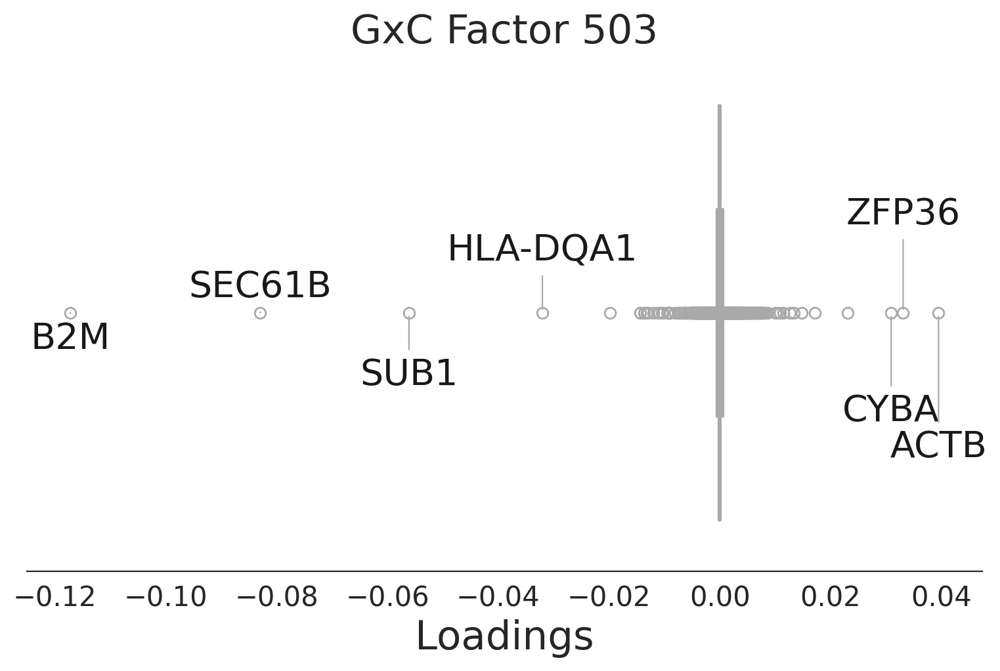

In [1343]:
plot_gene_loadings_for_factor(
    GxC_decoder=GxC_decoder,
    factor="GxC_Factor503",
    n_top_genes=7,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    spines_invisible=True,
    annotation_fontsize=20,
    offset = 0.07,
    x_distance=3e-2,
    savefig=os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_GxC503.eps"),
)

In [1344]:
prs_gene_ct.loc[prs_gene_ct.TopGene == "PSMB9"]

,PRS,Factor,TopGene,celltype,N_diseases,Disease,gene_chromosome,gene_start,gene_end,fPRS
26,CLD,U_Factor377,PSMB9,Mono C,1,Celiac,6,32811913,32827362,Celiac__U_Factor377


/data/danai/scripts/LIVI/src/analysis/plotting.py:2154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/data/danai/scripts/LIVI/src/analysis/plotting.py:2158: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


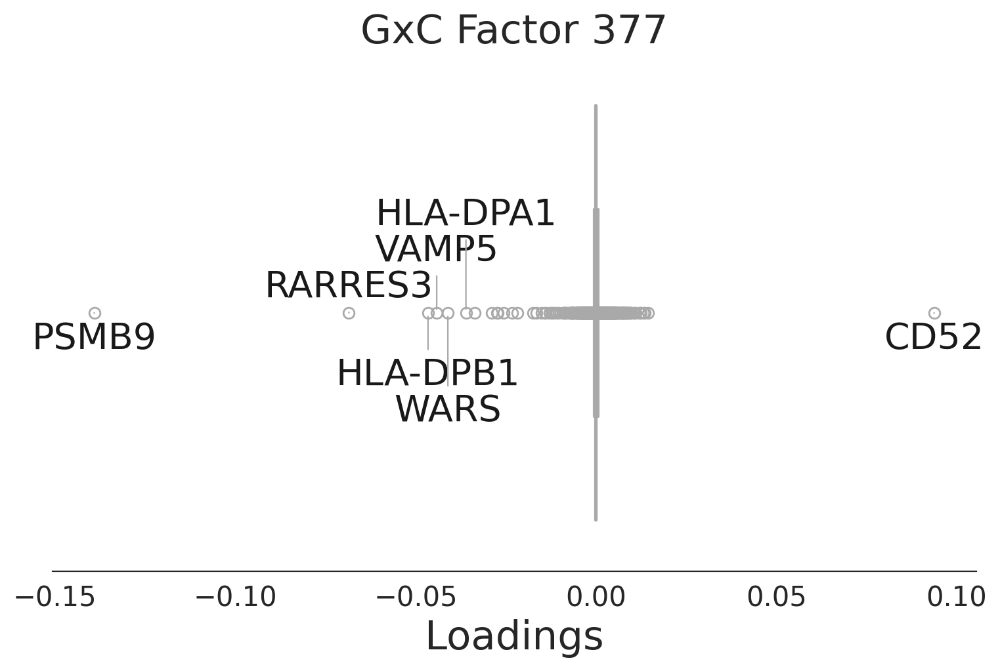

In [1345]:
plot_gene_loadings_for_factor(
    GxC_decoder=GxC_decoder,
    factor="GxC_Factor377",
    n_top_genes=7,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    spines_invisible=True,
    annotation_fontsize=20,
    offset = 0.07,
    x_distance=3e-2,
    savefig=os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_GxC377.eps"),
)

In [1445]:
prs_gene_ct.loc[prs_gene_ct.TopGene == "KLRC1"]

,PRS,Factor,TopGene,celltype,N_diseases,Disease,gene_chromosome,gene_start,gene_end,fPRS
117,Psoriasis,U_Factor674,KLRC1,NK,1,Psoriasis,12,10594863,10607284,Psoriasis__U_Factor674


/data/danai/scripts/LIVI/src/analysis/plotting.py:2154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/data/danai/scripts/LIVI/src/analysis/plotting.py:2158: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


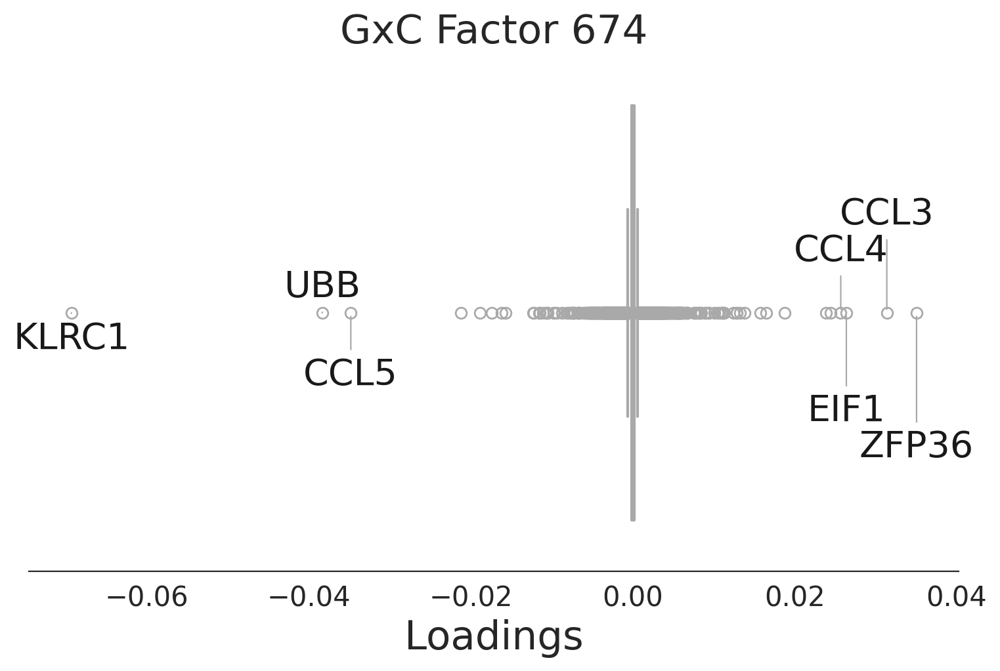

In [1347]:
plot_gene_loadings_for_factor(
    GxC_decoder=GxC_decoder,
    factor="GxC_Factor674",
    n_top_genes=7,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    spines_invisible=True,
    annotation_fontsize=20,
    offset = 0.07,
    x_distance=3e-2,
    savefig=os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_GxC674.eps"),
)

In [1348]:
prs_gene_ct.loc[prs_gene_ct.TopGene == "CD79A"]

,PRS,Factor,TopGene,celltype,N_diseases,Disease,gene_chromosome,gene_start,gene_end,fPRS
89,RA,U_Factor634,CD79A,B IN,1,RA,19,42381190,42385439,RA__U_Factor634


In [1350]:
PRS_effects.loc[PRS_effects.fPRS == "RA__U_Factor634"]

,Factor,SNP_id,effect_size,effect_size_se,p_value,corrected_pvalue,fPRS,Celltype
51,U_Factor634,RA,-0.190177,0.046542,0.000041,0.012521,RA__U_Factor634,B IN


/data/danai/scripts/LIVI/src/analysis/plotting.py:2154: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/data/danai/scripts/LIVI/src/analysis/plotting.py:2158: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


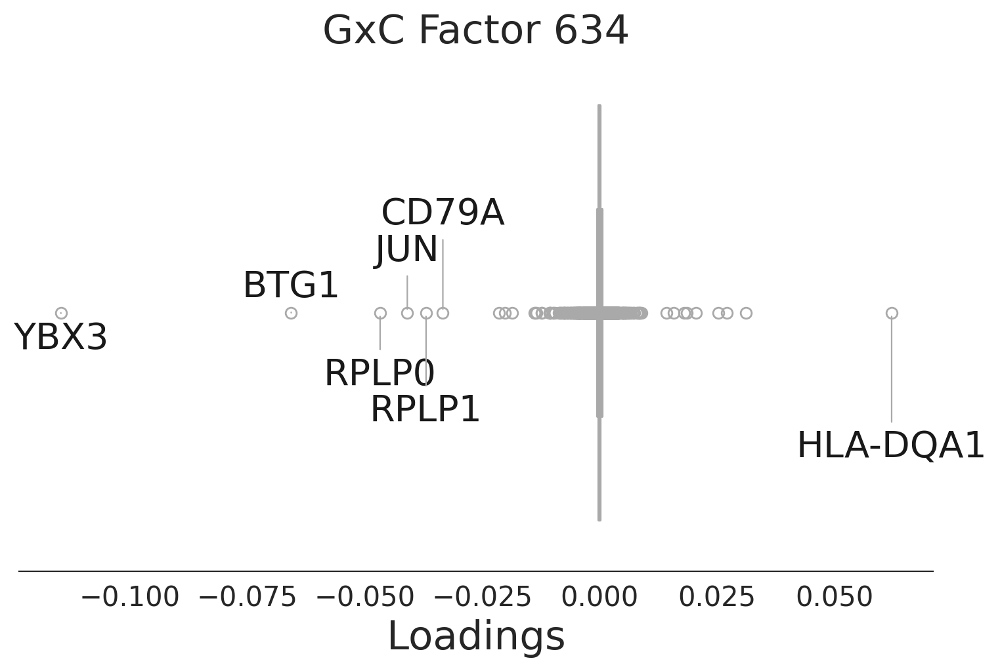

In [1349]:
plot_gene_loadings_for_factor(
    GxC_decoder=GxC_decoder,
    factor="GxC_Factor634",
    n_top_genes=7,
    adata_var=adata.var,
    gene_name_column="GeneSymbol",
    color="darkgrey",
    spines_invisible=True,
    annotation_fontsize=20,
    offset = 0.07,
    x_distance=3e-2,
    savefig=os.path.join(model_results_dir, "Figures", "Boxplots_gene-loadings_GxC634.eps"),
)

In [681]:
# Gene freq for the given PRS
disease_gene_counts = disease_gene_counts.assign(
    freq_for_prs = np.round(disease_gene_counts.counts_for_prs/disease_gene_counts.N_factors_for_prs, 2)
)
disease_gene_counts

,PRS,TopGene,counts_for_prs,N_diseases,overall_counts,N_factors_for_prs,freq_for_prs
0,Celiac,HLA-DQA1,6,4,15,18,0.33
1,Celiac,HLA-DQB1,4,3,11,18,0.22
2,Celiac,RPL10,2,4,5,18,0.11
3,Celiac,HLA-DRB1,2,5,7,18,0.11
4,Celiac,HLA-C,2,3,8,18,0.11
...,...,...,...,...,...,...,...
74,T1D,HLA-DQA1,1,4,15,7,0.14
75,T1D,RPL10,1,4,5,7,0.14
76,T1D,RPLP1,1,4,4,7,0.14
77,UC,HLA-DQA2,2,5,9,2,1.00


In [682]:
disease_gene_counts.loc[disease_gene_counts.TopGene == "HLA-DQA2"]

,PRS,TopGene,counts_for_prs,N_diseases,overall_counts,N_factors_for_prs,freq_for_prs
15,Celiac,HLA-DQA2,1,5,9,18,0.06
30,Multiple_sclerosis,HLA-DQA2,2,5,9,14,0.14
49,RA,HLA-DQA2,2,5,9,9,0.22
71,T1D,HLA-DQA2,2,5,9,7,0.29
77,UC,HLA-DQA2,2,5,9,2,1.00


In [683]:
# Gene freq across all PRS
disease_gene_counts = disease_gene_counts.assign(
    freq_overall= np.round(disease_gene_counts.overall_counts/prs_gene_ct.Factor.nunique(), 2)
)
disease_gene_counts.head()

,PRS,TopGene,counts_for_prs,N_diseases,overall_counts,N_factors_for_prs,freq_for_prs,freq_overall
0,Celiac,HLA-DQA1,6,4,15,18,0.33,0.47
1,Celiac,HLA-DQB1,4,3,11,18,0.22,0.34
2,Celiac,RPL10,2,4,5,18,0.11,0.16
3,Celiac,HLA-DRB1,2,5,7,18,0.11,0.22
4,Celiac,HLA-C,2,3,8,18,0.11,0.25


In [684]:
disease_gene_counts.TopGene.nunique()# == disease_gene_counts.shape[0]

41

<Axes: xlabel='freq_for_prs', ylabel='freq_overall'>

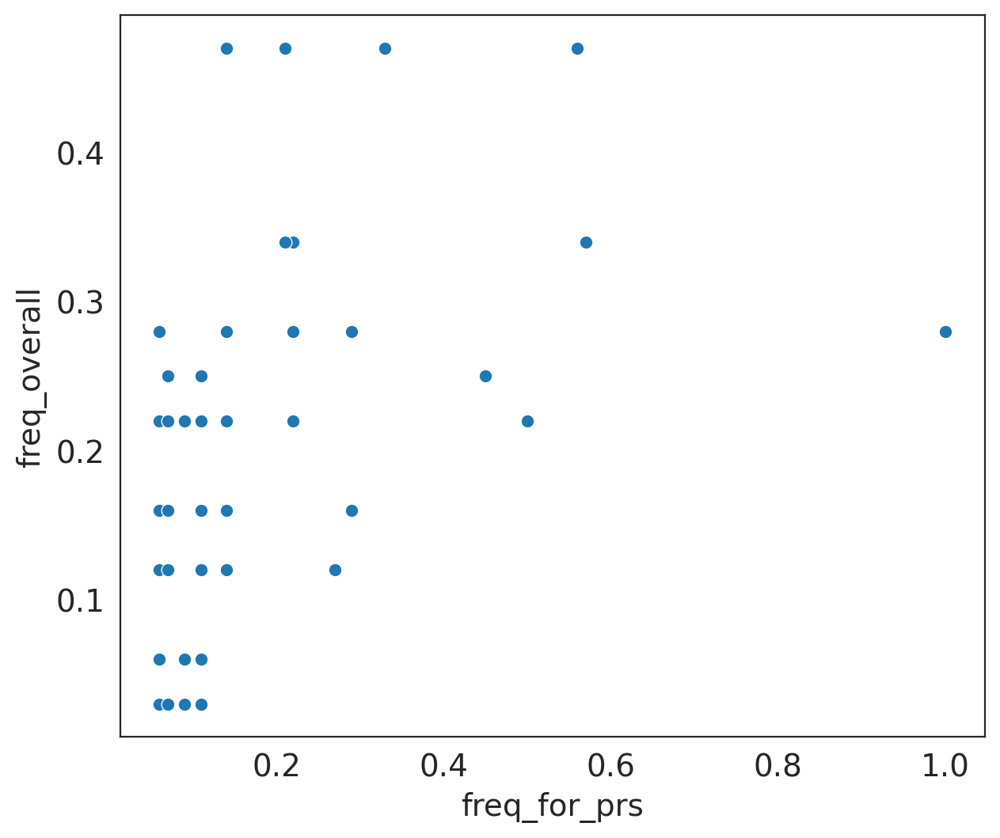

In [663]:
sns.scatterplot(x = "freq_for_prs", y = "freq_overall", data=disease_gene_counts)

In [664]:
disease_gene_counts = disease_gene_counts.assign(
    scaled_freq_for_prs = MinMaxScaler().fit_transform(disease_gene_counts.freq_for_prs.to_numpy().reshape(-1,1)),
    scaled_freq_overall = MinMaxScaler().fit_transform(disease_gene_counts.freq_overall.to_numpy().reshape(-1,1))
)
disease_gene_counts

,PRS,TopGene,counts_for_prs,overall_counts,N_factors_for_prs,freq_for_prs,freq_overall,scaled_freq_for_prs,scaled_freq_overall
0,Celiac,HLA-DQA1,6,15,18,0.33,0.47,0.287234,1.000000
1,Celiac,HLA-DQB1,4,11,18,0.22,0.34,0.170213,0.704545
2,Celiac,RPL10,2,5,18,0.11,0.16,0.053191,0.295455
3,Celiac,HLA-DRB1,2,7,18,0.11,0.22,0.053191,0.431818
4,Celiac,HLA-C,2,8,18,0.11,0.25,0.053191,0.500000
...,...,...,...,...,...,...,...,...,...
74,T1D,HLA-DQA1,1,15,7,0.14,0.47,0.085106,1.000000
75,T1D,RPL10,1,5,7,0.14,0.16,0.085106,0.295455
76,T1D,RPLP1,1,4,7,0.14,0.12,0.085106,0.204545
77,UC,HLA-DQA2,2,9,2,1.00,0.28,1.000000,0.568182


<Axes: xlabel='scaled_freq_for_prs', ylabel='scaled_freq_overall'>

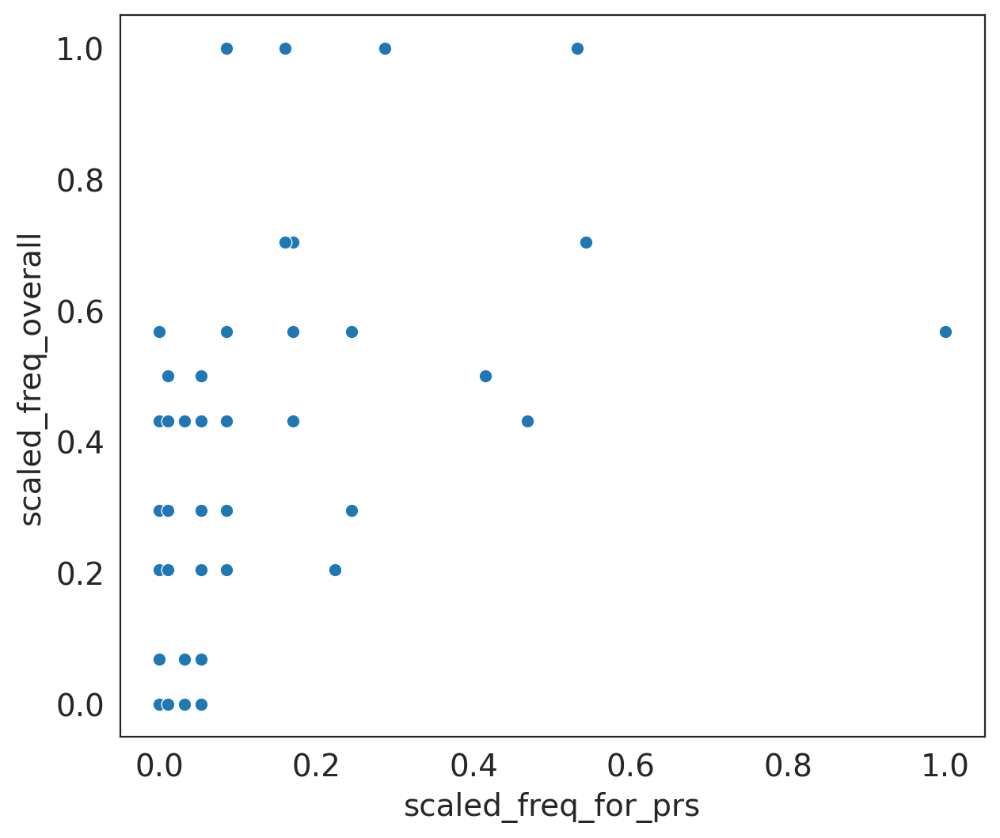

In [665]:
sns.scatterplot(x = "scaled_freq_for_prs", y = "scaled_freq_overall", data=disease_gene_counts)

In [ ]:
disease_gene_counts.sort_values("")